In [1]:
import numpy as np
import matplotlib.pyplot as plt
import aopy
import os
import pandas as pds
from db import dbfunctions as db
from ipywidgets import interactive, widgets
import scipy
import h5py
from tqdm.auto import tqdm 
import seaborn as sn
import sklearn
from sklearn.decomposition import PCA, FactorAnalysis
from itertools import compress
import multiprocessing as mp
import time
import math
import seaborn as sn
from scipy.fft import fft
import glob
from datetime import date

/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/one/alf/files.py:10: FutureWarning: `one.alf.files` will be removed in version 3.0. Use `one.alf.path` instead.
  warnings.warn(


# Set parameters

In [2]:
save_figs = False
base_save_dir = "/media/moor-data/results/Ryan/neuropixel_targeting/"
np_preproc_data_folder = 'np_analysis_preproc_data'
ecog_dec_acc_file_name = 'ecog_decoding_maps/npinsert_ecog_decoding_all'

subject = 'beignet'
align_events = ['TARGET ONSET', 'GO CUE', 'MOVEMENT ONSET']

In [3]:
# Decoding calculation parameters
tbefore = 0.5
tafter = 1
nlda_lags = 1
niter_match = 50
min_trial_prop = .85
ntrial_bin_size = 96
nfolds = 4

# Visualization parameters
colors = sn.color_palette(n_colors=9)
if subject == 'beignet':
    recording_brain_areas={'M1': [30, 56, 47, 40, 121, 48, 120, 98], 'PM':[11, 9, 18, 22, 10, 45]}
elif subject == 'affi':
    recording_brain_areas={'M1': [98, 74, 72, 107], 'PM':[10,19,29,31, 33, 44, 55, 46, 70, 72, 55,58,33,10]}

In [4]:
# plt.rcParams['xtick.labelsize']=24 # Poster
# plt.rcParams['ytick.labelsize']=24
# plt.rcParams['axes.labelsize']=28
# plt.rcParams['axes.spines.top']=False
# plt.rcParams['axes.titlesize'] = 28
# plt.rcParams['axes.spines.right']=False
# plt.rcParams['lines.linewidth']=5

plt.rcParams['xtick.labelsize']=18 # presentation
plt.rcParams['ytick.labelsize']=18
plt.rcParams['axes.labelsize']=24
plt.rcParams['axes.titlesize'] = 24
plt.rcParams['axes.spines.top']=False
plt.rcParams['axes.spines.right']=False
plt.rcParams['lines.linewidth']=4

In [5]:
def smooth_timeseries_gaus(timeseries_data, samplerate, width, nstd=3, conv_mode='same'):
    '''
    Smooths across 2 
    
    Args:
        timeseries_data (ntime, ...)
        samplerate (int): Sample rate of timeseries
        width (float): Width of the gaussian in time [ms] from -nstd to +nstd
        nstd (float/int): Number of standard deviations to be used in the filter calculation.
        conv_mode (str): Sets the size of the output. Takes eithe 'full', 'valid', or 'same'. See scipy.signal.convolve for full documentationat
        
    Returns: 
        smoothed_timeseries
    '''
    sample_std = (width/nstd)*(samplerate/(1000)) # Convert from s to ms
    x = np.arange(-sample_std*nstd, nstd*sample_std+1)
    # print(f'Gaussian Kernel Lenght is: {len(x)}')
    gaus_filter = (1/(sample_std*np.sqrt(2*np.pi)))*np.exp(-(x**2)/(2*sample_std**2))
    
    return np.apply_along_axis(scipy.signal.convolve, 0, timeseries_data, gaus_filter, mode=conv_mode, method='direct')


def load_hdf_group(data_dir, hdf_filename, group="/"):
    '''
    Loads any datasets from the given hdf group into a dictionary. Also will
    recursively load other groups if any exist under the given group

    Args:
        data_dir (str): folder where data is located
        hdf_filename (str): name of hdf file
        group (str): name of the group to load
    
    Returns:
        dict: all the datasets contained in the given group
    '''
    full_file_name = os.path.join(data_dir, hdf_filename)
    hdf = h5py.File(full_file_name, 'r')
    if group not in hdf:
        raise ValueError('No such group in file {}'.format(hdf_filename))

    # Recursively load groups until datasets are reached
    def _load_hdf_group(hdf):
        keys = hdf.keys()
        data = dict()
        for k in keys:
            if isinstance(hdf[k], h5py.Group):
                data[k] = _load_hdf_group(hdf[k])
            else:
                k_, v = _load_hdf_dataset(hdf[k], k)
                data[k_] = v
        return data

    data = _load_hdf_group(hdf[group])
    hdf.close()
    return data

def _load_hdf_dataset(dataset, name):
    '''
    Internal function for loading hdf datasets. Decodes json and unicode data automatically.

    Args:
        dataset (hdf object): dataset to load
        name (str): name of the dataset

    Returns:
        tuple: Tuple containing:
            | **name (str):** name of the dataset (might be modified)
            | **data (object):** loaded data
    '''
    data = dataset[()]
    if '_json' in name:
        import json
        name = name.replace('_json', '')
        data = json.loads(data)
    try:
        data = data.decode('utf-8')
    except:
        pass
    return name, data

def get_rotations(data_in, condition_labels, separate_conditions=True, pcs=None):
    '''
    
    Args:
        data_in (ntime, nfeatures, ntrials):
        condition_labels (ntrials)
        separate_conditions (bool): to mean average at each time point
    
    Returns:
        tavg_proj_data (ntime, nfeat, ncond)
        indiv_proj_data (ntime, nfeat, ntrials)
        pca_components (nweights, nfeat)
        
    
    '''
    ntime, nfeat, ntrials = data_in.shape
    ncond = len(np.unique(condition_labels))
    
    if ntime*ncond < nfeat:
        print('You need more samples than features')
    
    # Zscore activity from each neuron.
    for ifeat in range(nfeat):
        data_in[:,ifeat,:] = scipy.stats.zscore(data_in[:,ifeat,:], axis=None) # Ensure activity has the same range for each channel
    
    # Trial average for each condition
    tavg_data = np.zeros((ntime,nfeat,ncond))
    for icond, cond in enumerate(np.unique(condition_labels)):
        tavg_data[:,:,icond] = np.mean(data_in[:,:,condition_labels==cond], axis=2)
    
    # Center at each time point for each channel across conditions
    if separate_conditions:
        cond_data = tavg_data - np.nanmean(tavg_data, axis=2)[:,:,None] # Center data across conditions
    else:
        cond_data = tavg_data
    
    # Concatenate data into the shape (ct X n)
    reorg_data = np.zeros((ntime*ncond, nfeat))
    for ifeat in range(nfeat):
        reorg_data[:,ifeat] = cond_data[:,ifeat,:].flatten()
    
    # Calculate PCs and fit to conditioned data
    print(reorg_data.shape)
    pca = PCA().fit(reorg_data)
    
    # Project data from each condition onto PCs
    tavg_proj_data = np.zeros((ntime, nfeat, ncond))*np.nan
    for itarget in range(ncond):
        tavg_proj_data[:,:,itarget] = pca.transform(cond_data[:,:,itarget])
        
    # Project data from each trial onto PCs
    indiv_proj_data = np.zeros((ntime, nfeat, ntrials))
    for itrial in range(ntrials):
        indiv_proj_data[:,:,itrial] = pca.transform(data_in[:,:,itrial])
    
    return tavg_proj_data, indiv_proj_data, pca.components_

import copy
def estimate_PR(data, ddof=1, sqrt_transform=False, normalize=False):
    '''
    This function calculates participation ratio for given data. Participation ratio counts the effective dimensions of the spread of data by taking the ratio of the square of the first and second moments of the eigenvalue probability density function. Refer: Recanatesi S, Dimensionality in recurrent spiking networks: Global trends in activity and local origins in connectivity. PLoS Comput Biol. 2019
    
      Args:
        data (2D Numpy array): Neural data in format (n_timepoints, n_units)
        ddof : (int) :Number of degrees of freedom to use when computing PR_norm (default: 1).
        sqrt_transform : (bool) : Whether to apply a square root transform to remove poisson dependence on spike count data before computing PR_norm (default: False).
        normalize bool : Whether to compute the normalized PR or the participation ratio itself(default: False)
      Returns:
          PR (float): dimensionality in terms of participation ratio, normalized to the number of units if normalize is True.
  '''
    n_time_bins, n_units = data.shape
    X = copy.copy(data)  # local copy, because data is mutable. for square root transform

    if sqrt_transform:
        X = np.sqrt(X + 0.375)  # see Kihlberg, 1972; 0.386 could also be a good value

    X = X - np.mean(X, axis=0, keepdims=True)  # center data
    C = 1. / (n_time_bins - ddof) * X.T @ X
    eigenvalues = np.linalg.eigvals(C)
    PR = (np.sum(eigenvalues)) ** 2 / np.sum(eigenvalues ** 2)

    return (PR - 1) / (X.shape[1] - 1) if normalize else PR

In [6]:
# Subspace angles
from sklearn.preprocessing import StandardScaler

def subspace_angles(A, B, angle_in_degrees = True):
    """Compute the subspace angles between two subspaces."""
    # Compute the Singular Value Decomposition (SVD) of A^T * B
    U, S, Vh = np.linalg.svd(np.dot(A.T, B))
    
    # Compute the principal angles from the singular values
    principal_angles = np.arccos(np.minimum(S, 1.0))
    mean_principal_angle = np.mean(principal_angles)
    
    return np.degrees(mean_principal_angle) if angle_in_degrees else mean_principal_angle 

from scipy.linalg import subspace_angles

def orientation_similarity(subspace1, subspace2):
    """Compute orientation similarity between two subspaces. Value ranges from 0 to 1.
     Identical subspace will have Sori = 1, while orthogonal spaces will have Sori = 0.
     """
    # Calculate principal angles between subspaces
    angles = subspace_angles(subspace1, subspace2)
    # print(angles)

    # Calculate the mean cosine of these angles
    similarity = np.mean(np.cos(angles))
    # print(np.cos(angles))

    return similarity


def get_PCA_subspace(data): 
    """
    Compute the principal component subspace of the given data.
    
    Parameters:
    data (numpy.ndarray): Input data array with shape (n_samples, n_features).
    
    Returns:
    numpy.ndarray: The principal component subspace with shape (n_features, n_components),
                   where n_components is the number of principal components.
    """


    X = data - np.mean(data, axis = 0)

    # Create a PCA instance and fit to the data
    pca = PCA()  # Here, we are getting all components, but you can specify fewer if desired.
    pca.fit_transform(X)

    # Extract the subspace
    subspace = pca.components_.T 

    return subspace


# Load relevant data

In [7]:
print(os.path.join(base_save_dir, ecog_dec_acc_file_name))
ecog_dec_acc_file_name = 'ecog_decoding_maps/npinsert_ecog_decoding'
ecog_dec_acc_file_name_x = 'ecog_decoding_maps/npinsert_ecog_decoding_x'
ecog_dec_acc_file_name_y = 'ecog_decoding_maps/npinsert_ecog_decoding_y'
ecog_dec_acc = load_hdf_group(base_save_dir, ecog_dec_acc_file_name)
ecog_dec_acc_x = load_hdf_group(base_save_dir, ecog_dec_acc_file_name_x)
ecog_dec_acc_y = load_hdf_group(base_save_dir, ecog_dec_acc_file_name_y)
day_colors = ecog_dec_acc[subject]['day_colors']

/media/moor-data/results/Ryan/neuropixel_targeting/ecog_decoding_maps/npinsert_ecog_decoding_all


## Load preprocessed neuropixel data

In [8]:
start = time.time()
aopy.utils.release_memory_limit()
df, rasters, preproc_metadata = aopy.data.base.pkl_read(f"{subject}_np_preprocessed", os.path.join(base_save_dir, np_preproc_data_folder))
print(f"{np.round((time.time()-start)/60)} min to load preprocessed data")
nrecs = preproc_metadata['nrecs']
recording_site = preproc_metadata['recording_sites'] # will be the same for all align events
implants = ['NPinsert72' if preproc_metadata['implant'][irec] == 'NP_Insert72' else 'NPinsert137' for irec in range(len(preproc_metadata['implant']))] #Rename because name in bmi3d is slightly different (TODO)
dates = np.unique(df['date'])

8.0 min to load preprocessed data


## Load ECoG decoding accuracy

In [9]:
random_units, column_units, depth_units, depth_group_info_by_site, pseudopopulation_metadata, unit_df = aopy.data.base.pkl_read(f"{subject}_np_psuedopopulations",  os.path.join(base_save_dir, np_preproc_data_folder))

In [10]:
save_dir = "/media/moor-data/results/Ryan/neuropixel_targeting/np_analysis_preproc_data"
np_decoding, _ = aopy.data.base.pkl_read(f"{subject}_np_decoding_accuracy", save_dir)

max_np_decoding = {}
single_ch_np_decoding = {}
high_dec_groups = np_decoding['modulated_units']
for align_event in align_events:
    max_np_decoding[align_event] = [np.mean(np_decoding[align_event]['neural_space'][irec]) for irec in range(len(np_decoding[align_event]['neural_space']))]
    single_ch_np_decoding[align_event] = [np.mean(np_decoding[align_event]['single_ch_decoding'][irec], axis=1) for irec in range(len(np_decoding[align_event]['single_ch_decoding']))]

In [11]:
# define ecog decoding accuracy as one variable to make it easier to do further analysis
pp_column_sites = [column_units[igroup]['rec_site'][0] for igroup in range(len(column_units))]
pp_column_implants = [column_units[igroup]['implant'][0] for igroup in range(len(column_units))]
ecog_dec_acc_rec_site, ecog_dec_acc_rec_site_pp = {}, {}
ecog_dec_acc_rec_site_x = {}
ecog_dec_acc_rec_site_y = {}
for align_event in align_events:
    ecog_dec_acc_rec_site[align_event] = [ecog_dec_acc[subject][f"{implants[irec]}_interp"][int(rec_site)-1] for irec, rec_site in enumerate(recording_site)]
    ecog_dec_acc_rec_site_pp[align_event] = [ecog_dec_acc[subject][f"{pp_column_implants[irec]}_interp"][int(rec_site)-1] for irec, rec_site in enumerate(pp_column_sites)]
    ecog_dec_acc_rec_site_x[align_event] = [ecog_dec_acc_x[subject][f"{implants[irec]}_interp"][int(rec_site)-1] for irec, rec_site in enumerate(recording_site)]
    ecog_dec_acc_rec_site_y[align_event] = [ecog_dec_acc_y[subject][f"{implants[irec]}_interp"][int(rec_site)-1] for irec, rec_site in enumerate(recording_site)]

## Identify stable units

In [12]:
qc_results, ksdrift = aopy.data.base.pkl_read(f"{subject}_QCunits", os.path.join(base_save_dir, np_preproc_data_folder))
# stable_unit_labels = [qc_results['final_good_unit_labels'][irec] for irec in range(nrecs)]
# stable_unit_idx = [qc_results['final_good_unit_idx'][irec] for irec in range(nrecs)]
# nstable_unit = np.array([len(qc_results['final_good_unit_idx'][irec]) for irec in range(nrecs)])
# neuron_pos = [qc_results['position'][irec] for irec in range(nrecs)]

stable_unit_labels = [qc_results['manual_good_unit_labels'][irec] for irec in range(nrecs)]
stable_unit_idx = [qc_results['manual_good_unit_idx'][irec] for irec in range(nrecs)]
nstable_unit = np.array([len(qc_results['manual_good_unit_idx'][irec]) for irec in range(nrecs)])
neuron_pos = [qc_results['manual_position'][irec] for irec in range(nrecs)]

## Zscore FR

In [13]:
# Zscore the activity of each neuron (even unstable) across all trials
frs = {}
fr_zscore = {}
new_bin_fs = 50
fr_stats = {'mean_fr': {}, 'var_fr': {}, 'mean_fr_sqrt': {}, 'var_fr_sqrt': {}}
for align_event in tqdm(align_events):
    temp_spike_data = [rasters['neural'][align_event][irec][:,np.array(df['good_trial'][df['penetration']==irec]),:][:,:,stable_unit_idx[irec]] for irec in range(nrecs)] # Shape (ntime, ntrial, nunit)    
    # temp_spike_data = [rasters['sbp'][align_event][irec][:,np.array(df['good_trial'][df['date']==dates[irec]]),:] for irec in range(nrecs)] # Shape (ntime, ntrial, nunit)    
    fr_stats['mean_fr'][align_event] = []
    fr_stats['var_fr'][align_event] = []
    fr_stats['mean_fr_sqrt'][align_event] = []
    fr_stats['var_fr_sqrt'][align_event] = []
    fr_stats['mean_fr'][align_event].extend([np.mean(temp_spike_data[irec], axis=(0,1)) for irec in range(nrecs)])
    fr_stats['var_fr'][align_event].extend([np.var(temp_spike_data[irec], axis=(0,1)) for irec in range(nrecs)])
    fr_stats['mean_fr_sqrt'][align_event].extend([np.mean(np.sqrt(temp_spike_data[irec]), axis=(0,1)) for irec in range(nrecs)])
    fr_stats['var_fr_sqrt'][align_event].extend([np.var(np.sqrt(temp_spike_data[irec]), axis=(0,1)) for irec in range(nrecs)])
    
    frs[align_event] = {'align_spikes': [], 'align_spikes_dwns': []}
    fr_zscore[align_event] = {'align_spikes_zscore': [], 'align_spikes_zscore_dwns': []}
    [fr_zscore[align_event]['align_spikes_zscore'].append((temp_spike_data[irec]-np.mean(temp_spike_data[irec], axis=(0,1)))/np.std(temp_spike_data[irec], axis=(0,1))) for irec in range(nrecs)]
    [frs[align_event]['align_spikes'].append(temp_spike_data[irec]) for irec in range(nrecs)]

    for irec in range(nrecs):
        temp_resampled_spike_data = aopy.precondition.base.downsample(temp_spike_data[irec], preproc_metadata['neural_samplerate'], new_bin_fs)
        frs[align_event]['align_spikes_dwns'].append(temp_resampled_spike_data)
        fr_zscore[align_event]['align_spikes_zscore_dwns'].append((temp_resampled_spike_data-np.mean(temp_resampled_spike_data, axis=(0,1)))/np.std(temp_resampled_spike_data, axis=(0,1)))

  0%|          | 0/3 [00:00<?, ?it/s]

In [14]:
fr_zscore['RANDOM'] = {}
for rand_key in list(rasters['neural']['RANDOM'].keys()):
    temp_spike_data = [rasters['neural']['RANDOM'][rand_key][irec][:,:,stable_unit_idx[irec]] for irec in range(nrecs)] # Shape (ntime, ntrial, nunit)    
    fr_zscore['RANDOM'][rand_key] = {'align_spikes_zscore': [], 'align_spikes_zscore_dwns': []}
    [fr_zscore['RANDOM'][rand_key]['align_spikes_zscore'].append((temp_spike_data[irec]-np.mean(temp_spike_data[irec], axis=(0,1)))/np.std(temp_spike_data[irec], axis=(0,1))) for irec in range(nrecs)]

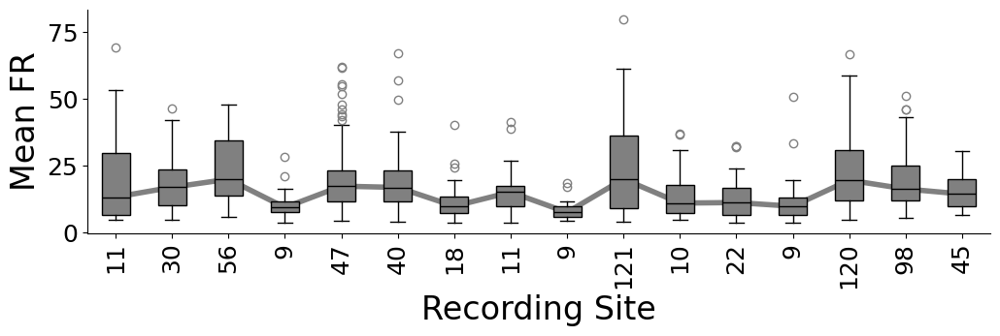

In [15]:
fig, ax = plt.subplots(1,1,figsize=(12,3))
aopy.visualization.plot_boxplots(fr_stats['mean_fr'][align_events[-1]], np.arange(nrecs), ax = ax)
ax.set(xlabel='Recording Site', ylabel='Mean FR')
ax.set_xticks(np.arange(nrecs), recording_site, rotation=90)
plt.show()

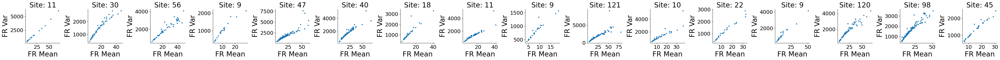

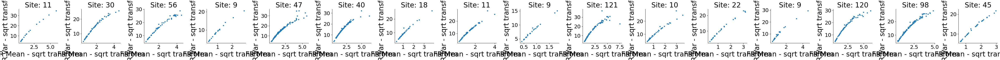

In [16]:
fig, ax = plt.subplots(1,nrecs, figsize=(nrecs*3, 3))
for irec in range(nrecs):
    ax[irec].plot(fr_stats['mean_fr'][align_events[-1]][irec], fr_stats['var_fr'][align_events[-1]][irec], '.')
    ax[irec].set(xlabel='FR Mean', ylabel='FR Var', title=f"Site: {recording_site[irec]}")
    
fig.tight_layout()
plt.show()

# Neural data with sqrt transform applied
fig, ax = plt.subplots(1,nrecs, figsize=(nrecs*3, 3))
for irec in range(nrecs):
    ax[irec].plot(fr_stats['mean_fr_sqrt'][align_events[-1]][irec], fr_stats['var_fr_sqrt'][align_events[-1]][irec], '.')
    ax[irec].set(xlabel='FR Mean - sqrt transform', ylabel='FR Var - sqrt transform', title=f"Site: {recording_site[irec]}")
    
fig.tight_layout()
plt.show()

# Calculate dynamics

In [17]:
np_pop_dynamics = {}

In [1074]:
# Concatenate spike data for across all trials for each recording
align_event = align_events[-1]

conc_spikes, conc_spikes_dwns, conc_spikes_smooth, conc_spikes_dwns_smooth = [], [], [], []
conc_spikes_trial_sep = []
zconc_spikes_trial_sep = []
zconc_spikes, zconc_spikes_dwns, zconc_spikes_dwns_smooth = [], [], []
zconc_spikes_smooth = []    
for irec in tqdm(range(nrecs)):
    if len(stable_unit_idx[irec]) > 0:
        date = list(df[df['penetration']==irec]['date'])[0]
        conc_spikes_day = []
        conc_spikes_day_smooth = []
        temp_spike_segs = list(df['spike_segs'][df[(df['penetration']==irec)*(df['good_trial'])].index])   

        # good_trial_idx = np.array(df['good_trial'][df['penetration']==irec])
        # temp_raster = rasters['neural'][align_event][irec][:,:,stable_unit_idx[irec]][:,good_trial_idx,:]
        # for itrial in range(temp_raster.shape[1]):
        #     conc_spikes_day.append(temp_raster[:,itrial,:])

        for itrial in range(len(temp_spike_segs)):
            temp_spike_labels = list(temp_spike_segs[itrial].keys())
            temp_ntime = len(temp_spike_segs[itrial][temp_spike_labels[0]]) # For each trial the spike segments are the same length
            trial_binned_spikes = np.zeros((temp_ntime, len(temp_spike_labels)))*np.nan
            for ilabel, label in enumerate(temp_spike_labels):
                trial_binned_spikes[:,ilabel] = temp_spike_segs[itrial][label]
            conc_spikes_day.append(trial_binned_spikes[:,stable_unit_idx[irec]])
            conc_spikes_day_smooth.append(smooth_timeseries_gaus(trial_binned_spikes[:,stable_unit_idx[irec]], preproc_metadata['neural_samplerate'], width=150, nstd=3, conv_mode='valid'))
            
        conc_spikes.append(np.concatenate(conc_spikes_day))
        conc_spikes_dwns.append(aopy.precondition.base.downsample(np.concatenate(conc_spikes_day), preproc_metadata['neural_samplerate'], new_bin_fs))
        conc_spikes_smooth.append(np.concatenate(conc_spikes_day_smooth))
        conc_spikes_dwns_smooth.append(aopy.precondition.base.downsample(np.concatenate(conc_spikes_day_smooth), preproc_metadata['neural_samplerate'], new_bin_fs))
        conc_spikes_trial_sep.append(conc_spikes_day)
        zconc_spikes_trial_sep.append([(conc_spikes_day[itr] - np.mean(np.concatenate(conc_spikes_day), axis=0))/np.std(np.concatenate(conc_spikes_day), axis=0) for itr in range(len(conc_spikes_day))])
        temp_zconc = (np.concatenate(conc_spikes_day) - np.mean(np.concatenate(conc_spikes_day), axis=0))/np.nanstd(np.concatenate(conc_spikes_day), axis=0)
        temp_zconc_smooth = (np.concatenate(conc_spikes_day_smooth) - np.mean(np.concatenate(conc_spikes_day_smooth), axis=0))/np.nanstd(np.concatenate(conc_spikes_day_smooth), axis=0)
        temp_zconc_dwns = (aopy.precondition.base.downsample(np.concatenate(conc_spikes_day), preproc_metadata['neural_samplerate'], new_bin_fs) - np.mean(aopy.precondition.base.downsample(np.concatenate(conc_spikes_day), preproc_metadata['neural_samplerate'], new_bin_fs), axis=0))/np.std(aopy.precondition.base.downsample(np.concatenate(conc_spikes_day), preproc_metadata['neural_samplerate'], new_bin_fs), axis=0)
        temp_zconc_dwns_smooth = (aopy.precondition.base.downsample(np.concatenate(conc_spikes_day_smooth), preproc_metadata['neural_samplerate'], new_bin_fs) - np.mean(aopy.precondition.base.downsample(np.concatenate(conc_spikes_day_smooth), preproc_metadata['neural_samplerate'], new_bin_fs), axis=0))/np.std(aopy.precondition.base.downsample(np.concatenate(conc_spikes_day_smooth), preproc_metadata['neural_samplerate'], new_bin_fs), axis=0)
        zconc_spikes.append(temp_zconc)
        zconc_spikes_dwns.append(temp_zconc_dwns)
        zconc_spikes_smooth.append(temp_zconc_smooth)
        zconc_spikes_dwns_smooth.append(temp_zconc_dwns_smooth)
    else:
        conc_spikes.append([])
        conc_spikes_dwns.append([])
        conc_spikes_smooth.append([])
        conc_spikes_dwns_smooth.append([])
        conc_spikes_trial_sep.append([])
        zconc_spikes_trial_sep.append([])
        zconc_spikes.append([])
        zconc_spikes_dwns.append([])
        zconc_spikes_smooth.append([])
        zconc_spikes_dwns_smooth.append([])

  0%|          | 0/35 [00:00<?, ?it/s]

## Dimensionality

In [1075]:
min_units = 15
np_pop_dynamics['dimensionality']={}
np_pop_dynamics['dimensionality']['PR'], np_pop_dynamics['dimensionality']['PR_norm'] = [], []
np_pop_dynamics['dimensionality']['PCA_exp_var'], np_pop_dynamics['dimensionality']['PCA_ndims'], np_pop_dynamics['dimensionality']['PCA_ndims_norm'] = [], [], []
for irec in tqdm(range(nrecs)):
    if len(stable_unit_idx[irec]) > min_units:
        # Participation Ratio
        # np_pop_dynamics['dimensionality']['PR'].append(estimate_PR(conc_spikes_smooth[irec]/preproc_metadata['neural_samplerate'], sqrt_transform=True))
#         np_pop_dynamics['dimensionality']['PR_norm'].append(estimate_PR(conc_spikes_smooth[irec]/preproc_metadata['neural_samplerate'], normalize=True, sqrt_transform=True))
        
        np_pop_dynamics['dimensionality']['PR'].append(estimate_PR(zconc_spikes_smooth[irec], sqrt_transform=False))
        np_pop_dynamics['dimensionality']['PR_norm'].append(estimate_PR(zconc_spikes_smooth[irec], normalize=True, sqrt_transform=False))

        # PCA
        exp_var, ndims, _ = aopy.analysis.get_pca_dimensions(zconc_spikes_smooth[irec])
        np_pop_dynamics['dimensionality']['PCA_exp_var'].append(np.array(exp_var))
        np_pop_dynamics['dimensionality']['PCA_ndims'].append(ndims)
        np_pop_dynamics['dimensionality']['PCA_ndims_norm'].append((ndims - 1) / (conc_spikes_smooth[irec].shape[1] - 1))
        
    else:
        np_pop_dynamics['dimensionality']['PR'].append(np.nan)
        np_pop_dynamics['dimensionality']['PR_norm'].append(np.nan)
        np_pop_dynamics['dimensionality']['PCA_exp_var'].append(np.nan)
        np_pop_dynamics['dimensionality']['PCA_ndims'].append(np.nan)
        np_pop_dynamics['dimensionality']['PCA_ndims_norm'].append(np.nan)

# Use rasters aligned to specific task events
# neural_idx_start = int(preproc_metadata['tbefore']*preproc_metadata['neural_samplerate'])
# neural_idx_stop = int((seg_len*preproc_metadata['neural_samplerate'])) + neural_idx_start
kernel_width = 180
tbefore_pr = 0
tafter_pr = 0.3
use_downsampled_neural_data = False
if use_downsampled_neural_data:
    fs_to_use = new_bin_fs
else:
    fs_to_use = preproc_metadata['neural_samplerate']
    
kernel_size = np.round(fs_to_use*kernel_width/1000).astype(int)
nt = np.round(rasters['neural'][align_events[-1]][0].shape[0]*fs_to_use/preproc_metadata['neural_samplerate']).astype(int)
new_time_axis = (np.arange(nt)/fs_to_use) - preproc_metadata['tbefore']
neural_idx_start = np.where(new_time_axis >= -tbefore_pr)[0][0] - kernel_size
neural_idx_stop = np.where(new_time_axis <= tafter_pr)[0][-1] - kernel_size+1

print(neural_idx_start, neural_idx_stop)
for align_event in tqdm(align_events):
    np_pop_dynamics['dimensionality'][align_event] = {}
    np_pop_dynamics['dimensionality'][align_event]['PR'] = []
    np_pop_dynamics['dimensionality'][align_event]['PR_norm'] = []
    np_pop_dynamics['dimensionality'][align_event]['PCA_exp_var'] = []
    np_pop_dynamics['dimensionality'][align_event]['PCA_ndims'] = []
    for irec in range(nrecs):
        
        if len(stable_unit_idx[irec]) >= min_units:
            spikes_day = []
            good_trial_idx = np.array(df['good_trial'][df['penetration']==irec])
            # temp_raster = smooth_timeseries_gaus(rasters['neural'][align_event][irec][:,good_trial_idx,:]/preproc_metadata['neural_samplerate'], preproc_metadata['neural_samplerate'], width=kernel_width, conv_mode='valid')
            temp_raster = smooth_timeseries_gaus(fr_zscore[align_event]['align_spikes_zscore'][irec], preproc_metadata['neural_samplerate'], width=kernel_width, conv_mode='valid')
            # temp_raster = smooth_timeseries_gaus(fr_zscore[align_event]['align_spikes_zscore_dwns'][irec], fs_to_use, width=kernel_width, conv_mode='valid')
            for itrial in range(temp_raster.shape[1]):
                # spikes_day.append(aopy.precondition.downsample(temp_raster[neural_idx_start:neural_idx_stop,itrial,:], preproc_metadata['neural_samplerate'], 10))
                spikes_day.append(temp_raster[neural_idx_start:neural_idx_stop,itrial,:])
            
            # Participation Ratio
            np_pop_dynamics['dimensionality'][align_event]['PR'].append(estimate_PR(np.concatenate(spikes_day), sqrt_transform=False))
            np_pop_dynamics['dimensionality'][align_event]['PR_norm'].append(estimate_PR(np.concatenate(spikes_day), normalize=True, sqrt_transform=False).real)
            
            # PCA
            exp_var, ndims, _ = aopy.analysis.get_pca_dimensions(np.concatenate(spikes_day))
            np_pop_dynamics['dimensionality'][align_event]['PCA_exp_var'].append(np.array(exp_var))
            np_pop_dynamics['dimensionality'][align_event]['PCA_ndims'].append(ndims)
            
        else:
            np_pop_dynamics['dimensionality'][align_event]['PR'].append(np.nan)
            np_pop_dynamics['dimensionality'][align_event]['PR_norm'].append(np.nan)
            np_pop_dynamics['dimensionality'][align_event]['PCA_exp_var'].append(np.nan)
            np_pop_dynamics['dimensionality'][align_event]['PCA_ndims'].append(np.nan)

  0%|          | 0/35 [00:00<?, ?it/s]

32 62


  0%|          | 0/3 [00:00<?, ?it/s]

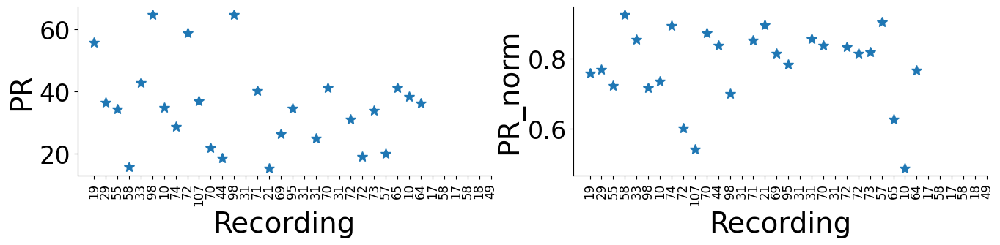

In [1076]:
fig, ax = plt.subplots(1,2,figsize=(16,3)) # All spikes - want to also use data aligned to behavior.
ax[0].plot(np_pop_dynamics['dimensionality']['PR'], '*', markersize=10)
ax[1].plot(np_pop_dynamics['dimensionality']['PR_norm'],'*', markersize=10)
[ax[ia].set_xticks(np.arange(len(recording_site)), recording_site, rotation=90, fontsize=12) for ia in range(len(ax))]
ax[0].set(xlabel='Recording', ylabel='PR')
ax[1].set(xlabel='Recording', ylabel='PR_norm')
plt.show()

Unexpected exception formatting exception. Falling back to standard exception


Traceback (most recent call last):
  File "/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/IPython/core/interactiveshell.py", line 3526, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "/tmp/ipykernel_1155347/3074641472.py", line 24, in <module>
    _,R21,_,pval1,regfit1 = aopy.analysis.base.linear_fit_analysis2D(xaxis1, yaxis1)
  File "/home/aolab/projects/Neuropixel_targeting/analyze/aopy/analysis/base.py", line 733, in linear_fit_analysis2D
  File "/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/sklearn/base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/sklearn/linear_model/_base.py", line 678, in fit
    X, y = self._validate_data(
  File "/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/sklearn/base.py", line 622, in _validate_data
    X, y = check_X_y(X, y, **check_params)
  File "/home/a

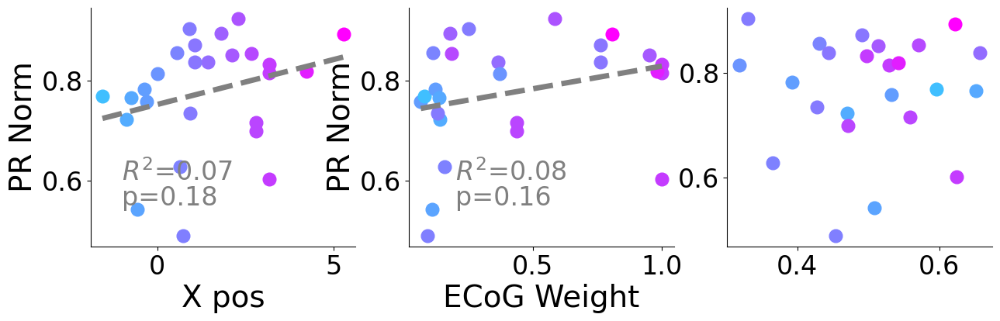

In [1077]:
fig, ax = plt.subplots(1,3,figsize=(15,4)) # All spikes - want to also use data aligned to behavior.
# [ax[0].plot(0, np_pop_dynamics['dimensionality']['PR_norm'][irec], '.', color=day_colors[irec], markersize=14) for irec in range(nrecs) if recording_site[irec] in recording_brain_areas['PM']]
# [ax[0].plot(1, np_pop_dynamics['dimensionality']['PR_norm'][irec], '.',color=day_colors[irec], markersize=14) for irec in range(nrecs) if recording_site[irec] in recording_brain_areas['M1']]
[ax[0].plot(ecog_dec_acc[subject]['rc_axis'][irec,0], np_pop_dynamics['dimensionality']['PR_norm'][irec], '.',color=day_colors[irec], markersize=24) for irec in range(len(np_pop_dynamics['dimensionality']['PR_norm']))]
ax[0].set(xlabel='X pos', ylabel='PR Norm')
nan_mask = ~np.isnan(np_pop_dynamics['dimensionality']['PR_norm'])
xaxis1 = ecog_dec_acc[subject]['rc_axis'][nan_mask,0]
yaxis1 = np.array(np_pop_dynamics['dimensionality']['PR_norm'])[nan_mask]
_,R21,_,pval1,regfit1 = aopy.analysis.base.linear_fit_analysis2D(xaxis1, yaxis1)
ax[0].plot([np.min(xaxis1), np.max(xaxis1)], [(regfit1.coef_[0][0]*np.nanmin(xaxis1))+regfit1.intercept_[0],(regfit1.coef_[0][0]*np.nanmax(xaxis1))+regfit1.intercept_[0]], '--', color=(0.5,0.5,0.5))
ax[0].annotate(f'p={np.round(pval1,2)}',(-1,.55), fontsize=24, color=(0.5,0.5,0.5))
ax[0].annotate(f'$R^2$={np.round(R21,2)}',(-1,.6), fontsize=24, color=(0.5,0.5,0.5))

[ax[1].plot(ecog_dec_acc_rec_site[align_events[-1]][irec]/np.max(ecog_dec_acc_rec_site[align_events[-1]]), np_pop_dynamics['dimensionality']['PR_norm'][irec], '.', markersize=24, color=day_colors[irec]) for irec in range(nrecs)]
xaxis1 = (ecog_dec_acc_rec_site[align_events[-1]]/np.max(ecog_dec_acc_rec_site[align_events[-1]]))[nan_mask]
_,R21,_,pval1,regfit1 = aopy.analysis.base.linear_fit_analysis2D(xaxis1, yaxis1)
ax[1].plot([np.min(xaxis1), np.max(xaxis1)], [(regfit1.coef_[0][0]*np.nanmin(xaxis1))+regfit1.intercept_[0],(regfit1.coef_[0][0]*np.nanmax(xaxis1))+regfit1.intercept_[0]], '--', color=(0.5,0.5,0.5))
ax[1].annotate(f'p={np.round(pval1,2)}',(.2,.55), fontsize=24, color=(0.5,0.5,0.5))
ax[1].annotate(f'$R^2$={np.round(R21,2)}',(.2,.6), fontsize=24, color=(0.5,0.5,0.5))
ax[1].set(xlabel='ECoG Weight', ylabel='PR Norm')

[ax[2].plot(max_np_decoding[align_events[-1]][irec], np_pop_dynamics['dimensionality']['PR_norm'][irec], '.', markersize=24, color=day_colors[irec]) for irec in range(nrecs)]
xaxis1 = np.array(max_np_decoding[align_events[-1]])[nan_mask]
_,R21,_,pval1,regfit1 = aopy.analysis.base.linear_fit_analysis2D(xaxis1, yaxis1)
ax[2].plot([np.min(xaxis1), np.max(xaxis1)], [(regfit1.coef_[0][0]*np.nanmin(xaxis1))+regfit1.intercept_[0],(regfit1.coef_[0][0]*np.nanmax(xaxis1))+regfit1.intercept_[0]], '--', color=(0.5,0.5,0.5))
ax[2].annotate(f'p={np.round(pval1,2)}',(.5,.55), fontsize=24, color=(0.5,0.5,0.5))
ax[2].annotate(f'$R^2$={np.round(R21,2)}',(.5,.6), fontsize=24, color=(0.5,0.5,0.5))
ax[2].set(xlabel='ECoG Weight', ylabel='PR Norm')

ax[2].set(xlabel='Neuropixel Decoding', ylabel='PR Norm')
fig.tight_layout()
plt.show()

Unexpected exception formatting exception. Falling back to standard exception


Traceback (most recent call last):
  File "/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/IPython/core/interactiveshell.py", line 3526, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "/tmp/ipykernel_1155347/1993357040.py", line 45, in <module>
    _,R21,_,pval1,regfit1 = aopy.analysis.base.linear_fit_analysis2D(xaxis1, yaxis1)
  File "/home/aolab/projects/Neuropixel_targeting/analyze/aopy/analysis/base.py", line 733, in linear_fit_analysis2D
  File "/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/sklearn/base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/sklearn/linear_model/_base.py", line 678, in fit
    X, y = self._validate_data(
  File "/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/sklearn/base.py", line 622, in _validate_data
    X, y = check_X_y(X, y, **check_params)
  File "/home/a

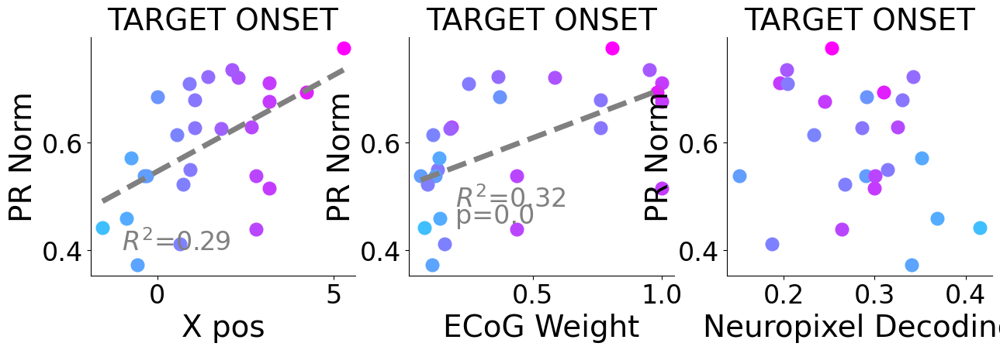

In [1078]:
# Only plot if there are more than x units at that site
PRnorm_trends = {}
PRnorm_trends['xpos_r2'] = np.zeros(len(align_events))*np.nan
PRnorm_trends['ecog_r2'] = np.zeros(len(align_events))*np.nan
PRnorm_trends['np_r2'] = np.zeros(len(align_events))*np.nan
PRnorm_trends['xpos_p'] = np.zeros(len(align_events))*np.nan
PRnorm_trends['ecog_p'] = np.zeros(len(align_events))*np.nan
PRnorm_trends['np_p'] = np.zeros(len(align_events))*np.nan
temp_align_events = [align_events[0], align_events[2]]
# for ievent, align_event in enumerate(align_events):
for ievent, align_event in enumerate(temp_align_events):
    
    fig, ax = plt.subplots(1,3,figsize=(15,4)) # All spikes - want to also use data aligned to behavior.
    # align_event = align_events[-1]
    for irec in range(nrecs):
            ax[0].plot(ecog_dec_acc[subject]['rc_axis'][irec,0], np_pop_dynamics['dimensionality'][align_event]['PR_norm'][irec], '.',color=day_colors[irec], markersize=24)
            ax[0].set(xlabel='X pos', ylabel='PR Norm', title=f"{align_event}")

            ax[1].plot(ecog_dec_acc_rec_site[align_events[-1]][irec]/np.max(ecog_dec_acc_rec_site[align_events[-1]]), np_pop_dynamics['dimensionality'][align_event]['PR_norm'][irec], '.', markersize=24, color=day_colors[irec])
            ax[1].set(xlabel='ECoG Weight', ylabel='PR Norm', title=f"{align_event}")

            ax[2].plot(max_np_decoding[align_event][irec], np_pop_dynamics['dimensionality'][align_event]['PR_norm'][irec], '.', markersize=24, color=day_colors[irec])
            ax[2].set(xlabel='Neuropixel Decoding', ylabel='PR Norm', title=f"{align_event}")
            
    nan_mask = ~np.isnan(np_pop_dynamics['dimensionality'][align_event]['PR_norm'])
    xaxis1 = ecog_dec_acc[subject]['rc_axis'][nan_mask,0]
    yaxis1 = np.array(np_pop_dynamics['dimensionality'][align_event]['PR_norm'])[nan_mask]
    _,R21,_,pval1,regfit1 = aopy.analysis.base.linear_fit_analysis2D(xaxis1, yaxis1)
    PRnorm_trends['xpos_r2'][ievent] = R21
    PRnorm_trends['xpos_p'][ievent] = pval1
    ax[0].plot([np.min(xaxis1), np.max(xaxis1)], [(regfit1.coef_[0][0]*np.nanmin(xaxis1))+regfit1.intercept_[0],(regfit1.coef_[0][0]*np.nanmax(xaxis1))+regfit1.intercept_[0]], '--', color=(0.5,0.5,0.5))
    ax[0].annotate(f'p={np.round(pval1,2)}',(-1,.35), fontsize=24, color=(0.5,0.5,0.5))
    ax[0].annotate(f'$R^2$={np.round(R21,2)}',(-1,.4), fontsize=24, color=(0.5,0.5,0.5))
    
    xaxis1 = (ecog_dec_acc_rec_site[align_events[-1]]/np.max(ecog_dec_acc_rec_site[align_events[-1]]))[nan_mask]
    _,R21,_,pval1,regfit1 = aopy.analysis.base.linear_fit_analysis2D(xaxis1, yaxis1)
    PRnorm_trends['ecog_r2'][ievent] = R21
    PRnorm_trends['ecog_p'][ievent] = pval1
    ax[1].plot([np.min(xaxis1), np.max(xaxis1)], [(regfit1.coef_[0][0]*np.nanmin(xaxis1))+regfit1.intercept_[0],(regfit1.coef_[0][0]*np.nanmax(xaxis1))+regfit1.intercept_[0]], '--', color=(0.5,0.5,0.5))
    ax[1].annotate(f'p={np.round(pval1,2)}',(.2,.45), fontsize=24, color=(0.5,0.5,0.5))
    ax[1].annotate(f'$R^2$={np.round(R21,2)}',(.2,.48), fontsize=24, color=(0.5,0.5,0.5))
    ax[1].set(xlabel='ECoG Weight', ylabel=f'PR Norm', title=f"{align_event}")
    
    xaxis1 = np.array(max_np_decoding[align_event])[nan_mask]
    _,R21,_,pval1,regfit1 = aopy.analysis.base.linear_fit_analysis2D(xaxis1, yaxis1)
    PRnorm_trends['np_r2'][ievent] = R21
    PRnorm_trends['np_p'][ievent] = pval1
    ax[2].plot([np.min(xaxis1), np.max(xaxis1)], [(regfit1.coef_[0][0]*np.nanmin(xaxis1))+regfit1.intercept_[0],(regfit1.coef_[0][0]*np.nanmax(xaxis1))+regfit1.intercept_[0]], '--', color=(0.5,0.5,0.5))
    ax[2].annotate(f'p={np.round(pval1,2)}',(.25,.45), fontsize=24, color=(0.5,0.5,0.5))
    ax[2].annotate(f'$R^2$={np.round(R21,2)}',(.25,.48), fontsize=24, color=(0.5,0.5,0.5))
    ax[2].set(xlabel='Neuropixel Acc', ylabel='PR Norm')
    
    fig.tight_layout()
    plt.show()

Positive y-axis values indicate that dimensionality during movement is higher than dimensionality during preparation


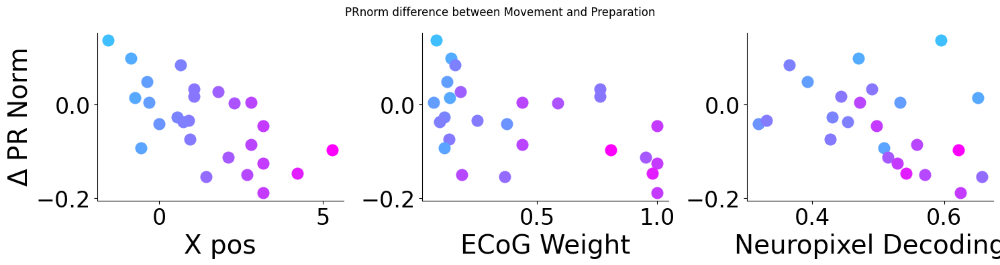

In [1079]:
# Compute delta PRnorm between target onset (preparation) and movement onset (movment)
fig, ax = plt.subplots(1,3,figsize=(15,4)) # All spikes - want to also use data aligned to behavior.
for irec in range(len(np_pop_dynamics['dimensionality']['PR_norm'])):
    delta_PRnorm_temp = np_pop_dynamics['dimensionality'][align_events[-1]]['PR_norm'][irec] - np_pop_dynamics['dimensionality'][align_events[0]]['PR_norm'][irec]
    ax[0].plot(ecog_dec_acc[subject]['rc_axis'][irec,0], delta_PRnorm_temp, '.',color=day_colors[irec], markersize=24)
    ax[0].set(xlabel='X pos', ylabel='$\Delta$ PR Norm')

    ax[1].plot(ecog_dec_acc_rec_site[align_events[-1]][irec]/np.max(ecog_dec_acc_rec_site[align_events[-1]]), delta_PRnorm_temp, '.', markersize=24, color=day_colors[irec])
    ax[1].set(xlabel='ECoG Weight')

    ax[2].plot(max_np_decoding[align_events[-1]][irec], delta_PRnorm_temp, '.', markersize=24, color=day_colors[irec])
    ax[2].set(xlabel='Neuropixel Decoding')
    
plt.suptitle(f"PRnorm difference between Movement and Preparation")
fig.tight_layout()

print('Positive y-axis values indicate that dimensionality during movement is higher than dimensionality during preparation')

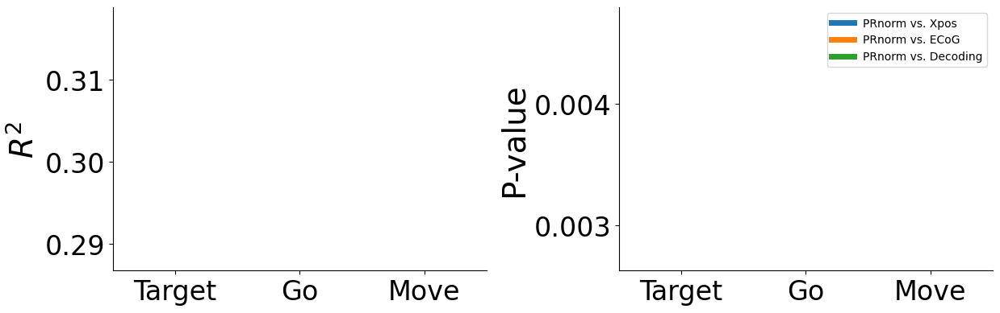

In [1080]:
fig, ax = plt.subplots(1,2, figsize=(12.5,4))
ax[0].plot(np.arange(len(align_events)), PRnorm_trends['xpos_r2'])
ax[0].plot(np.arange(len(align_events)), PRnorm_trends['ecog_r2'])
ax[0].plot(np.arange(len(align_events)), PRnorm_trends['np_r2'])
ax[0].set(ylabel = "$R^2$", xlim=(-0.5,2.5))
[ax[iax].set_xticks(np.arange(len(align_events)), ['Target', 'Go', 'Move']) for iax in range(len(ax))]

ax[1].plot(np.arange(len(align_events)), PRnorm_trends['xpos_p'], label='PRnorm vs. Xpos')
ax[1].plot(np.arange(len(align_events)), PRnorm_trends['ecog_p'], label='PRnorm vs. ECoG')
ax[1].plot(np.arange(len(align_events)), PRnorm_trends['np_p'], label='PRnorm vs. Decoding')
ax[1].set(ylabel = "P-value", xlim=(-0.5,2.5))
ax[1].legend(bbox_to_anchor=(1,1))

fig.tight_layout()
plt.show()

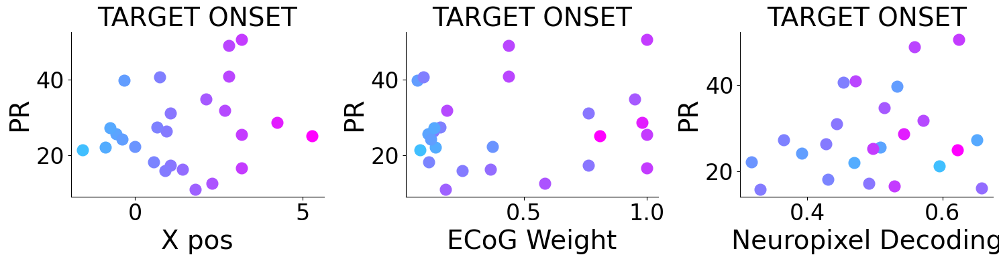

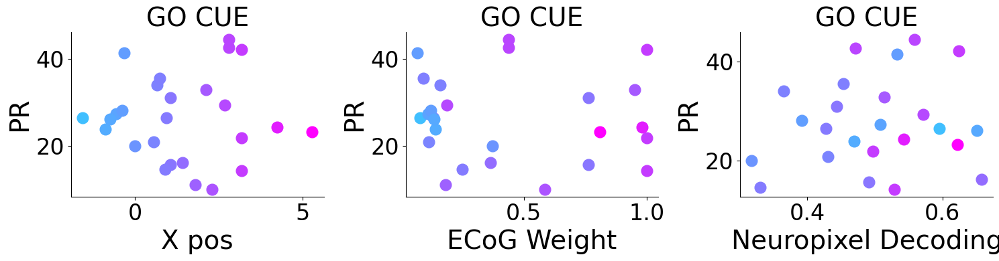

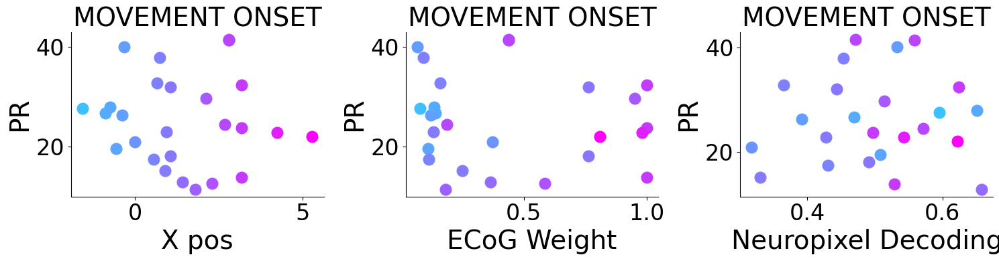

In [1081]:
# Only plot if there are more than x units at that site
for ievent, align_event in enumerate(align_events):
    
    fig, ax = plt.subplots(1,3,figsize=(15,4)) # All spikes - want to also use data aligned to behavior.
    # align_event = align_events[-1]
    for irec in range(len(np_pop_dynamics['dimensionality']['PR'])):
            ax[0].plot(ecog_dec_acc[subject]['rc_axis'][irec,0], np_pop_dynamics['dimensionality'][align_event]['PR'][irec], '.',color=day_colors[irec], markersize=24)
            ax[0].set(xlabel='X pos', ylabel='PR', title=f"{align_event}")

            ax[1].plot(ecog_dec_acc_rec_site[align_events[-1]][irec]/np.max(ecog_dec_acc_rec_site[align_events[-1]]), np_pop_dynamics['dimensionality'][align_event]['PR'][irec], '.', markersize=24, color=day_colors[irec])
            ax[1].set(xlabel='ECoG Weight', ylabel='PR', title=f"{align_event}")

            ax[2].plot(max_np_decoding[align_events[-1]][irec], np_pop_dynamics['dimensionality'][align_event]['PR'][irec], '.', markersize=24, color=day_colors[irec])
            ax[2].set(xlabel='Neuropixel Decoding', ylabel='PR', title=f"{align_event}")
    
    fig.tight_layout()
    plt.show()

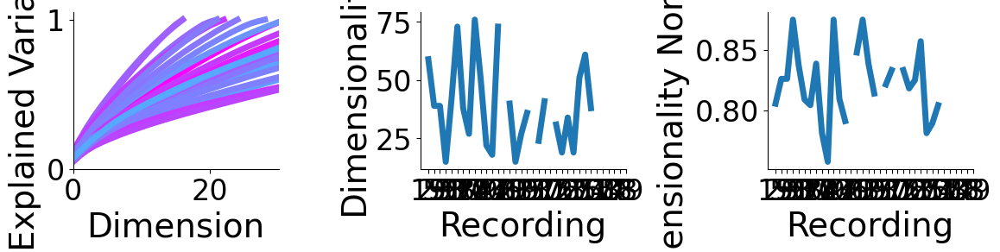

In [1082]:
fig, ax = plt.subplots(1,3,figsize=(12,3))
[ax[0].plot(np.cumsum(np_pop_dynamics['dimensionality']['PCA_exp_var'][irec])/np.sum(np_pop_dynamics['dimensionality']['PCA_exp_var'][irec]), color=day_colors[irec]) for irec in range(nrecs)]
ax[0].set(xlim=(0,30))
ax[0].set(xlabel='Dimension', ylabel='Explained Variance')

ax[1].plot(np_pop_dynamics['dimensionality']['PCA_ndims'])
ax[1].set_xticks(np.arange(len(recording_site)), recording_site)
ax[1].set(xlabel='Recording', ylabel='Dimensionality')
ax[2].plot(np_pop_dynamics['dimensionality']['PCA_ndims_norm'])
ax[2].set_xticks(np.arange(len(recording_site)), recording_site)
ax[2].set(xlabel='Recording', ylabel='Dimensionality Normalized')

fig.tight_layout()
plt.show()

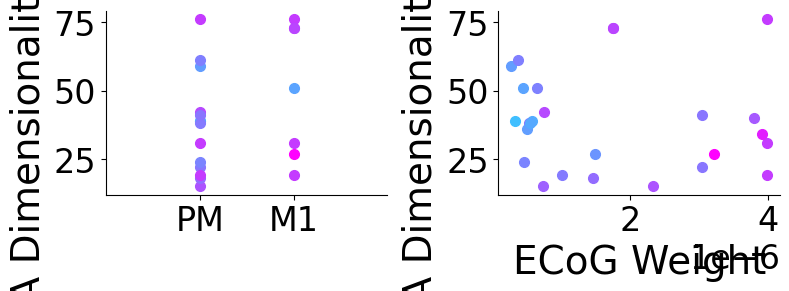

In [1083]:
fig, ax = plt.subplots(1,2,figsize=(8,3)) # All spikes - want to also use data aligned to behavior.
[ax[0].plot(0, np_pop_dynamics['dimensionality']['PCA_ndims'][irec], '.', color=day_colors[irec], markersize=14) for irec in range(nrecs) if recording_site[irec] in recording_brain_areas['PM']]
[ax[0].plot(1, np_pop_dynamics['dimensionality']['PCA_ndims'][irec], '.',color=day_colors[irec], markersize=14) for irec in range(nrecs) if recording_site[irec] in recording_brain_areas['M1']]
# [ax[ia].set_xticks(np.arange(len(recording_site)), recording_site) for ia in range(len(ax))]
ax[0].set(ylabel='PCA Dimensionality Norm', xlim=(-1,2))
ax[0].set_xticks([0,1], ['PM', 'M1'])

[ax[1].plot(ecog_dec_acc_rec_site[align_events[-1]][irec], np_pop_dynamics['dimensionality']['PCA_ndims'][irec], '.', markersize=14, color=day_colors[irec]) for irec in range(nrecs)]
ax[1].set(xlabel='ECoG Weight', ylabel='PCA Dimensionality Norm')
fig.tight_layout()
plt.show()

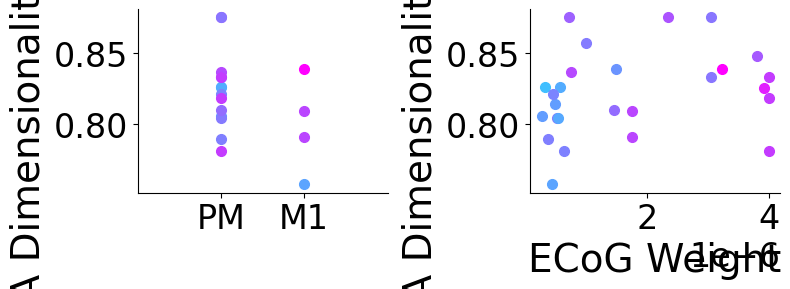

In [1084]:
# only use sites with more than 15 units
fig, ax = plt.subplots(1,2,figsize=(8,3)) # All spikes - want to also use data aligned to behavior.
for irec in range(nrecs):
    if len(stable_unit_idx[irec]) > 15:
        if recording_site[irec] in recording_brain_areas['PM']: 
            ax[0].plot(0, np_pop_dynamics['dimensionality']['PCA_ndims_norm'][irec], '.', color=day_colors[irec], markersize=14) 
        elif recording_site[irec] in recording_brain_areas['M1']:
            ax[0].plot(1, np_pop_dynamics['dimensionality']['PCA_ndims_norm'][irec], '.',color=day_colors[irec], markersize=14) 
        
        ax[0].set(ylabel='PCA Dimensionality Norm', xlim=(-1,2))
        ax[0].set_xticks([0,1], ['PM', 'M1'])

        ax[1].plot(ecog_dec_acc_rec_site[align_events[-1]][irec], np_pop_dynamics['dimensionality']['PCA_ndims_norm'][irec], '.', markersize=14, color=day_colors[irec])
        ax[1].set(xlabel='ECoG Weight', ylabel='PCA Dimensionality Norm')
fig.tight_layout()
plt.show()

### Pseudopopulation dimensionality

In [1085]:
## Start by computing dimensionality with all units
np_pop_dynamics['pp_dimensionality'] = {}
np_pop_dynamics['pp_dimensionality']['all'] = {}
np_pop_dynamics['pp_dimensionality']['all']['PR'] = {}
np_pop_dynamics['pp_dimensionality']['all']['PR_norm'] = {}
for align_event in align_events:
    single_ch_decoding_dim_prep_data = []

    for irec in tqdm(range(nrecs)):
        if len(stable_unit_idx[irec]) > 0:
            spikes_day = []
            temp_raster = smooth_timeseries_gaus(fr_zscore[align_event]['align_spikes_zscore'][irec], preproc_metadata['neural_samplerate'], width=kernel_width, conv_mode='valid')
            # temp_raster = smooth_timeseries_gaus(fr_zscore[align_event]['align_spikes_zscore_dwns'][irec], fs_to_use, width=kernel_width, conv_mode='valid')
            for itrial in range(temp_raster.shape[1]):
                # spikes_day.append(aopy.precondition.downsample(temp_raster[neural_idx_start:neural_idx_stop,itrial,:], preproc_metadata['neural_samplerate'], 10) )
                spikes_day.append(temp_raster[neural_idx_start:neural_idx_stop,itrial,:])

            single_ch_decoding_dim_prep_data.append(np.concatenate(spikes_day))


    single_ch_decoding_dim_prep_data = np.concatenate(single_ch_decoding_dim_prep_data, axis=1)

    np_pop_dynamics['pp_dimensionality']['all']['PR'][align_event] = estimate_PR(single_ch_decoding_dim_prep_data, normalize=False, sqrt_transform=False)
    np_pop_dynamics['pp_dimensionality']['all']['PR_norm'][align_event] = estimate_PR(single_ch_decoding_dim_prep_data, normalize=True, sqrt_transform=False)

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

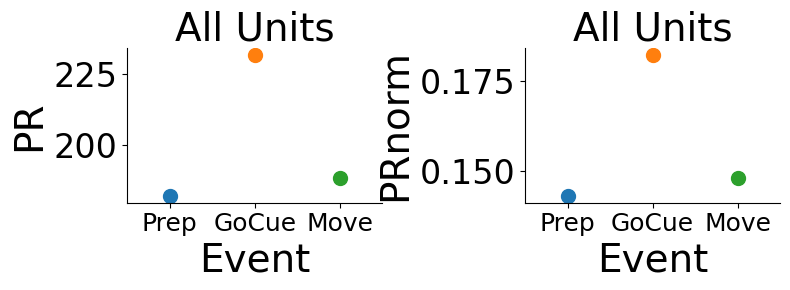

In [1086]:
fig, ax = plt.subplots(1,2,figsize=(8,3))
for ievent, align_event in enumerate(align_events):
    ax[0].plot(ievent, np_pop_dynamics['pp_dimensionality']['all']['PR'][align_event], '.', markersize=20)
    ax[1].plot(ievent, np_pop_dynamics['pp_dimensionality']['all']['PR_norm'][align_event], '.', markersize=20)
    
ax[0].set(xlabel='Event', ylabel='PR', title='All Units', xlim=(-0.5, 2.5))
ax[1].set(xlabel='Event', ylabel='PRnorm', title='All Units', xlim=(-0.5, 2.5))
ax[0].set_xticks(np.arange(len(align_events)), ['Prep', 'GoCue', 'Move'], fontsize=18)
ax[1].set_xticks(np.arange(len(align_events)), ['Prep', 'GoCue', 'Move'], fontsize=18)
fig.tight_layout()
plt.show()

In [1087]:
# Compute dimensionality for random groups of units of different sizes
unit_group_sizes = [10,15,20,30,50,75,100, 125, 150, 175, 200, 225, 250, 275, 300, 350]
np_pop_dynamics['pp_dimensionality'] = {}
np_pop_dynamics['pp_dimensionality']['unit_adding'] = {}
np_pop_dynamics['pp_dimensionality']['unit_adding']['PR'] = {}
np_pop_dynamics['pp_dimensionality']['unit_adding']['PR_norm'] = {}
niterations = 1000
for align_event in align_events:
    single_ch_decoding_dim_prep_data = []
    for irec in range(nrecs):
        if len(stable_unit_idx[irec]) > 0:
            spikes_day = []
            temp_raster = smooth_timeseries_gaus(fr_zscore[align_event]['align_spikes_zscore'][irec], preproc_metadata['neural_samplerate'], width=kernel_width, conv_mode='valid')
            # temp_raster = smooth_timeseries_gaus(fr_zscore[align_event]['align_spikes_zscore_dwns'][irec], fs_to_use, width=kernel_width, conv_mode='valid')
            for itrial in range(temp_raster.shape[1]):
                # spikes_day.append(aopy.precondition.downsample(temp_raster[neural_idx_start:neural_idx_stop,itrial,:], preproc_metadata['neural_samplerate'], 10) )
                spikes_day.append(temp_raster[neural_idx_start:neural_idx_stop,itrial,:])

            single_ch_decoding_dim_prep_data.append(np.concatenate(spikes_day))

    single_ch_decoding_dim_prep_data = np.concatenate(single_ch_decoding_dim_prep_data, axis=1)
    
    np_pop_dynamics['pp_dimensionality']['unit_adding']['PR'][align_event] = []
    np_pop_dynamics['pp_dimensionality']['unit_adding']['PR_norm'][align_event] = []
    for igroup, groupsize in enumerate(tqdm(unit_group_sizes)):
        temp_pr = np.zeros(niterations)*np.nan
        temp_prnorm = np.zeros(niterations)*np.nan
        for iiter in range(niterations):
            random_idx = np.random.choice(np.arange(single_ch_decoding_dim_prep_data.shape[1]), groupsize, replace=False)
            temp_pr[iiter] =  estimate_PR(single_ch_decoding_dim_prep_data[:,random_idx], normalize=False, sqrt_transform=False)
            temp_prnorm[iiter] =  estimate_PR(single_ch_decoding_dim_prep_data[:,random_idx], normalize=True, sqrt_transform=False)
        np_pop_dynamics['pp_dimensionality']['unit_adding']['PR'][align_event].append(temp_pr)
        np_pop_dynamics['pp_dimensionality']['unit_adding']['PR_norm'][align_event].append(temp_prnorm)


  0%|          | 0/16 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [ ]:
fig, ax = plt.subplots(1,2,figsize=(10,4))
ax[1].plot([], color="C0", label='Prep')
ax[1].plot([], color="C1", label='GoCue')
ax[1].plot([], color="C2", label='Move')
for ievent, align_event in enumerate(align_events):
    PR_mean = np.mean(np.array(np_pop_dynamics['pp_dimensionality']['unit_adding']['PR'][align_event]), axis=1)
    PR_sd = np.std(np.array(np_pop_dynamics['pp_dimensionality']['unit_adding']['PR'][align_event]), axis=1)
    PRnorm_mean = np.mean(np.array(np_pop_dynamics['pp_dimensionality']['unit_adding']['PR_norm'][align_event]), axis=1)
    PRnorm_sd = np.std(np.array(np_pop_dynamics['pp_dimensionality']['unit_adding']['PR_norm'][align_event]), axis=1)
    ax[0].plot(unit_group_sizes, np.mean(np.array(np_pop_dynamics['pp_dimensionality']['unit_adding']['PR'][align_event]), axis=1))
    ax[0].fill_between(unit_group_sizes, PR_mean, PR_mean-PR_sd, alpha=0.5, color=f"C{ievent}")
    ax[0].fill_between(unit_group_sizes, PR_mean, PR_mean+PR_sd, alpha=0.5, color=f"C{ievent}")
    ax[1].plot(unit_group_sizes, np.mean(np.array(np_pop_dynamics['pp_dimensionality']['unit_adding']['PR_norm'][align_event]), axis=1))
    ax[1].fill_between(unit_group_sizes, PRnorm_mean, PRnorm_mean-PRnorm_sd, alpha=0.5, color=f"C{ievent}")
    ax[1].fill_between(unit_group_sizes, PRnorm_mean, PRnorm_mean+PRnorm_sd, alpha=0.5, color=f"C{ievent}")
    
ax[0].set(xlabel = 'Number of units', ylabel='PR')
ax[1].set(xlabel = 'Number of units', ylabel='PR norm')
ax[1].legend()
fig.tight_layout()
plt.show()

In [ ]:
np.random.seed(0)
nunits_per_group = 30
neural_idx_start = np.where(new_time_axis >= -tbefore_pr)[0][0] - kernel_size
neural_idx_stop = np.where(new_time_axis <= tafter_pr)[0][-1] - kernel_size+1
np_pop_dynamics['pp_dimensionality'] = {}
np_pop_dynamics['pp_dimensionality']['decoding'] = {}
np_pop_dynamics['pp_dimensionality']['labels'] = ['low 1', 'low 2', 'high 1', 'high 2']
np_pop_dynamics['pp_dimensionality']['decoding']['PR'], np_pop_dynamics['pp_dimensionality']['decoding']['PR_norm'] = {}, {}
nlabels = len(np_pop_dynamics['pp_dimensionality']['labels'])

# Select units
event2organizeby = align_events[2]
single_ch_decoding = []
[single_ch_decoding.extend(single_ch_np_decoding[event2organizeby][irec]) for irec in range(len(single_ch_np_decoding[event2organizeby]))]
low_group_max = np.max(np.array(single_ch_decoding)[np.argsort(np.array(single_ch_decoding))][:(nunits_per_group*2)])
high_group_min = np.min(np.array(single_ch_decoding)[np.argsort(np.array(single_ch_decoding))][-(nunits_per_group*2):])
low_group_idx_all = np.where(np.array(single_ch_decoding) <= low_group_max)[0]
high_group_idx_all = np.where(np.array(single_ch_decoding) >= high_group_min)[0]
np.random.shuffle(low_group_idx_all)
np.random.shuffle(high_group_idx_all)
low_group_idx1 = low_group_idx_all[:nunits_per_group]
low_group_idx2 = low_group_idx_all[-nunits_per_group:]
high_group_idx1 = high_group_idx_all[:nunits_per_group]
high_group_idx2 = high_group_idx_all[-nunits_per_group:]

for align_event in align_events:
    single_ch_decoding_dim_prep_data = []

    for irec in tqdm(range(nrecs)):
        if len(stable_unit_idx[irec]) > 0:
            spikes_day = []
            temp_raster = smooth_timeseries_gaus(fr_zscore[align_event]['align_spikes_zscore'][irec], preproc_metadata['neural_samplerate'], width=kernel_width, conv_mode='valid')
            # temp_raster = smooth_timeseries_gaus(fr_zscore[align_event]['align_spikes_zscore_dwns'][irec], fs_to_use, width=kernel_width, conv_mode='valid')
            for itrial in range(temp_raster.shape[1]):
                # spikes_day.append(aopy.precondition.downsample(temp_raster[neural_idx_start:neural_idx_stop,itrial,:], preproc_metadata['neural_samplerate'], 10) )
                spikes_day.append(temp_raster[neural_idx_start:neural_idx_stop,itrial,:])

            single_ch_decoding_dim_prep_data.append(np.concatenate(spikes_day))


    single_ch_decoding_dim_prep_data = np.concatenate(single_ch_decoding_dim_prep_data, axis=1)

    np_pop_dynamics['pp_dimensionality']['decoding']['PR'][align_event] = np.zeros((nlabels))*np.nan
    np_pop_dynamics['pp_dimensionality']['decoding']['PR_norm'][align_event] = np.zeros((nlabels))*np.nan
    
    np_pop_dynamics['pp_dimensionality']['decoding']['PR'][align_event][0] = estimate_PR(single_ch_decoding_dim_prep_data[:,low_group_idx1], normalize=False, sqrt_transform=False)
    np_pop_dynamics['pp_dimensionality']['decoding']['PR'][align_event][1] = estimate_PR(single_ch_decoding_dim_prep_data[:,low_group_idx2], normalize=False, sqrt_transform=False)
    np_pop_dynamics['pp_dimensionality']['decoding']['PR'][align_event][2] = estimate_PR(single_ch_decoding_dim_prep_data[:,high_group_idx1], normalize=False, sqrt_transform=False)
    np_pop_dynamics['pp_dimensionality']['decoding']['PR'][align_event][3] = estimate_PR(single_ch_decoding_dim_prep_data[:,high_group_idx2], normalize=False, sqrt_transform=False)

    np_pop_dynamics['pp_dimensionality']['decoding']['PR_norm'][align_event][0] = estimate_PR(single_ch_decoding_dim_prep_data[:,low_group_idx1], normalize=True, sqrt_transform=False)
    np_pop_dynamics['pp_dimensionality']['decoding']['PR_norm'][align_event][1] = estimate_PR(single_ch_decoding_dim_prep_data[:,low_group_idx2], normalize=True, sqrt_transform=False)
    np_pop_dynamics['pp_dimensionality']['decoding']['PR_norm'][align_event][2] = estimate_PR(single_ch_decoding_dim_prep_data[:,high_group_idx1], normalize=True, sqrt_transform=False)
    np_pop_dynamics['pp_dimensionality']['decoding']['PR_norm'][align_event][3] = estimate_PR(single_ch_decoding_dim_prep_data[:,high_group_idx2], normalize=True, sqrt_transform=False)

In [ ]:
fig, ax = plt.subplots(1,1,figsize=(5,4))
for ievent, align_event in enumerate(align_events):
    ax.plot(np.arange(nlabels), np_pop_dynamics['pp_dimensionality']['decoding']['PR_norm'][align_event], label=align_event)

ax.set(xlabel='Decoding Group', ylabel='PR Norm')
ax.set_xticks(np.arange(nlabels), np_pop_dynamics['pp_dimensionality']['labels'])
plt.legend()
plt.show()

In [ ]:
np.random.seed(0)
nunits_per_group = 30
neural_idx_start = np.where(new_time_axis >= -tbefore_pr)[0][0] - kernel_size
neural_idx_stop = np.where(new_time_axis <= tafter_pr)[0][-1] - kernel_size+1
np_pop_dynamics['pp_dimensionality'] = {}
np_pop_dynamics['pp_dimensionality']['rc_pos'] = {}
np_pop_dynamics['pp_dimensionality']['labels'] = ['low 1', 'low 2', 'high 1', 'high 2']
np_pop_dynamics['pp_dimensionality']['rc_pos']['PR'], np_pop_dynamics['pp_dimensionality']['rc_pos']['PR_norm'] = {}, {}
nlabels = len(np_pop_dynamics['pp_dimensionality']['labels'])

# Select units
rc_position = []
[rc_position.extend([ecog_dec_acc[subject]['rc_axis'][irec,0] for iunit in range(nstable_unit[irec])]) for irec in range(len(single_ch_np_decoding[event2organizeby]))]
low_group_max = np.max(np.array(rc_position)[np.argsort(np.array(rc_position))][:(nunits_per_group*2)])
high_group_min = np.min(np.array(rc_position)[np.argsort(np.array(rc_position))][-(nunits_per_group*2):])
low_group_idx_all = np.where(np.array(rc_position) <= low_group_max)[0]
high_group_idx_all = np.where(np.array(rc_position) >= high_group_min)[0]
np.random.shuffle(low_group_idx_all)
np.random.shuffle(high_group_idx_all)
low_group_idx1 = low_group_idx_all[:nunits_per_group]
low_group_idx2 = low_group_idx_all[-nunits_per_group:]
high_group_idx1 = high_group_idx_all[:nunits_per_group]
high_group_idx2 = high_group_idx_all[-nunits_per_group:]

for align_event in align_events:
    rc_dim_prep_data = []

    for irec in tqdm(range(nrecs)):
        if len(stable_unit_idx[irec]) > 0:
            spikes_day = []
            temp_raster = smooth_timeseries_gaus(fr_zscore[align_event]['align_spikes_zscore'][irec], preproc_metadata['neural_samplerate'], width=kernel_width, conv_mode='valid')
            # temp_raster = smooth_timeseries_gaus(fr_zscore[align_event]['align_spikes_zscore_dwns'][irec], fs_to_use, width=kernel_width, conv_mode='valid')
            for itrial in range(temp_raster.shape[1]):
                spikes_day.append(temp_raster[neural_idx_start:neural_idx_stop,itrial,:])

            rc_dim_prep_data.append(np.concatenate(spikes_day))


    rc_dim_prep_data = np.concatenate(rc_dim_prep_data, axis=1)

    np_pop_dynamics['pp_dimensionality']['rc_pos']['PR'][align_event] = np.zeros((nlabels))*np.nan
    np_pop_dynamics['pp_dimensionality']['rc_pos']['PR_norm'][align_event] = np.zeros((nlabels))*np.nan
    
    np_pop_dynamics['pp_dimensionality']['rc_pos']['PR'][align_event][0] = estimate_PR(rc_dim_prep_data[:,low_group_idx1], normalize=False, sqrt_transform=False)
    np_pop_dynamics['pp_dimensionality']['rc_pos']['PR'][align_event][1] = estimate_PR(rc_dim_prep_data[:,low_group_idx2], normalize=False, sqrt_transform=False)
    np_pop_dynamics['pp_dimensionality']['rc_pos']['PR'][align_event][2] = estimate_PR(rc_dim_prep_data[:,high_group_idx1], normalize=False, sqrt_transform=False)
    np_pop_dynamics['pp_dimensionality']['rc_pos']['PR'][align_event][3] = estimate_PR(rc_dim_prep_data[:,high_group_idx2], normalize=False, sqrt_transform=False)

    np_pop_dynamics['pp_dimensionality']['rc_pos']['PR_norm'][align_event][0] = estimate_PR(rc_dim_prep_data[:,low_group_idx1], normalize=True, sqrt_transform=False)
    np_pop_dynamics['pp_dimensionality']['rc_pos']['PR_norm'][align_event][1] = estimate_PR(rc_dim_prep_data[:,low_group_idx2], normalize=True, sqrt_transform=False)
    np_pop_dynamics['pp_dimensionality']['rc_pos']['PR_norm'][align_event][2] = estimate_PR(rc_dim_prep_data[:,high_group_idx1], normalize=True, sqrt_transform=False)
    np_pop_dynamics['pp_dimensionality']['rc_pos']['PR_norm'][align_event][3] = estimate_PR(rc_dim_prep_data[:,high_group_idx2], normalize=True, sqrt_transform=False)

In [ ]:
fig, ax = plt.subplots(1,1,figsize=(5,4))
for ievent, align_event in enumerate(align_events):
    ax.plot(np.arange(nlabels), np_pop_dynamics['pp_dimensionality']['rc_pos']['PR_norm'][align_event], label=align_event)

ax.set(xlabel='RC Pos Group', ylabel='PR Norm')
ax.set_xticks(np.arange(nlabels), np_pop_dynamics['pp_dimensionality']['labels'])
plt.legend()
plt.show()

### Windowed dimensionality

In [ ]:
preproc_metadata['trial_time_axis']
wind_length = 0.3
wind_step = 1/preproc_metadata['neural_samplerate']
wind_length_idx = np.round(wind_length/wind_step).astype(int)
nwindows = np.round(((len(preproc_metadata['trial_time_axis'])/preproc_metadata['neural_samplerate']) - wind_length)/wind_step).astype(int)
windowed_time_axis = (np.arange(nwindows)*wind_step) + (wind_length/2) - preproc_metadata['tbefore']
window_definitions_idx = np.zeros((nwindows, 2), dtype=int)

for iwind in range(nwindows):
    window_definitions_idx[iwind,:] = [iwind, iwind+wind_length_idx]

# Compute dimensionality as a function of time 
np_pop_dynamics['dimensionality_window'] = {}
for align_event in tqdm(align_events):
    np_pop_dynamics['dimensionality_window'][align_event] = {}
    np_pop_dynamics['dimensionality_window'][align_event]['PR'] = np.zeros((nrecs, nwindows))*np.nan
    np_pop_dynamics['dimensionality_window'][align_event]['PR_norm'] = np.zeros((nrecs, nwindows))*np.nan
    np_pop_dynamics['dimensionality_window'][align_event]['PCA_exp_var'] = np.zeros((nrecs, nwindows))*np.nan
    np_pop_dynamics['dimensionality_window'][align_event]['PCA_ndims'] = np.zeros((nrecs, nwindows))*np.nan
    for irec in tqdm(range(nrecs)):
        if len(stable_unit_idx[irec]) > min_units:
            temp_raster = smooth_timeseries_gaus(fr_zscore[align_event]['align_spikes_zscore'][irec], preproc_metadata['neural_samplerate'], width=kernel_width, conv_mode='valid')
            for iwind in range(nwindows):
                spikes_day_wind = []
                for itrial in range(temp_raster.shape[1]):
                    spikes_day_wind.append(temp_raster[window_definitions_idx[iwind,0]:window_definitions_idx[iwind,1],itrial,:])

                # Participation Ratio
                np_pop_dynamics['dimensionality_window'][align_event]['PR'][irec,iwind] = estimate_PR(np.concatenate(spikes_day_wind))
                np_pop_dynamics['dimensionality_window'][align_event]['PR_norm'][irec,iwind] = estimate_PR(np.concatenate(spikes_day_wind), normalize=True)

                # PCA
                # exp_var, ndims, _ = aopy.analysis.get_pca_dimensions(np.concatenate(spikes_day_wind))
                # np_pop_dynamics['dimensionality_window'][align_event]['PCA_exp_var'][irec,iwind] = np.array(exp_var)
                # np_pop_dynamics['dimensionality_window'][align_event]['PCA_ndims'][irec,iwind] = ndims


In [ ]:
# Only plot if there are more than x units at that site
nan_mask = nstable_unit >= min_units
for ievent, align_event in enumerate(align_events):
    fig, ax = plt.subplots(1,3,figsize=(15,4)) # All spikes - want to also use data aligned to behavior.
    order_idx = np.argsort(ecog_dec_acc[subject]['rc_axis'][nan_mask,0])
    im0 = ax[0].pcolor(windowed_time_axis, ecog_dec_acc[subject]['rc_axis'][nan_mask,0][order_idx], (np_pop_dynamics['dimensionality_window'][align_event]['PR_norm'][nan_mask,:][order_idx,:]))
    
    ax[0].set(xlabel='Time', ylabel='X-pos', title=f"{align_event}", xlim=(windowed_time_axis[15], windowed_time_axis[-15]))
    cb = plt.colorbar(im0, label='PR Norm')

    order_idx = np.argsort(np.array(ecog_dec_acc_rec_site[align_events[-1]])[nan_mask])
    im1 = ax[1].pcolor(windowed_time_axis, np.array(ecog_dec_acc_rec_site[align_events[-1]])[nan_mask][order_idx]/np.max(ecog_dec_acc_rec_site[align_events[-1]]), (np_pop_dynamics['dimensionality_window'][align_event]['PR_norm'][nan_mask,:][order_idx,:]))
    
    ax[1].set(ylabel='ECoG Weight', xlabel='Time', title=f"{align_event}", xlim=(windowed_time_axis[15], windowed_time_axis[-15]))
    cb = plt.colorbar(im1, label='PR Norm')
    
    order_idx = np.argsort(np.array(max_np_decoding[align_events[-1]])[nan_mask])
    im2 = ax[2].pcolor(windowed_time_axis, np.array(max_np_decoding[align_events[-1]])[nan_mask][order_idx], (np_pop_dynamics['dimensionality_window'][align_event]['PR_norm'][nan_mask,:][order_idx,:]))
    ax[2].set(ylabel='Neuropixel Decoding', xlabel='Time', title=f"{align_event}", xlim=(windowed_time_axis[15], windowed_time_axis[-15]))
    cb = plt.colorbar(im2, label='PR Norm')
    
    fig.tight_layout()
    plt.show()

In [ ]:
# Only plot if there are more than x units at that site
nan_mask = nstable_unit >= min_units
for ievent, align_event in enumerate(align_events):
    fig, ax = plt.subplots(1,3,figsize=(15,4)) # All spikes - want to also use data aligned to behavior.
    order_idx = np.argsort(ecog_dec_acc[subject]['rc_axis'][nan_mask,0])
    im0 = ax[0].pcolor(windowed_time_axis, ecog_dec_acc[subject]['rc_axis'][nan_mask,0][order_idx], (np_pop_dynamics['dimensionality_window'][align_event]['PR_norm'][nan_mask,:][order_idx,:]/np.nanmax(np_pop_dynamics['dimensionality_window'][align_event]['PR_norm'][nan_mask,:][order_idx,:],axis=1,keepdims=True)))
    
    ax[0].set(xlabel='Time', ylabel='X-pos', title=f"{align_event}", xlim=(windowed_time_axis[15], windowed_time_axis[-15]))
    cb = plt.colorbar(im0, label='Relative PR')

    order_idx = np.argsort(np.array(ecog_dec_acc_rec_site[align_events[-1]])[nan_mask])
    im1 = ax[1].pcolor(windowed_time_axis, np.array(ecog_dec_acc_rec_site[align_events[-1]])[nan_mask][order_idx]/np.max(ecog_dec_acc_rec_site[align_events[-1]]), (np_pop_dynamics['dimensionality_window'][align_event]['PR_norm'][nan_mask,:][order_idx,:]/np.nanmax(np_pop_dynamics['dimensionality_window'][align_event]['PR_norm'][nan_mask,:][order_idx,:],axis=1,keepdims=True)))
    
    ax[1].set(ylabel='ECoG Weight', xlabel='Time', title=f"{align_event}", xlim=(windowed_time_axis[15], windowed_time_axis[-15]))
    cb = plt.colorbar(im1, label='Relative PR')
    
    order_idx = np.argsort(np.array(max_np_decoding[align_events[-1]])[nan_mask])
    im2 = ax[2].pcolor(windowed_time_axis, np.array(max_np_decoding[align_events[-1]])[nan_mask][order_idx], (np_pop_dynamics['dimensionality_window'][align_event]['PR_norm'][nan_mask,:][order_idx,:]/np.nanmax(np_pop_dynamics['dimensionality_window'][align_event]['PR_norm'][nan_mask,:][order_idx,:],axis=1,keepdims=True)))
    ax[2].set(ylabel='Neuropixel Decoding', xlabel='Time', title=f"{align_event}", xlim=(windowed_time_axis[15], windowed_time_axis[-15]))
    cb = plt.colorbar(im2, label='Relative PR')
    
    fig.tight_layout()
    plt.show()

In [ ]:
# Stich traces together for example sites
fig, ax = plt.subplots(1,len(align_events),figsize=(len(align_events*5),5))
for irec in range(nrecs):
    if nstable_unit[irec] > min_units:
        for ievent, align_event in enumerate(align_events):
            ax[ievent].plot(windowed_time_axis, np_pop_dynamics['dimensionality_window'][align_event]['PR'][irec,:], color=day_colors[irec], alpha=0.5)
            ax[ievent].set(xlabel='Time [s]', ylabel='PR', title=f"{align_event}")

fig.tight_layout()
plt.show()

In [ ]:
# Stich traces together for example sites
fig, ax = plt.subplots(1,len(align_events),figsize=(len(align_events*5),5))
for irec in range(nrecs):
    if nstable_unit[irec] > min_units:
        for ievent, align_event in enumerate(align_events):
            ax[ievent].plot(windowed_time_axis, np_pop_dynamics['dimensionality_window'][align_event]['PR_norm'][irec,:], color=day_colors[irec], alpha=0.5)
            ax[ievent].set(xlabel='Time [s]', ylabel='PR_norm', title=f"{align_event}")

#             if align_event == align_events[0]:
#                 ax[ievent].set(xlim=(-0.05, 0.2))
                
#             if align_event == align_events[1]:
#                 ax[ievent].set(xlim=(-0.05, 0.5))
            
#             elif align_event == align_events[2]:
#                 ax[ievent].set(xlim=(-0.05, 0.3))
            
fig.tight_layout()
plt.show()

In [ ]:
# Stich traces together for example sites
fig, ax = plt.subplots(1,len(align_events),figsize=(len(align_events*5),5))
for irec in range(nrecs):
    if nstable_unit[irec] > min_units:
        all_dimensionality_for_recording = []
        for ievent, align_event in enumerate(align_events):
            all_dimensionality_for_recording.extend(np_pop_dynamics['dimensionality_window'][align_event]['PR_norm'][irec,:])
        
        normalization_value = np.nanmax(all_dimensionality_for_recording)
        for ievent, align_event in enumerate(align_events):
            ax[ievent].plot(windowed_time_axis, np_pop_dynamics['dimensionality_window'][align_event]['PR_norm'][irec,:]/normalization_value, color=day_colors[irec], alpha=0.5)
            ax[ievent].set(xlabel='Time [s]', ylabel='Relative PR', title=f"{align_event} ({subject})")
            
            if align_event == align_events[0]:
                ax[ievent].set(xlim=(-0.05, 0.2))
                
            if align_event == align_events[1]:
                ax[ievent].set(xlim=(-0.05, 0.5))
            
            elif align_event == align_events[2]:
                ax[ievent].set(xlim=(-0.05, 0.3))
                

fig.tight_layout()
plt.show()

In [ ]:
# Stich traces together for example sites
for irec in range(nrecs):
    if nstable_unit[irec] > min_units:
        fig, ax = plt.subplots(1,len(align_events),figsize=(len(align_events*5),5))
        ylims = []
        for ievent, align_event in enumerate(align_events):
            ax[ievent].plot(windowed_time_axis, np_pop_dynamics['dimensionality_window'][align_event]['PR_norm'][irec,:])
            ax[ievent].set(xlabel='Time [s]', ylabel='PR_norm', title=f"{align_event} Site: {recording_site[irec]}")
            ylims.extend(ax[ievent].get_ylim())
        for ievent, _ in enumerate(align_events):
            ax[ievent].set(ylim=(np.min(ylims), np.max(ylims)))
        fig.tight_layout()
        plt.show()

## Rotations

### Trial Averaged

In [1088]:
align_event = align_events[-1]
print(align_event)
rotations = []
for irec in tqdm(range(nrecs)):
    if len(stable_unit_idx[irec]) > 0:
        temp_target_labels = np.array(df['target_idx'][df['good_trial']*(df['penetration']==irec)])
        temp_rotations = get_rotations(np.swapaxes(fr_zscore[align_event]['align_spikes_zscore_dwns'][irec], 1, 2), temp_target_labels)
        rotations.append(temp_rotations)
    else:
        rotations.append([])
    
    

MOVEMENT ONSET


  0%|          | 0/35 [00:00<?, ?it/s]

(600, 73)
(600, 47)
(600, 47)
(600, 17)
(600, 50)
(600, 90)
(600, 47)
(600, 32)
(600, 97)
(600, 67)
(600, 25)
(600, 22)
(600, 92)
(600, 1)
(600, 47)
(600, 17)
(600, 32)
(600, 44)
(600, 2)
(600, 29)
(600, 49)
(600, 9)
(600, 37)
(600, 23)
(600, 41)
(600, 22)
(600, 65)
(600, 77)
(600, 47)
(600, 6)
(600, 7)
(600, 7)


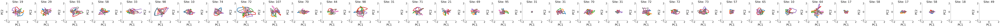

In [1089]:
smooth_width = 100 #[ms]
# Projection onto PC1, PC2
fig, ax = plt.subplots(1,nrecs, figsize=(nrecs*4,4))
for irec in range(nrecs):
    if len(rotations[irec]) > 0:
        if len(np.squeeze(rotations[irec][0]).shape) == 3:
            [ax[irec].plot(smooth_timeseries_gaus(rotations[irec][0][:,0,icond], new_bin_fs, smooth_width), smooth_timeseries_gaus(rotations[irec][0][:,1,icond], new_bin_fs, smooth_width), color=colors[icond]) for icond in range(rotations[irec][0].shape[2])]
    ax[irec].set(xlim = (-2,2), ylim=(-2,2), xlabel='PC1', ylabel='PC2', title=f"Site: {recording_site[irec]}")
fig.tight_layout()
plt.show()

IndexError: list index out of range

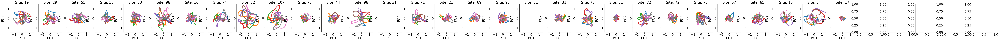

In [1090]:
# Projection onto PC2, PC3
fig, ax = plt.subplots(1,nrecs, figsize=(nrecs*4,4))
for irec in range(nrecs):
    if len(np.squeeze(rotations[irec][0]).shape) == 3 and np.squeeze(rotations[irec][0]).shape[1]>2:
        [ax[irec].plot(smooth_timeseries_gaus(rotations[irec][0][:,1,icond], new_bin_fs, smooth_width), smooth_timeseries_gaus(rotations[irec][0][:,2,icond], new_bin_fs, smooth_width), color=colors[icond]) for icond in range(rotations[irec][0].shape[2])]
    ax[irec].set(xlim = (-1.5,1.5), ylim=(-1.5,1.5), xlabel='PC1', ylabel='PC2', title=f"Site: {recording_site[irec]}")
fig.tight_layout()
plt.show()

In [ ]:
# Projection onto PC1, PC2, PC3
fig, ax = plt.subplots(1,nrecs, figsize=(nrecs*4,4), subplot_kw={'projection':'3d'})
for irec in range(nrecs):
    if len(rotations[irec]) > 0:
        if len(np.squeeze(rotations[irec][0]).shape) == 3 and np.squeeze(rotations[irec][0]).shape[1]>2:
            [ax[irec].plot(smooth_timeseries_gaus(rotations[irec][0][:,0,icond], new_bin_fs, smooth_width), smooth_timeseries_gaus(rotations[irec][0][:,1,icond], new_bin_fs, smooth_width),smooth_timeseries_gaus(rotations[irec][0][:,2,icond], new_bin_fs, smooth_width), color=colors[icond]) for icond in range(rotations[irec][0].shape[2])]
    ax[irec].set(xlim = (-1.5,1.5), ylim=(-1.5,1.5),zlim=(-1.5,1.5), xlabel='PC1', ylabel='PC2',zlabel='PC3', title=f"Site: {recording_site[irec]}")
fig.tight_layout()
plt.show()

### Single trial

IndexError: boolean index did not match indexed array along dimension 2; dimension is 320 but corresponding boolean dimension is 640

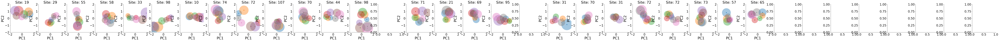

In [1091]:
tidx = 30
unique_targets = np.unique(df['target_idx'])
fig, ax = plt.subplots(1,nrecs, figsize=(nrecs*4,4))
for irec in range(nrecs):
    if len(rotations[irec]) > 0:
        if len(np.squeeze(rotations[irec][0]).shape) == 3 and np.squeeze(rotations[irec][0]).shape[1]>2:
            temp_target_labels = np.array(df['target_idx'][(df['date']==dates[irec])*df['good_trial']])
            for itarg, targ in enumerate(unique_targets):
                temp_std = np.sqrt(np.std(rotations[irec][1][tidx,0,(temp_target_labels==targ)])**2 + np.mean(rotations[irec][1][tidx,1,(temp_target_labels==targ)])**2) 
                ax[irec].plot(np.mean(rotations[irec][1][tidx,0,(temp_target_labels==targ)]), np.mean(rotations[irec][1][tidx,1,(temp_target_labels==targ)]), '.', color=colors[itarg], markersize=10)
                ax[irec].plot(np.mean(rotations[irec][1][tidx,0,(temp_target_labels==targ)]), np.mean(rotations[irec][1][tidx,1,(temp_target_labels==targ)]), '.', color=colors[itarg], markersize=100*temp_std, alpha=0.4)
                ax[irec].set(xlim = (-2,2), ylim=(-2,2), xlabel='PC1', ylabel='PC2', title=f"Site: {recording_site[irec]}")
                ax[irec].set(xlabel='PC1', ylabel='PC2', title=f"Site: {recording_site[irec]}")
fig.tight_layout()
plt.show()

fig, ax = plt.subplots(1,nrecs, figsize=(nrecs*4,4))
for irec in range(nrecs):
    if len(rotations[irec]) > 0:
        if len(np.squeeze(rotations[irec][0]).shape) == 3 and np.squeeze(rotations[irec][0]).shape[1]>2:
            temp_target_labels = np.array(df['target_idx'][(df['date']==dates[irec])*df['good_trial']])
            for itarg, targ in enumerate(unique_targets):
                ax[irec].plot(rotations[irec][1][tidx,0,(temp_target_labels==targ)], rotations[irec][1][tidx,1,(temp_target_labels==targ)], '.', color=colors[itarg])
            # ax[irec].set(xlim = (-3,3), ylim=(-3,3), xlabel='PC1', ylabel='PC2', title=f"Site: {recording_site[irec]}")
                ax[irec].set(xlabel='PC1', ylabel='PC2', title=f"Site: {recording_site[irec]}")
fig.tight_layout()
plt.show()

### Concatenated data

In [1096]:
zconc_spikes_smooth[irec].shape, stable_unit_idx[irec]

((79414, 73),
 array([  5,  41,  50,  51,  64,  68,  74,  82,  86,  90,  98, 101, 108,
        131, 148, 149, 158, 164, 181, 185, 191, 210, 214, 215, 218, 223,
        224, 229, 234, 255, 265, 276, 278, 279, 281, 286, 290, 291, 294,
        307, 311, 328, 359, 384, 387, 389, 390, 392, 393, 408, 409, 414,
        415, 440, 448, 449, 452, 453, 455, 459, 462, 464, 466, 469, 472,
        477, 504, 513, 523, 532, 550, 551, 566]))

In [1097]:
# Fit data on full concatenated spiking data
zconc_pca = []
for irec in tqdm(range(nrecs)):
    if len(stable_unit_idx[irec]) > 0:
        zconc_pca.append(PCA().fit(zconc_spikes_smooth[irec]))
        
    else:
        zconc_pca.append([])

  0%|          | 0/35 [00:00<?, ?it/s]

In [1105]:
len(zconc_spikes_trial_sep[irec]), itrial, irec, len(temp_target_labels)

(320, 320, 27, 640)

  0%|          | 0/35 [00:00<?, ?it/s]

IndexError: list index out of range

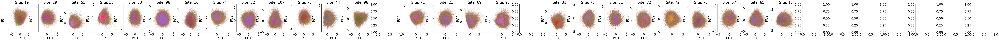

In [1099]:
# Plot all full single trial trajectories
fig, ax = plt.subplots(1,nrecs, figsize=(nrecs*4,4))
for irec in tqdm(range(nrecs)):
    if len(stable_unit_idx[irec]) > 2:
        # if len(np.squeeze(rotations[irec][0]).shape) == 3 and np.squeeze(rotations[irec][0]).shape[1]>2:
        temp_target_labels = np.array(df['target_idx'][(df['date']==dates[irec])*df['good_trial']])
        for itrial in range(len(temp_target_labels)):
            temp_proj_trial = zconc_pca[irec].transform(zconc_spikes_trial_sep[irec][itrial])
            ax[irec].plot(temp_proj_trial[:,0], temp_proj_trial[:,1], color=colors[temp_target_labels[itrial]], linewidth=0.1)
            ax[irec].set(xlabel='PC1', ylabel='PC2', title=f"Site: {recording_site[irec]}")

IndexError: list index out of range

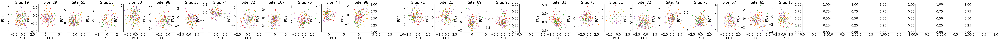

In [1108]:
# Plot points at target onset
fig, ax = plt.subplots(1,nrecs, figsize=(nrecs*4,4))
for irec in range(nrecs):
    if len(stable_unit_idx[irec]) > 2:
        temp_target_labels = np.array(df['target_idx'][(df['date']==dates[irec])*df['good_trial']])
        temp_pt_idxs = np.array(df['delay_start_neural_idx'][(df['date']==dates[irec])*df['good_trial']]).astype(int)
        for itrial in range(len(temp_target_labels)):
            temp_proj_trial = zconc_pca[irec].transform(zconc_spikes_trial_sep[irec][itrial])
            ax[irec].plot(temp_proj_trial[temp_pt_idxs[itrial],0], temp_proj_trial[temp_pt_idxs[itrial],1],'.', color=colors[temp_target_labels[itrial]])
            ax[irec].set(xlabel='PC1', ylabel='PC2', title=f"Site: {recording_site[irec]}")
fig.tight_layout()
plt.show()

# Plot points at target onset
fig, ax = plt.subplots(1,nrecs, figsize=(nrecs*4,4))
for irec in range(nrecs):
    if len(stable_unit_idx[irec]) > 2:
        temp_target_labels = np.array(df['target_idx'][(df['date']==dates[irec])*df['good_trial']])
        temp_pt_idxs = np.array(df['delay_start_neural_idx'][(df['date']==dates[irec])*df['good_trial']]).astype(int)
        for itrial in range(len(temp_target_labels)):
            temp_proj_trial = zconc_pca[irec].transform(zconc_spikes_trial_sep[irec][itrial])
            ax[irec].plot(temp_proj_trial[temp_pt_idxs[itrial],1], temp_proj_trial[temp_pt_idxs[itrial],2],'.', color=colors[temp_target_labels[itrial]])
            ax[irec].set(xlabel='PC2', ylabel='PC3', title=f"Site: {recording_site[irec]}")

fig.tight_layout()
plt.show()

In [ ]:
# Plot points at go cue
fig, ax = plt.subplots(1,nrecs, figsize=(nrecs*4,4))
for irec in range(nrecs):
    if len(stable_unit_idx[irec]) > 2:
        temp_target_labels = np.array(df['target_idx'][(df['date']==dates[irec])*df['good_trial']])
        temp_pt_idxs = np.array(df['go_cue_neural_idx'][(df['date']==dates[irec])*df['good_trial']]).astype(int)
        for itrial in range(len(temp_target_labels)):
            temp_proj_trial = zconc_pca[irec].transform(zconc_spikes_trial_sep[irec][itrial][:,stable_unit_idx[irec]])
            ax[irec].plot(temp_proj_trial[temp_pt_idxs[itrial],0], temp_proj_trial[temp_pt_idxs[itrial],1],'.', color=colors[temp_target_labels[itrial]])
            ax[irec].set(xlabel='PC1', ylabel='PC2', title=f"Site: {recording_site[irec]}")

In [ ]:
# Plot points at movement onset
fig, ax = plt.subplots(1,nrecs, figsize=(nrecs*4,4))
for irec in range(nrecs):
    if len(stable_unit_idx[irec]) > 2:
        temp_target_labels = np.array(df['target_idx'][(df['date']==dates[irec])*df['good_trial']])
        temp_pt_idxs = np.array(df['mov_onset_neural_idx'][(df['date']==dates[irec])*df['good_trial']]).astype(int)
        for itrial in range(len(temp_target_labels)):

            temp_proj_trial = zconc_pca[irec].transform(zconc_spikes_trial_sep[irec][itrial][:,stable_unit_idx[irec]])
            ax[irec].plot(temp_proj_trial[temp_pt_idxs[itrial],0], temp_proj_trial[temp_pt_idxs[itrial],1],'.', color=colors[temp_target_labels[itrial]])
            ax[irec].set(xlabel='PC1', ylabel='PC2', title=f"Site: {recording_site[irec]}")
fig.tight_layout()
plt.show()

fig, ax = plt.subplots(1,nrecs, figsize=(nrecs*4,4))
for irec in range(nrecs):
    if len(stable_unit_idx[irec]) > 2:
        temp_target_labels = np.array(df['target_idx'][(df['date']==dates[irec])*df['good_trial']])
        temp_pt_idxs = np.array(df['mov_onset_neural_idx'][(df['date']==dates[irec])*df['good_trial']]).astype(int)
        for itrial in range(len(temp_target_labels)):

            temp_proj_trial = zconc_pca[irec].transform(zconc_spikes_trial_sep[irec][itrial][:,stable_unit_idx[irec]])
            ax[irec].plot(temp_proj_trial[temp_pt_idxs[itrial],1], temp_proj_trial[temp_pt_idxs[itrial],2],'.', color=colors[temp_target_labels[itrial]])
            ax[irec].set(xlabel='PC2', ylabel='PC3', title=f"Site: {recording_site[irec]}")
fig.tight_layout()
plt.show()

## Subspace alignment

In [17]:
def compute_CCA(La, Lb):
    '''
    Implemented as described in Gallego 2020 (10.1038/s41593-019-0555-4)
    Args:
        La (ntime, nfeature): Latent dynamics from data A
        Lb (ntime, nfeature): Latent dynamics from data B
    '''
    # Compute Qr decomp to extract the orthonormal basis for the column vectors in the latent dynamics
    Qa, Ra = np.linalg.qr(La)
    Qb, Rb = np.linalg.qr(Lb)

    # Take inner product and perform SVD to get new manifold directions and correlations (S provdes the correlations)
    U, S, V = np.linalg.svd(Qa.T @ Qb)

    # Compute new manifold directions (Ma, Mb)
    Ma = np.linalg.pinv(Ra) @ U
    Mb = np.linalg.pinv(Rb) @ V
    
    # Project neural activity onto shared space:
    La_shared = Ma @ La
    Lb_shared = Mb @ Lb

    return Ma, Mb, S, La_shared, Lb_shared

from scipy.linalg import qr, svd, inv
def canoncorr_gallego(X:np.array, Y: np.array, fullReturn: bool = False) -> np.array:
    """
    Canonical Correlation Analysis (CCA)
    line-by-line port from Matlab implementation of `canoncorr`
    X,Y: (samples/observations) x (features) matrix, for both: X.shape[0] >> X.shape[1]
    fullReturn: whether all outputs should be returned or just `r` be returned (not in Matlab)
    
    returns: A,B,r,U,V 
    A,B: Canonical coefficients for X and Y
    U,V: Canonical scores for the variables X and Y
    r:   Canonical correlations
    
    Signature:
    A,B,r,U,V = canoncorr(X, Y)
    """
    n, p1 = X.shape
    p2 = Y.shape[1]
    if p1 >= n or p2 >= n:
        logging.warning('Not enough samples, might cause problems')

    # Center the variables
    X = X - np.mean(X,0)
    Y = Y - np.mean(Y,0)

    # Factor the inputs, and find a full rank set of columns if necessary
    Q1,T11,perm1 = qr(X, mode='economic', pivoting=True, check_finite=True)

    rankX = sum(np.abs(np.diagonal(T11)) > np.finfo(type((np.abs(T11[0,0])))).eps*max([n,p1]))

    if rankX == 0:
        logging.error(f'stats:canoncorr:BadData = X')
    elif rankX < p1:
        logging.warning('stats:canoncorr:NotFullRank = X')
        Q1 = Q1[:,:rankX]
        T11 = T11[:rankX,:rankX]

    Q2,T22,perm2 = qr(Y, mode='economic', pivoting=True, check_finite=True)
    rankY = sum(np.abs(np.diagonal(T22)) > np.finfo(type((np.abs(T22[0,0])))).eps*max([n,p2]))

    if rankY == 0:
        logging.error(f'stats:canoncorr:BadData = Y')
    elif rankY < p2:
        logging.warning('stats:canoncorr:NotFullRank = Y')
        Q2 = Q2[:,:rankY]
        T22 = T22[:rankY,:rankY]

    # Compute canonical coefficients and canonical correlations.  For rankX >
    # rankY, the economy-size version ignores the extra columns in L and rows
    # in D. For rankX < rankY, need to ignore extra columns in M and D
    # explicitly. Normalize A and B to give U and V unit variance.
    d = min(rankX,rankY)
    L,D,M = svd(Q1.T @ Q2, full_matrices=True, check_finite=True, lapack_driver='gesdd')
    M = M.T

    A = inv(T11) @ L[:,:d] * np.sqrt(n-1)
    B = inv(T22) @ M[:,:d] * np.sqrt(n-1)
    r = D[:d]
    # remove roundoff errs
    r[r>=1] = 1
    r[r<=0] = 0

    if not fullReturn:
        return r

    # Put coefficients back to their full size and their correct order
    A[perm1,:] = np.vstack((A, np.zeros((p1-rankX,d))))
    B[perm2,:] = np.vstack((B, np.zeros((p2-rankY,d))))
    
    # Compute the canonical variates
    U = X @ A
    V = Y @ B

    return A, B, r, U, V

def calc_task_rel_dims(neural_data, kin_data, conc_proj_data=False, regularization=None, alpha=1, lags=None, fit_intercept=True):
    '''
    Calculates the task relevant dimensions by regressing neural activity against kinematic data using least squares.
    If the input neural data is 3D, all trials will be concatenated to calculate the subspace. 
    Calculation is based on the approach used in Sun et al. 2022 https://doi.org/10.1038/s41586-021-04329-x
    
    .. math::
    
        R \\in \\mathbb{R}^{nt \\times nch}
        M \\in \\mathbb{R}^{nt \\times nkin}
        \\beta \\in \\mathbb{R}^{nch \\times nkin}
        R = M\\beta^T
        [\\beta_0 \beta_x \beta_y]^T = (M^T M)^{-1} M^T R

    Args:
        neural_data ((nt, nch) or list of (nt, nch)): Input neural data (:math:`R`) to regress against kinematic activity.
        kin_data ((nt, ndim) or list of (nt, ndim)): Kinematic variables (:math:`M`), commonly position or instantaneous velocity. 'ndims' refers to the number of physical dimensions that define the kinematic data (i.e. X and Y)
        conc_proj_data (bool): If the projected neural data should be concatenated.

    Returns:
        tuple: Tuple containing:
            | **(nch, ndim):** Subspace (:math:`\beta`) that best predicts kinematic variables. Note the first column represents the intercept, then the next dimensions represent the behvaioral variables
            | **((nt, nch) or list of (nt, ndim)):** Neural data projected onto task relevant subspace

    '''

    # If a list of segments from trials, concatenate them into one larget timeseries
    if type(neural_data) == list: # check centering of neural activity
        ntrials = len(neural_data)
        min_time_per_trial = [np.min([len(neural_data[itrial]), len(kin_data[itrial])]) for itrial in range(ntrials)]
        
        conc_neural_data = np.vstack([neural_data[itrial][:min_time_per_trial[itrial]] for itrial in range(ntrials)]) #(nt, nch)
        conc_kin_data_baseline = np.vstack([kin_data[itrial][:min_time_per_trial[itrial]] for itrial in range(ntrials)])
        if conc_neural_data.shape[0] != conc_kin_data_baseline.shape[0]:
            print(f"Neural and kinematic data sizes are {np.abs(conc_neural_data.shape[0]-conc_kin_data_baseline.shape[0])} samples apart")
        
        ntime = np.min([conc_neural_data.shape[0], conc_kin_data_baseline.shape[0]])
        
        # Set input neural data as a float
        conc_neural_data = conc_neural_data.astype(float)[:ntime,:]

        if fit_intercept:
            conc_kin_data = np.ones((ntime,kin_data[0].shape[1]+1))*np.nan
            conc_kin_data[:,0] = 1
            conc_kin_data[:,1:] = conc_kin_data_baseline
        else:
            conc_kin_data = conc_kin_data_baseline

        # Center neural data:
        conc_neural_data -= np.nanmean(conc_neural_data, axis=0)

        # Calculate task relevant subspace 
        # task_subspace = np.linalg.pinv(conc_kin_data.T @ conc_kin_data) @ conc_kin_data.T @ conc_neural_data
        if regularization is None:        
            # task_subspace = np.linalg.pinv(conc_neural_data.T @ conc_neural_data) @ conc_neural_data.T @ conc_kin_data
            lin_reg_model = sklearn.linear_model.LinearRegression(fit_intercept=False).fit(conc_neural_data, conc_kin_data)
            task_subspace = (lin_reg_model.coef_).T
        elif regularization == 'lasso':
            lasso_model = sklearn.linear_model.Lasso(alpha=alpha, max_iter=10000).fit(conc_neural_data, conc_kin_data)
            task_subspace = (lasso_model.coef_).T
        elif regularization == 'ridge':
            ridge_model = sklearn.linear_model.Ridge(alpha=alpha, max_iter=10000).fit(conc_neural_data, conc_kin_data)
            task_subspace = (ridge_model.coef_).T
        elif regularization == 'elastic net':
            elasticnet_model = sklearn.linear_model.ElasticNet(alpha=alpha, max_iter=10000).fit(conc_neural_data, conc_kin_data)
            task_subspace = (elasticnet_model.coef_).T
    
    else:
        # Save original neural data as a list
        neural_data = [neural_data]
        
        # Set input neural data as a float
        neural_data_centered = copy.deepcopy(neural_data[0].astype(float))

        # Center neural data:
        neural_data_centered -= np.nanmean(neural_data_centered, axis=0)
        ntime = neural_data_centered.shape[0]
        
        if fit_intercept:
            conc_kin_data = np.ones((ntime,kin_data.shape[1]+1))*np.nan
            conc_kin_data[:,0] = 1
            conc_kin_data[:,1:] = kin_data
        else:
            conc_kin_data = kin_data
        if lags is not None and lags!=0:
            for ilag in range(lags):
                if ilag == 0:
                    lagged_ndc = neural_data_centered[lags:,:]
                else:
                    lagged_ndc = np.concatenate((lagged_ndc, neural_data_centered[lags-ilag:-ilag,:]), axis=1)
        
            neural_data_centered = lagged_ndc
        
        # Calculate task relevant subspace 
        print(neural_data_centered.shape, conc_kin_data[lags:,:].shape)
        if regularization is None:
            task_subspace = np.linalg.pinv(neural_data_centered.T @ neural_data_centered) @ neural_data_centered.T @ conc_kin_data[lags:,:]
        elif regularization == 'lasso':
            lasso_model = sklearn.linear_model.Lasso(alpha=alpha, max_iter=10000).fit(neural_data_centered, conc_kin_data[lags:,:])
            task_subspace = (lasso_model.coef_).T
        elif regularization == 'ridge':
            ridge_model = sklearn.linear_model.Ridge(alpha=alpha, max_iter=10000).fit(neural_data_centered, conc_kin_data[lags:,:])
            task_subspace = (ridge_model.coef_).T
        elif regularization == 'elastic net':
            elasticnet_model = sklearn.linear_model.ElasticNet(alpha=alpha, max_iter=10000).fit(neural_data_centered, conc_kin_data[lags:,:])
            task_subspace = (elasticnet_model.coef_).T
        ntrials = 1
        
    # Project neural data onto task subspace
    projected_data = []

    for itrial in range(ntrials):
        if lags is not None  and lags!=0:
            for ilag in range(lags):
                if ilag == 0:
                    trial_neural_data = neural_data_centered[lags:,:]
                else:
                    trial_neural_data = np.concatenate((trial_neural_data, neural_data_centered[lags-ilag:-ilag,:]), axis=1)
            projected_data.append(trial_neural_data @ task_subspace)        
        else:
            projected_data.append(neural_data[itrial] @ task_subspace)

    
    if conc_proj_data:
        return task_subspace, np.vstack(projected_data)
    else:    
        return task_subspace, projected_data
    
def weiner_filter(neural_data, kin_data, regularization=None, alpha=1, lags=None,fit_intercept=True):
    '''
    Calculates the task relevant dimensions by regressing neural activity against kinematic data using least squares.
    If the input neural data is 3D, all trials will be concatenated to calculate the subspace. 
    Calculation is based on the approach used in Sun et al. 2022 https://doi.org/10.1038/s41586-021-04329-x
    
    .. math::
    
        R \\in \\mathbb{R}^{nt \\times nch}
        M \\in \\mathbb{R}^{nt \\times nkin}
        \\beta \\in \\mathbb{R}^{nch \\times nkin}
        R = M\\beta^T
        [\\beta_0 \beta_x \beta_y]^T = (M^T M)^{-1} M^T R

    Args:
        neural_data ((nt, nch)): Input neural data (:math:`R`) to regress against kinematic activity.
        kin_data ((nt, ndim)): Kinematic variables (:math:`M`), commonly position or instantaneous velocity. 'ndims' refers to the number of physical dimensions that define the kinematic data (i.e. X and Y)
        conc_proj_data (bool): If the projected neural data should be concatenated.

    Returns:
        tuple: Tuple containing:
            | **(nch, ndim):** Subspace (:math:`\beta`) that best predicts kinematic variables. Note the first column represents the intercept, then the next dimensions represent the behvaioral variables
            | **((nt, nch) or list of (nt, ndim)):** Neural data projected onto task relevant subspace

    '''        
    # Set input neural data as a float
    neural_data_centered = copy.deepcopy(neural_data.astype(float))

    # Center neural data:
    neural_data_centered -= np.nanmean(neural_data_centered, axis=0)
    ntime = neural_data_centered.shape[0]
    if fit_intercept:
        conc_kin_data = np.ones((ntime, kin_data.shape[1]+1))*np.nan
        conc_kin_data[:,0] = 1
        conc_kin_data[:,1:] = kin_data
    else:
        conc_kin_data = kin_data


    if lags is not None and lags!=0:
        for ilag in range(lags):
            if ilag == 0:
                lagged_ndc = neural_data_centered[lags:,:]
            else:
                lagged_ndc = np.concatenate((lagged_ndc, neural_data_centered[lags-ilag:-ilag,:]), axis=1)

        neural_data_centered = lagged_ndc

    if regularization is None:
        task_subspace = np.linalg.pinv(neural_data_centered.T @ neural_data_centered) @ neural_data_centered.T @ conc_kin_data[lags:,:]
    elif regularization == 'lasso':
        lasso_model = sklearn.linear_model.Lasso(alpha=alpha, max_iter=10000).fit(neural_data_centered, conc_kin_data[lags:,:])
        task_subspace = (lasso_model.coef_).T
    elif regularization == 'ridge':
        ridge_model = sklearn.linear_model.Ridge(alpha=alpha, max_iter=10000).fit(neural_data_centered, conc_kin_data[lags:,:])
        task_subspace = (ridge_model.coef_).T
    elif regularization == 'elastic net':
        elasticnet_model = sklearn.linear_model.ElasticNet(alpha=alpha, max_iter=10000).fit(neural_data_centered, conc_kin_data[lags:,:])
        task_subspace = (elasticnet_model.coef_).T
        
    projected_data = neural_data_centered @ task_subspace
    
    return task_subspace, projected_data
def make_lagged_matrix(data, lags):
    if lags == 0:
        return data
    else:
        for ilag in range(lags):
            if ilag == 0:
                lagged_data = data[lags:,:]
            else:
                lagged_data = np.concatenate((lagged_data, data[lags-ilag:-ilag,:]), axis=1)

        return lagged_data

In [18]:
tavg_time = .5 #[s]
# neural_onset_idx_labels = ['delay_start_neural_idx', 'go_cue_neural_idx', 'mov_onset_neural_idx']
# kin_onset_idx_labels = ['delay_start_kin_idx', 'go_cue_kin_idx', 'mov_onset_kin_idx']
neural_onset_idx_labels = 'mov_onset_neural_idx'
kin_onset_idx_labels = 'mov_onset_kin_idx'


for irec in tqdm(range(nrecs)):
    neural_idx_start = int(preproc_metadata['tbefore']*preproc_metadata['neural_samplerate'])
    neural_idx_stop = int((tavg_time*preproc_metadata['neural_samplerate'])) + neural_idx_start        
    neural_data = rasters['neural'][align_event][irec][neural_idx_start:neural_idx_stop,np.array(df['good_trial'][df['penetration']==irec])][:,:,stable_unit_idx[irec]]

    kin_idx_start = int(preproc_metadata['tbefore']*preproc_metadata['kin_samplerate'])
    kin_idx_stop = int((tavg_time*preproc_metadata['kin_samplerate'])) + kin_idx_start
    # kin_data = rasters['cursor_velo'][align_event][irec][kin_idx_start:kin_idx_stop,np.array(df['good_trial'][df['date']==date])]
    kin_data = rasters['cursor_pos'][align_event][irec][kin_idx_start:kin_idx_stop,np.array(df['good_trial'][df['penetration']==irec])]
    # hand_data = rasters['hand_velo'][align_event][irec][kin_idx_start:kin_idx_stop,np.array(df['good_trial'][df['penetration']==irec])]

    # test = calc_task_rel_dims(neural_data, kin_data, conc_proj_data=False, regularization=None, alpha=1)
    # scores, test_move_tavg, test_pred_move_tavg, subspace =  xval_task_rel_dims(neural_data, kin_data, labels=np.array(df['target_idx'][(df['date']==date)*df['good_trial']])  ,regularization=None, nfolds=4, alpha=1, smooth_neural_data=False, tavg_neural_data=False, return_test_label_idx=False)
    # scores_hand, test_move_tavg_hand, test_pred_move_tavg_hand, subspace_hand, test_label_idx_hand =  xval_task_rel_dims(neural_data, hand_data, labels=np.array(df['target_idx'][(df['date']==date)*df['good_trial']])  ,regularization=None, nfolds=4, alpha=1, smooth_neural_data=False, tavg_neural_data=True, return_test_label_idx=True)

    

  0%|          | 0/16 [00:00<?, ?it/s]

In [19]:
# Compute CCs the same way as Gallego paper
np.random.seed(0)
cca_bin_fs = preproc_metadata['neural_samplerate']
tbefore_cca = 0.05
tafter_cca = .25
kernel_width = 150 # 
nmodes_plot = 3
order_trials = True
shuffle_trials = True
ntrials_per_target = 28
unique_targets = np.unique(np.array(df['target_idx'][df['good_trial']*(df['penetration']==0)]))
ntargets = len(unique_targets)
trials_idx = np.arange(ntrials_per_target*len(unique_targets))
if shuffle_trials:
    np.random.shuffle(trials_idx)
    
prep_data_all = {}
tavg_prep_data = {}
tavg_velo_data = {}
tavg_pos_data = {}
proj_data = {}
proj_data_tidx1 = {}
proj_data_tidx2 = {}
pos_data_all = {}
velo_data_all = {}
target_data_all = {}
neural_data_all = {}
proj_trd_data = {}
trd_subspace = {}
score_all = {}
# align_event = align_events[-1]
for align_event in align_events:
    tavg_prep_data[align_event] = []
    tavg_pos_data[align_event] = []
    tavg_velo_data[align_event] = []
    prep_data_all[align_event] = []
    proj_data[align_event] = []
    proj_data_tidx1[align_event] = []
    proj_data_tidx2[align_event] = []
    pos_data_all[align_event] = []
    velo_data_all[align_event] = []
    target_data_all[align_event] = []
    neural_data_all[align_event] = []
    proj_trd_data[align_event] = []
    trd_subspace[align_event] = []
    score_all[align_event] = []
    for irec in tqdm(range(nrecs)):
    # for irec in tqdm(range(6)):
        if len(stable_unit_idx[irec]) > 0:
            # Prepare neural activity    
            # neural_data = rasters['neural'][align_event][irec][:,np.array(df['good_trial'][df['penetration']==irec])][:,:,stable_unit_idx[irec]]/preproc_metadata['neural_samplerate'] # use spike counts like gallego paper
            neural_data = fr_zscore[align_event]['align_spikes_zscore'][irec]

            # Compute low firing units for each day
            fr_neural_data = rasters['neural'][align_event][irec][:,np.array(df['good_trial'][df['penetration']==irec])][:,:,stable_unit_idx[irec]]
            nt, ntr, nunit = fr_neural_data.shape
            unit_fr = ((np.sum(fr_neural_data, axis=(0,1))/(nt*ntr))).flatten()
            high_fr_unit_mask = unit_fr >= 1
            if np.sum(unit_fr < 1) > 0:
                print(f"Number of low FR units: {np.sum(unit_fr < 1)}")

            if cca_bin_fs < preproc_metadata['neural_samplerate']:
                neural_data_resample = np.sqrt(aopy.precondition.downsample(neural_data[:,:,high_fr_unit_mask], preproc_metadata['neural_samplerate'], cca_bin_fs))
                new_time_axis = (np.arange(neural_data_resample.shape[0])/cca_bin_fs) - preproc_metadata['tbefore']
                smoothed_neural_data = smooth_timeseries_gaus(neural_data_resample, cca_bin_fs, kernel_width, conv_mode='valid')
            else:
                smoothed_neural_data = smooth_timeseries_gaus(neural_data[:,:,high_fr_unit_mask], cca_bin_fs, kernel_width, conv_mode='valid')
                new_time_axis = (np.arange(neural_data.shape[0])/cca_bin_fs) - preproc_metadata['tbefore']


            kernel_size = int(cca_bin_fs*kernel_width/1000)
            neural_idx_start = np.where(new_time_axis >= -tbefore_cca)[0][0] - kernel_size
            neural_idx_stop = np.where(new_time_axis <= tafter_cca)[0][-1]- kernel_size
            unique_targets = np.unique(np.array(df['target_idx'][df['good_trial']*(df['penetration']==irec)]))
            # if cca_bin_fs < preproc_metadata['neural_samplerate']:
            prep_data = []
            target_data = []
            if order_trials: 
                trials = []
                temp_tavg_trials = np.zeros((neural_idx_stop-neural_idx_start, len(unique_targets), neural_data.shape[2]))*np.nan
                for itarget, target in enumerate(unique_targets):
                    target_trial_idx = np.where(np.array(df['target_idx'][df['good_trial']*(df['penetration']==irec)]) == target)[0]
                    # trials.extend(target_trial_idx[:ntrials_per_target])
                    trials.extend(np.random.choice(target_trial_idx, ntrials_per_target, replace=False)) # Randomly sample trials from across acceptable trials within session
                    temp_tavg_trials[:,itarget,:] = np.mean(smoothed_neural_data[neural_idx_start:neural_idx_stop,target_trial_idx,:], axis=1)
                    
                trials = np.array(trials)
                if shuffle_trials:
                    trials = trials[trials_idx]
                    # np.random.shuffle(trials)

                for trial_idx in trials:
                    target_data.extend([list(df['target_idx'][df['good_trial']*(df['penetration']==irec)])[trial_idx]] * (neural_idx_stop-neural_idx_start))
                    prep_data.extend(smoothed_neural_data[neural_idx_start:neural_idx_stop,trial_idx,:])

            else:

                for itrial in range(neural_data.shape[1]):
                    target_data.extend([list(df['target_idx'][df['good_trial']*(df['penetration']==irec)])[itrial]] * (neural_idx_stop-neural_idx_start))
                    prep_data.extend(smoothed_neural_data[neural_idx_start:neural_idx_stop,itrial,:])
    #
            prep_data = np.array(prep_data)
            tavg_prep_data[align_event].append(temp_tavg_trials)
            prep_data_all[align_event].append(prep_data)
            target_data_all[align_event].append(np.array(target_data))
            neural_data_all[align_event].append(prep_data)

            # Compute latent dynamics of neural activity
            ntime_split = prep_data.shape[0]//2
            tidx1 = np.arange(ntime_split)
            tidx2 = np.arange(ntime_split, prep_data.shape[0])
            proj_data[align_event].append(PCA(svd_solver='full').fit_transform(prep_data/np.std(prep_data,axis=0)))
            proj_data_tidx1[align_event].append(PCA(svd_solver='full').fit_transform(prep_data[tidx1,:]))
            proj_data_tidx2[align_event].append(PCA(svd_solver='full').fit_transform(prep_data[tidx2,:]))

            # Prepare kinematics
            kin_idx_start = int((preproc_metadata['tbefore']-tbefore_cca)*preproc_metadata['kin_samplerate'])
            kin_idx_stop = int((tafter_cca*preproc_metadata['kin_samplerate'])) + int(preproc_metadata['tbefore']*preproc_metadata['kin_samplerate'])    
            pos_data = []
            velo_data = []
            conc_pos = []

            if order_trials: 
                for trial_idx in trials:
                    pos_data.extend(aopy.precondition.downsample(rasters['cursor_pos'][align_event][irec][kin_idx_start:kin_idx_stop,np.array(df['good_trial'][df['penetration']==irec])], preproc_metadata['kin_samplerate'], cca_bin_fs)[:,trial_idx,:])
                    velo_data.extend(aopy.precondition.downsample(rasters['cursor_velo'][align_event][irec][kin_idx_start:kin_idx_stop,np.array(df['good_trial'][df['penetration']==irec])], preproc_metadata['kin_samplerate'], cca_bin_fs)[:,trial_idx,:])
                
                temp_tavg_pos = np.zeros((neural_idx_stop-neural_idx_start, ntargets, 2))*np.nan
                temp_tavg_velo = np.zeros((neural_idx_stop-neural_idx_start, ntargets, 2))*np.nan
                for itarget in range(ntargets):
                    target_trial_idx = np.array((df['target_idx'][df['good_trial']*(df['penetration']==irec)])) == (itarget+1)
                    temp_tavg_pos[:,itarget,:] = np.mean(aopy.precondition.downsample(rasters['cursor_pos'][align_event][irec][kin_idx_start:kin_idx_stop,np.array(df['good_trial'][df['penetration']==irec])], preproc_metadata['kin_samplerate'], cca_bin_fs)[:,target_trial_idx,:2], axis=1)
                    temp_tavg_velo[:,itarget,:] = np.mean(aopy.precondition.downsample(rasters['cursor_velo'][align_event][irec][kin_idx_start:kin_idx_stop,np.array(df['good_trial'][df['penetration']==irec])], preproc_metadata['kin_samplerate'], cca_bin_fs)[:,target_trial_idx,:], axis=1)
                    
                pos_data_all[align_event].append(np.array(pos_data))
                velo_data_all[align_event].append(np.array(velo_data))
                tavg_pos_data[align_event].append(temp_tavg_pos)
                tavg_velo_data[align_event].append(temp_tavg_velo)

            else:
                for itrial in tqdm(range(neural_data.shape[1])):
                    pos_data.extend(aopy.precondition.downsample(rasters['cursor_pos'][align_event][irec][kin_idx_start:kin_idx_stop,np.array(df['good_trial'][df['penetration']==irec])], preproc_metadata['kin_samplerate'], cca_bin_fs)[:,itrial,:2])
                    velo_data.extend(aopy.precondition.downsample(rasters['cursor_velo'][align_event][irec][kin_idx_start:kin_idx_stop,np.array(df['good_trial'][df['penetration']==irec])], preproc_metadata['kin_samplerate'], cca_bin_fs)[:,itrial,:])

                pos_data_all[align_event].append(np.array(pos_data))
                velo_data_all[align_event].append(np.array(velo_data))

            # hand_data = rasters['hand_velo'][align_event][irec][kin_idx_start:kin_idx_stop,np.array(df['good_trial'][df['penetration']==irec])]
            trdsubspace, trd_proj_data_temp = calc_task_rel_dims(prep_data, np.array(pos_data), conc_proj_data=False, regularization=None, alpha=1, fit_intercept=True)
            trd_subspace[align_event].append(trdsubspace)
            proj_trd_data[align_event].append(trd_proj_data_temp[0])

        else:
            tavg_prep_data[align_event].append([])
            tavg_pos_data[align_event].append([])
            tavg_velo_data[align_event].append([])
            proj_data[align_event].append([])
            proj_data_tidx1[align_event].append([])
            proj_data_tidx2[align_event].append([])
            proj_trd_data[align_event].append([])
            pos_data_all[align_event].append([])
            velo_data_all[align_event].append([])
            neural_data_all[align_event].append([])
            target_data_all[align_event].append([])
            trd_subspace[align_event].append([])
            prep_data_all[align_event].append([])

  0%|          | 0/16 [00:00<?, ?it/s]

(6720, 17) (6720, 3)
(6720, 60) (6720, 3)
(6720, 49) (6720, 3)
(6720, 19) (6720, 3)
(6720, 133) (6720, 3)
(6720, 106) (6720, 3)
(6720, 39) (6720, 3)
(6720, 65) (6720, 3)
(6720, 27) (6720, 3)
(6720, 87) (6720, 3)
(6720, 40) (6720, 3)
(6720, 26) (6720, 3)
(6720, 26) (6720, 3)
(6720, 70) (6720, 3)
(6720, 114) (6720, 3)
(6720, 35) (6720, 3)


  0%|          | 0/16 [00:00<?, ?it/s]

(6720, 17) (6720, 3)
(6720, 60) (6720, 3)
(6720, 49) (6720, 3)
(6720, 19) (6720, 3)
(6720, 133) (6720, 3)
(6720, 106) (6720, 3)
(6720, 39) (6720, 3)
(6720, 65) (6720, 3)
(6720, 27) (6720, 3)
(6720, 87) (6720, 3)
(6720, 40) (6720, 3)
(6720, 26) (6720, 3)
(6720, 26) (6720, 3)
(6720, 70) (6720, 3)
(6720, 114) (6720, 3)
(6720, 35) (6720, 3)


  0%|          | 0/16 [00:00<?, ?it/s]

(6720, 17) (6720, 3)
(6720, 60) (6720, 3)
(6720, 49) (6720, 3)
(6720, 19) (6720, 3)
(6720, 133) (6720, 3)
(6720, 106) (6720, 3)
(6720, 39) (6720, 3)
(6720, 65) (6720, 3)
(6720, 27) (6720, 3)
(6720, 87) (6720, 3)
(6720, 40) (6720, 3)
(6720, 26) (6720, 3)
(6720, 26) (6720, 3)
(6720, 70) (6720, 3)
(6720, 114) (6720, 3)
(6720, 35) (6720, 3)


### PC projection alignment

In [20]:
recording_site_M1 = [isite for isite in recording_site if isite in recording_brain_areas['M1']]
recording_site_PM = [isite for isite in recording_site if isite in recording_brain_areas['PM']]
nrecs_M1 = len(recording_site_M1)
nrecs_PM = len(recording_site_PM)

In [21]:
npcs = 10
nmin_units = 15
ccs = {}
ccs_trd = {}
for align_event in align_events:
    ccs[align_event] = np.zeros((nrecs, nrecs, npcs))*np.nan
    # cca_proj_data = np.zeros((nrecs, nrecs, proj_data[0].shape[0], npcs))*np.nan
    ccs_trd[align_event] = np.zeros((nrecs, nrecs, 2))*np.nan
    np_acc_arg_sort = np.argsort(max_np_decoding[align_event])
    # np_acc_arg_sort = np.arange(nrecs)
    for irec in tqdm(range(nrecs)):
        for irec2 in range(nrecs):
            # if proj_data[irec].shape[1] >= 5 and proj_data[irec2].shape[1] >=5:
            if len(proj_trd_data[align_event][irec]) > 0 and len(proj_trd_data[align_event][irec2]) > 0:
                if proj_data[align_event][irec].shape[1] >= npcs and proj_data[align_event][irec2].shape[1] >= npcs:           

                    # for ipc in range(npcs):
                    # Ma, Mb, S = compute_CCA(proj_data[irec][:,:npcs], proj_data[irec2][:,:npcs])
                    S = canoncorr_gallego(proj_data[align_event][irec][:,:npcs], proj_data[align_event][irec2][:,:npcs])
                    ccs[align_event][irec,irec2,:] =S[:npcs]
                    # cca_proj_data[irec,irec2,:,:] = proj_data[irec2][:,:npcs] @ Mb @ np.linalg.pinv(Ma) # Only project onto the first npc planes
                    # cca_proj_data[irec,irec2,:,:] = proj_data[irec2][:,:npcs] @ Mb[:npcs,:][:,:npcs] @ np.linalg.pinv(Ma)[:npcs,:][:,:npcs] # Only project onto the first npc planes

                    # Ma_trd, Mb_trd, S_trd = compute_CCA(proj_trd_data[align_event][irec][:,1:], proj_trd_data[align_event][irec2][:,1:])
                    # S_trd = canoncorr_gallego(proj_trd_data[irec][:,1:], proj_trd_data[irec2][:,1:])
                    # ccs_trd[align_event][irec,irec2,:] = S_trd[:2]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

In [22]:
niterations = 100
ccs_control_units = {}
ccs_control_units_sd = {}
for align_event in align_events:
    ccs_control_units[align_event] = np.zeros((nrecs, nrecs, npcs))*np.nan
    ccs_control_units_sd[align_event] = np.zeros((nrecs, nrecs, npcs))*np.nan

    for irec in tqdm(range(nrecs)):
        for irec2 in range(nrecs):
            # if proj_data[irec].shape[1] >= 5 and proj_data[irec2].shape[1] >=5:
            if len(prep_data_all[align_event][irec]) > 0 and len(prep_data_all[align_event][irec2]) > 0:
                if prep_data_all[align_event][irec].shape[1] >= nmin_units and prep_data_all[align_event][irec2].shape[1] >= nmin_units:
                    temp_ccs = np.zeros((niterations, npcs))*np.nan
                    for iiter in range(niterations):
                        np.random.seed(iiter)
                        nunits1 = prep_data_all[align_event][irec].shape[1]
                        nunits2 = prep_data_all[align_event][irec2].shape[1]
                        random_unit_idx1 = np.random.choice(np.arange(nunits1), nmin_units, replace=False)
                        random_unit_idx2 = np.random.choice(np.arange(nunits2), nmin_units, replace=False)
                        proj_data1 = PCA(svd_solver='full').fit_transform(prep_data_all[align_event][irec][:,random_unit_idx1]/np.std(prep_data_all[align_event][irec][:,random_unit_idx1],axis=0))
                        proj_data2 = PCA(svd_solver='full').fit_transform(prep_data_all[align_event][irec2][:,random_unit_idx2]/np.std(prep_data_all[align_event][irec2][:,random_unit_idx2],axis=0))                

                        temp_ccs[iiter,:] = canoncorr_gallego(proj_data1[:,:npcs], proj_data2[:,:npcs])

                    ccs_control_units[align_event][irec,irec2,:] = np.mean(temp_ccs, axis=0)
                    ccs_control_units_sd[align_event][irec,irec2,:] = np.std(temp_ccs, axis=0)

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

In [142]:
all_prep_data = {}
for align_event in align_events:
    all_prep_data_temp = []
    for irec in range(nrecs):
        if len(prep_data_all[align_event][irec]) > 0:
            all_prep_data_temp.append(prep_data_all[align_event][irec])
    all_prep_data[align_event] = np.concatenate(all_prep_data_temp, axis=1)

In [143]:
niterations = 100
npcs = 10
nmin_units = 15
ccs_control_units_column = {}
ccs_control_units_column_sd = {}
proj_data_columns = {}
nsites = len(column_units)
ntime = all_prep_data[align_event].shape[0]
for align_event in align_events:
    ccs_control_units_column[align_event] = np.zeros((nsites, nsites, npcs))*np.nan
    ccs_control_units_column_sd[align_event] = np.zeros((nsites, nsites, npcs))*np.nan
    for isite in tqdm(range(nsites)):
        for isite2 in range(nsites):
            if len(column_units[isite]) >= nmin_units and len(column_units[isite2]) >= nmin_units:
                temp_ccs = np.zeros((niterations, npcs))*np.nan
                for iiter in range(niterations):
                    np.random.seed(iiter)
                    random_unit_idx1 = np.random.choice(np.array(column_units[isite]['index']), nmin_units, replace=False)
                    if isite == isite2:
                        random_unit_idx2=random_unit_idx1
                    random_unit_idx2 = np.random.choice(np.array(column_units[isite2]['index']), nmin_units, replace=False)
                    proj_data1 = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,random_unit_idx1]/np.std(all_prep_data[align_event][:,random_unit_idx1],axis=0))
                    proj_data2 = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,random_unit_idx2]/np.std(all_prep_data[align_event][:,random_unit_idx2],axis=0))                

                    temp_ccs[iiter,:] = canoncorr_gallego(proj_data1[:,:npcs], proj_data2[:,:npcs])
                    
                ccs_control_units_column[align_event][isite,isite2,:] = np.mean(temp_ccs, axis=0)
                ccs_control_units_column_sd[align_event][isite,isite2,:] = np.std(temp_ccs, axis=0)

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

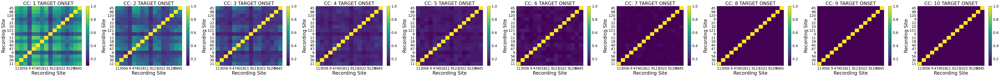

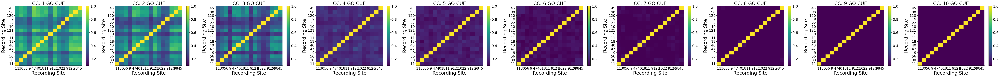

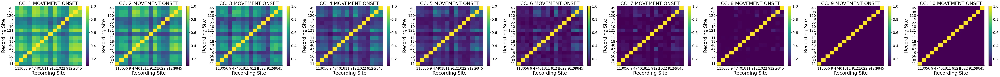

In [144]:
for align_event in align_events:
    fig, ax = plt.subplots(1, npcs, figsize=(npcs*9, 5.5))
    for ipc in range(npcs):
        im = ax[ipc].pcolor(ccs[align_event][:,:,ipc], vmin=0.1, vmax=1)
        cb = plt.colorbar(im)
        ax[ipc].set_xticks(np.arange(nrecs)+0.5, recording_site)
        ax[ipc].set_yticks(np.arange(nrecs)+0.5, recording_site)
        ax[ipc].set(xlabel='Recording Site', ylabel='Recording Site', title=f"CC: {ipc+1} {align_event}")

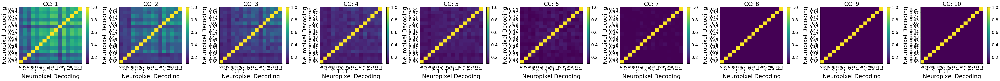

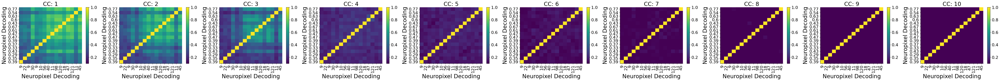

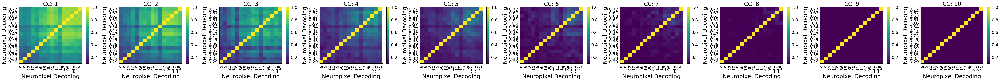

In [145]:
# Sort by NP accuracy
for align_event in align_events:
    fig, ax = plt.subplots(1, npcs, figsize=(npcs*6, 5))
    for ipc in range(npcs):
        np_acc_arg_sort = np.argsort(max_np_decoding[align_event])
        im = ax[ipc].pcolor(ccs[align_event][np_acc_arg_sort,:,:][:,np_acc_arg_sort,ipc], vmin=0.1, vmax=1)
        cb = plt.colorbar(im)
        ax[ipc].set_xticks(np.arange(nrecs)+0.5, recording_site[np_acc_arg_sort], rotation = 90)
        ax[ipc].set_yticks(np.arange(nrecs)+0.5, np.round(np.array(max_np_decoding[align_events[-1]])[np_acc_arg_sort], 2))
        ax[ipc].set(xlabel='Neuropixel Decoding', ylabel='Neuropixel Decoding', title=f"CC: {ipc+1}")

    fig.tight_layout()
    plt.show()

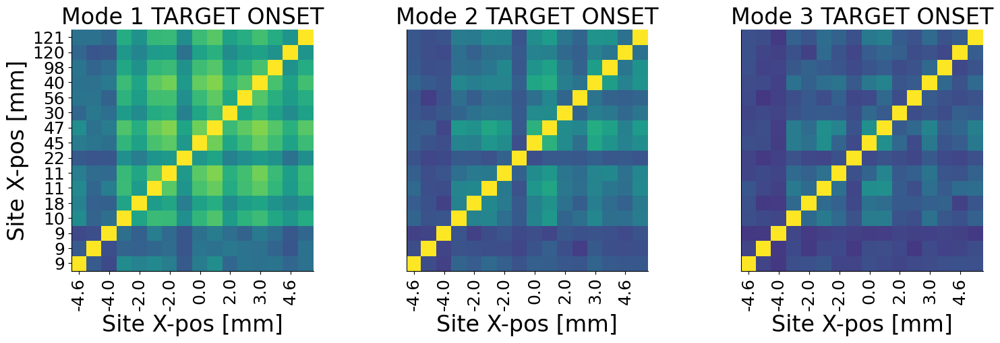

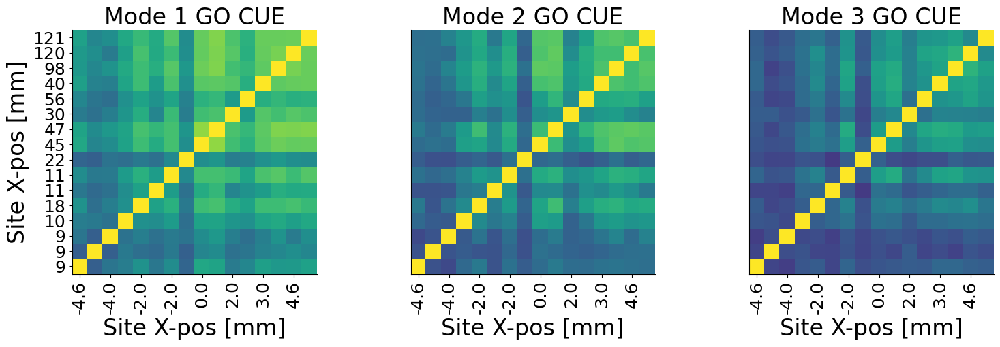

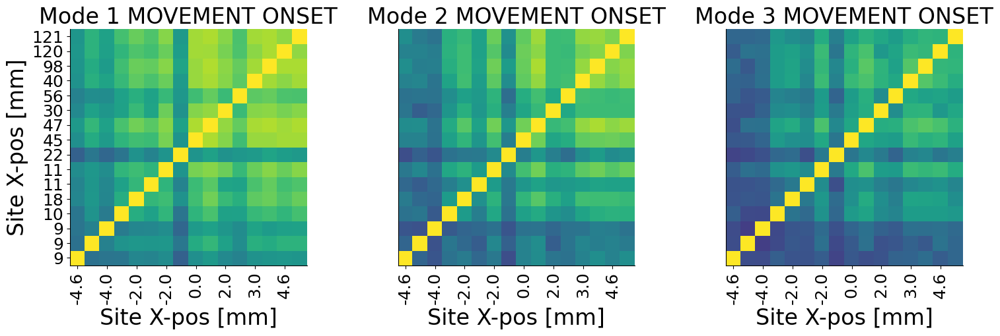

In [146]:
# Sort by caudal to rostral
cr_sort = np.argsort(ecog_dec_acc[subject]['rc_axis'][:,0])
for align_event in align_events:
    fig, ax = plt.subplots(1, 3, figsize=(16.,5))
    for ipc in range(3):
        im = ax[ipc].pcolor(ccs[align_event][cr_sort,:,:][:,cr_sort,ipc], vmin=0, vmax=1)

        # ax[ipc].set_yticks(np.arange(nrecs)+0.5, recording_site[cr_sort], rotation = 30)
        ax[ipc].set_xticks(np.arange(len(cr_sort), step=2)+0.5, np.round(ecog_dec_acc[subject]['rc_axis'][:,0][cr_sort][::2], 1), rotation = 90)
        # ax[ipc].set_xticks(np.arange(len(cr_sort), step=2)+0.5, np.arange(np.sum(mask),step=2)+1)
        ax[ipc].set_yticks([],[])
        ax[ipc].set(xlabel='Site X-pos [mm]',  title=f"Mode {ipc+1} {align_event}")
        ax[ipc].set_aspect('equal')

        if ipc == 0:
            ax[ipc].set_ylabel('Site X-pos [mm]')
            # ax[ipc].set_yticks(np.arange(np.sum(mask), step=2)+0.5, np.arange(np.sum(mask), step=2)+1)
            # ax[ipc].set_yticks(np.arange(len(cr_sort),step=2)+0.5, np.round(ecog_dec_acc[subject]['rc_axis'][:,0][cr_sort][::2], 1))
            ax[ipc].set_yticks(np.arange(nrecs)+0.5, recording_site[cr_sort])
        elif ipc == npcs-1:
            cb = plt.colorbar(im)    

    fig.tight_layout()
    plt.show()

/tmp/ipykernel_3014130/4004228800.py:16: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.302,0.186 - p: 0.027, 0.095


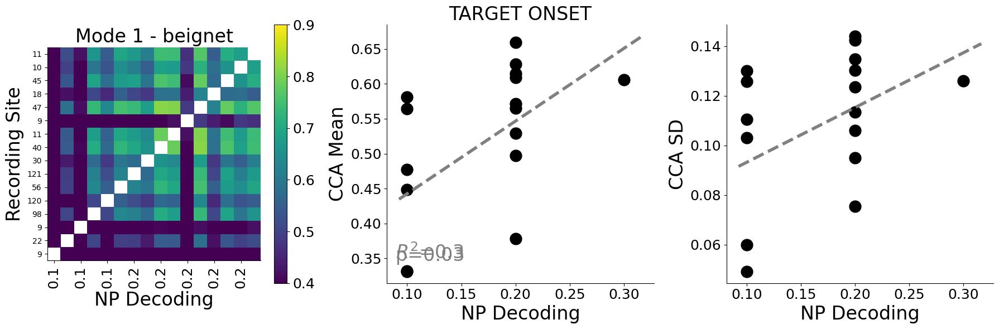

/tmp/ipykernel_3014130/4004228800.py:16: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.334,0.302 - p: 0.019, 0.027


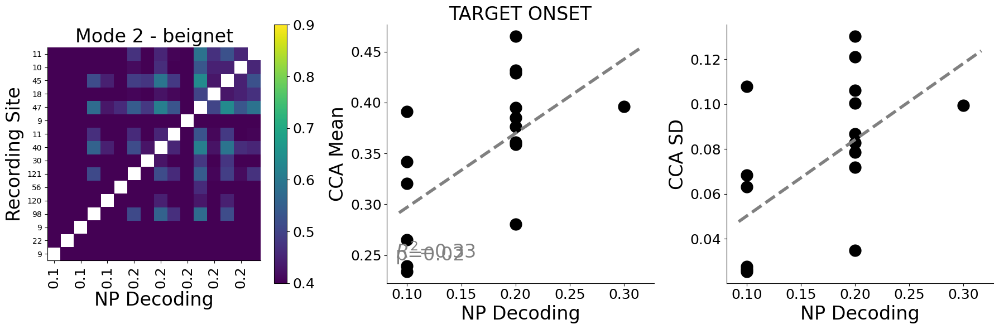

/tmp/ipykernel_3014130/4004228800.py:16: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.525,0.569 - p: 0.002, 0.001


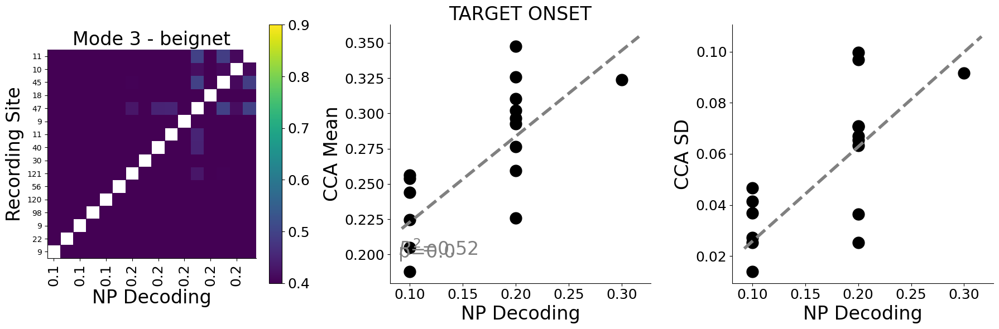

/tmp/ipykernel_3014130/4004228800.py:16: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.488,0.355 - p: 0.003, 0.015


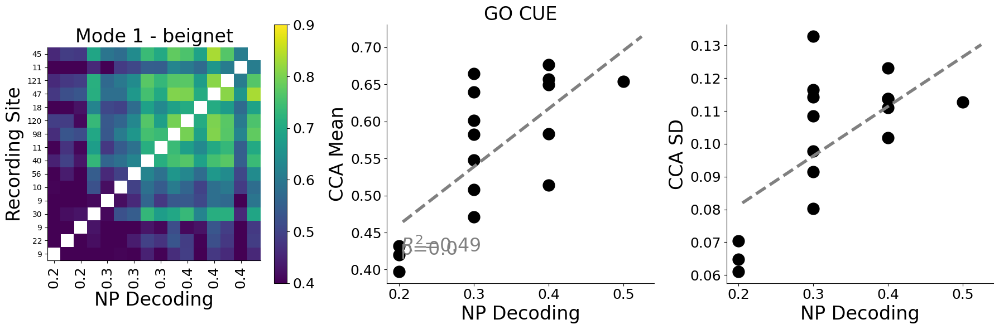

/tmp/ipykernel_3014130/4004228800.py:16: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.473,0.558 - p: 0.003, 0.001


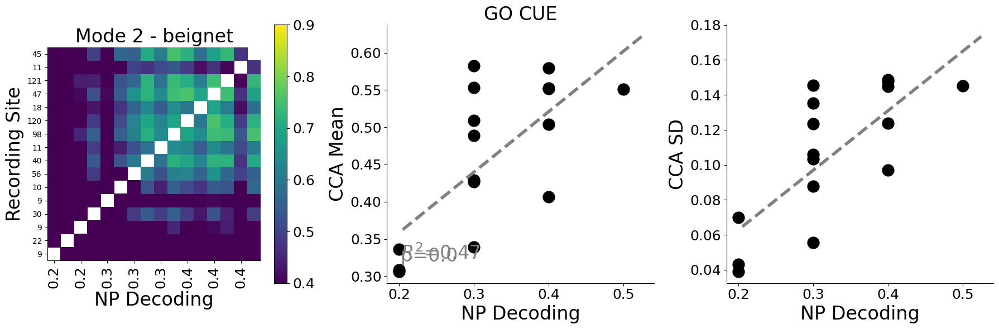

/tmp/ipykernel_3014130/4004228800.py:16: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.354,0.317 - p: 0.015, 0.023


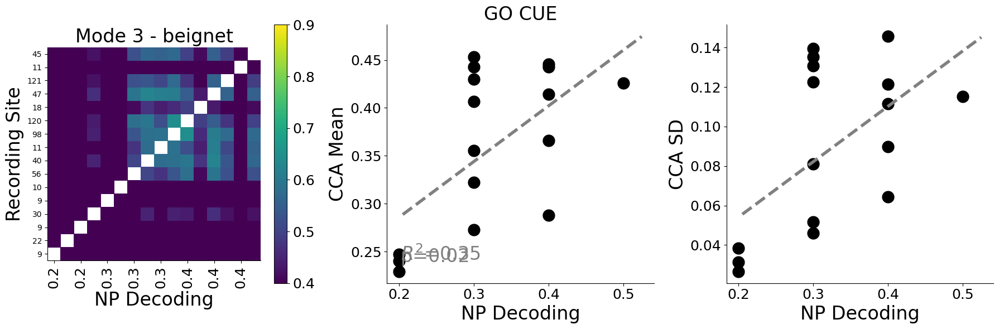

/tmp/ipykernel_3014130/4004228800.py:16: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.643,0.515 - p: 0.0, 0.002


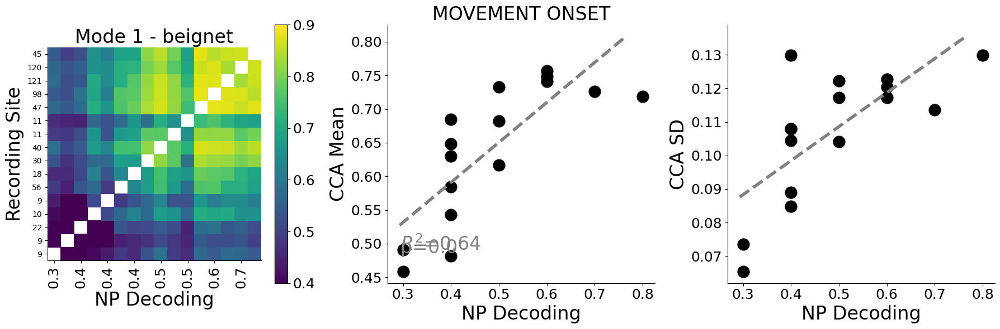

/tmp/ipykernel_3014130/4004228800.py:16: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.568,0.493 - p: 0.001, 0.002


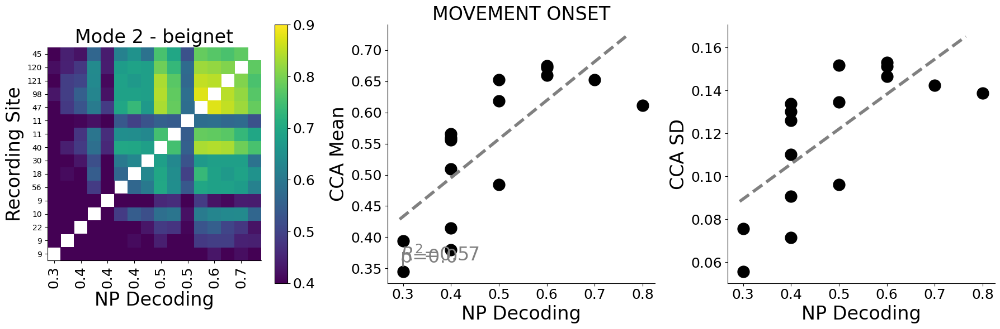

/tmp/ipykernel_3014130/4004228800.py:16: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.502,0.368 - p: 0.002, 0.013


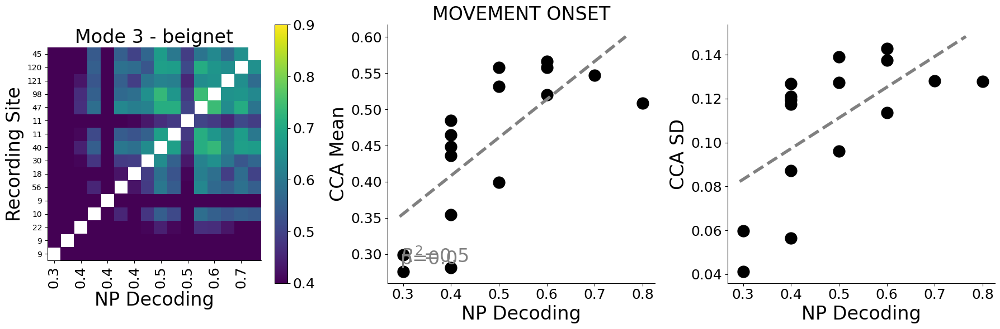

In [147]:
# Sort by caudal to rostral
for align_event in align_events:
    cr_sort = np.argsort(np.array(max_np_decoding[align_event]))
    for ipc in range(nmodes_plot):
        fig, ax = plt.subplots(1, 3, figsize=(18,6))
        good_nan_mask = np.sum(np.isnan(ccs[align_event][cr_sort,:,:][:,cr_sort,ipc]), axis=0) < nrecs
        input_array = ccs[align_event][cr_sort,:,:][:,cr_sort,ipc][good_nan_mask,:][:,good_nan_mask]
        input_array[np.diag_indices(input_array.shape[0])] = np.nan # CCA R with itself will be 1 so remove those
        # if subject == 'affi':
            # input_array[[1,8],[8,1]] = np.nan
            # input_array[[1,11],[11,1]] = np.nan
        if subject == 'affi':
            im = ax[0].pcolor(input_array, vmin=0.4, vmax=.75)
        elif subject == 'beignet':
            im = ax[0].pcolor(input_array, vmin=0.4, vmax=.9)
        cb = plt.colorbar(im)
        ax[0].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, recording_site[cr_sort][good_nan_mask], rotation = 0, fontsize=10)
        ax[0].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(np.array(max_np_decoding[align_event])[cr_sort], 1)[good_nan_mask][::2], rotation = 90)
        ax[0].set(xlabel='NP Decoding', ylabel='Recording Site', title=f"Mode {ipc+1} - {subject}")
        ax[0].set_aspect('equal')

        ax[1].plot(np.round(np.array(max_np_decoding[align_event])[cr_sort], 1)[good_nan_mask], np.nanmean(input_array, axis=0),'k.', markersize=30)
        ax[2].plot(np.round(np.array(max_np_decoding[align_event])[cr_sort], 1)[good_nan_mask], np.nanstd(input_array, axis=0),'k.', markersize=30)
        ax[1].set(xlabel='NP Decoding', ylabel='CCA Mean', title=f"{align_event}")
        ax[2].set(xlabel='NP Decoding', ylabel='CCA SD')

        # Fit lines for axis 1 and 2
        xaxis1 = np.array(max_np_decoding[align_event])[cr_sort][good_nan_mask] 
        yaxis1 = np.nanmean(input_array, axis=0)
        _,R21,_,pval1,regfit1 = aopy.analysis.base.linear_fit_analysis2D(xaxis1, yaxis1)
        ax[1].plot([xaxis1[0], xaxis1[-1]], [(regfit1.coef_[0][0]*xaxis1[0])+regfit1.intercept_[0],(regfit1.coef_[0][0]*xaxis1[-1])+regfit1.intercept_[0]], '--', color=(0.5,0.5,0.5))
        ax[1].annotate(f'p={np.round(pval1,2)}',(ax[1].get_xlim()[0]+np.abs(ax[1].get_xlim()[0]*.1), ax[1].get_ylim()[0]+np.abs(ax[1].get_ylim()[0]*.1)), fontsize=24, color=(0.5,0.5,0.5))
        ax[1].annotate(f'$R^2$={np.round(R21,2)}',(ax[1].get_xlim()[0]+np.abs(ax[1].get_xlim()[0]*.1), ax[1].get_ylim()[0]+np.abs(ax[1].get_ylim()[0]*.11)), fontsize=24, color=(0.5,0.5,0.5))

        xaxis2 = np.array(max_np_decoding[align_event])[cr_sort][good_nan_mask] 
        yaxis2 = np.nanstd(input_array, axis=0)
        _,R22,_,pval2,regfit2 = aopy.analysis.base.linear_fit_analysis2D(xaxis2, yaxis2)
        ax[2].plot([xaxis2[0], xaxis2[-1]], [(regfit2.coef_[0][0]*xaxis2[0])+regfit2.intercept_[0],(regfit2.coef_[0][0]*xaxis2[-1])+regfit2.intercept_[0]], '--', color=(0.5,0.5,0.5))
        print(f"R2: {np.round(R21, 3)},{np.round(R22,3)} - p: {np.round(pval1,3)}, {np.round(pval2,3)}")
        ax[2].annotate(f'p={np.round(pval2,2)}',(-1,.05), fontsize=24, color=(0.5,0.5,0.5))
        ax[2].annotate(f'$R^2$={np.round(R22,2)}',(-1,.052), fontsize=24, color=(0.5,0.5,0.5))

        fig.tight_layout()
        plt.show()

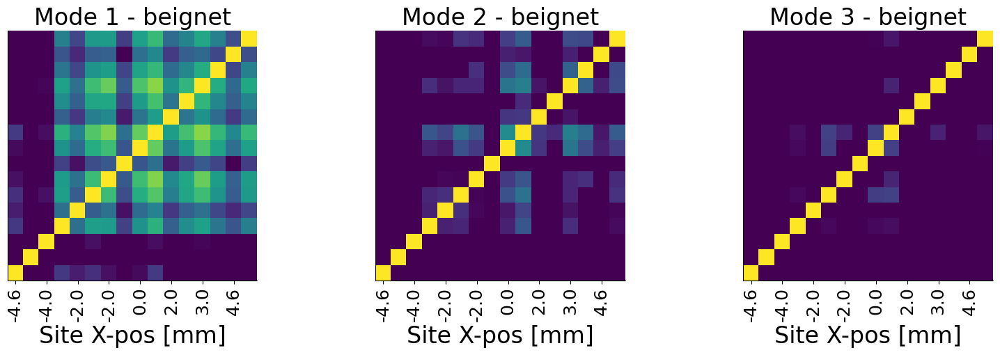

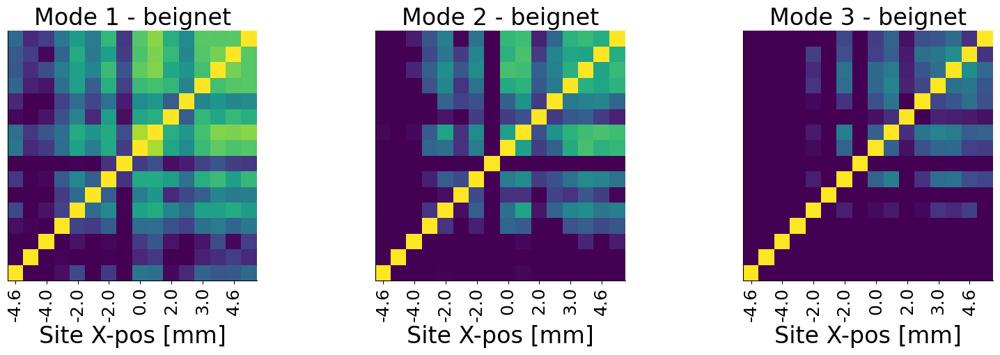

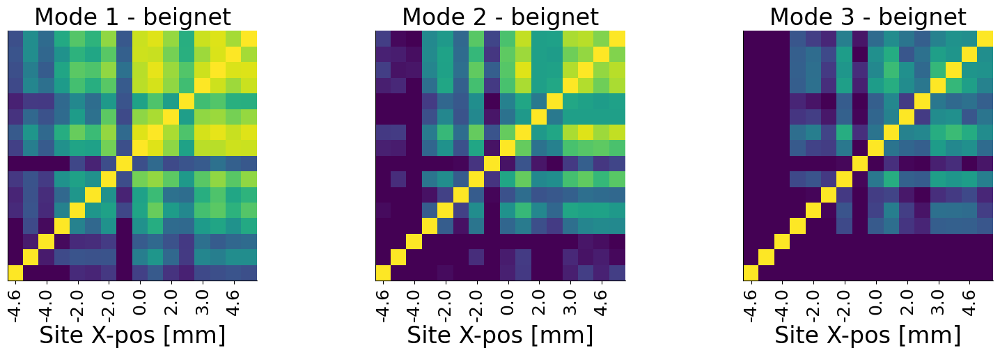

In [148]:
# Sort by caudal to rostral
cr_sort = np.argsort(ecog_dec_acc[subject]['rc_axis'][:,0])
for align_event in align_events:
    fig, ax = plt.subplots(1, 3, figsize=(16.,5))
    for ipc in range(3):

        good_nan_mask = np.sum(np.isnan(ccs[align_event][cr_sort,:,:][:,cr_sort,ipc]), axis=0) < nrecs
        input_array = ccs[align_event][cr_sort,:,:][:,cr_sort,ipc]
        if subject == 'affi':
            im = ax[ipc].pcolor(input_array[good_nan_mask,:][:,good_nan_mask], vmin=0.4, vmax=.75)
        else: 
            im = ax[ipc].pcolor(input_array[good_nan_mask,:][:,good_nan_mask], vmin=0.4, vmax=.9)

        # ax[ipc].set_yticks(np.arange(nrecs)+0.5, recording_site[cr_sort], rotation = 30)
        ax[ipc].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(ecog_dec_acc[subject]['rc_axis'][:,0][cr_sort], 1)[good_nan_mask][::2], rotation = 90)
        # ax[ipc].set_xticks(np.arange(len(cr_sort), step=2)+0.5, np.arange(np.sum(mask),step=2)+1)
        ax[ipc].set_yticks([],[])
        ax[ipc].set(xlabel='Site X-pos [mm]',  title=f"Mode {ipc+1} - {subject}")
        ax[ipc].set_aspect('equal')

        # if ipc == 0:
        #     ax[ipc].set_ylabel('Site X-pos [mm]')
        #     # ax[ipc].set_yticks(np.arange(np.sum(mask), step=2)+0.5, np.arange(np.sum(mask), step=2)+1)
        #     # ax[ipc].set_yticks(np.arange(len(cr_sort),step=2)+0.5, np.round(ecog_dec_acc[subject]['rc_axis'][:,0][cr_sort][::2], 1))
        #     ax[ipc].set_yticks(np.arange(nrecs)+0.5, recording_site[cr_sort])
        # elif ipc == npcs-1:
        #     cb = plt.colorbar(im)    

    fig.tight_layout()
    aopy.visualization.savefig(base_save_dir, f'{subject}_cc_rostral_caudal_{align_event}.svg')

/tmp/ipykernel_3014130/1284699009.py:16: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.249,0.343 - p: 0.049, 0.017


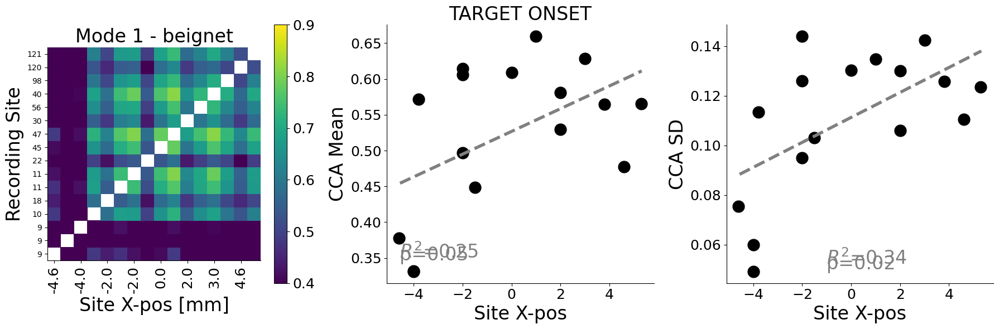

/tmp/ipykernel_3014130/1284699009.py:16: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.261,0.282 - p: 0.043, 0.034


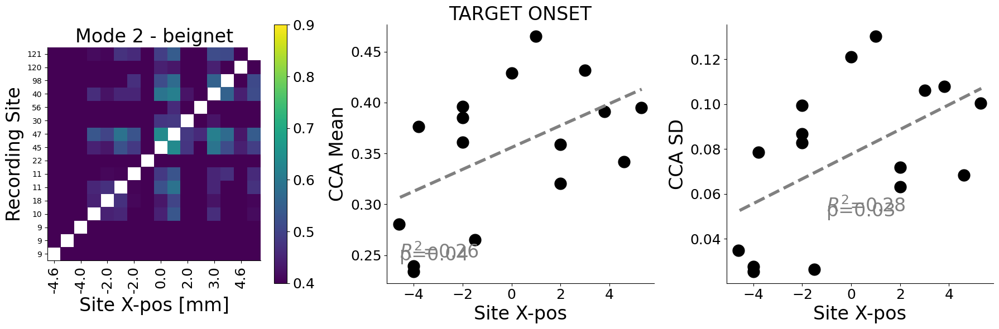

/tmp/ipykernel_3014130/1284699009.py:16: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.09,0.039 - p: 0.26, 0.466


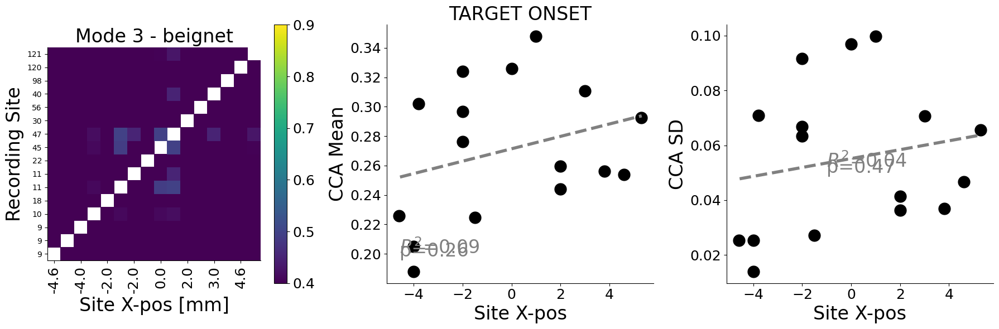

/tmp/ipykernel_3014130/1284699009.py:16: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.613,0.474 - p: 0.0, 0.003


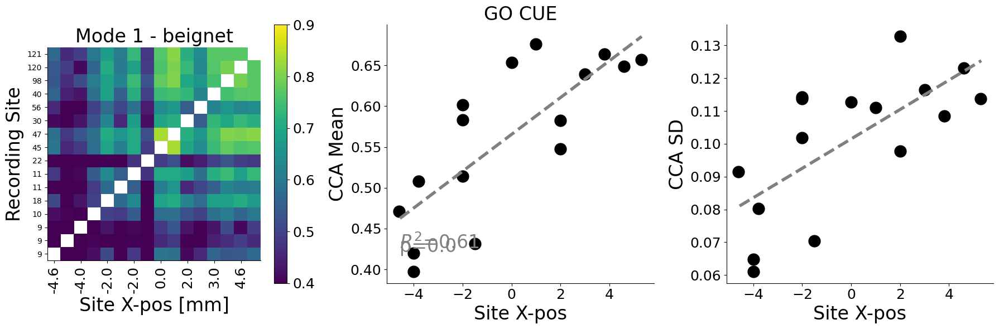

/tmp/ipykernel_3014130/1284699009.py:16: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.562,0.544 - p: 0.001, 0.001


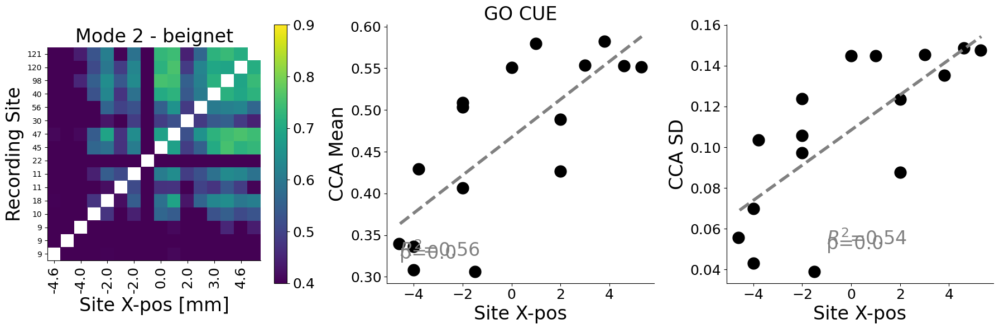

/tmp/ipykernel_3014130/1284699009.py:16: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.595,0.592 - p: 0.0, 0.0


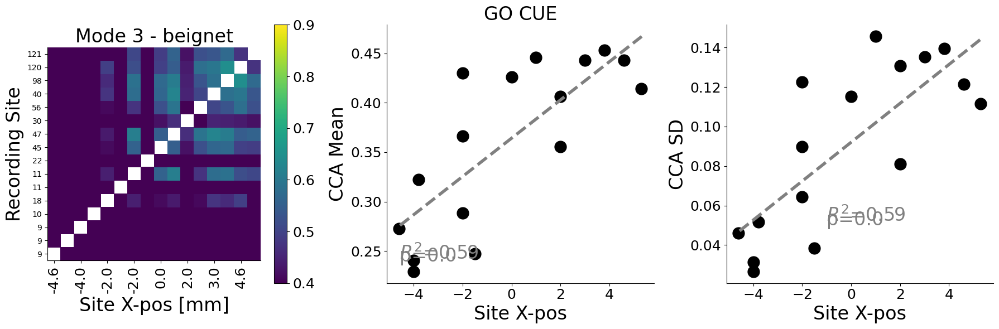

/tmp/ipykernel_3014130/1284699009.py:16: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.639,0.448 - p: 0.0, 0.005


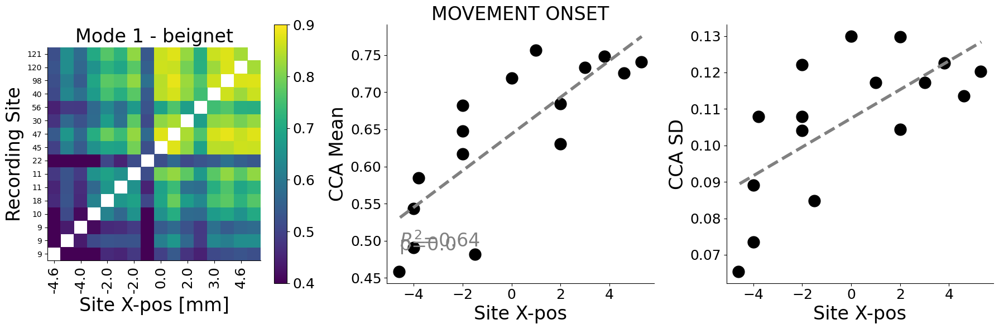

/tmp/ipykernel_3014130/1284699009.py:16: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.649,0.647 - p: 0.0, 0.0


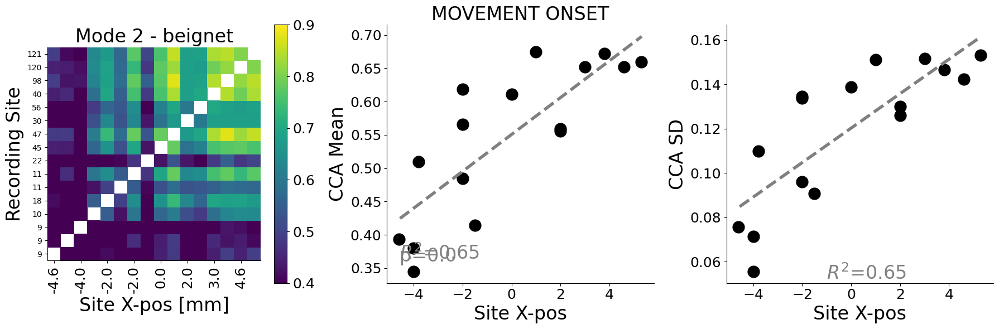

/tmp/ipykernel_3014130/1284699009.py:16: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.624,0.475 - p: 0.0, 0.003


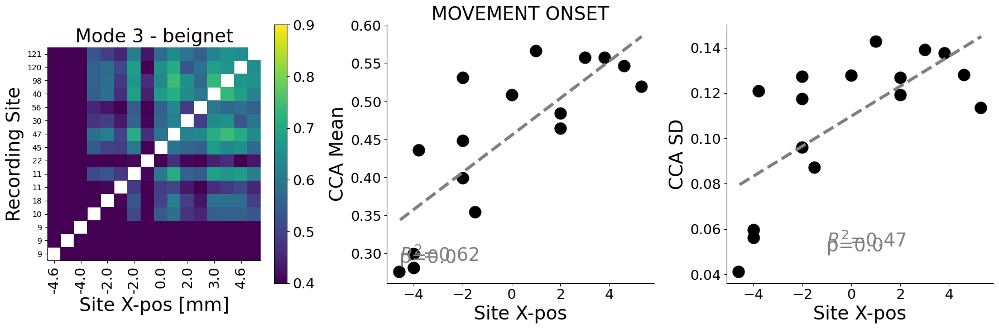

In [149]:
# Sort by caudal to rostral
cr_sort = np.argsort(ecog_dec_acc[subject]['rc_axis'][:,0])
for align_event in align_events:
    for ipc in range(nmodes_plot):
        fig, ax = plt.subplots(1, 3, figsize=(18,6))
        good_nan_mask = np.sum(np.isnan(ccs[align_event][cr_sort,:,:][:,cr_sort,ipc]), axis=0) < nrecs
        input_array = ccs[align_event][cr_sort,:,:][:,cr_sort,ipc][good_nan_mask,:][:,good_nan_mask]
        input_array[np.diag_indices(input_array.shape[0])] = np.nan # CCA R with itself will be 1 so remove those
        # if subject == 'affi':
            # input_array[[1,8],[8,1]] = np.nan
            # input_array[[1,11],[11,1]] = np.nan
        if subject == 'affi':
            im = ax[0].pcolor(input_array, vmin=0.4, vmax=.75)
        elif subject == 'beignet':
            im = ax[0].pcolor(input_array, vmin=0.4, vmax=.9)
        cb = plt.colorbar(im)
        ax[0].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, recording_site[cr_sort][good_nan_mask], rotation = 0, fontsize=10)
        ax[0].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(ecog_dec_acc[subject]['rc_axis'][:,0][cr_sort], 1)[good_nan_mask][::2], rotation = 90)
        ax[0].set(xlabel='Site X-pos [mm]', ylabel='Recording Site', title=f"Mode {ipc+1} - {subject}")
        ax[0].set_aspect('equal')

        ax[1].plot(np.round(ecog_dec_acc[subject]['rc_axis'][:,0][cr_sort], 1)[good_nan_mask], np.nanmean(input_array, axis=0),'k.', markersize=30)
        ax[2].plot(np.round(ecog_dec_acc[subject]['rc_axis'][:,0][cr_sort], 1)[good_nan_mask], np.nanstd(input_array, axis=0),'k.', markersize=30)
        ax[1].set(xlabel='Site X-pos', ylabel='CCA Mean',title= f"{align_event}")
        ax[2].set(xlabel='Site X-pos', ylabel='CCA SD')

        # Fit lines for axis 1 and 2
        xaxis1 = ecog_dec_acc[subject]['rc_axis'][:,0][cr_sort][good_nan_mask] 
        yaxis1 = np.nanmean(input_array, axis=0)
        _,R21,_,pval1,regfit1 = aopy.analysis.base.linear_fit_analysis2D(xaxis1, yaxis1)
        ax[1].plot([xaxis1[0], xaxis1[-1]], [(regfit1.coef_[0][0]*xaxis1[0])+regfit1.intercept_[0],(regfit1.coef_[0][0]*xaxis1[-1])+regfit1.intercept_[0]], '--', color=(0.5,0.5,0.5))
        ax[1].annotate(f'p={np.round(pval1,2)}',(ax[1].get_xlim()[0]+np.abs(ax[1].get_xlim()[0]*.1), ax[1].get_ylim()[0]+np.abs(ax[1].get_ylim()[0]*.1)), fontsize=24, color=(0.5,0.5,0.5))
        ax[1].annotate(f'$R^2$={np.round(R21,2)}',(ax[1].get_xlim()[0]+np.abs(ax[1].get_xlim()[0]*.1), ax[1].get_ylim()[0]+np.abs(ax[1].get_ylim()[0]*.11)), fontsize=24, color=(0.5,0.5,0.5))

        xaxis2 = ecog_dec_acc[subject]['rc_axis'][:,0][cr_sort][good_nan_mask] 
        yaxis2 = np.nanstd(input_array, axis=0)
        _,R22,_,pval2,regfit2 = aopy.analysis.base.linear_fit_analysis2D(xaxis2, yaxis2)
        ax[2].plot([xaxis2[0], xaxis2[-1]], [(regfit2.coef_[0][0]*xaxis2[0])+regfit2.intercept_[0],(regfit2.coef_[0][0]*xaxis2[-1])+regfit2.intercept_[0]], '--', color=(0.5,0.5,0.5))
        print(f"R2: {np.round(R21, 3)},{np.round(R22,3)} - p: {np.round(pval1,3)}, {np.round(pval2,3)}")
        ax[2].annotate(f'p={np.round(pval2,2)}',(-1,.05), fontsize=24, color=(0.5,0.5,0.5))
        ax[2].annotate(f'$R^2$={np.round(R22,2)}',(-1,.052), fontsize=24, color=(0.5,0.5,0.5))
        fig.tight_layout()
        plt.show()

In [77]:
# ## Plot spatial map of CCA to
# # ref_site = 107
# ref_site = 98
# ref_site_idx = np.where(recording_site==ref_site)[0][0]
# fig, ax = plt.subplots(1,npcs,figsize=(npcs*5,5))
# for ipc in range(npcs):
#     colors = ccs[:,ref_site_idx,ipc]
#     dec_map = ax[ipc].scatter(ecog_dec_acc[subject]['rc_axis'][:,0], ecog_dec_acc[subject]['rc_axis'][:,1], s=100, c=colors, cmap='YlGnBu', vmin=0.2, vmax=.8)
#     cb = plt.colorbar(dec_map)
#     ax[ipc].set(xlim=(-6,6), ylim=(-6,6), title=f"CC {ipc+1}")
    
# fig.tight_layout()
# plt.show()

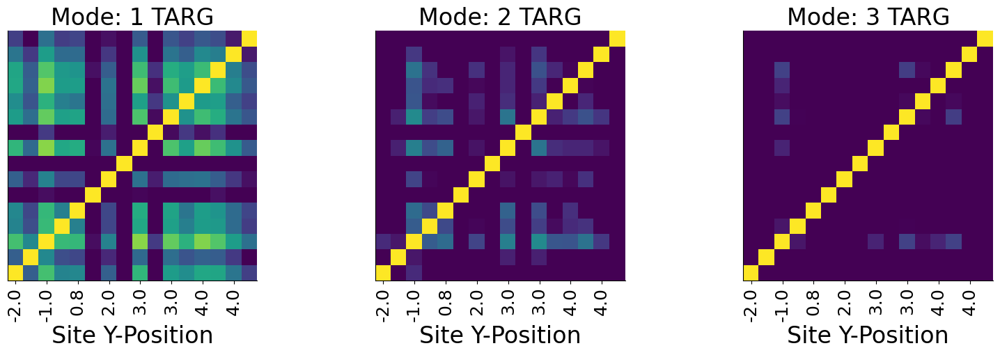

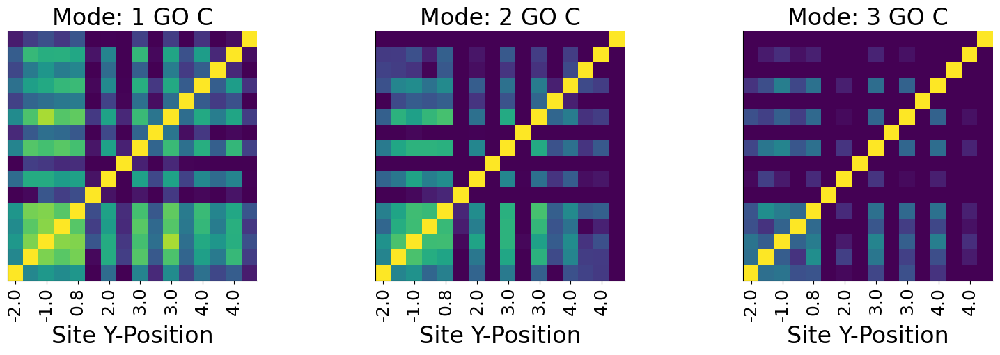

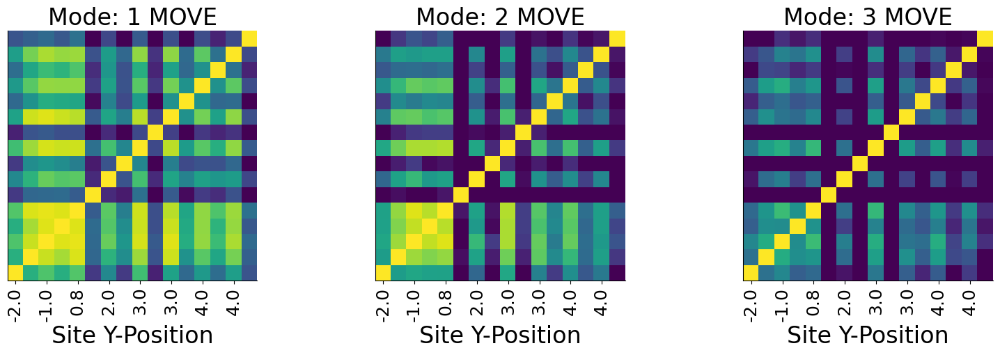

In [150]:
# Sort by medial to lateral
cr_sort = np.argsort(ecog_dec_acc[subject]['rc_axis'][:,1])
for align_event in align_events:
    fig, ax = plt.subplots(1, 3, figsize=(16, 5))
    for ipc in range(3):
        good_nan_mask = np.sum(np.isnan(ccs[align_event][cr_sort,:,:][:,cr_sort,ipc]), axis=0) < nrecs
        input_array = ccs[align_event][cr_sort,:,:][:,cr_sort,ipc]
        im = ax[ipc].pcolor(input_array[good_nan_mask,:][:,good_nan_mask], vmin=0.4, vmax=.9)
        ax[ipc].set_yticks([],[])
        # cb = plt.colorbar(im)
        ax[ipc].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(ecog_dec_acc[subject]['rc_axis'][:,1][cr_sort], 1)[good_nan_mask][::2], rotation = 90)

        # ax[ipc].set_yticks(np.arange(nrecs)+0.5, recording_site[cr_sort], rotation = 30)
        # ax[ipc].set_xticks(np.arange(nrecs)+0.5, np.round(ecog_dec_acc[subject]['rc_axis'][:,1][cr_sort], 2), rotation = 60)
        ax[ipc].set_aspect('equal')
        ax[ipc].set(xlabel='Site Y-Position', title=f"Mode: {ipc+1} {align_event[:4]}")
    fig.tight_layout()
    plt.show()

/tmp/ipykernel_3014130/3593584328.py:13: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.01,0.002 - p: 0.712, 0.858


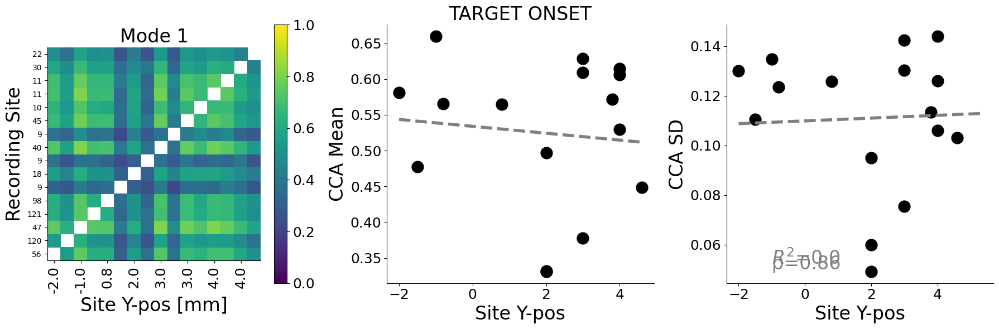

/tmp/ipykernel_3014130/3593584328.py:13: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.178,0.005 - p: 0.103, 0.803


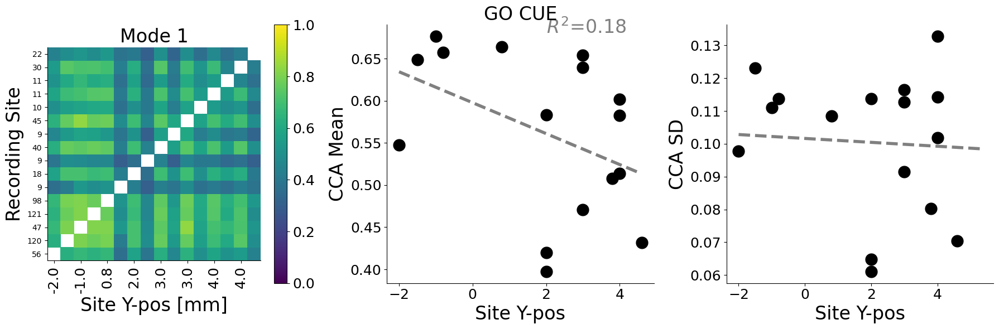

/tmp/ipykernel_3014130/3593584328.py:13: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.181,0.0 - p: 0.1, 0.94


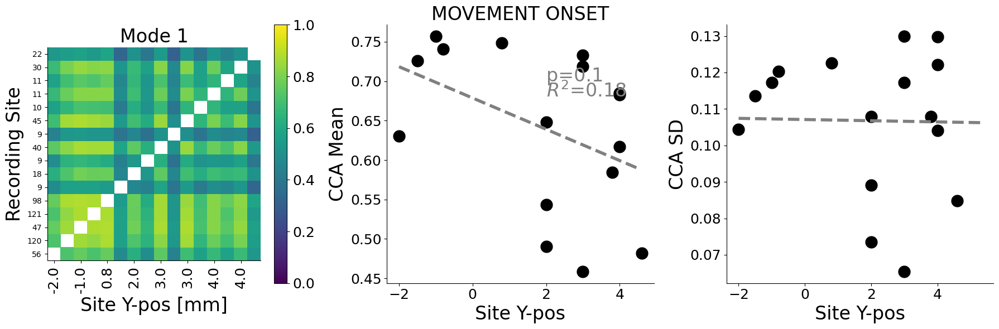

In [151]:
# Sort by medial to lateral
cr_sort = np.argsort(ecog_dec_acc[subject]['rc_axis'][:,1])
for align_event in align_events:
    for ipc in range(1):
        fig, ax = plt.subplots(1, 3, figsize=(18,6))
        good_nan_mask = np.sum(np.isnan(ccs[align_event][cr_sort,:,:][:,cr_sort,ipc]), axis=0) < nrecs
        input_array = ccs[align_event][cr_sort,:,:][:,cr_sort,ipc][good_nan_mask,:][:,good_nan_mask]
        input_array[np.diag_indices(input_array.shape[0])] = np.nan # CCA R with itself will be 1 so remove those
        # if subject == 'affi':
            # input_array[[1,8],[8,1]] = np.nan
            # input_array[[1,11],[11,1]] = np.nan
        im = ax[0].pcolor(input_array, vmin=0, vmax=1)
        cb = plt.colorbar(im)
        ax[0].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, recording_site[cr_sort][good_nan_mask], rotation = 0, fontsize=10)
        ax[0].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(ecog_dec_acc[subject]['rc_axis'][:,1][cr_sort], 1)[good_nan_mask][::2], rotation = 90)
        ax[0].set(xlabel='Site Y-pos [mm]', ylabel='Recording Site', title=f"Mode {ipc+1}")
        ax[0].set_aspect('equal')

        ax[1].plot(np.round(ecog_dec_acc[subject]['rc_axis'][:,1][cr_sort], 1)[good_nan_mask], np.nanmean(input_array, axis=0),'k.', markersize=30)
        ax[2].plot(np.round(ecog_dec_acc[subject]['rc_axis'][:,1][cr_sort], 1)[good_nan_mask], np.nanstd(input_array, axis=0),'k.', markersize=30)
        ax[1].set(xlabel='Site Y-pos', ylabel='CCA Mean', title=f"{align_event}")
        ax[2].set(xlabel='Site Y-pos', ylabel='CCA SD')

        # Fit lines for axis 1 and 2
        xaxis1 = ecog_dec_acc[subject]['rc_axis'][:,1][cr_sort][good_nan_mask] 
        yaxis1 = np.nanmean(input_array, axis=0)
        _,R21,_,pval1,regfit1 = aopy.analysis.base.linear_fit_analysis2D(xaxis1, yaxis1)
        ax[1].plot([xaxis1[0], xaxis1[-1]], [(regfit1.coef_[0][0]*xaxis1[0])+regfit1.intercept_[0],(regfit1.coef_[0][0]*xaxis1[-1])+regfit1.intercept_[0]], '--', color=(0.5,0.5,0.5))
        ax[1].annotate(f'p={np.round(pval1,2)}',(2,.70), fontsize=24, color=(0.5,0.5,0.5))
        ax[1].annotate(f'$R^2$={np.round(R21,2)}',(2,.68), fontsize=24, color=(0.5,0.5,0.5))

        yaxis2 = np.nanstd(input_array, axis=0)
        _,R22,_,pval2,regfit2 = aopy.analysis.base.linear_fit_analysis2D(xaxis2, yaxis2)
        ax[2].plot([xaxis1[0], xaxis2[-1]], [(regfit2.coef_[0][0]*xaxis2[0])+regfit2.intercept_[0],(regfit2.coef_[0][0]*xaxis2[-1])+regfit2.intercept_[0]], '--', color=(0.5,0.5,0.5))
        print(f"R2: {np.round(R21, 3)},{np.round(R22,3)} - p: {np.round(pval1,3)}, {np.round(pval2,3)}")
        ax[2].annotate(f'p={np.round(pval2,2)}',(-1,.05), fontsize=24, color=(0.5,0.5,0.5))
        ax[2].annotate(f'$R^2$={np.round(R22,2)}',(-1,.052), fontsize=24, color=(0.5,0.5,0.5))

        fig.tight_layout()
        plt.show()

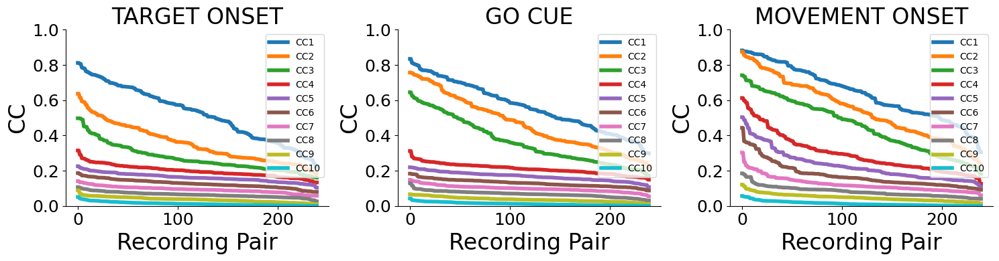

In [152]:
fig, ax = plt.subplots(1, len(align_events), figsize=(5*len(align_events), 4))
for ievent, align_event in enumerate(align_events):
    for ipc in range(npcs):
        ccs_plt = ccs[align_event][:,:,ipc]
        ccs_plt[np.diag_indices(ccs_plt.shape[0])] = np.nan
        ax[ievent].plot(np.flip(np.sort( ccs_plt[~np.isnan(ccs_plt)].flatten())))

    ax[ievent].set(xlabel='Recording Pair', ylabel='CC', title=f"{align_event}", ylim=(0,1))
    ax[ievent].set_yticks([0, 0.2, 0.4, 0.6, 0.8, 1])
    ax[ievent].legend([f"CC{ipc+1}" for ipc in range(npcs)])
fig.tight_layout()
plt.show()

/tmp/ipykernel_3014130/473564731.py:17: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.34,0.353 - p: 0.018, 0.015


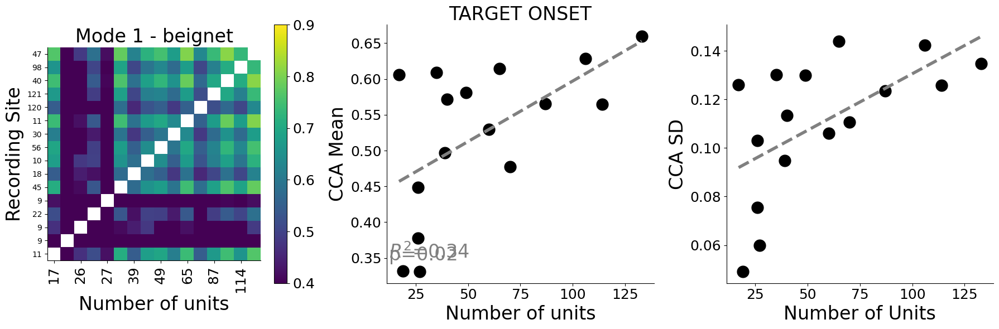

/tmp/ipykernel_3014130/473564731.py:17: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.623,0.312 - p: 0.0, 0.025


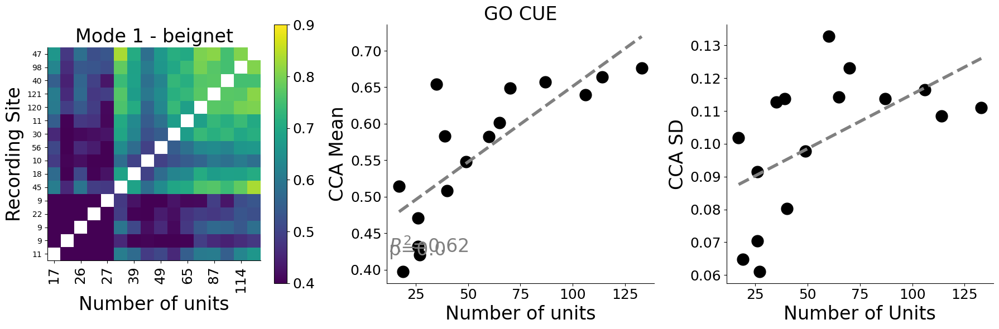

/tmp/ipykernel_3014130/473564731.py:17: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.609,0.339 - p: 0.0, 0.018


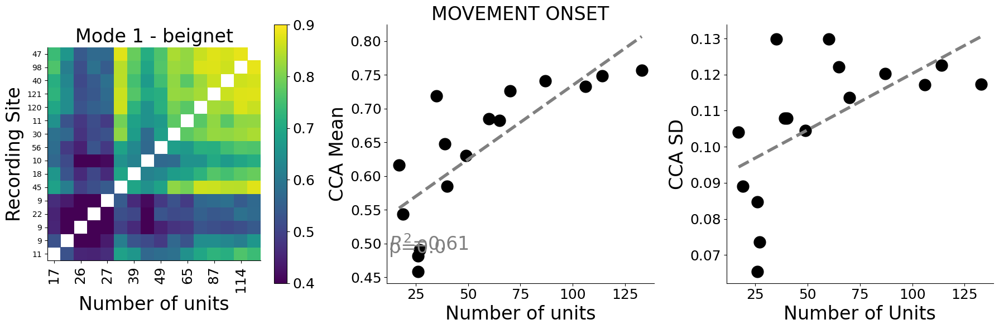

In [153]:
# Sort by number of units
n_units_sort = np.argsort(nstable_unit)

for align_event in align_events:
    for ipc in range(1):
        fig, ax = plt.subplots(1, 3, figsize=(18,6))
        good_nan_mask = np.sum(np.isnan(ccs[align_event][n_units_sort,:,:][:,n_units_sort,ipc]), axis=0) < nrecs
        input_array = ccs[align_event][n_units_sort,:,:][:,n_units_sort,ipc][good_nan_mask,:][:,good_nan_mask]
        input_array[np.diag_indices(input_array.shape[0])] = np.nan # CCA R with itself will be 1 so remove those
        # if subject == 'affi':
            # input_array[[1,8],[8,1]] = np.nan
            # input_array[[1,11],[11,1]] = np.nan
        if subject == 'affi':
            im = ax[0].pcolor(input_array, vmin=0.4, vmax=.75)
        elif subject == 'beignet':
            im = ax[0].pcolor(input_array, vmin=0.4, vmax=.9)
        cb = plt.colorbar(im)
        ax[0].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, recording_site[n_units_sort][good_nan_mask], rotation = 0, fontsize=10)
        ax[0].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, nstable_unit[n_units_sort][good_nan_mask][::2], rotation = 90)
        ax[0].set(xlabel='Number of units', ylabel='Recording Site', title=f"Mode {ipc+1} - {subject}")
        ax[0].set_aspect('equal')

        ax[1].plot(nstable_unit[n_units_sort][good_nan_mask], np.nanmean(input_array, axis=0),'k.', markersize=30)
        ax[2].plot(nstable_unit[n_units_sort][good_nan_mask], np.nanstd(input_array, axis=0),'k.', markersize=30)
        ax[1].set(xlabel='Number of units', ylabel='CCA Mean', title=f"{align_event}")
        ax[2].set(xlabel='Number of Units', ylabel='CCA SD')

        # Fit lines for axis 1 and 2
        xaxis1 = nstable_unit[n_units_sort][good_nan_mask] 
        yaxis1 = np.nanmean(input_array, axis=0)
        _,R21,_,pval1,regfit1 = aopy.analysis.base.linear_fit_analysis2D(xaxis1, yaxis1)
        ax[1].plot([xaxis1[0], xaxis1[-1]], [(regfit1.coef_[0][0]*xaxis1[0])+regfit1.intercept_[0],(regfit1.coef_[0][0]*xaxis1[-1])+regfit1.intercept_[0]], '--', color=(0.5,0.5,0.5))
        ax[1].annotate(f'p={np.round(pval1,2)}',(ax[1].get_xlim()[0]+np.abs(ax[1].get_xlim()[0]*.1), ax[1].get_ylim()[0]+np.abs(ax[1].get_ylim()[0]*.1)), fontsize=24, color=(0.5,0.5,0.5))
        ax[1].annotate(f'$R^2$={np.round(R21,2)}',(ax[1].get_xlim()[0]+np.abs(ax[1].get_xlim()[0]*.1), ax[1].get_ylim()[0]+np.abs(ax[1].get_ylim()[0]*.11)), fontsize=24, color=(0.5,0.5,0.5))

        xaxis2 = nstable_unit[n_units_sort][good_nan_mask] 
        yaxis2 = np.nanstd(input_array, axis=0)
        _,R22,_,pval2,regfit2 = aopy.analysis.base.linear_fit_analysis2D(xaxis2, yaxis2)
        ax[2].plot([xaxis2[0], xaxis2[-1]], [(regfit2.coef_[0][0]*xaxis2[0])+regfit2.intercept_[0],(regfit2.coef_[0][0]*xaxis2[-1])+regfit2.intercept_[0]], '--', color=(0.5,0.5,0.5))
        print(f"R2: {np.round(R21, 3)},{np.round(R22,3)} - p: {np.round(pval1,3)}, {np.round(pval2,3)}")
        ax[2].annotate(f'p={np.round(pval2,2)}',(-1,.05), fontsize=24, color=(0.5,0.5,0.5))
        ax[2].annotate(f'$R^2$={np.round(R22,2)}',(-1,.052), fontsize=24, color=(0.5,0.5,0.5))

        fig.tight_layout()
        plt.show()

0.04391487874003108
0.03362218194373856
0.020575262762405733


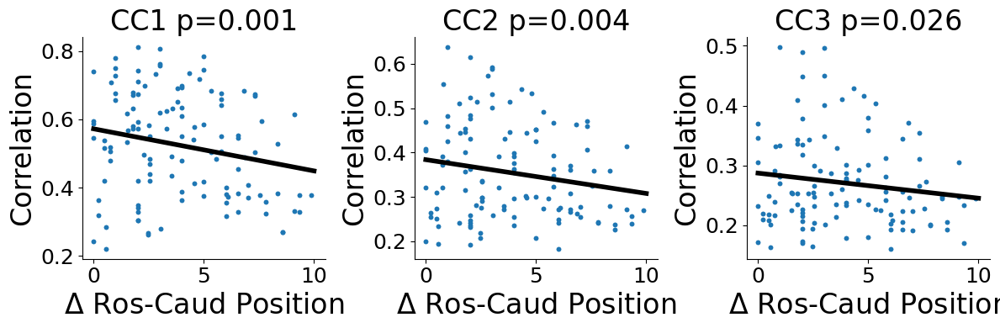

0.0012214788227042916
0.005561682657488132
0.023902881869241388


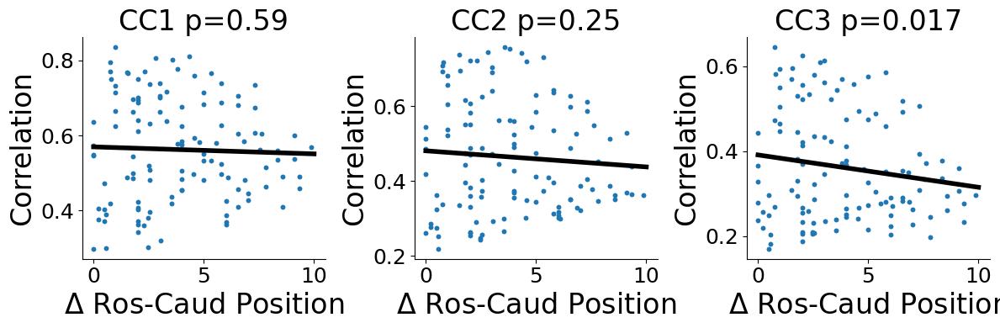

0.0010644110379472993
0.0050959057693388266
0.00831032741595683


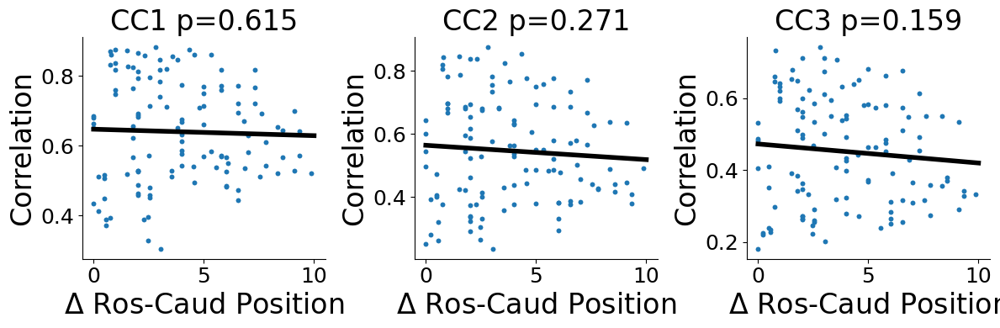

In [154]:
for align_event in align_events:
    fig, ax = plt.subplots(1,nmodes_plot,figsize=(4*nmodes_plot,4))
    pos_diff = np.zeros((ccs[align_event].shape[0], ccs[align_event].shape[1]))*np.nan
    pos_labels = np.zeros((ccs[align_event].shape[0], ccs[align_event].shape[1],2))*np.nan
    for irec1 in range(ccs[align_event].shape[0]):
        for irec2 in range(ccs[align_event].shape[1]):
            if irec1 != irec2:
                pos_diff[irec1,irec2] = np.abs(ecog_dec_acc[subject]['rc_axis'][irec1,0] - ecog_dec_acc[subject]['rc_axis'][irec2,0])
                pos_labels[irec1,irec2,0] = irec1
                pos_labels[irec1,irec2,1] = irec2
    slopes = []
    intercepts = []
    for ipc in range(nmodes_plot):
        nan_mask = np.logical_and(~np.isnan(pos_diff.flatten()), ~np.isnan(ccs[align_event][:,:,ipc].flatten()))
        fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(pos_diff.flatten()[nan_mask], ccs[align_event][:,:,ipc].flatten()[nan_mask])
        print(fitscore)
        intercept = regfit.intercept_
        intercepts.append(intercept)
        slope = regfit.coef_[0]
        slopes.append(slope)
        ax[ipc].plot(pos_diff.flatten(), ccs[align_event][:,:,ipc].flatten(),'.')
        ax[ipc].plot([0,10], [intercept, slope*10 + intercept], 'k')
        ax[ipc].set(xlabel='$\Delta$ Ros-Caud Position', ylabel='Correlation')
        ax[ipc].set(title=f"CC{ipc+1} p={np.round(pval,3)}")
    fig.tight_layout()
    plt.show()

0.008657653791877773
0.010650207349916618
0.008952569441259883


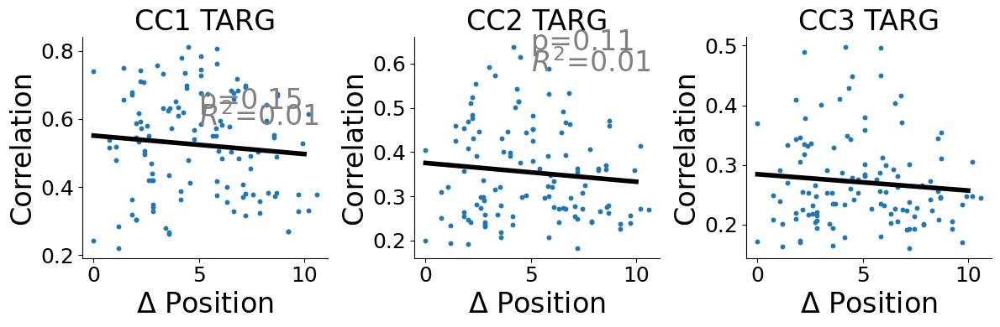

0.003447044354775053
1.4967264556187132e-05
0.0029832058098276937


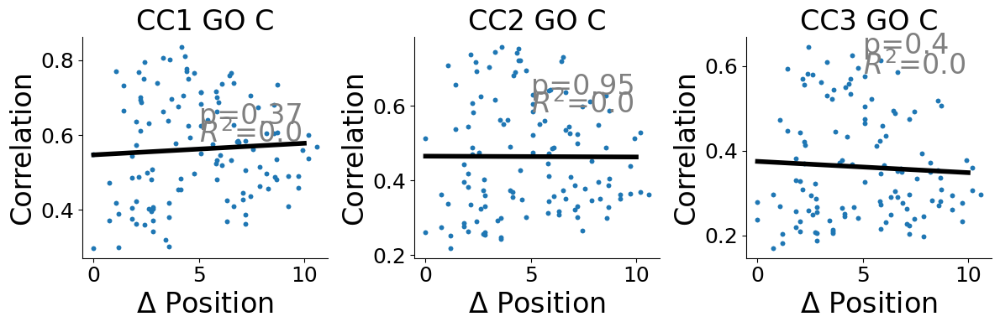

0.004738655925923818
0.0013145077253230442
0.0003967513047864468


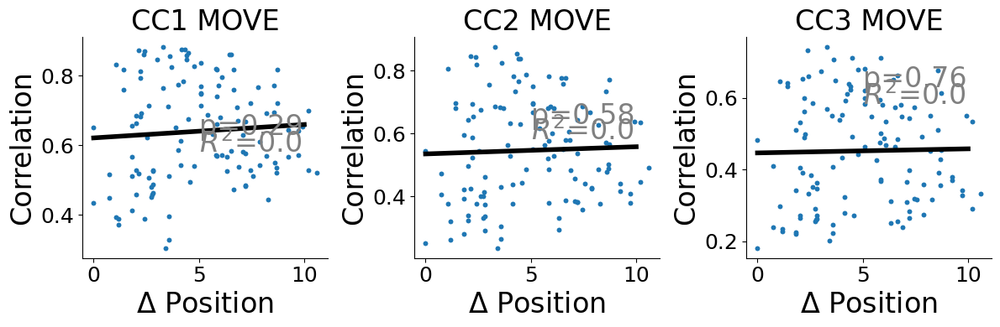

In [155]:
for align_event in align_events:
    fig, ax = plt.subplots(1,nmodes_plot,figsize=(4*nmodes_plot,4))
    pos_diff = np.zeros((ccs[align_event].shape[0], ccs[align_event].shape[1]))*np.nan
    pos_labels = np.zeros((ccs[align_event].shape[0], ccs[align_event].shape[1],2))*np.nan
    for irec1 in range(ccs[align_event].shape[0]):
        for irec2 in range(ccs[align_event].shape[1]):
            if irec1 != irec2:
                pos_diff[irec1,irec2] = np.sqrt(np.sum((ecog_dec_acc[subject]['rc_axis'][irec1,:] - ecog_dec_acc[subject]['rc_axis'][irec2,:])**2))
                pos_labels[irec1,irec2,0] = irec1
                pos_labels[irec1,irec2,1] = irec2
    slopes = []
    intercepts = []
    for ipc in range(nmodes_plot):
        nan_mask = np.logical_and(~np.isnan(pos_diff.flatten()), ~np.isnan(ccs[align_event][:,:,ipc].flatten()))
        fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(pos_diff.flatten()[nan_mask], ccs[align_event][:,:,ipc].flatten()[nan_mask])
        print(fitscore)
        intercept = regfit.intercept_
        intercepts.append(intercept)
        slope = regfit.coef_[0]
        slopes.append(slope)
        ax[ipc].plot(pos_diff.flatten(), ccs[align_event][:,:,ipc].flatten(),'.')
        ax[ipc].plot([0,10], [intercept, slope*10 + intercept], 'k')
        ax[ipc].set(xlabel='$\Delta$ Position', ylabel='Correlation')
        ax[ipc].set(title=f"CC{ipc+1} {align_event[:4]}")
        ax[ipc].annotate(f'p={np.round(pval,2)}',(5,.63), fontsize=24, color=(0.5,0.5,0.5))
        ax[ipc].annotate(f'$R^2$={np.round(fitscore,2)}',(5,.58), fontsize=24, color=(0.5,0.5,0.5))
    fig.tight_layout()
    plt.show()

In [156]:
def get_neighboring_ccs(ccs, nneighbors=1):
    neighboring_ccs = np.zeros(ccs.shape[0])*np.nan
    for ivalue in range(ccs.shape[0]):
        start_idx = ivalue-nneighbors
        end_idx = ivalue+nneighbors+1
        if start_idx < 0:
            start_idx = 0
        ccs_subset = copy.deepcopy(ccs[:,start_idx:end_idx][start_idx:end_idx,:])
        diag_indices = np.diag_indices(ccs_subset.shape[0])
        ccs_subset[diag_indices[0],diag_indices[1]] = np.nan
        neighboring_ccs[ivalue] = np.nanmean(ccs_subset)
        
    return neighboring_ccs

R: 0.631 0.0002359191638517884
R: 0.781 5.5421888531887115e-06
R: 0.932 1.460092642283226e-09


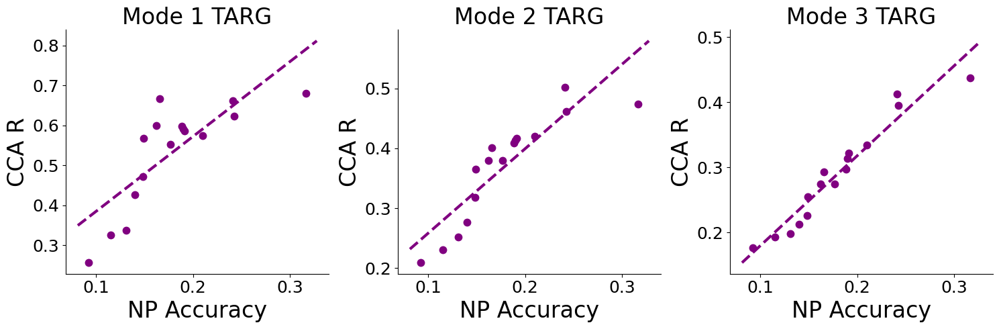

R: 0.63 0.0002437845340804655
R: 0.515 0.0017384204596706844
R: 0.332 0.019433846588933455


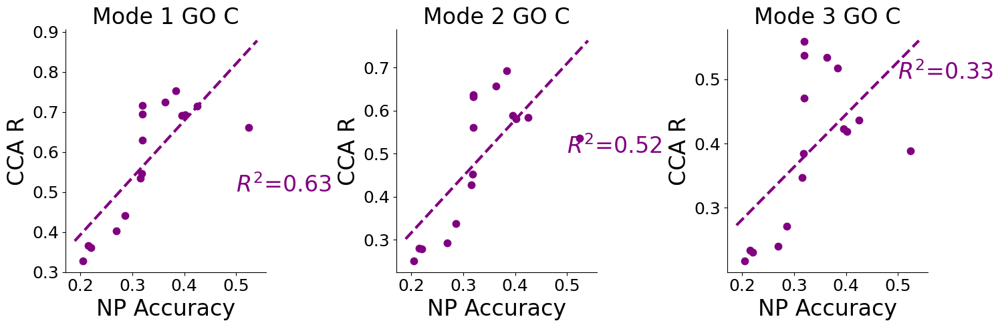

R: 0.808 2.2475016188564247e-06
R: 0.833 8.294655046270661e-07
R: 0.77 7.873342585933008e-06


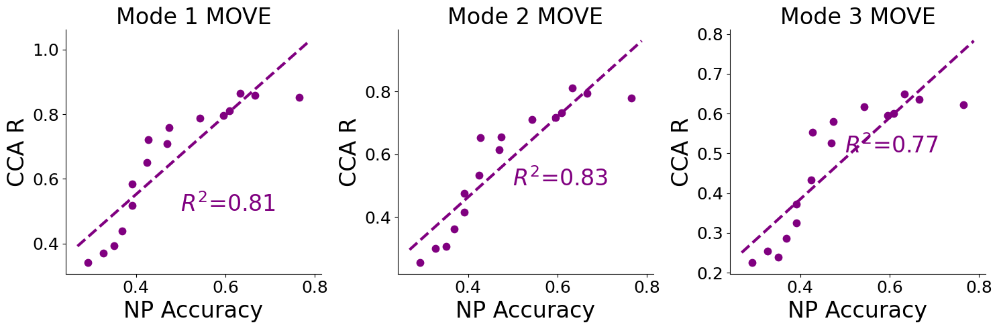

In [157]:
nneighbors = 2
np_v_cca_fitscore = {}
for align_event in align_events:
    fig, ax = plt.subplots(1,nmodes_plot,figsize=(5*nmodes_plot,5))
    np_v_cca_fitscore[align_event] = np.zeros(nmodes_plot)*np.nan
    for ipc in range(nmodes_plot):
        good_nan_idx = np.where(np.sum(np.isnan(ccs[align_event][:,:,ipc]), axis=0) < nrecs)[0]
        np_acc_ordered_site_idx = good_nan_idx[np.argsort(np.array(max_np_decoding[align_event])[good_nan_idx])]
        np_acc_neighboring_ccs = get_neighboring_ccs(ccs[align_event][np_acc_ordered_site_idx,:,ipc][:,np_acc_ordered_site_idx], nneighbors =nneighbors)


    # Compute statistics for NP accuracy ordered
        ax[ipc].plot(np.array(max_np_decoding[align_event])[np_acc_ordered_site_idx], np_acc_neighboring_ccs,'.', color='purple', markersize=15)
        fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(np.array(max_np_decoding[align_event])[np_acc_ordered_site_idx], np_acc_neighboring_ccs)
        print(f"R: {np.round(fitscore,3)}", pval)
        intercept, slope = regfit.intercept_, regfit.coef_[0]
        ax[ipc].plot([ax[ipc].get_xlim()[0],ax[ipc].get_xlim()[1]], [(slope*ax[ipc].get_xlim()[0])+intercept, (slope*ax[ipc].get_xlim()[1])+intercept], '--', color='purple', linewidth=3)
        ax[ipc].set(xlabel='NP Accuracy', ylabel='CCA R', title=f'Mode {ipc+1} {align_event[:4]}')
        ax[ipc].annotate(f'$R^2$={np.round(fitscore,2)}',(.50,.5), fontsize=24, color='purple')
        np_v_cca_fitscore[align_event][ipc] = fitscore

    fig.tight_layout()
    plt.show()

R: 0.812 1.9191855042808466e-06
R: 0.937 8.939289563672393e-10
R: 0.818 1.485762317126374e-06


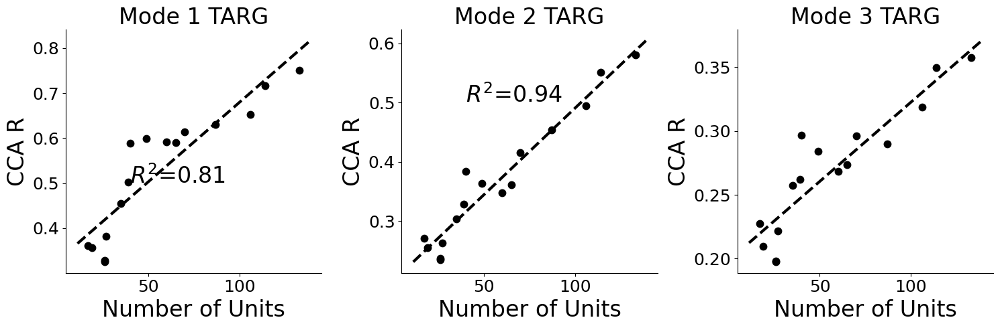

R: 0.844 5.089537760379408e-07
R: 0.912 8.744453440040236e-09
R: 0.917 5.761450000186474e-09


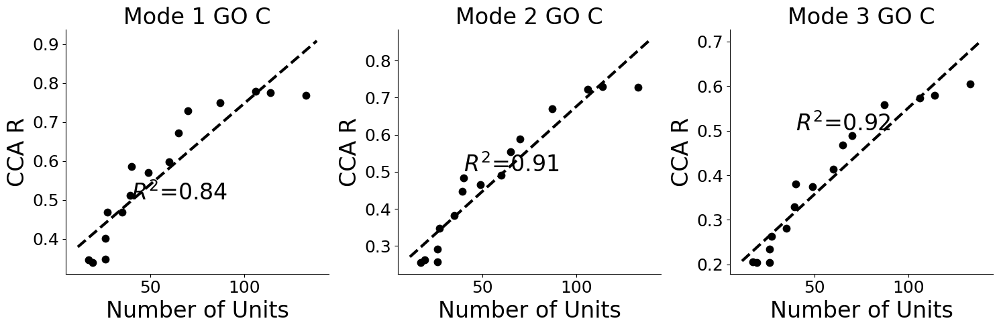

R: 0.861 2.2608255115269517e-07
R: 0.889 4.71314115996236e-08
R: 0.873 1.2079000291361124e-07


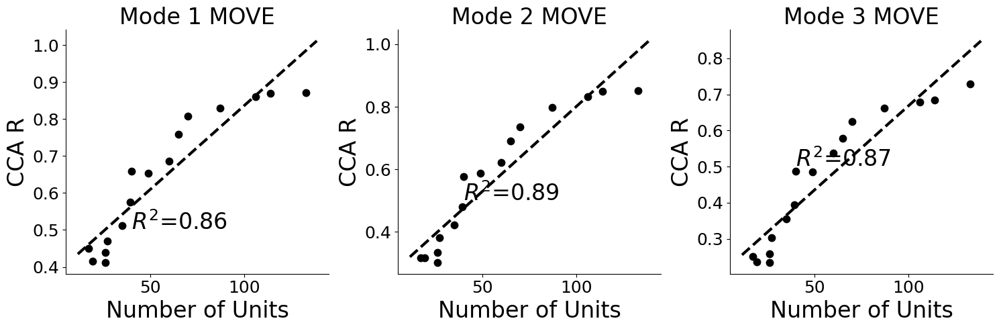

In [158]:
nneighbors = 2
for align_event in align_events:
    fig, ax = plt.subplots(1,nmodes_plot,figsize=(5*nmodes_plot,5))
    for ipc in range(nmodes_plot):
        good_nan_idx = np.where(np.sum(np.isnan(ccs[align_event][:,:,ipc]), axis=0) < nrecs)[0]
        np_acc_ordered_site_idx = good_nan_idx[np.argsort(nstable_unit[good_nan_idx])]
        np_acc_neighboring_ccs = get_neighboring_ccs(ccs[align_event][np_acc_ordered_site_idx,:,ipc][:,np_acc_ordered_site_idx], nneighbors =nneighbors)


    # Compute statistics for NP accuracy ordered
        ax[ipc].plot(nstable_unit[np_acc_ordered_site_idx], np_acc_neighboring_ccs,'.', color='black', markersize=15)
        fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(nstable_unit[np_acc_ordered_site_idx], np_acc_neighboring_ccs)
        print(f"R: {np.round(fitscore,3)}", pval)
        intercept, slope = regfit.intercept_, regfit.coef_[0]
        ax[ipc].plot([ax[ipc].get_xlim()[0],ax[ipc].get_xlim()[1]], [(slope*ax[ipc].get_xlim()[0])+intercept, (slope*ax[ipc].get_xlim()[1])+intercept], '--', color='black', linewidth=3)
        ax[ipc].set(xlabel='Number of Units', ylabel='CCA R', title=f'Mode {ipc+1} {align_event[:4]}')
        ax[ipc].annotate(f'$R^2$={np.round(fitscore,2)}',(40,.5), fontsize=24, color='black')

    fig.tight_layout()
    plt.show()

  0%|          | 0/1000 [00:00<?, ?it/s]

R: 0.461 0.003829399381522081
R: 0.03 0.5199373548841999




  0%|          | 0/1000 [00:00<?, ?it/s]

R: 0.66 0.00013217172911230825
R: 0.118 0.19212017883813307




  0%|          | 0/1000 [00:00<?, ?it/s]

R: 0.127 0.17521049780689416
R: 0.0 0.9537810875016457




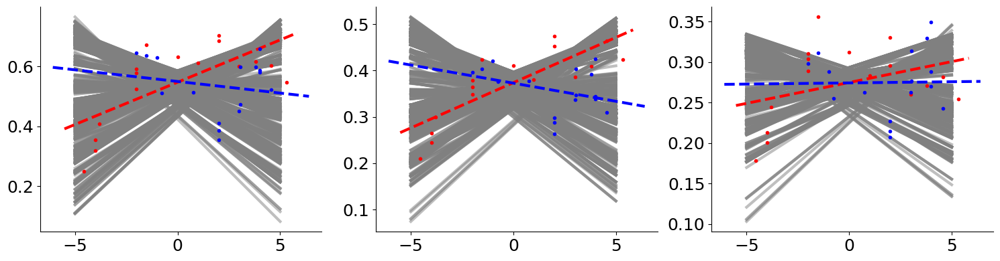

  0%|          | 0/1000 [00:00<?, ?it/s]

R: 0.939 7.088343934422193e-10
R: 0.706 4.629039998606092e-05




  0%|          | 0/1000 [00:00<?, ?it/s]

R: 0.956 6.856177791752415e-11
R: 0.825 1.165179009214505e-06




  0%|          | 0/1000 [00:00<?, ?it/s]

R: 0.963 1.9512209283360585e-11
R: 0.774 7.067347155324114e-06




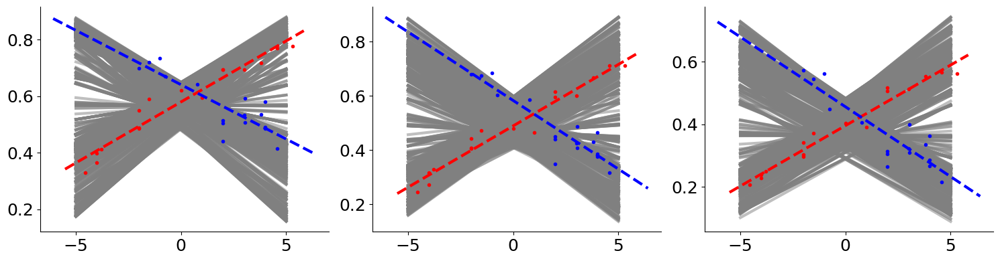

  0%|          | 0/1000 [00:00<?, ?it/s]

R: 0.931 1.5709573373645586e-09
R: 0.737 2.0800071423633637e-05




  0%|          | 0/1000 [00:00<?, ?it/s]

R: 0.952 1.2916004634556748e-10
R: 0.688 7.132904972525993e-05




  0%|          | 0/1000 [00:00<?, ?it/s]

R: 0.914 7.599075223966537e-09
R: 0.613 0.00033709574304201435




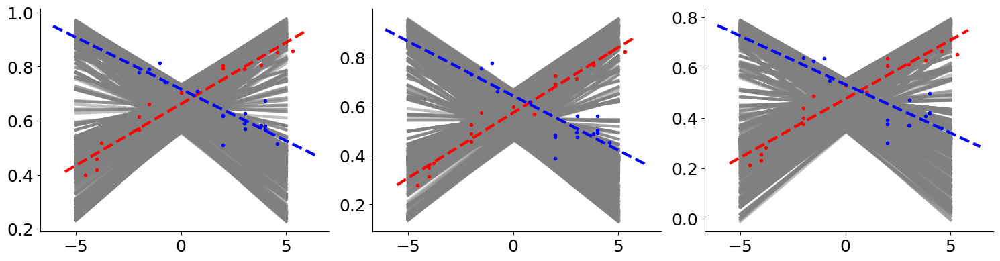

In [159]:
nrandom_axis = 1000
rc_r2 = {}
ml_r2 = {}
random_r2 = {}
random_angles = {}
for align_event in align_events:
    fig, ax = plt.subplots(1,nmodes_plot,figsize=(5*nmodes_plot,4))
    rc_r2[align_event] = np.zeros(nmodes_plot)*np.nan
    ml_r2[align_event] = np.zeros(nmodes_plot)*np.nan
    random_r2[align_event] = np.zeros((nrandom_axis, nmodes_plot))*np.nan
    random_angles[align_event] = np.zeros((nrandom_axis, nmodes_plot))*np.nan
    for ipc in range(nmodes_plot):      
            # ax[ipc].plot(pos_diff[csite_idx,:].flatten(), ccs[csite_idx,:,ipc].flatten(),'k.')
            good_nan_idx = np.where(np.sum(np.isnan(ccs[align_event][:,:,ipc]), axis=0) < nrecs)[0]
            rc_ordered_site_idx = good_nan_idx[np.argsort(ecog_dec_acc[subject]['rc_axis'][good_nan_idx,0])]
            ml_ordered_site_idx = good_nan_idx[np.argsort(ecog_dec_acc[subject]['rc_axis'][good_nan_idx,1])]

            rc_neighboring_ccs = get_neighboring_ccs(ccs[align_event][rc_ordered_site_idx,:,ipc][:,rc_ordered_site_idx],nneighbors=nneighbors)
            ml_neighboring_ccs = get_neighboring_ccs(ccs[align_event][ml_ordered_site_idx,:,ipc][:,ml_ordered_site_idx],nneighbors=nneighbors)        

            xmin, xmax = -5,5
            # Random axis 
            for iaxis in tqdm(range(nrandom_axis)):
                # np.random.seed(iaxis)
                random_angle = np.random.rand(1)*np.pi*2
                random_angles[align_event][iaxis,ipc] = random_angle[0]
                random_axis = ecog_dec_acc[subject]['rc_axis'] @ np.array([[np.cos(random_angle), -np.sin(random_angle)],[np.sin(random_angle), np.cos(random_angle)]])[:,:,0]
                any_ordered_site_idx = good_nan_idx[np.argsort(random_axis[good_nan_idx,0])]
                any_neighboring_ccs = get_neighboring_ccs(ccs[align_event][any_ordered_site_idx,:,ipc][:,any_ordered_site_idx])

                # ax[ipc].plot(random_axis[any_ordered_site_idx], any_neighboring_ccs,'r.')
                fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(random_axis[any_ordered_site_idx,0], any_neighboring_ccs)
                random_r2[align_event][iaxis,ipc] = fitscore
                intercept, slope = regfit.intercept_, regfit.coef_[0]
                ax[ipc].plot([xmin,xmax], [(slope*xmin)+intercept, (slope*xmax)+intercept], 'gray', linewidth=3, alpha=0.5)

            # Compute statistics for RC and ML Axis
            ax[ipc].plot(ecog_dec_acc[subject]['rc_axis'][rc_ordered_site_idx,0], rc_neighboring_ccs,'r.')
            fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(ecog_dec_acc[subject]['rc_axis'][rc_ordered_site_idx,0], rc_neighboring_ccs)
            rc_r2[align_event][ipc] = fitscore
            print(f"R: {np.round(fitscore,3)}", pval)
            intercept, slope = regfit.intercept_, regfit.coef_[0]
            ax[ipc].plot([ax[ipc].get_xlim()[0],ax[ipc].get_xlim()[1]], [(slope*ax[ipc].get_xlim()[0])+intercept, (slope*ax[ipc].get_xlim()[1])+intercept], 'r--', linewidth=3)

            ax[ipc].plot(ecog_dec_acc[subject]['rc_axis'][ml_ordered_site_idx,1],ml_neighboring_ccs,'b.')
            fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(ecog_dec_acc[subject]['rc_axis'][ml_ordered_site_idx,1], ml_neighboring_ccs)
            ml_r2[align_event][ipc] = fitscore
            print(f"R: {np.round(fitscore,3)}", pval)
            intercept, slope = regfit.intercept_, regfit.coef_[0]
            ax[ipc].plot([ax[ipc].get_xlim()[0],ax[ipc].get_xlim()[1]], [(slope*ax[ipc].get_xlim()[0])+intercept, (slope*ax[ipc].get_xlim()[1])+intercept], 'b--', linewidth=3)

            print('\n')
    fig.tight_layout()
    plt.show()

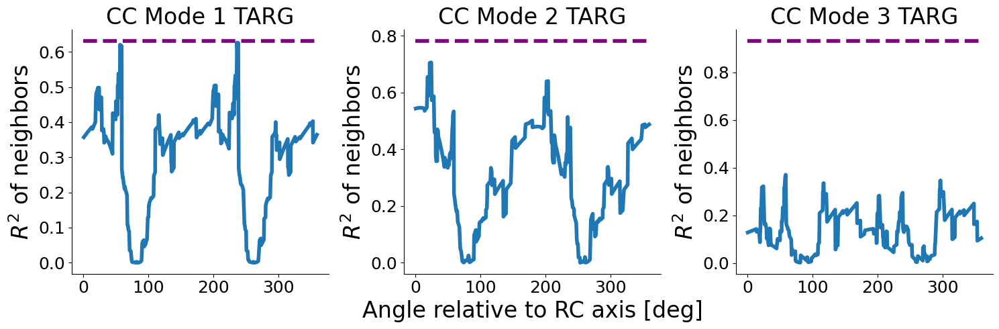

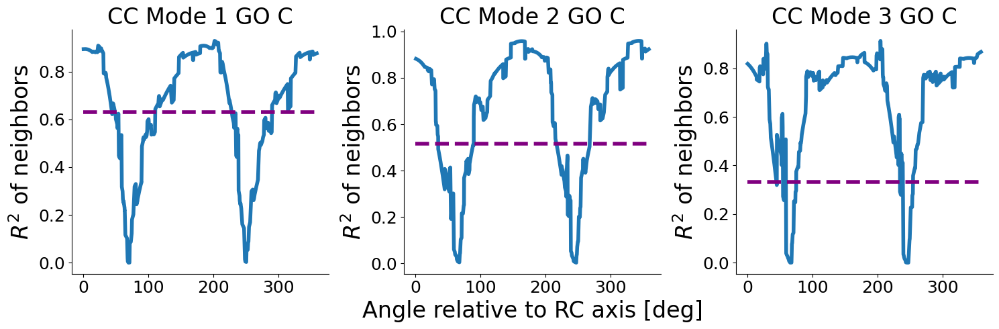

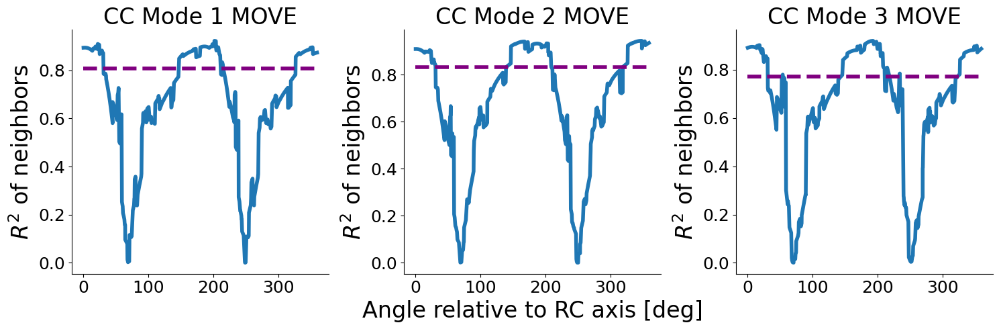

In [160]:
for align_event in align_events:
    fig, ax = plt.subplots(1,nmodes_plot,figsize=(5*nmodes_plot,5))
    for ipc in range(nmodes_plot):
        ax[ipc].plot(np.rad2deg(random_angles[align_event][np.argsort(random_angles[align_event][:,ipc]),ipc]), random_r2[align_event][np.argsort(random_angles[align_event][:,ipc]),ipc])
        ax[ipc].plot([0,360], [np_v_cca_fitscore[align_event][ipc], np_v_cca_fitscore[align_event][ipc]], '--', color='purple')
        ax[ipc].set(ylabel='$R^2$ of neighbors', title=f"CC Mode {ipc+1} {align_event[:4]}")
        if ipc == 1:
            ax[ipc].set_xlabel('Angle relative to RC axis [deg]')

    fig.tight_layout()
    plt.show()


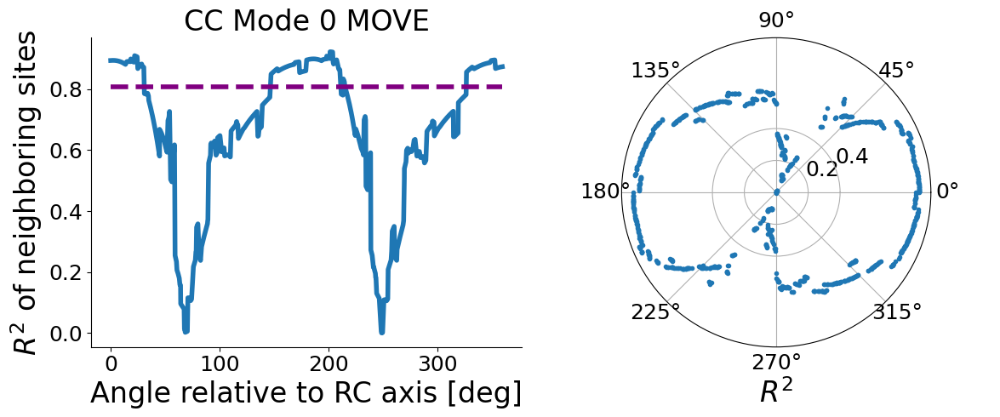

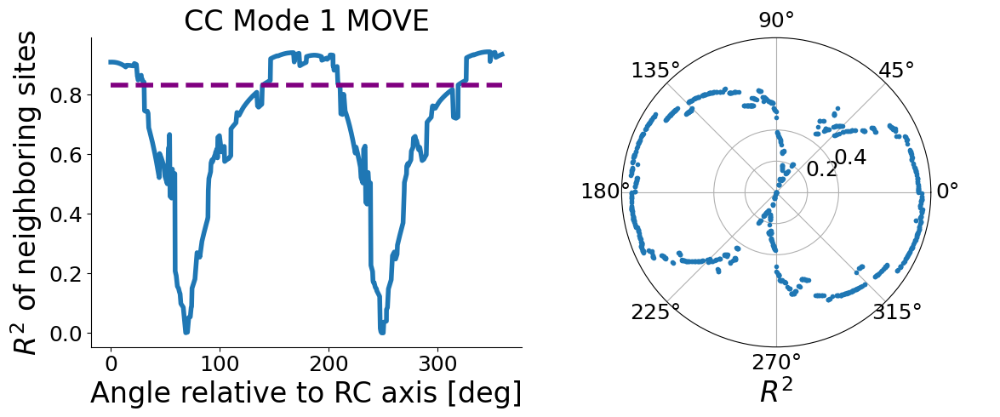

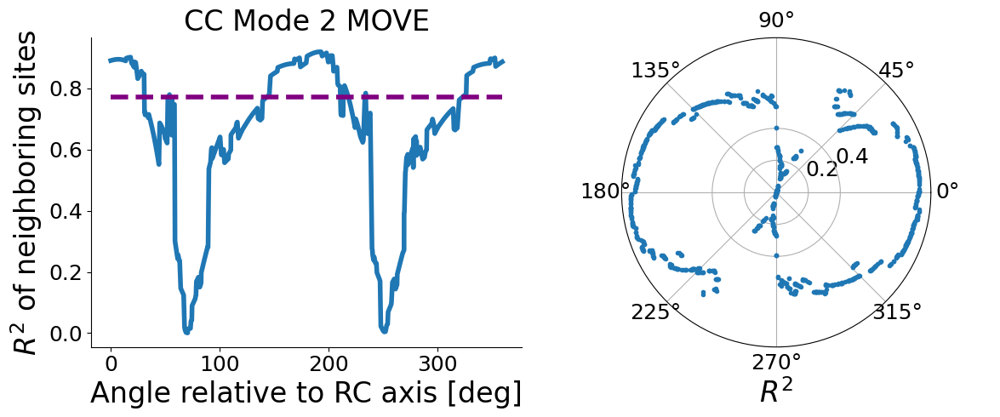

In [161]:
align_event = align_events[-1]
for ipc in range(nmodes_plot):
    fig, ax = plt.subplots(1,2,figsize=(12,5))
    ax[0].plot(np.rad2deg(random_angles[align_event][np.argsort(random_angles[align_event][:,ipc]),ipc]), random_r2[align_event][np.argsort(random_angles[align_event][:,ipc]),ipc])
    ax[0].plot([0,360], [np_v_cca_fitscore[align_event][ipc], np_v_cca_fitscore[align_event][ipc]], '--', color='purple')
    ax[0].set(xlabel='Angle relative to RC axis [deg]', ylabel='$R^2$ of neighboring sites', title=f"CC Mode {ipc} {align_event[:4]}")
    
    ax[1].set_yticks([])  # Remove radial labels
    ax[1].set_xticks([])  # Remove angular labels
    # ax[0].set(ylim=(0,0.65))
    ax[1].spines['left'].set_visible(False)
    ax[1].spines['bottom'].set_visible(False)
    
    ax[1] = fig.add_subplot(122, projection='polar')    
    ax[1].plot(random_angles[align_event][:,ipc], random_r2[align_event][:,ipc], '.')
    ax[1].set_rticks([0.2, 0.4])
    ax[1].set_xlabel("$R^2$")
    fig.tight_layout()
    plt.show()
    

In [162]:
cca_similarity_df = {}
for align_event in align_events:
    df_dict = {}
    df_dict['site_idx'] = []
    df_dict['accuracy'] = []
    df_dict['cca_similarity_accuracy_mode1'] = []
    df_dict['cca_similarity_accuracy_mode2'] = []
    df_dict['cca_similarity_accuracy_mode3'] = []
    df_dict['rc_pos'] = []
    df_dict['cca_similarity_rc_pos_mode1'] = []
    df_dict['cca_similarity_rc_pos_mode2'] = []
    df_dict['cca_similarity_rc_pos_mode3'] = []
    rc_ordered_site_idx = good_nan_idx[np.argsort(ecog_dec_acc[subject]['rc_axis'][good_nan_idx,0])]
    rc_neighboring_ccs_mode1 = get_neighboring_ccs(ccs[align_event][rc_ordered_site_idx,:,0][:,rc_ordered_site_idx],nneighbors=nneighbors)
    rc_neighboring_ccs_mode2 = get_neighboring_ccs(ccs[align_event][rc_ordered_site_idx,:,1][:,rc_ordered_site_idx],nneighbors=nneighbors)
    rc_neighboring_ccs_mode3 = get_neighboring_ccs(ccs[align_event][rc_ordered_site_idx,:,2][:,rc_ordered_site_idx],nneighbors=nneighbors)

    np_acc_ordered_site_idx = good_nan_idx[np.argsort(np.array(max_np_decoding[align_event])[good_nan_idx])]
    np_acc_neighboring_ccs_mode1 = get_neighboring_ccs(ccs[align_event][np_acc_ordered_site_idx,:,0][:,np_acc_ordered_site_idx], nneighbors =nneighbors)
    np_acc_neighboring_ccs_mode2 = get_neighboring_ccs(ccs[align_event][np_acc_ordered_site_idx,:,1][:,np_acc_ordered_site_idx], nneighbors =nneighbors)
    np_acc_neighboring_ccs_mode3 = get_neighboring_ccs(ccs[align_event][np_acc_ordered_site_idx,:,2][:,np_acc_ordered_site_idx], nneighbors =nneighbors)

    for site in rc_ordered_site_idx:
        df_dict['site_idx'].append(site)
        df_dict['accuracy'].append(np.array(max_np_decoding[align_event])[site])
        df_dict['rc_pos'].append(ecog_dec_acc[subject]['rc_axis'][site,0])
        df_dict['cca_similarity_accuracy_mode1'].append(np_acc_neighboring_ccs_mode1[np.isin(np_acc_ordered_site_idx, site)][0])
        df_dict['cca_similarity_accuracy_mode2'].append(np_acc_neighboring_ccs_mode2[np.isin(np_acc_ordered_site_idx, site)][0])
        df_dict['cca_similarity_accuracy_mode3'].append(np_acc_neighboring_ccs_mode3[np.isin(np_acc_ordered_site_idx, site)][0])
        df_dict['cca_similarity_rc_pos_mode1'].append(rc_neighboring_ccs_mode1[np.isin(rc_ordered_site_idx, site)][0])
        df_dict['cca_similarity_rc_pos_mode2'].append(rc_neighboring_ccs_mode2[np.isin(rc_ordered_site_idx, site)][0])
        df_dict['cca_similarity_rc_pos_mode3'].append(rc_neighboring_ccs_mode3[np.isin(rc_ordered_site_idx, site)][0])

    cca_similarity_df[align_event] = pds.DataFrame(df_dict)

In [163]:
### Predicting R2 computed of neighboring sites organized by RC Axis
for align_event in align_events:
    print(align_event)
    input_data = sklearn.preprocessing.PolynomialFeatures().fit_transform(np.array(cca_similarity_df[align_event][['accuracy','rc_pos']]))
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data, np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode1']))
    print('Full 2nd Order R2 Mode 1: ',np.round(lin_reg_model.score(input_data, np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode1'])),4))
    lin_reg_model_deltadec = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode1']))
    print('Decoding R2 Mode 1: ', np.round(lin_reg_model_deltadec.score(input_data[:,[0,1]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode1'])),4))
    lin_reg_model_rcpos = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,2]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode1']))
    print('RC Pos R2 Mode 1: ', np.round(lin_reg_model_rcpos.score(input_data[:,[0,2]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode1'])),4))
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1,2]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode1']))
    print('Both terms dec R2 Mode 1: ', np.round(lin_reg_model.score(input_data[:,[0,1,2]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode1'])),6))
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1,2,4]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode1']))
    print('With Interaction R2 Mode 1: ', np.round(lin_reg_model.score(input_data[:,[0,1,2,4]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode1'])),7))

    print('\n')
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data, np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode2']))
    print('Full 2nd Order R2 Mode 2: ',np.round(lin_reg_model.score(input_data, np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode2'])),4))
    lin_reg_model_deltadec = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode2']))
    print('Decoding R2 Mode 2: ', np.round(lin_reg_model_deltadec.score(input_data[:,[0,1]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode2'])),4))
    lin_reg_model_rcpos = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,2]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode2']))
    print('RC Pos R2 Mode 2: ', np.round(lin_reg_model_rcpos.score(input_data[:,[0,2]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode2'])),4))
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1,2]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode2']))
    print('Both terms dec R2 Mode 2: ', np.round(lin_reg_model.score(input_data[:,[0,1,2]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode2'])),6))
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1,2,4]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode2']))
    print('With Interaction R2 Mode 2: ', np.round(lin_reg_model.score(input_data[:,[0,1,2,4]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode2'])),7))

    print('\n')
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data, np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode3']))
    print('Full 2nd Order R2 Mode 3: ',np.round(lin_reg_model.score(input_data, np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode3'])),4))
    lin_reg_model_deltadec = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode3']))
    print('Decoding R2 Mode 3: ', np.round(lin_reg_model_deltadec.score(input_data[:,[0,1]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode3'])),4))
    lin_reg_model_rcpos = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,2]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode3']))
    print('RC Pos R2 Mode 3: ', np.round(lin_reg_model_rcpos.score(input_data[:,[0,2]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode3'])),4))
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1,2]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode3']))
    print('Both terms dec R2 Mode 3: ', np.round(lin_reg_model.score(input_data[:,[0,1,2]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode3'])),6))
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1,2,4]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode3']))
    print('With Interaction R2 Mode 3: ', np.round(lin_reg_model.score(input_data[:,[0,1,2,4]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode3'])),7))
    print('\n')

TARGET ONSET
Full 2nd Order R2 Mode 1:  0.9442
Decoding R2 Mode 1:  0.0053
RC Pos R2 Mode 1:  0.4609
Both terms dec R2 Mode 1:  0.497915
With Interaction R2 Mode 1:  0.5068532


Full 2nd Order R2 Mode 2:  0.8841
Decoding R2 Mode 2:  0.0006
RC Pos R2 Mode 2:  0.6597
Both terms dec R2 Mode 2:  0.673153
With Interaction R2 Mode 2:  0.6731554


Full 2nd Order R2 Mode 3:  0.7724
Decoding R2 Mode 3:  0.034
RC Pos R2 Mode 3:  0.1271
Both terms dec R2 Mode 3:  0.189314
With Interaction R2 Mode 3:  0.1941054


GO CUE
Full 2nd Order R2 Mode 1:  0.9695
Decoding R2 Mode 1:  0.1197
RC Pos R2 Mode 1:  0.9386
Both terms dec R2 Mode 1:  0.93862
With Interaction R2 Mode 1:  0.9472503


Full 2nd Order R2 Mode 2:  0.9667
Decoding R2 Mode 2:  0.0894
RC Pos R2 Mode 2:  0.956
Both terms dec R2 Mode 2:  0.958327
With Interaction R2 Mode 2:  0.9653548


Full 2nd Order R2 Mode 3:  0.9857
Decoding R2 Mode 3:  0.076
RC Pos R2 Mode 3:  0.9632
Both terms dec R2 Mode 3:  0.968791
With Interaction R2 Mode 3:  0.9784

In [164]:
# Create a dataframe where each row is a pair of sites
cca_df = {}
for align_event in align_events:
    good_nan_idx = np.where(np.sum(np.isnan(ccs[align_event][:,:,ipc]), axis=0) < nrecs)[0]
    df_dict = {}
    df_dict['site1'] = []
    df_dict['site2'] = []
    df_dict['cca_r2_mode1'] = []
    df_dict['cca_r2_mode2'] = []
    df_dict['cca_r2_mode3'] = []
    df_dict['delta_dec'] = []
    df_dict['delta_rcpos'] = []
    for isite1 in good_nan_idx:
        for isite2 in good_nan_idx:
            if isite1 != isite2:
                df_dict['site1'].append(isite1)
                df_dict['site2'].append(isite2)
                df_dict['cca_r2_mode1'].append(ccs[align_event][isite1,isite2,0])
                df_dict['cca_r2_mode2'].append(ccs[align_event][isite1,isite2,1])
                df_dict['cca_r2_mode3'].append(ccs[align_event][isite1,isite2,2])
                df_dict['delta_dec'].append(np.abs(np.array(max_np_decoding[align_event])[isite2] - np.array(max_np_decoding[align_event])[isite1]))
                df_dict['delta_rcpos'].append(np.abs(ecog_dec_acc[subject]['rc_axis'][isite2,0] - ecog_dec_acc[subject]['rc_axis'][isite1,0]))

    cca_df[align_event] = pds.DataFrame(df_dict)

In [165]:
for align_event in align_events:
    print(align_event)
    input_data = sklearn.preprocessing.PolynomialFeatures().fit_transform(np.array(cca_df[align_event][['delta_dec','delta_rcpos']]))
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data, np.array(cca_df[align_event]['cca_r2_mode1']))
    print('Full 2nd Order R2: ',np.round(lin_reg_model.score(input_data, np.array(cca_df[align_event]['cca_r2_mode1'])),4))

    lin_reg_model_deltadec = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1]], np.array(cca_df[align_event]['cca_r2_mode1']))
    print('delta dec R2: ', np.round(lin_reg_model_deltadec.score(input_data[:,[0,1]], np.array(cca_df[align_event]['cca_r2_mode1'])),4))

    lin_reg_model_rcpos = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,2]], np.array(cca_df[align_event]['cca_r2_mode1']))
    print('delta rcpos R2: ', np.round(lin_reg_model_rcpos.score(input_data[:,[0,2]], np.array(cca_df[align_event]['cca_r2_mode1'])),4))

    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1,2]], np.array(cca_df[align_event]['cca_r2_mode1']))
    print('Both terms dec R2: ', np.round(lin_reg_model.score(input_data[:,[0,1,2]], np.array(cca_df[align_event]['cca_r2_mode1'])),6))

    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1,2,4]], np.array(cca_df[align_event]['cca_r2_mode1']))
    print('With Interaction R2: ', np.round(lin_reg_model.score(input_data[:,[0,1,2,4]], np.array(cca_df[align_event]['cca_r2_mode1'])),7))
    print('\n')


TARGET ONSET
Full 2nd Order R2:  0.1855
delta dec R2:  0.002
delta rcpos R2:  0.0439
Both terms dec R2:  0.047378
With Interaction R2:  0.150427


GO CUE
Full 2nd Order R2:  0.0645
delta dec R2:  0.0351
delta rcpos R2:  0.0012
Both terms dec R2:  0.036769
With Interaction R2:  0.0381511


MOVEMENT ONSET
Full 2nd Order R2:  0.0758
delta dec R2:  0.0002
delta rcpos R2:  0.0011
Both terms dec R2:  0.001639
With Interaction R2:  0.0335889




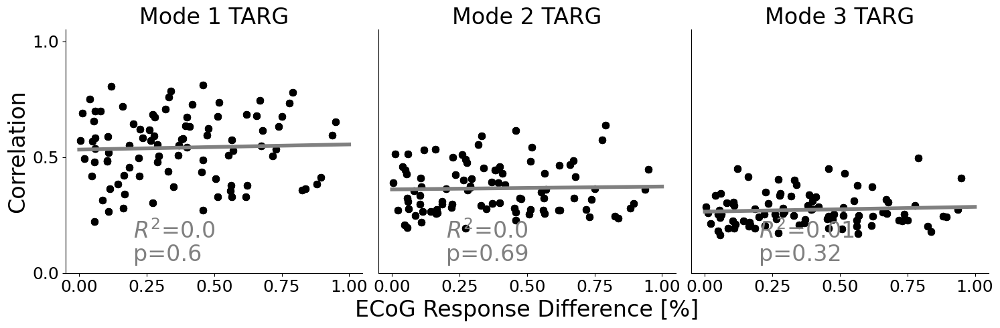

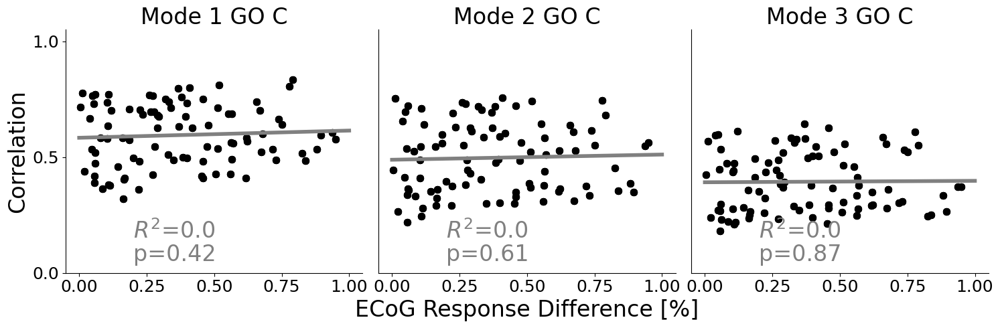

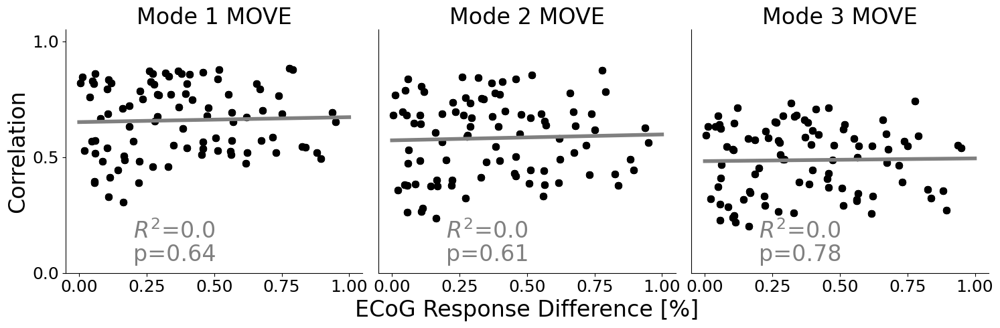

In [166]:
for align_event in align_events:
    fig, ax = plt.subplots(1,nmodes_plot,figsize=(nmodes_plot*5,5))
    ecog_diff = np.zeros((ccs[align_event].shape[0], ccs[align_event].shape[1]))*np.nan
    for irec1 in range(ccs[align_event].shape[0]):
        for irec2 in range(ccs[align_event].shape[1]):
            if irec1 != 0 and irec2 != 0 and irec1 != 3 and irec2 != 3 and irec1 != irec2:
                irec1_ecog = ecog_dec_acc_rec_site[align_event][irec1]/np.max(ecog_dec_acc_rec_site[align_event])
                irec2_ecog = ecog_dec_acc_rec_site[align_event][irec2]/np.max(ecog_dec_acc_rec_site[align_event])
                ecog_diff[irec1,irec2] = np.abs(irec1_ecog - irec2_ecog) 

    for ipc in range(nmodes_plot):
        dec_diff_map = ax[ipc].scatter(ecog_diff.flatten(), ccs[align_event][:,:,ipc].flatten(),s=50, c='black')
        for ipt in range(len(ecog_diff.flatten())):
            dec_diff_map = ax[ipc].scatter(ecog_diff.flatten()[ipt], ccs[align_event][:,:,ipc].flatten()[ipt],s=50, c='black')

        nan_mask = np.logical_and(~np.isnan(ecog_diff.flatten()), ~np.isnan(ccs[align_event][:,:,ipc].flatten()))
        fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(ecog_diff.flatten()[nan_mask], ccs[align_event][:,:,ipc].flatten()[nan_mask])
        intercept = regfit.intercept_
        slope = regfit.coef_[0]
        ax[ipc].annotate(f'p={np.round(pval,2)}',(.20,.05), fontsize=24, color=(0.5,0.5,0.5))
        ax[ipc].annotate(f'$R^2$={np.round(fitscore,2)}',(.20,.15), fontsize=24, color=(0.5,0.5,0.5))

        ax[ipc].plot([0,1], [intercept, slope + intercept], color=(0.5, 0.5, 0.5))
        ax[ipc].set_yticks([])
        ax[ipc].set(title=f"Mode {ipc+1} {align_event[:4]}", ylim=(0,1.05))
        if ipc == 0:
            ax[ipc].set_yticks([0,.5,1])
            ax[ipc].set(ylabel='Correlation')
        if ipc == 1:
            ax[ipc].set(xlabel='ECoG Response Difference [%]')
        # elif ipc == npcs-1:
        #     cb = plt.colorbar(dec_diff_map, label='X-Position \n Difference [mm]')
    fig.tight_layout()
    # aopy.visualization.savefig(base_save_dir, f'cca_cc_delta_dec.svg')

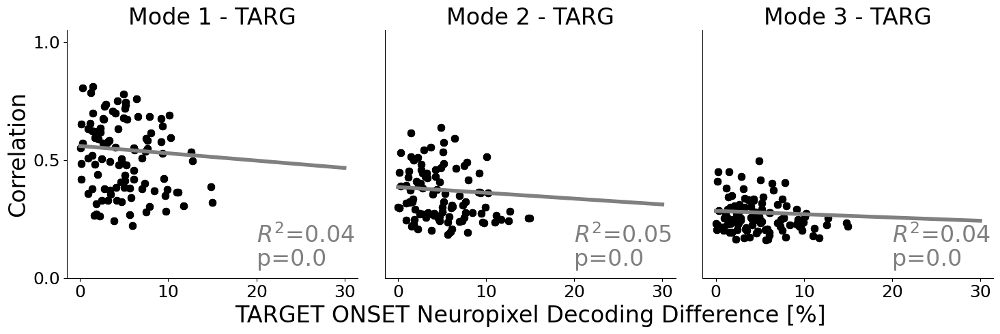

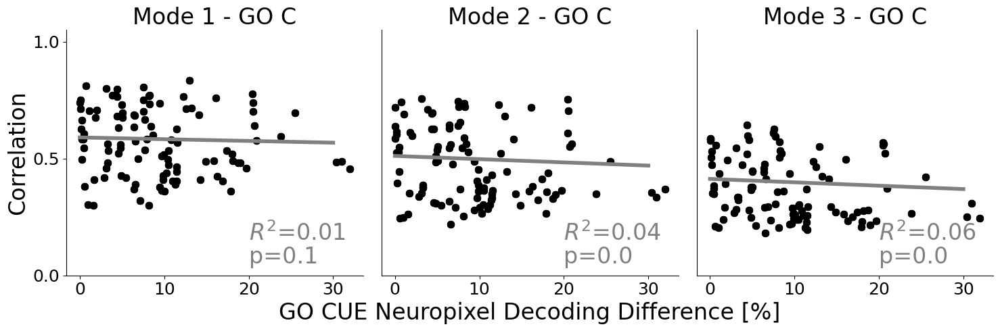

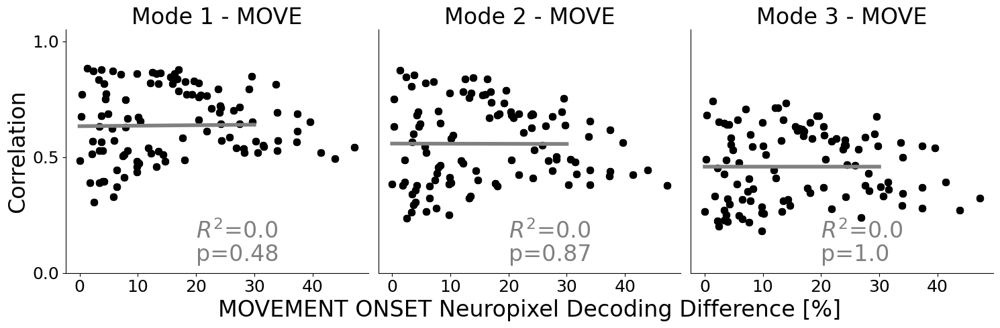

In [167]:
for align_event in align_events:
    fig, ax = plt.subplots(1,nmodes_plot,figsize=(nmodes_plot*5,5))
    np_acc_arg_sort = np.argsort(max_np_decoding[align_event])
    dec_diff = np.zeros((ccs[align_event].shape[0], ccs[align_event].shape[1]))*np.nan
    for irec1 in range(ccs[align_event].shape[0]):
        for irec2 in range(ccs[align_event].shape[1]):
            if irec1 != 0 and irec2 != 0:
                dec_diff[irec1,irec2] = np.abs(max_np_decoding[align_event][irec1] - max_np_decoding[align_event][irec2]) 

    for ipc in range(nmodes_plot):
        dec_diff_map = ax[ipc].scatter(100*dec_diff.flatten(), ccs[align_event][:,:,ipc].flatten(),s=50, c='black')
        for ipt in range(len(dec_diff.flatten())):
            dec_diff_map = ax[ipc].scatter(100*dec_diff.flatten()[ipt], ccs[align_event][:,:,ipc].flatten()[ipt],s=50, c='black')

        nan_mask = np.logical_and(~np.isnan(dec_diff.flatten()), ~np.isnan(ccs[align_event][:,:,ipc].flatten()))
        fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(100*dec_diff.flatten()[nan_mask], ccs[align_event][:,:,ipc].flatten()[nan_mask])
        intercept = regfit.intercept_
        # intercepts.append(intercept)
        slope = regfit.coef_[0]
        # slopes.append(slope)
        ax[ipc].annotate(f'p={np.round(pval,2)}',(20,.05), fontsize=24, color=(0.5,0.5,0.5))
        ax[ipc].annotate(f'$R^2$={np.round(fitscore,2)}',(20,.15), fontsize=24, color=(0.5,0.5,0.5))

        ax[ipc].plot([0,30], [intercept, slope*10 + intercept], color=(0.5, 0.5, 0.5))
        ax[ipc].set_yticks([])
        ax[ipc].set(title=f"Mode {ipc+1} - {align_event[:4]}", ylim=(0,1.05))
        if ipc == 0:
            ax[ipc].set_yticks([0,.5,1])
            ax[ipc].set(ylabel='Correlation')
        if ipc == 1:
            ax[ipc].set(xlabel=f'{align_event} Neuropixel Decoding Difference [%]')
        # elif ipc == npcs-1:
        #     cb = plt.colorbar(dec_diff_map, label='X-Position \n Difference [mm]')
    fig.tight_layout()
    # aopy.visualization.savefig(base_save_dir, f'cca_cc_delta_dec.svg')

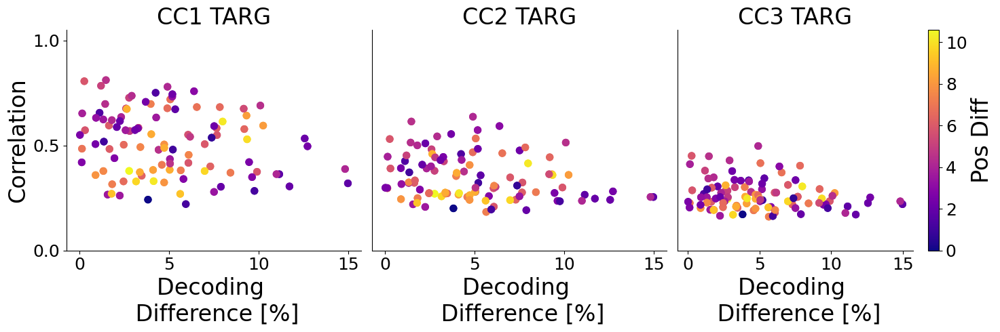

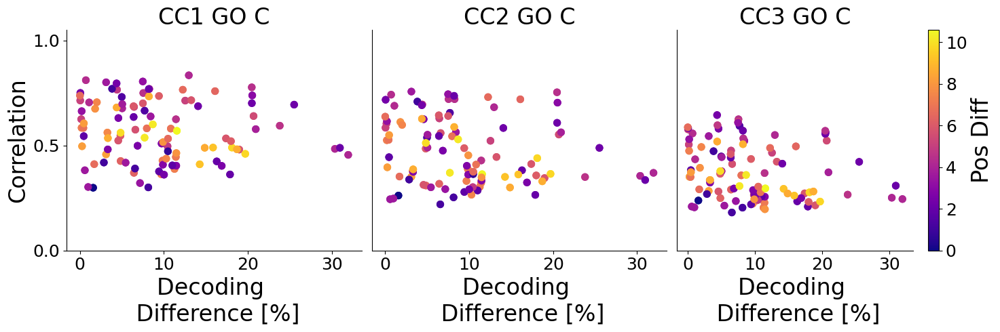

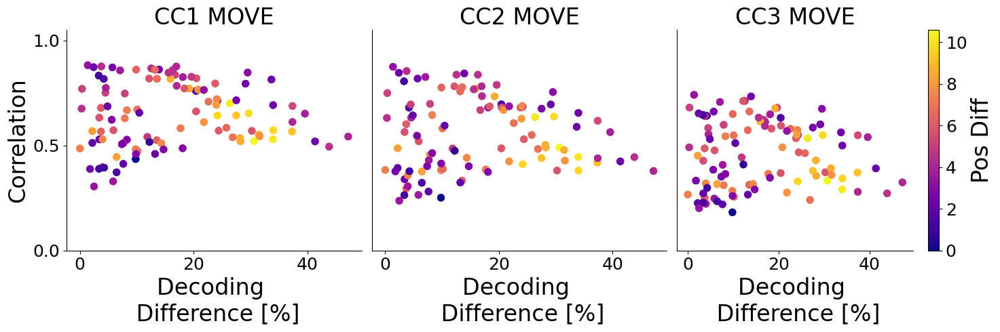

In [168]:
for align_event in align_events:
    dec_diff = np.zeros((ccs[align_event].shape[0], ccs[align_event].shape[1]))*np.nan
    ecog_diff = np.zeros((ccs[align_event].shape[0], ccs[align_event].shape[1]))*np.nan
    for irec1 in range(ccs[align_event].shape[0]):
        for irec2 in range(ccs[align_event].shape[1]):
            if irec1 != 0 and irec2 != 0 and irec1 != 3 and irec2 != 3 and irec1 != irec2:
                irec1_ecog = ecog_dec_acc_rec_site[align_event][irec1]/np.max(ecog_dec_acc_rec_site[align_event])
                irec2_ecog = ecog_dec_acc_rec_site[align_event][irec2]/np.max(ecog_dec_acc_rec_site[align_event])
                ecog_diff[irec1,irec2] = np.abs(irec1_ecog - irec2_ecog) 
    for irec1 in range(ccs[align_event].shape[0]):
        for irec2 in range(ccs[align_event].shape[1]):
            if irec1 != 0 and irec2 != 0:
                dec_diff[irec1,irec2] = np.abs(max_np_decoding[align_event][irec1] - max_np_decoding[align_event][irec2]) 
    
    fig, ax = plt.subplots(1,nmodes_plot,figsize=(nmodes_plot*5,5))
    for ipc in range(nmodes_plot):
        dec_diff_map = ax[ipc].scatter(100*dec_diff.flatten(), ccs[align_event][:,:,ipc].flatten(),s=50, c=pos_diff.flatten(), cmap='plasma')
        if ipc == nmodes_plot-1:
            cb = plt.colorbar(dec_diff_map, label='Pos Diff')
        ax[ipc].set_yticks([])
        ax[ipc].set(xlabel='Decoding \n Difference [%]', title=f"CC{ipc+1} {align_event[:4]}", ylim=(0,1.05))
        if ipc == 0:
            ax[ipc].set_yticks([0,.5,1])
            ax[ipc].set(ylabel='Correlation')
    fig.tight_layout()
    # aopy.visualization.savefig(base_save_dir, f'cca_cc_delta_dec_colored.svg')

In [169]:


# nmodes_plot = 3
# for align_event in align_events:
#     fig, ax = plt.subplots(1,nmodes_plot,figsize=(nmodes_plot*5,5))
#     dim_diff = np.zeros((ccs.shape[0], ccs.shape[1]))*np.nan
#     for irec1 in range(ccs.shape[0]):
#         for irec2 in range(ccs.shape[1]):
#             if irec1 != 0 and irec2 != 0:
#                 dim_diff[irec1,irec2] = np.abs(np_pop_dynamics['dimensionality'][align_event]['PR_norm'][irec1] - np_pop_dynamics['dimensionality'][align_event]['PR_norm'][irec2]) 

#     for ipc in range(nmodes_plot):
#         # ax[ipc].plot(100*dec_diff.flatten(), ccs[:,:,ipc].flatten(),'k.', markersize=10)
#         # dec_diff_map = ax[ipc].scatter(100*dec_diff.flatten(), ccs[:,:,ipc].flatten(),s=50, c=(0.75, 0.75, 0.75))
#         dec_diff_map = ax[ipc].scatter(100*dim_diff.flatten(), ccs[:,:,ipc].flatten(),s=50, c='black')
#         for ipt in range(len(dec_diff.flatten())):
#             # if pos_labels[:,:,0].flatten()[ipt] == rec1 and pos_labels[:,:,1].flatten()[ipt] == rec2:
#                 # print(100*dec_diff.flatten()[ipt], ccs[:,:,ipc].flatten()[ipt])
#             dec_diff_map = ax[ipc].scatter(100*dim_diff.flatten()[ipt], ccs[:,:,ipc].flatten()[ipt],s=50, c='black')

#         nan_mask = np.logical_and(~np.isnan(dim_diff.flatten()), ~np.isnan(ccs[:,:,ipc].flatten()))
#         fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(100*dim_diff.flatten()[nan_mask], ccs[:,:,ipc].flatten()[nan_mask])
#         intercept = regfit.intercept_
#         # intercepts.append(intercept)
#         slope = regfit.coef_[0]
#         # slopes.append(slope)
#         ax[ipc].annotate(f'p={np.round(pval,2)}',(20,.05), fontsize=24, color=(0.5,0.5,0.5))
#         ax[ipc].annotate(f'$R^2$={np.round(fitscore,2)}',(20,.15), fontsize=24, color=(0.5,0.5,0.5))

#         ax[ipc].plot([0,30], [intercept, slope*10 + intercept], color=(0.5, 0.5, 0.5))
#         ax[ipc].set_yticks([])
#         ax[ipc].set(title=f"Mode {ipc+1} - {align_event}", ylim=(0,1.05))
#         if ipc == 0:
#             ax[ipc].set_yticks([0,.5,1])
#             ax[ipc].set(ylabel='Correlation')
#         if ipc == 1:
#             ax[ipc].set(xlabel=f'{align_event} Dimensionality Difference [%]')
#         # elif ipc == npcs-1:
#         #     cb = plt.colorbar(dec_diff_map, label='X-Position \n Difference [mm]')
#     fig.tight_layout()
#     # aopy.visualization.savefig(base_save_dir, f'cca_cc_delta_dec.svg')

In [170]:
# # Extract ccs for sites within each brain area
# site_mask_M1 = np.isin(recording_site, recording_brain_areas['M1'])
# site_mask_PM = np.isin(recording_site, recording_brain_areas['PM'])

# fig, ax = plt.subplots(3, npcs, figsize=(npcs*4, 9))
# for ipc in range(npcs):
#     im = ax[0,ipc].pcolor(ccs[site_mask_M1, :,ipc][:,site_mask_M1])
#     cb = plt.colorbar(im)
#     ax[0,ipc].set_xticks(np.arange(np.sum(site_mask_M1))+0.5, recording_site[site_mask_M1])
#     ax[0,ipc].set_yticks(np.arange(np.sum(site_mask_M1))+0.5, recording_site[site_mask_M1])
#     ax[0,ipc].set(xlabel='Recording Site', ylabel='Recording Site', title=f"M1 Sites PC: {ipc+1}")

#     im = ax[1,ipc].pcolor(ccs[site_mask_PM, :,ipc][:,site_mask_PM])
#     cb = plt.colorbar(im)
#     ax[1,ipc].set_xticks(np.arange(np.sum(site_mask_PM))+0.5, recording_site[site_mask_PM])
#     ax[1,ipc].set_yticks(np.arange(np.sum(site_mask_PM))+0.5, recording_site[site_mask_PM])
#     ax[1,ipc].set(xlabel='Recording Site', ylabel='Recording Site', title=f"PM Sites PC: {ipc+1}")

#     im = ax[2,ipc].pcolor(ccs[site_mask_M1, :,ipc][:,site_mask_PM])
#     cb = plt.colorbar(im)
#     ax[2,ipc].set_xticks(np.arange(np.sum(site_mask_PM))+0.5, recording_site[site_mask_PM])
#     ax[2,ipc].set_yticks(np.arange(np.sum(site_mask_M1))+0.5, recording_site[site_mask_M1])
#     ax[2,ipc].set(xlabel='Recording Site PM', ylabel='Recording Site M1', title=f"Cross Area PC: {ipc+1}")

# fig.tight_layout()
# plt.show()

In [171]:
# # Project trials onto shared PCs. Compare targeted pairs
# fig, ax = plt.subplots(1,6, figsize=(20,3))
# ntargets = np.array(rotations[0][0]).shape[2]
# smooth_width = 300

# # Compare site 11 and 45
# irec1 = np.where(recording_site==98)[0][0]
# irec2 = np.where(recording_site==45)[0][0]
# # Ma, Mb, S = compute_CCA(np.vstack(np.swapaxes(rotations[irec1][1], 1,2)).T, np.vstack(np.swapaxes(rotations[irec2][1], 1,2)).T)
# Ma, Mb, S = compute_CCA(proj_data[irec1], proj_data[irec2])
# site1_proj_all = []
# site2_proj_all = []
# for itarget in range(ntargets):
#     # site1_proj = np.array(rotations[irec1][0])[:,:,itarget] @ Ma
#     # site2_proj = np.array(rotations[irec2][0])[:,:,itarget] @ Mb
#     temp_target_labels1 = np.array(df['target_idx'][df['good_trial']*(df['date']==dates[irec1])])
#     temp_target_labels2 = np.array(df['target_idx'][df['good_trial']*(df['date']==dates[irec2])])
#     site1_proj = np.mean(centered_data[irec1][:,temp_target_labels1==(itarget+1),:], axis=1) @ Ma
#     site2_proj = np.mean(centered_data[irec2][:,temp_target_labels2==(itarget+1),:], axis=1) @ Mb
#     site1_proj_all.append(site1_proj)
#     site2_proj_all.append(site2_proj)
#     # smooth_timeseries_gaus(rotations[irec][0][:,0,icond], new_bin_fs_rot, smooth_width)
    
    
# centered_cc1_site1 = np.array(site1_proj_all)[:,:,0] - np.mean(np.array(site1_proj_all)[:,:,0], axis=0)
# centered_cc2_site1 = np.array(site1_proj_all)[:,:,1] - np.mean(np.array(site1_proj_all)[:,:,1], axis=0)
# centered_cc1_site2 = np.array(site2_proj_all)[:,:,0] - np.mean(np.array(site2_proj_all)[:,:,0], axis=0)
# centered_cc2_site2 = np.array(site2_proj_all)[:,:,1] - np.mean(np.array(site2_proj_all)[:,:,1], axis=0)
# # ax[0].plot(smooth_timeseries_gaus(site1_proj[:,0], new_bin_fs, smooth_width), smooth_timeseries_gaus(site1_proj[:,1], new_bin_fs, smooth_width), color=colors[itarget])
# # ax[0].plot(smooth_timeseries_gaus(site2_proj[:,0], new_bin_fs, smooth_width), smooth_timeseries_gaus(site2_proj[:,1], new_bin_fs, smooth_width), '--', color=colors[itarget])
# for itarget in range(ntargets):
#     ax[0].plot(smooth_timeseries_gaus(centered_cc1_site1[itarget,:], new_bin_fs, smooth_width), smooth_timeseries_gaus(centered_cc2_site1[itarget,:], new_bin_fs, smooth_width), color=colors[itarget])
#     ax[1].plot(smooth_timeseries_gaus(centered_cc1_site2[itarget,:], new_bin_fs, smooth_width), smooth_timeseries_gaus(centered_cc2_site2[itarget,:], new_bin_fs, smooth_width), '--', color=colors[itarget])

### Control for number of units

/tmp/ipykernel_3120202/1087496735.py:12: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.673,0.531 - p: 0.0, 0.001


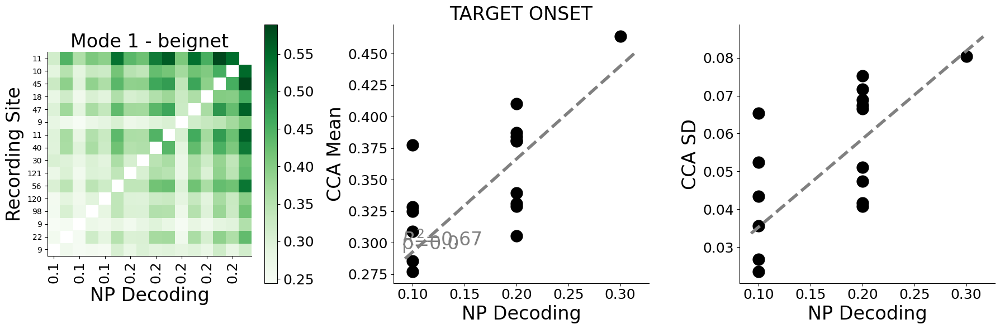

/tmp/ipykernel_3120202/1087496735.py:12: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.866,0.639 - p: 0.0, 0.0


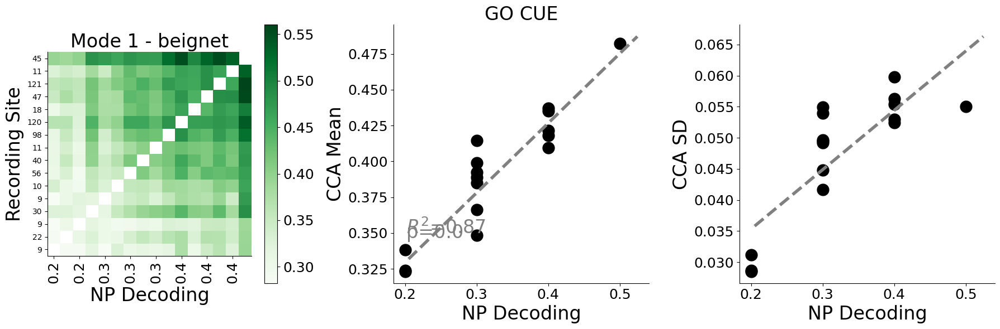

/tmp/ipykernel_3120202/1087496735.py:12: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im)


R2: 0.882,0.781 - p: 0.0, 0.0


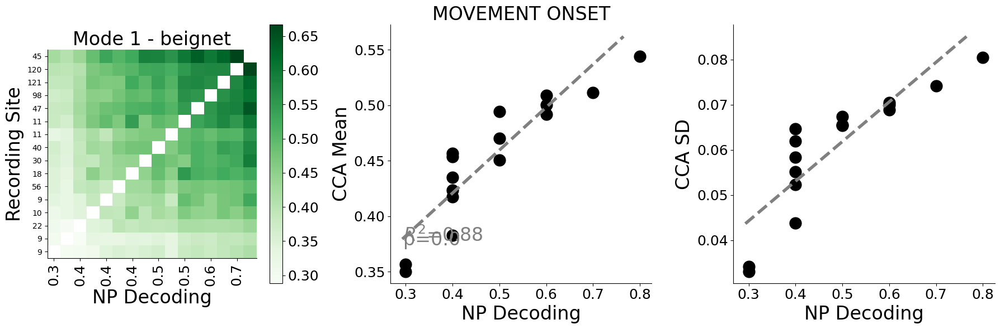

In [23]:
# Sort by neuropixel decoding
for align_event in align_events:
    cr_sort = np.argsort(np.array(max_np_decoding[align_event]))
    # for ipc in range(npcs):
    for ipc in range(1):
        fig, ax = plt.subplots(1, 3, figsize=(18,6))
        # good_nan_mask = np.sum(np.isnan(ccs_control_units[align_event][cr_sort,:,:][:,cr_sort,ipc]), axis=0) < nrecs
        good_nan_mask = np.logical_and(np.sum(np.isnan(ccs_control_units[align_event][cr_sort,:,:][:,cr_sort,ipc]), axis=0) < nrecs, ~np.isnan(np.array(max_np_decoding[align_event])[cr_sort]))
        input_array = ccs_control_units[align_event][cr_sort,:,:][:,cr_sort,ipc][good_nan_mask,:][:,good_nan_mask]
        input_array[np.diag_indices(input_array.shape[0])] = np.nan # CCA R with itself will be 1 so remove those
        im = ax[0].pcolor(input_array, cmap='Greens')
        cb = plt.colorbar(im)
        ax[0].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, recording_site[cr_sort][good_nan_mask], rotation = 0, fontsize=10)
        ax[0].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(np.array(max_np_decoding[align_event])[cr_sort], 1)[good_nan_mask][::2], rotation = 90)
        ax[0].set(xlabel='NP Decoding', ylabel='Recording Site', title=f"Mode {ipc+1} - {subject}")
        ax[0].set_aspect('equal')

        ax[1].plot(np.round(np.array(max_np_decoding[align_event])[cr_sort], 1)[good_nan_mask], np.nanmean(input_array, axis=0),'k.', markersize=30)
        ax[2].plot(np.round(np.array(max_np_decoding[align_event])[cr_sort], 1)[good_nan_mask], np.nanstd(input_array, axis=0),'k.', markersize=30)
        ax[1].set(xlabel='NP Decoding', ylabel='CCA Mean', title=f"{align_event}")
        ax[2].set(xlabel='NP Decoding', ylabel='CCA SD')

#         # Fit lines for axis 1 and 2
        xaxis1 = np.array(max_np_decoding[align_event])[cr_sort][good_nan_mask] 
        yaxis1 = np.nanmean(input_array, axis=0)
        _,R21,_,pval1,regfit1 = aopy.analysis.base.linear_fit_analysis2D(xaxis1, yaxis1)
        ax[1].plot([xaxis1[0], xaxis1[-1]], [(regfit1.coef_[0][0]*xaxis1[0])+regfit1.intercept_[0],(regfit1.coef_[0][0]*xaxis1[-1])+regfit1.intercept_[0]], '--', color=(0.5,0.5,0.5))
        ax[1].annotate(f'p={np.round(pval1,2)}',(ax[1].get_xlim()[0]+np.abs(ax[1].get_xlim()[0]*.1), ax[1].get_ylim()[0]+np.abs(ax[1].get_ylim()[0]*.1)), fontsize=24, color=(0.5,0.5,0.5))
        ax[1].annotate(f'$R^2$={np.round(R21,2)}',(ax[1].get_xlim()[0]+np.abs(ax[1].get_xlim()[0]*.1), ax[1].get_ylim()[0]+np.abs(ax[1].get_ylim()[0]*.11)), fontsize=24, color=(0.5,0.5,0.5))

        xaxis2 = np.array(max_np_decoding[align_event])[cr_sort][good_nan_mask] 
        yaxis2 = np.nanstd(input_array, axis=0)
        _,R22,_,pval2,regfit2 = aopy.analysis.base.linear_fit_analysis2D(xaxis2, yaxis2)
        ax[2].plot([xaxis2[0], xaxis2[-1]], [(regfit2.coef_[0][0]*xaxis2[0])+regfit2.intercept_[0],(regfit2.coef_[0][0]*xaxis2[-1])+regfit2.intercept_[0]], '--', color=(0.5,0.5,0.5))
        print(f"R2: {np.round(R21, 3)},{np.round(R22,3)} - p: {np.round(pval1,3)}, {np.round(pval2,3)}")
        ax[2].annotate(f'p={np.round(pval2,2)}',(-1,.05), fontsize=24, color=(0.5,0.5,0.5))
        ax[2].annotate(f'$R^2$={np.round(R22,2)}',(-1,.052), fontsize=24, color=(0.5,0.5,0.5))

        fig.tight_layout()
        plt.show()

In [24]:
# for align_event in align_events:
align_event = align_events[-1]
decoding = np.array([np.mean(np_decoding[align_event]['pseudopopulations']['column_scores_event'][isite]) for isite in range(nsites)])
good_nan_mask = np.where(~np.isnan(decoding))[0]
cr_sort = np.argsort(decoding[good_nan_mask])
fig, ax = plt.subplots(1, 1, figsize=(3.5,3))
# plt.gca().xaxis.set_major_formatter(FormatStrFormatter('%g'))
# good_nan_mask = np.logical_and(np.sum(np.isnan(ccs_control_units_column[align_event][cr_sort,:,:][:,cr_sort,ipc]), axis=0) < nrecs, ~np.isnan(decoding[cr_sort]))

input_array = ccs_control_units_column[align_event][good_nan_mask,:,:][:,good_nan_mask,:][cr_sort,:,:][:,cr_sort,0]
im = ax.pcolor(input_array, cmap='Greens')
cb = plt.colorbar(im)
cb.set_label('CCA R', labelpad=-20)
im.set_clim(0.3,0.6)
cb.set_ticks(im.get_clim())
ax.set_xticks((0,input_array.shape[0]), (np.round((100*decoding[good_nan_mask][cr_sort]).astype(int), 2)[0], np.round((100*decoding[good_nan_mask][cr_sort]).astype(int), 2)[-1]))
ax.set_yticks((0,input_array.shape[0]), (np.round((100*decoding[good_nan_mask][cr_sort]).astype(int), 2)[0], np.round((100*decoding[good_nan_mask][cr_sort]).astype(int), 2)[-1]))
ax.set(xlabel='Decoding [%]', ylabel='Decoding [%]')
ax.set_aspect('equal')
aopy.visualization.savefig(base_save_dir, f'{subject}_CCA_column_dec_organized_{align_event}.svg')

NameError: name 'nsites' is not defined

In [ ]:
# Sort by caudal to rostral
for align_event in align_events:
    cr_sort = np.argsort(ecog_dec_acc[subject]['rc_axis'][:,0])
    for ipc in range(1):
        fig, ax = plt.subplots(1, 3, figsize=(18,6))
        good_nan_mask = np.sum(np.isnan(ccs_control_units[align_event][cr_sort,:,:][:,cr_sort,ipc]), axis=0) < nrecs
        input_array = ccs_control_units[align_event][cr_sort,:,:][:,cr_sort,ipc][good_nan_mask,:][:,good_nan_mask]
        input_array[np.diag_indices(input_array.shape[0])] = np.nan # CCA R with itself will be 1 so remove those
        im = ax[0].pcolor(input_array, cmap='Greens')
        cb = plt.colorbar(im)
        ax[0].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, recording_site[cr_sort][good_nan_mask], rotation = 0, fontsize=10)
        ax[0].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(ecog_dec_acc[subject]['rc_axis'][:,0][cr_sort], 1)[good_nan_mask][::2], rotation = 90)
        ax[0].set(xlabel='Site X-pos [mm]', ylabel='Recording Site', title=f"Mode {ipc+1} - {subject}")
        ax[0].set_aspect('equal')

        ax[1].plot(np.round(ecog_dec_acc[subject]['rc_axis'][:,0][cr_sort], 1)[good_nan_mask], np.nanmean(input_array, axis=0),'k.', markersize=30)
        ax[2].plot(np.round(ecog_dec_acc[subject]['rc_axis'][:,0][cr_sort], 1)[good_nan_mask], np.nanstd(input_array, axis=0),'k.', markersize=30)
        ax[1].set(xlabel='Site X-pos', ylabel='CCA Mean', title=f"{align_event}")
        ax[2].set(xlabel='Site X-pos', ylabel='CCA SD')

        # Fit lines for axis 1 and 2
        xaxis1 = ecog_dec_acc[subject]['rc_axis'][:,0][cr_sort][good_nan_mask] 
        yaxis1 = np.nanmean(input_array, axis=0)
        _,R21,_,pval1,regfit1 = aopy.analysis.base.linear_fit_analysis2D(xaxis1, yaxis1)
        ax[1].plot([xaxis1[0], xaxis1[-1]], [(regfit1.coef_[0][0]*xaxis1[0])+regfit1.intercept_[0],(regfit1.coef_[0][0]*xaxis1[-1])+regfit1.intercept_[0]], '--', color=(0.5,0.5,0.5))
        ax[1].annotate(f'p={np.round(pval1,2)}',(ax[1].get_xlim()[0]+np.abs(ax[1].get_xlim()[0]*.1), ax[1].get_ylim()[0]+np.abs(ax[1].get_ylim()[0]*.1)), fontsize=24, color=(0.5,0.5,0.5))
        ax[1].annotate(f'$R^2$={np.round(R21,2)}',(ax[1].get_xlim()[0]+np.abs(ax[1].get_xlim()[0]*.1), ax[1].get_ylim()[0]+np.abs(ax[1].get_ylim()[0]*.11)), fontsize=24, color=(0.5,0.5,0.5))

        xaxis2 = ecog_dec_acc[subject]['rc_axis'][:,0][cr_sort][good_nan_mask] 
        yaxis2 = np.nanstd(input_array, axis=0)
        _,R22,_,pval2,regfit2 = aopy.analysis.base.linear_fit_analysis2D(xaxis2, yaxis2)
        ax[2].plot([xaxis2[0], xaxis2[-1]], [(regfit2.coef_[0][0]*xaxis2[0])+regfit2.intercept_[0],(regfit2.coef_[0][0]*xaxis2[-1])+regfit2.intercept_[0]], '--', color=(0.5,0.5,0.5))
        print(f"R2: {np.round(R21, 3)},{np.round(R22,3)} - p: {np.round(pval1,3)}, {np.round(pval2,3)}")
        ax[2].annotate(f'p={np.round(pval2,2)}',(-1,.05), fontsize=24, color=(0.5,0.5,0.5))
        ax[2].annotate(f'$R^2$={np.round(R22,2)}',(-1,.052), fontsize=24, color=(0.5,0.5,0.5))

        fig.tight_layout()
        plt.show()

In [ ]:
# for align_event in align_events:
align_event = align_events[-1]
column_rc_pos = [column_units[irec]['rec_xpos'][0] for irec in range(len(column_units))]
cr_sort = np.argsort(column_rc_pos)
good_nan_mask = np.sum(np.isnan(ccs_control_units_column[align_event][cr_sort,:,:][:,cr_sort,ipc]), axis=0) < nrecs
fig, ax = plt.subplots(1, 1, figsize=(3.5,3))
input_array = ccs_control_units_column[align_event][good_nan_mask,:,:][:,good_nan_mask,:][cr_sort,:,:][:,cr_sort,0]
im = ax.pcolor(input_array, cmap='Greens')
cb = plt.colorbar(im)
cb.set_label('CCA R', labelpad=-20)
im.set_clim(0.3,0.6)
cb.set_ticks(im.get_clim())
ax.set_xticks((0,input_array.shape[0]), (np.round(np.min(column_rc_pos), 1), np.round(np.max(column_rc_pos), 1)))
ax.set_yticks((0,input_array.shape[0]), (np.round(np.min(column_rc_pos), 1), np.round(np.max(column_rc_pos), 1)))
ax.set(xlabel='X-position [mm]', ylabel='X-position [mm]')
ax.set_aspect('equal')
aopy.visualization.savefig(base_save_dir, f'{subject}_CCA_column_rcpos_organized_{align_event}.svg')

In [ ]:
for align_event in align_events:
    nmodes_plot = 3
    fig, ax = plt.subplots(1,nmodes_plot,figsize=(4*nmodes_plot,4))
    pos_diff = np.zeros((ccs_control_units[align_event].shape[0], ccs_control_units[align_event].shape[1]))*np.nan
    pos_labels = np.zeros((ccs_control_units[align_event].shape[0], ccs_control_units[align_event].shape[1],2))*np.nan
    for irec1 in range(ccs[align_event].shape[0]):
        for irec2 in range(ccs[align_event].shape[1]):
            if irec1 != irec2:
                pos_diff[irec1,irec2] = np.abs(ecog_dec_acc[subject]['rc_axis'][irec1,0] - ecog_dec_acc[subject]['rc_axis'][irec2,0])
                pos_labels[irec1,irec2,0] = irec1
                pos_labels[irec1,irec2,1] = irec2
    slopes = []
    intercepts = []
    for ipc in range(nmodes_plot):
        nan_mask = np.logical_and(~np.isnan(pos_diff.flatten()), ~np.isnan(ccs_control_units[align_event][:,:,ipc].flatten()))
        fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(pos_diff.flatten()[nan_mask], ccs_control_units[align_event][:,:,ipc].flatten()[nan_mask])
        print(fitscore)
        intercept = regfit.intercept_
        intercepts.append(intercept)
        slope = regfit.coef_[0]
        slopes.append(slope)
        ax[ipc].plot(pos_diff.flatten(), ccs_control_units[align_event][:,:,ipc].flatten(),'.')
        ax[ipc].plot([0,5], [intercept, slope*5 + intercept], 'k')
        ax[ipc].set(xlabel='$\Delta$ Ros-Caud Position', ylabel='Correlation', ylim=(0, .75))
        ax[ipc].set(title=f"CC{ipc+1} p={np.round(pval,3)}")
    plt.suptitle(f"{align_event}")
    fig.tight_layout()
    plt.show()

In [ ]:
for align_event in align_events:
    fig, ax = plt.subplots(1,nmodes_plot,figsize=(4*nmodes_plot,4))
    pos_diff = np.zeros((ccs_control_units[align_event].shape[0], ccs_control_units[align_event].shape[1]))*np.nan
    pos_labels = np.zeros((ccs_control_units[align_event].shape[0], ccs_control_units[align_event].shape[1],2))*np.nan
    for irec1 in range(ccs_control_units[align_event].shape[0]):
        for irec2 in range(ccs_control_units[align_event].shape[1]):
            if irec1 != irec2:
                pos_diff[irec1,irec2] = np.sqrt(np.sum((ecog_dec_acc[subject]['rc_axis'][irec1,:] - ecog_dec_acc[subject]['rc_axis'][irec2,:])**2))
                pos_labels[irec1,irec2,0] = irec1
                pos_labels[irec1,irec2,1] = irec2
    slopes = []
    intercepts = []
    for ipc in range(nmodes_plot):
        nan_mask = np.logical_and(~np.isnan(pos_diff.flatten()), ~np.isnan(ccs_control_units[align_event][:,:,ipc].flatten()))
        fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(pos_diff.flatten()[nan_mask], ccs_control_units[align_event][:,:,ipc].flatten()[nan_mask])
        print(fitscore)
        intercept = regfit.intercept_
        intercepts.append(intercept)
        slope = regfit.coef_[0]
        slopes.append(slope)
        ax[ipc].plot(pos_diff.flatten(), ccs_control_units[align_event][:,:,ipc].flatten(),'.')
        ax[ipc].plot([0,10], [intercept, slope*10 + intercept], 'k')
        ax[ipc].set(xlabel='$\Delta$ Position', ylabel='Correlation')
        ax[ipc].set(title=f"CC{ipc+1} {align_event[:4]}")
        ax[ipc].annotate(f'p={np.round(pval,2)}',(5,.40), fontsize=24, color=(0.5,0.5,0.5))
        ax[ipc].annotate(f'$R^2$={np.round(fitscore,2)}',(5,.35), fontsize=24, color=(0.5,0.5,0.5))
    fig.tight_layout()
    plt.show()

In [ ]:
site_2_align = 6
for align_event in align_events:
    fig, ax = plt.subplots(1,1,figsize=(3,3))
    pos_diff = np.zeros((ccs_control_units_column[align_event].shape[0], ccs_control_units_column[align_event].shape[1]))*np.nan
    pos_labels = np.zeros((ccs_control_units_column[align_event].shape[0], ccs_control_units_column[align_event].shape[1],2))*np.nan
    for irec1 in range(ccs_control_units_column[align_event].shape[0]):
        for irec2 in range(ccs_control_units_column[align_event].shape[1]):
            if irec1 != irec2:
                pos_diff[irec1,irec2] = np.sqrt(np.sum((ecog_dec_acc[subject]['rc_axis'][irec1,:] - ecog_dec_acc[subject]['rc_axis'][irec2,:])**2))
                pos_labels[irec1,irec2,0] = irec1
                pos_labels[irec1,irec2,1] = irec2
    slopes = []
    intercepts = []
    
    nan_mask = np.logical_and(~np.isnan(pos_diff[site_2_align,:].flatten()), ~np.isnan(ccs_control_units_column[align_event][site_2_align,:,0].flatten()))
    fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(pos_diff[site_2_align,:].flatten()[nan_mask], ccs_control_units_column[align_event][site_2_align,:,0].flatten()[nan_mask])
    print(fitscore)
    intercept = regfit.intercept_
    intercepts.append(intercept)
    slope = regfit.coef_[0]
    slopes.append(slope)
    ax.plot(pos_diff[site_2_align,:].flatten(), ccs_control_units_column[align_event][site_2_align,:,0].flatten(),'k.')
    # ax.plot([0,10], [intercept, slope*10 + intercept], 'k')
    ax.set(xlabel='$\Delta$ Position [mm]', ylim=(0.2,0.8))
    ax.set_ylabel('CCA R',labelpad=-10)
    ax.set_xticks([0, 10])
    ax.set_yticks([0.2,0.8])
    # ax.set(title=f"CC{ipc+1} {align_event[:4]}")
    # ax.annotate(f'p={np.round(pval,2)}',(5,.40), fontsize=24, color=(0.5,0.5,0.5))
    # ax.annotate(f'$R^2$={np.round(fitscore,2)}',(5,.35), fontsize=24, color=(0.5,0.5,0.5))
    fig.tight_layout()
    aopy.visualization.savefig(base_save_dir, f'{subject}_dpos_cca_{align_event}_single_site.svg')

In [ ]:
for align_event in align_events:
    fig, ax = plt.subplots(1,1,figsize=(3,3))
    pos_diff = np.zeros((ccs_control_units_column[align_event].shape[0], ccs_control_units_column[align_event].shape[1]))*np.nan
    pos_labels = np.zeros((ccs_control_units_column[align_event].shape[0], ccs_control_units_column[align_event].shape[1],2))*np.nan
    for irec1 in range(ccs_control_units_column[align_event].shape[0]):
        for irec2 in range(ccs_control_units_column[align_event].shape[1]):
            if irec1 != irec2:
                pos_diff[irec1,irec2] = np.sqrt(np.sum((ecog_dec_acc[subject]['rc_axis'][irec1,:] - ecog_dec_acc[subject]['rc_axis'][irec2,:])**2))
                pos_labels[irec1,irec2,0] = irec1
                pos_labels[irec1,irec2,1] = irec2
    slopes = []
    intercepts = []
    
    nan_mask = np.logical_and(~np.isnan(pos_diff.flatten()), ~np.isnan(ccs_control_units_column[align_event][:,:,0].flatten()))
    fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(pos_diff.flatten()[nan_mask], ccs_control_units_column[align_event][:,:,0].flatten()[nan_mask])
    print(fitscore)
    intercept = regfit.intercept_
    intercepts.append(intercept)
    slope = regfit.coef_[0]
    slopes.append(slope)
    ax.plot(pos_diff.flatten(), ccs_control_units_column[align_event][:,:,0].flatten(),'k.')
    ax.plot([0,10], [intercept, slope*10 + intercept], 'k')
    ax.set(xlabel='$\Delta$ Position [mm]', ylim=(0.2,0.8))
    ax.set_ylabel('CCA R',labelpad=-10)
    ax.set_xticks([0, 10])
    ax.set_yticks([0.2,0.8])
    # ax.set(title=f"CC{ipc+1} {align_event[:4]}")
    # ax.annotate(f'p={np.round(pval,2)}',(5,.40), fontsize=24, color=(0.5,0.5,0.5))
    # ax.annotate(f'$R^2$={np.round(fitscore,2)}',(5,.35), fontsize=24, color=(0.5,0.5,0.5))
    fig.tight_layout()
    aopy.visualization.savefig(base_save_dir, f'{subject}_dpos_cca_{align_event}.svg')

In [ ]:
nneighbors = 1
np_v_cca_fitscore = {}
for align_event in align_events:
    fig, ax = plt.subplots(1,nmodes_plot,figsize=(5*nmodes_plot,5))
    np_v_cca_fitscore[align_event] = np.zeros(nmodes_plot)*np.nan
    for ipc in range(nmodes_plot):
        # good_nan_idx = np.where(np.sum(np.isnan(ccs_control_units[align_event][:,:,ipc]), axis=0) < nrecs)[0]
        good_nan_idx = np.where(np.logical_and(np.sum(np.isnan(ccs_control_units[align_event][:,:,ipc]), axis=0) < nrecs, ~np.isnan(np.array(max_np_decoding[align_event]))))[0]
        np_acc_ordered_site_idx = good_nan_idx[np.argsort(np.array(max_np_decoding[align_event])[good_nan_idx])]
        np_acc_neighboring_ccs = get_neighboring_ccs(ccs_control_units[align_event][np_acc_ordered_site_idx,:,ipc][:,np_acc_ordered_site_idx], nneighbors =nneighbors)


    # Compute statistics for NP accuracy ordered
        ax[ipc].plot(np.array(max_np_decoding[align_event])[np_acc_ordered_site_idx], np_acc_neighboring_ccs,'.', color='purple', markersize=15)
        fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(np.array(max_np_decoding[align_event])[np_acc_ordered_site_idx], np_acc_neighboring_ccs)
        print(f"R: {np.round(fitscore,3)}", pval)
        intercept, slope = regfit.intercept_, regfit.coef_[0]
        ax[ipc].plot([ax[ipc].get_xlim()[0],ax[ipc].get_xlim()[1]], [(slope*ax[ipc].get_xlim()[0])+intercept, (slope*ax[ipc].get_xlim()[1])+intercept], '--', color='purple', linewidth=3)
        ax[ipc].set(xlabel='NP Accuracy', ylabel='CCA R', title=f'Mode {ipc+1}')
        ax[ipc].annotate(f'$R^2$={np.round(fitscore,2)}',(.50,.4), fontsize=24, color='purple')
        np_v_cca_fitscore[align_event][ipc] = fitscore

    fig.tight_layout()
    plt.show()

In [ ]:
nneighbors = 1
for align_event in align_events:
    fig, ax = plt.subplots(1,1,figsize=(3.5,3))
    column_decoding = np.array([np.mean(np_decoding[align_event]['pseudopopulations']['column_scores_event'][irec]) for irec in range(nsites)])
    good_nan_idx = np.where(np.logical_and(np.sum(np.isnan(ccs_control_units_column[align_event][:,:,0]), axis=0) < nrecs, ~np.isnan(column_decoding)))[0]
    np_acc_ordered_site_idx = good_nan_idx[np.argsort(column_decoding[good_nan_idx])]
    np_acc_neighboring_ccs = get_neighboring_ccs(ccs_control_units_column[align_event][np_acc_ordered_site_idx,:,0][:,np_acc_ordered_site_idx], nneighbors =nneighbors)


# Compute statistics for NP accuracy ordered
    ax.plot(column_decoding[np_acc_ordered_site_idx], np_acc_neighboring_ccs,'.', color='black', markersize=15)
    ax.set(xlim=(0.2, 0.7), ylim=(0.2, 0.7))
    fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(column_decoding[np_acc_ordered_site_idx], np_acc_neighboring_ccs)
    print(f"R: {np.round(fitscore,3)}", pval)
    intercept, slope = regfit.intercept_, regfit.coef_[0]
    ax.plot([ax.get_xlim()[0],ax.get_xlim()[1]], [(slope*ax.get_xlim()[0])+intercept, (slope*ax.get_xlim()[1])+intercept], '--', color='black', linewidth=3)
    ax.set_xticks([0.2, 0.7]), ax.set_yticks([0.2, 0.7])
    ax.set(xlabel='Accuracy [%]')
    ax.set_ylabel('Neighboring\nCCA R', labelpad=-20)
    ax.annotate(f'$R^2$={np.round(fitscore,2)}',(.40,0.25), fontsize=16, color='black')

    fig.tight_layout()
    aopy.visualization.savefig(base_save_dir, f'{subject}_neighboring_cca_acc_{align_event}.svg')

In [ ]:
for align_event in align_events:
    fig, ax = plt.subplots(1,nmodes_plot,figsize=(5*nmodes_plot,5))
    for ipc in range(nmodes_plot):
        column_rc_pos = [column_units[irec]['rec_xpos'][0] for irec in range(len(column_units))]
        cr_sort = np.argsort(column_rc_pos)
        good_nan_idx = np.where(np.sum(np.isnan(ccs_control_units_column[align_event][:,:,ipc]), axis=0) < nrecs)[0]
        rc_ordered_site_idx = good_nan_idx[np.argsort(ecog_dec_acc[subject]['rc_axis'][good_nan_idx,0])]
        rc_neighboring_ccs = get_neighboring_ccs(ccs_control_units[align_event][rc_ordered_site_idx,:,ipc][:,rc_ordered_site_idx], nneighbors =nneighbors)


    # Compute statistics for NP accuracy ordered
        ax[ipc].plot(ecog_dec_acc[subject]['rc_axis'][rc_ordered_site_idx,0], rc_neighboring_ccs,'.', color='red', markersize=15)
        # fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(ecog_dec_acc[subject]['rc_axis'][rc_ordered_site_idx,0], rc_neighboring_ccs)
        fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(ecog_dec_acc[subject]['rc_axis'][rc_ordered_site_idx,0], rc_neighboring_ccs)
        print(f"R: {np.round(fitscore,3)}", pval)
        intercept, slope = regfit.intercept_, regfit.coef_[0]
        ax[ipc].plot([ax[ipc].get_xlim()[0],ax[ipc].get_xlim()[1]], [(slope*ax[ipc].get_xlim()[0])+intercept, (slope*ax[ipc].get_xlim()[1])+intercept], '--', color='red', linewidth=3)
        ax[ipc].set(xlabel='RC position', ylabel='CCA R', title=f'Mode {ipc+1} {align_event[:4]}')
        ax[ipc].annotate(f'$R^2$={np.round(fitscore,2)}',(.50,.4), fontsize=24, color='red')

    fig.tight_layout()
    plt.show()

In [ ]:
nneighbors = 1
for align_event in align_events:
    fig, ax = plt.subplots(1,1,figsize=(3.5,3))
    column_rc_pos = [column_units[irec]['rec_xpos'][0] for irec in range(len(column_units))]
    cr_sort = np.argsort(column_rc_pos)
    good_nan_mask = np.sum(np.isnan(ccs_control_units_column[align_event][cr_sort,:,:][:,cr_sort,0]), axis=0) < nrecs
    input_array = ccs_control_units_column[align_event][cr_sort,:,:][:,cr_sort,0][good_nan_mask,:][:,good_nan_mask]
    rc_neighboring_ccs = get_neighboring_ccs(input_array, nneighbors =nneighbors)


# Compute statistics for NP accuracy ordered
    ax.plot(column_rc_pos, rc_neighboring_ccs,'.', color='C0', markersize=15)
    # fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(ecog_dec_acc[subject]['rc_axis'][rc_ordered_site_idx,0], rc_neighboring_ccs)
    fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(np.array(column_rc_pos), rc_neighboring_ccs)
    print(f"R: {np.round(fitscore,3)}", pval)
    intercept, slope = regfit.intercept_, regfit.coef_[0]

    ax.plot([ax.get_xlim()[0],ax.get_xlim()[1]], [(slope*ax.get_xlim()[0])+intercept, (slope*ax.get_xlim()[1])+intercept], '--', color='C0', linewidth=3)
    ax.set_xticks([-5, 6]), ax.set_yticks([0.3, 0.6])
    ax.set(xlabel='X-Position [mm]')
    ax.set_ylabel('Neighboring\nCCA R', labelpad=-20)
    ax.annotate(f'$R^2$={np.round(fitscore,2)}',(0,0.35), fontsize=16, color='C0')

    fig.tight_layout()
    aopy.visualization.savefig(base_save_dir, f'{subject}_neighboring_cca_rcpos_{align_event}.svg')

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

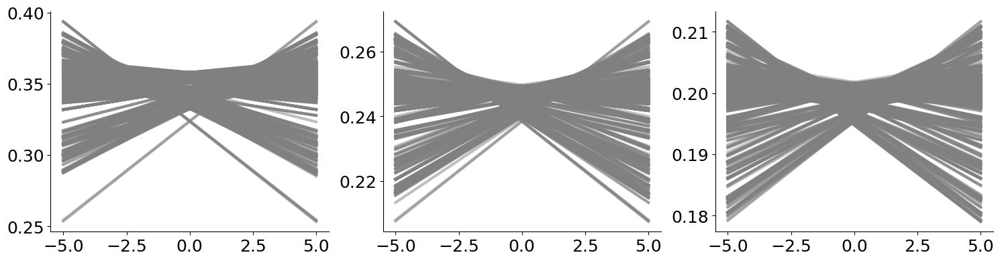

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

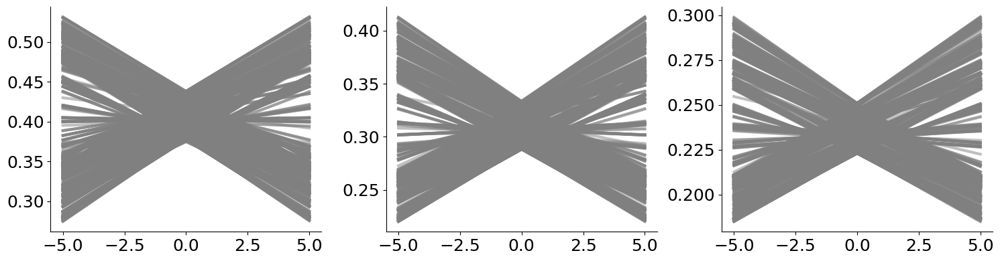

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

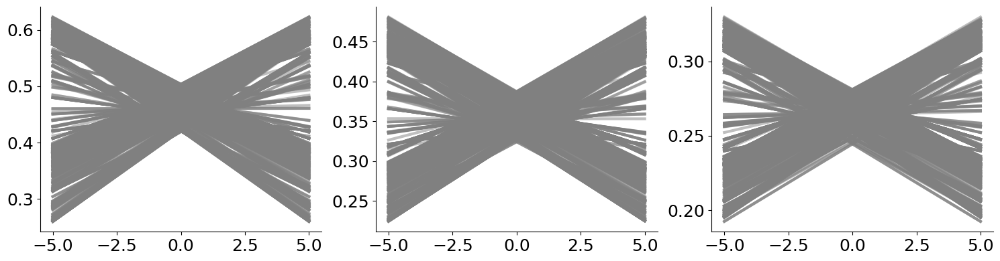

In [184]:
nrandom_axis = 1000
rc_r2 = {}
ml_r2 = {}
random_r2 = {}
random_angles = {}
column_positions = np.array([(column_units[irec]['rec_xpos'][0], column_units[irec]['rec_ypos'][0]) for irec in range(len(column_units))])
for align_event in align_events:
    fig, ax = plt.subplots(1,nmodes_plot,figsize=(5*nmodes_plot,4))
    rc_r2[align_event] = np.zeros(nmodes_plot)*np.nan
    ml_r2[align_event] = np.zeros(nmodes_plot)*np.nan
    random_r2[align_event] = np.zeros((nrandom_axis, nmodes_plot))*np.nan
    random_angles[align_event] = np.zeros((nrandom_axis, nmodes_plot))*np.nan
    for ipc in range(nmodes_plot):      
            # ax[ipc].plot(pos_diff[csite_idx,:].flatten(), ccs[csite_idx,:,ipc].flatten(),'k.')
            good_nan_idx = np.where(np.sum(np.isnan(ccs_control_units_column[align_event][:,:,ipc]), axis=0) < nsites)[0]
#             rc_ordered_site_idx = good_nan_idx[np.argsort(ecog_dec_acc[subject]['rc_axis'][good_nan_idx,0])]
#             ml_ordered_site_idx = good_nan_idx[np.argsort(ecog_dec_acc[subject]['rc_axis'][good_nan_idx,1])]

#             rc_neighboring_ccs = get_neighboring_ccs(ccs_control_units[align_event][rc_ordered_site_idx,:,ipc][:,rc_ordered_site_idx],nneighbors=nneighbors)
#             ml_neighboring_ccs = get_neighboring_ccs(ccs_control_units[align_event][ml_ordered_site_idx,:,ipc][:,ml_ordered_site_idx],nneighbors=nneighbors)        

            xmin, xmax = -5,5
            # Random axis 
            for iaxis in tqdm(range(nrandom_axis)):
                np.random.seed(iaxis)
                random_angle = np.random.rand(1)*np.pi*2
                random_angles[align_event][iaxis,ipc] = random_angle[0]
                random_axis = column_positions @ np.array([[np.cos(random_angle), -np.sin(random_angle)],[np.sin(random_angle), np.cos(random_angle)]])[:,:,0]
                any_ordered_site_idx = good_nan_idx[np.argsort(random_axis[good_nan_idx,0])]
                any_neighboring_ccs = get_neighboring_ccs(ccs_control_units_column[align_event][any_ordered_site_idx,:,ipc][:,any_ordered_site_idx], nneighbors=nneighbors)

                # ax[ipc].plot(random_axis[any_ordered_site_idx], any_neighboring_ccs,'r.')
                fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(random_axis[any_ordered_site_idx,0], any_neighboring_ccs)
                random_r2[align_event][iaxis,ipc] = fitscore
                intercept, slope = regfit.intercept_, regfit.coef_[0]
                ax[ipc].plot([xmin,xmax], [(slope*xmin)+intercept, (slope*xmax)+intercept], 'gray', linewidth=3, alpha=0.5)

            # Compute statistics for RC and ML Axis
#             ax[ipc].plot(ecog_dec_acc[subject]['rc_axis'][rc_ordered_site_idx,0], rc_neighboring_ccs,'r.')
#             fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(ecog_dec_acc[subject]['rc_axis'][rc_ordered_site_idx,0], rc_neighboring_ccs)
#             rc_r2[align_event][ipc] = fitscore
#             print(f"R: {np.round(fitscore,3)}", pval)
#             intercept, slope = regfit.intercept_, regfit.coef_[0]
#             ax[ipc].plot([ax[ipc].get_xlim()[0],ax[ipc].get_xlim()[1]], [(slope*ax[ipc].get_xlim()[0])+intercept, (slope*ax[ipc].get_xlim()[1])+intercept], 'r--', linewidth=3)

#             ax[ipc].plot(ecog_dec_acc[subject]['rc_axis'][ml_ordered_site_idx,1],ml_neighboring_ccs,'b.')
#             fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(ecog_dec_acc[subject]['rc_axis'][ml_ordered_site_idx,1], ml_neighboring_ccs)
#             ml_r2[align_event][ipc] = fitscore
#             print(f"R: {np.round(fitscore,3)}", pval)
#             intercept, slope = regfit.intercept_, regfit.coef_[0]
#             ax[ipc].plot([ax[ipc].get_xlim()[0],ax[ipc].get_xlim()[1]], [(slope*ax[ipc].get_xlim()[0])+intercept, (slope*ax[ipc].get_xlim()[1])+intercept], 'b--', linewidth=3)

            print('\n')
    fig.tight_layout()
    plt.show()

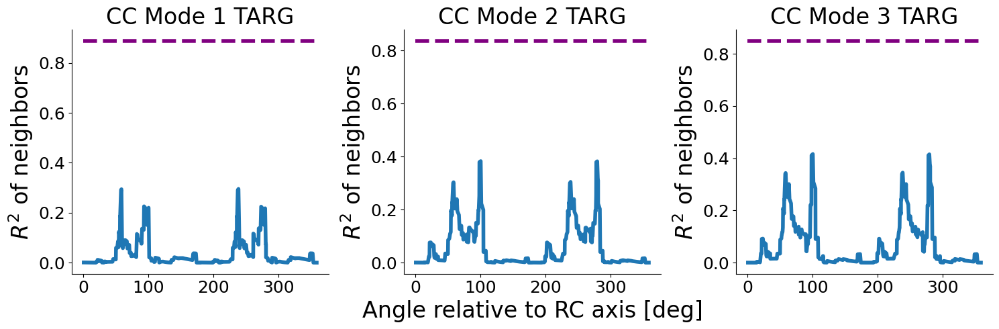

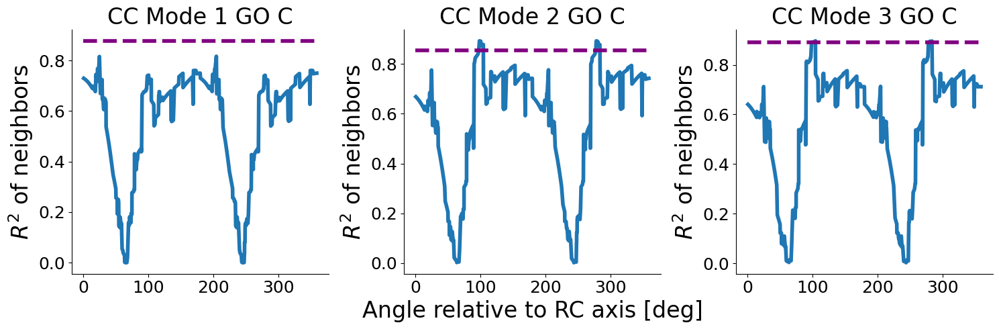

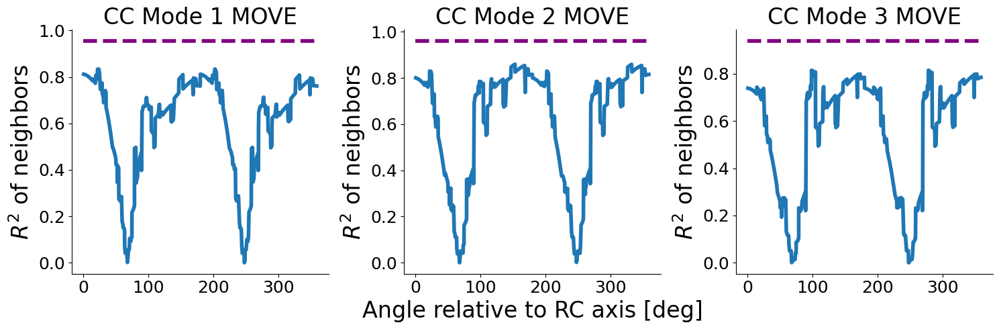

In [185]:
for align_event in align_events:
    fig, ax = plt.subplots(1,nmodes_plot,figsize=(5*nmodes_plot,5))
    for ipc in range(nmodes_plot):
        ax[ipc].plot(np.rad2deg(random_angles[align_event][np.argsort(random_angles[align_event][:,ipc]),ipc]), random_r2[align_event][np.argsort(random_angles[align_event][:,ipc]),ipc])
        ax[ipc].plot([0,360], [np_v_cca_fitscore[align_event][ipc], np_v_cca_fitscore[align_event][ipc]], '--', color='purple')
        ax[ipc].set(ylabel='$R^2$ of neighbors', title=f"CC Mode {ipc+1} {align_event[:4]}")
        if ipc == 1:
            ax[ipc].set_xlabel('Angle relative to RC axis [deg]')

    fig.tight_layout()
    plt.show()


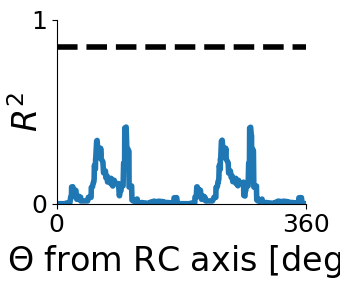

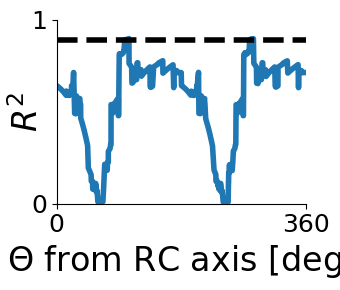

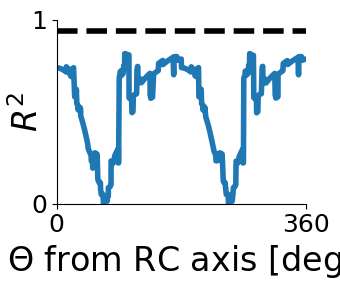

In [186]:
for align_event in align_events:
    fig, ax = plt.subplots(1,1,figsize=(3.5,3))
    
    ax.plot(np.rad2deg(random_angles[align_event][np.argsort(random_angles[align_event][:,ipc]),ipc]), random_r2[align_event][np.argsort(random_angles[align_event][:,ipc]),ipc], color='C0')
    ax.plot([0,360], [np_v_cca_fitscore[align_event][ipc], np_v_cca_fitscore[align_event][ipc]], '--', color='black')
    ax.set(xlim=(0,360), ylim=(0,1))
    ax.set_xticks([0, 360])
    ax.set_yticks([0, 1])
    ax.set_ylabel('$R^2$', labelpad=-10)
    
    ax.set_xlabel('$\Theta$ from RC axis [deg]')

    fig.tight_layout()
    aopy.visualization.savefig(base_save_dir, f'{subject}_neighboring_cca_random_rcpos_{align_event}.svg')


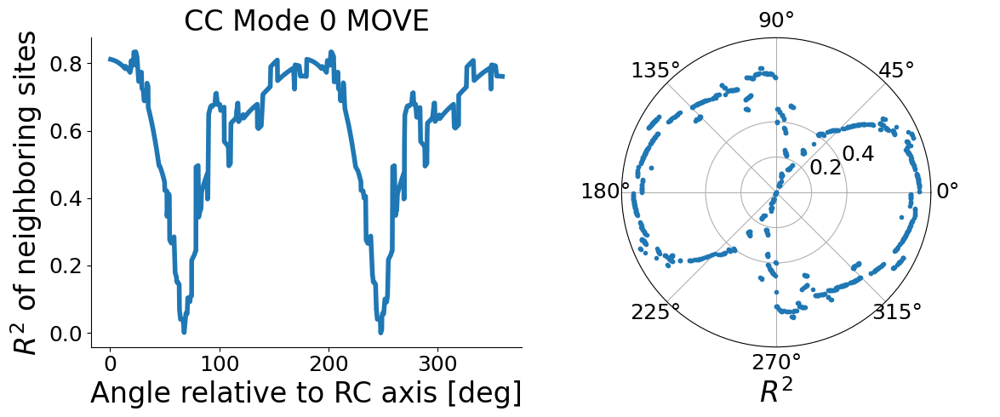

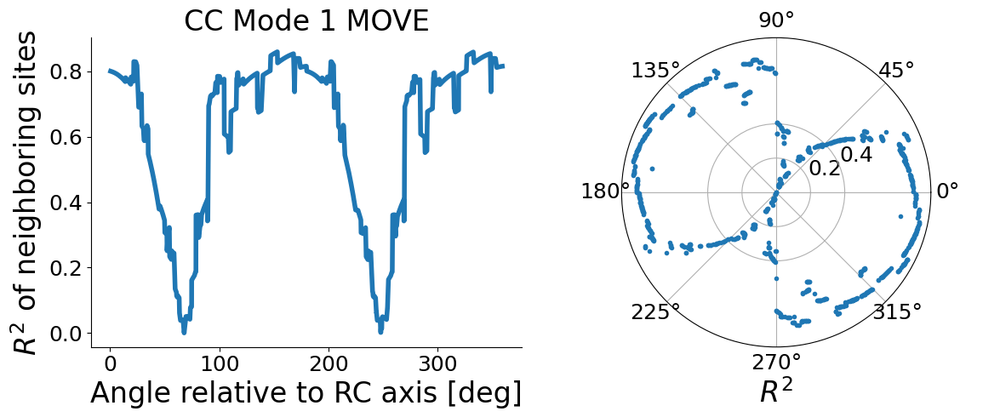

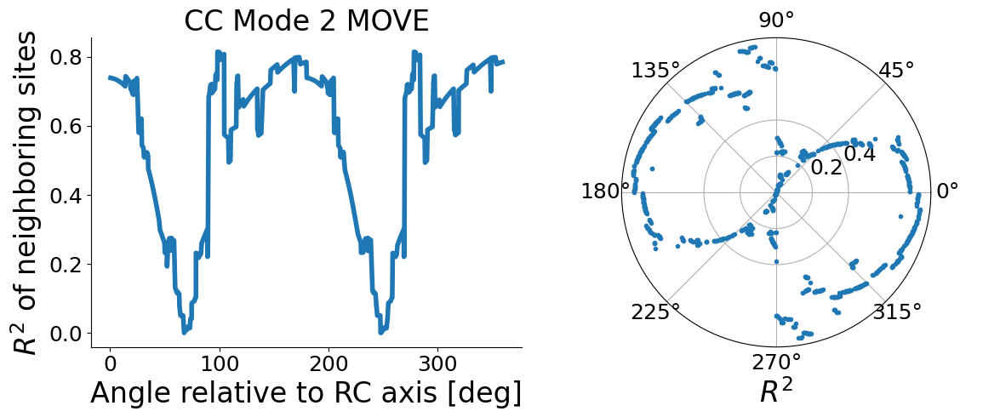

In [187]:
align_event = align_events[-1]
for ipc in range(nmodes_plot):
    fig, ax = plt.subplots(1,2,figsize=(12,5))
    ax[0].plot(np.rad2deg(random_angles[align_event][np.argsort(random_angles[align_event][:,ipc]),ipc]), random_r2[align_event][np.argsort(random_angles[align_event][:,ipc]),ipc])
    # ax[0].plot([0,360], [np_v_cca_fitscore[ipc], np_v_cca_fitscore[ipc]], '--', color='purple')
    ax[0].set(xlabel='Angle relative to RC axis [deg]', ylabel='$R^2$ of neighboring sites', title=f"CC Mode {ipc} {align_event[:4]}")
    
    ax[1].set_yticks([])  # Remove radial labels
    ax[1].set_xticks([])  # Remove angular labels
    # ax[0].set(ylim=(0,0.65))
    ax[1].spines['left'].set_visible(False)
    ax[1].spines['bottom'].set_visible(False)
    
    ax[1] = fig.add_subplot(122, projection='polar')    
    ax[1].plot(random_angles[align_event][:,ipc], random_r2[align_event][:,ipc], '.')
    ax[1].set_rticks([0.2, 0.4])
    ax[1].set_xlabel("$R^2$")
    fig.tight_layout()
    plt.show()
    

In [188]:
cca_similarity_df = {}
for align_event in align_events:
    df_dict = {}
    df_dict['site_idx'] = []
    df_dict['accuracy'] = []
    df_dict['cca_similarity_accuracy_mode1'] = []
    df_dict['cca_similarity_accuracy_mode2'] = []
    df_dict['cca_similarity_accuracy_mode3'] = []
    df_dict['rc_pos'] = []
    df_dict['cca_similarity_rc_pos_mode1'] = []
    df_dict['cca_similarity_rc_pos_mode2'] = []
    df_dict['cca_similarity_rc_pos_mode3'] = []
    good_nan_idx = np.where(np.logical_and(np.sum(np.isnan(ccs_control_units[align_event][:,:,ipc]), axis=0) < nrecs, ~np.isnan(np.array(max_np_decoding[align_event]))))[0]
    
    rc_ordered_site_idx = good_nan_idx[np.argsort(ecog_dec_acc[subject]['rc_axis'][good_nan_idx,0])]
    rc_neighboring_ccs_mode1 = get_neighboring_ccs(ccs_control_units[align_event][rc_ordered_site_idx,:,0][:,rc_ordered_site_idx],nneighbors=nneighbors)
    rc_neighboring_ccs_mode2 = get_neighboring_ccs(ccs_control_units[align_event][rc_ordered_site_idx,:,1][:,rc_ordered_site_idx],nneighbors=nneighbors)
    rc_neighboring_ccs_mode3 = get_neighboring_ccs(ccs_control_units[align_event][rc_ordered_site_idx,:,2][:,rc_ordered_site_idx],nneighbors=nneighbors)

    np_acc_ordered_site_idx = good_nan_idx[np.argsort(np.array(max_np_decoding[align_event])[good_nan_idx])]
    np_acc_neighboring_ccs_mode1 = get_neighboring_ccs(ccs_control_units[align_event][np_acc_ordered_site_idx,:,0][:,np_acc_ordered_site_idx], nneighbors =nneighbors)
    np_acc_neighboring_ccs_mode2 = get_neighboring_ccs(ccs_control_units[align_event][np_acc_ordered_site_idx,:,1][:,np_acc_ordered_site_idx], nneighbors =nneighbors)
    np_acc_neighboring_ccs_mode3 = get_neighboring_ccs(ccs_control_units[align_event][np_acc_ordered_site_idx,:,2][:,np_acc_ordered_site_idx], nneighbors =nneighbors)

    for site in rc_ordered_site_idx:
        df_dict['site_idx'].append(site)
        df_dict['accuracy'].append(np.array(max_np_decoding[align_event])[site])
        df_dict['rc_pos'].append(ecog_dec_acc[subject]['rc_axis'][site,0])
        df_dict['cca_similarity_accuracy_mode1'].append(np_acc_neighboring_ccs_mode1[np.isin(np_acc_ordered_site_idx, site)][0])
        df_dict['cca_similarity_accuracy_mode2'].append(np_acc_neighboring_ccs_mode2[np.isin(np_acc_ordered_site_idx, site)][0])
        df_dict['cca_similarity_accuracy_mode3'].append(np_acc_neighboring_ccs_mode3[np.isin(np_acc_ordered_site_idx, site)][0])
        df_dict['cca_similarity_rc_pos_mode1'].append(rc_neighboring_ccs_mode1[np.isin(rc_ordered_site_idx, site)][0])
        df_dict['cca_similarity_rc_pos_mode2'].append(rc_neighboring_ccs_mode2[np.isin(rc_ordered_site_idx, site)][0])
        df_dict['cca_similarity_rc_pos_mode3'].append(rc_neighboring_ccs_mode3[np.isin(rc_ordered_site_idx, site)][0])

    print(align_event)
    cca_similarity_df[align_event] = pds.DataFrame(df_dict)

TARGET ONSET
GO CUE
MOVEMENT ONSET


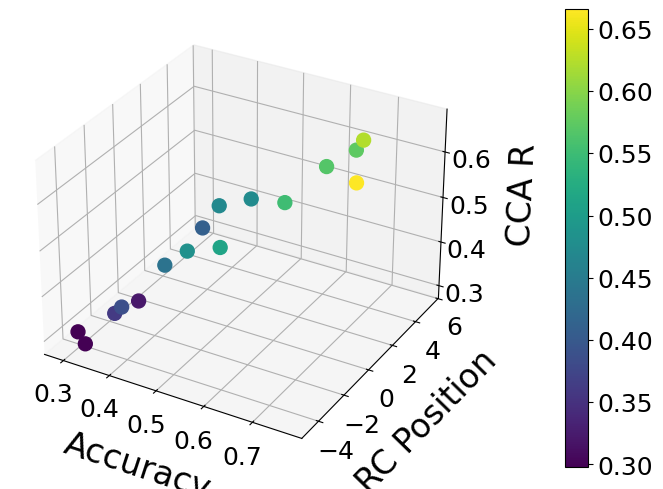

In [189]:
fig = plt.figure(figsize=(10,5))
ax = fig.add_subplot(111, projection='3d')
splot = ax.scatter(df_dict['accuracy'], df_dict['rc_pos'], df_dict['cca_similarity_accuracy_mode1'], c=df_dict['cca_similarity_accuracy_mode1'], alpha=1, s=100)
cb = plt.colorbar(splot, pad=0.1)
# ax.set(xlabel='Accuracy', ylabel='RC Position', zlabel='CCA R')
ax.set_xlabel('Accuracy', labelpad=15)
ax.set_ylabel('RC Position', labelpad=15)
ax.set_zlabel('CCA R', labelpad=15)
fig.tight_layout()
plt.show()

In [190]:
### Predicting R2 computed of neighboring sites organized by decoding accuracy - How much does RC axis add information about similar dynamics to decoding accuracy
r2_scores = {}
for align_event in align_events:
   
    print(f"{align_event}")
    input_data = sklearn.preprocessing.PolynomialFeatures().fit_transform(np.array(cca_similarity_df[align_event][['accuracy','rc_pos']]))
    r2_scores[align_event] = {}
    r2_scores[align_event]['1'] = []
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data, np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode1']))
    r2_scores[align_event]['1'].append(lin_reg_model.score(input_data, np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode1'])))
    print('Full 2nd Order R2 Mode 1: ',np.round(lin_reg_model.score(input_data, np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode1'])),4))
    lin_reg_model_deltadec = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode1']))
    r2_scores[align_event]['1'].append(lin_reg_model_deltadec.score(input_data[:,[0,1]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode1'])))
    print('Decoding R2 Mode 1: ', np.round(lin_reg_model_deltadec.score(input_data[:,[0,1]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode1'])),4))
    lin_reg_model_rcpos = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,2]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode1']))
    r2_scores[align_event]['1'].append(lin_reg_model_rcpos.score(input_data[:,[0,2]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode1'])))
    print('RC Pos R2 Mode 1: ', np.round(lin_reg_model_rcpos.score(input_data[:,[0,2]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode1'])),4))
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1,2]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode1']))
    r2_scores[align_event]['1'].append(lin_reg_model.score(input_data[:,[0,1,2]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode1'])))
    print('Both terms dec R2 Mode 1: ', np.round(lin_reg_model.score(input_data[:,[0,1,2]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode1'])),6))
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1,2,4]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode1']))
    r2_scores[align_event]['1'].append(lin_reg_model.score(input_data[:,[0,1,2,4]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode1'])))
    print('With Interaction R2 Mode 1: ', np.round(lin_reg_model.score(input_data[:,[0,1,2,4]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode1'])),7))

    print('\n')
    r2_scores[align_event]['2'] = []
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data, np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode2']))
    r2_scores[align_event]['2'].append(lin_reg_model.score(input_data, np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode2'])))
    print('Full 2nd Order R2 Mode 2: ',np.round(lin_reg_model.score(input_data, np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode2'])),4))
    lin_reg_model_deltadec = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode2']))
    r2_scores[align_event]['2'].append(lin_reg_model_deltadec.score(input_data[:,[0,1]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode2'])))
    print('Decoding R2 Mode 2: ', np.round(lin_reg_model_deltadec.score(input_data[:,[0,1]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode2'])),4))
    lin_reg_model_rcpos = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,2]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode2']))
    r2_scores[align_event]['2'].append(lin_reg_model_rcpos.score(input_data[:,[0,2]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode2'])))
    print('RC Pos R2 Mode 2: ', np.round(lin_reg_model_rcpos.score(input_data[:,[0,2]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode2'])),4))
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1,2]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode2']))
    r2_scores[align_event]['2'].append(lin_reg_model.score(input_data[:,[0,1,2]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode2'])))
    print('Both terms dec R2 Mode 2: ', np.round(lin_reg_model.score(input_data[:,[0,1,2]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode2'])),6))
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1,2,4]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode2']))
    r2_scores[align_event]['2'].append(lin_reg_model.score(input_data[:,[0,1,2,4]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode2'])))
    print('With Interaction R2 Mode 2: ', np.round(lin_reg_model.score(input_data[:,[0,1,2,4]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode2'])),7))

    print('\n')
    r2_scores[align_event]['3'] = []
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data, np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode3']))
    r2_scores[align_event]['3'].append(lin_reg_model.score(input_data, np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode3'])))
    print('Full 2nd Order R2 Mode 3: ',np.round(lin_reg_model.score(input_data, np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode3'])),4))
    lin_reg_model_deltadec = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode3']))
    r2_scores[align_event]['3'].append(lin_reg_model_deltadec.score(input_data[:,[0,1]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode3'])))
    print('Decoding R2 Mode 3: ', np.round(lin_reg_model_deltadec.score(input_data[:,[0,1]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode3'])),4))
    lin_reg_model_rcpos = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,2]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode3']))
    r2_scores[align_event]['3'].append(lin_reg_model_rcpos.score(input_data[:,[0,2]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode3'])))
    print('RC Pos R2 Mode 3: ', np.round(lin_reg_model_rcpos.score(input_data[:,[0,2]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode3'])),4))
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1,2]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode3']))
    r2_scores[align_event]['3'].append(lin_reg_model.score(input_data[:,[0,1,2]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode3'])))
    print('Both terms dec R2 Mode 3: ', np.round(lin_reg_model.score(input_data[:,[0,1,2]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode3'])),6))
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1,2,4]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode3']))
    r2_scores[align_event]['3'].append(lin_reg_model.score(input_data[:,[0,1,2,4]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode3'])))
    print('With Interaction R2 Mode 3: ', np.round(lin_reg_model.score(input_data[:,[0,1,2,4]], np.array(cca_similarity_df[align_event]['cca_similarity_accuracy_mode3'])),7))
    print('\n')



TARGET ONSET
Full 2nd Order R2 Mode 1:  0.9096
Decoding R2 Mode 1:  0.8883
RC Pos R2 Mode 1:  0.0502
Both terms dec R2 Mode 1:  0.892308
With Interaction R2 Mode 1:  0.9028094


Full 2nd Order R2 Mode 2:  0.87
Decoding R2 Mode 2:  0.8364
RC Pos R2 Mode 2:  0.0444
Both terms dec R2 Mode 2:  0.839421
With Interaction R2 Mode 2:  0.8680974


Full 2nd Order R2 Mode 3:  0.894
Decoding R2 Mode 3:  0.8498
RC Pos R2 Mode 3:  0.0308
Both terms dec R2 Mode 3:  0.850119
With Interaction R2 Mode 3:  0.8905711


GO CUE
Full 2nd Order R2 Mode 1:  0.9039
Decoding R2 Mode 1:  0.8774
RC Pos R2 Mode 1:  0.2063
Both terms dec R2 Mode 1:  0.89504
With Interaction R2 Mode 1:  0.8950481


Full 2nd Order R2 Mode 2:  0.874
Decoding R2 Mode 2:  0.8542
RC Pos R2 Mode 2:  0.1729
Both terms dec R2 Mode 2:  0.86352
With Interaction R2 Mode 2:  0.8635579


Full 2nd Order R2 Mode 3:  0.9073
Decoding R2 Mode 3:  0.8901
RC Pos R2 Mode 3:  0.0995
Both terms dec R2 Mode 3:  0.890439
With Interaction R2 Mode 3:  0.891481

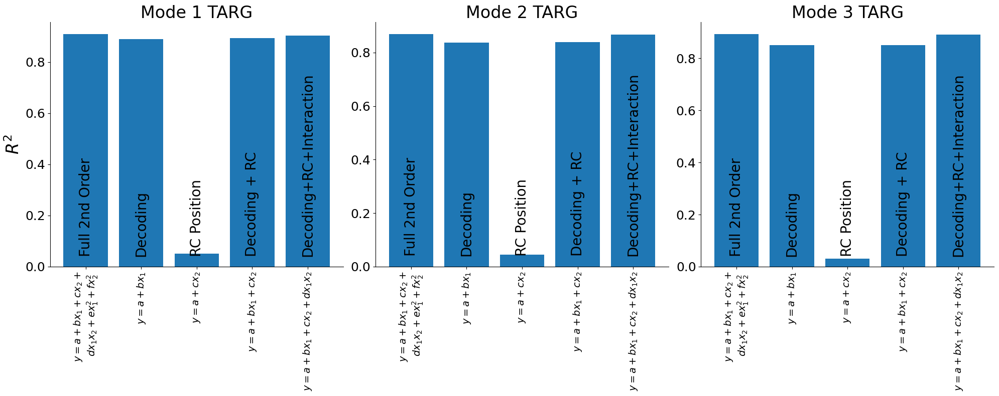

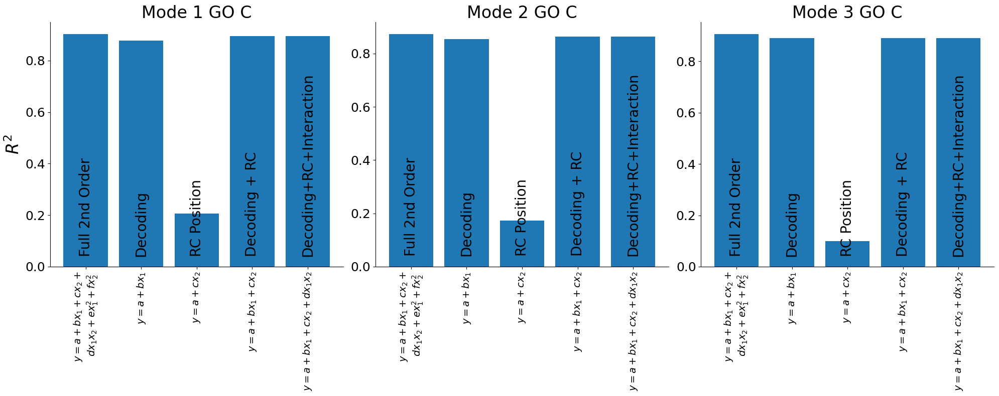

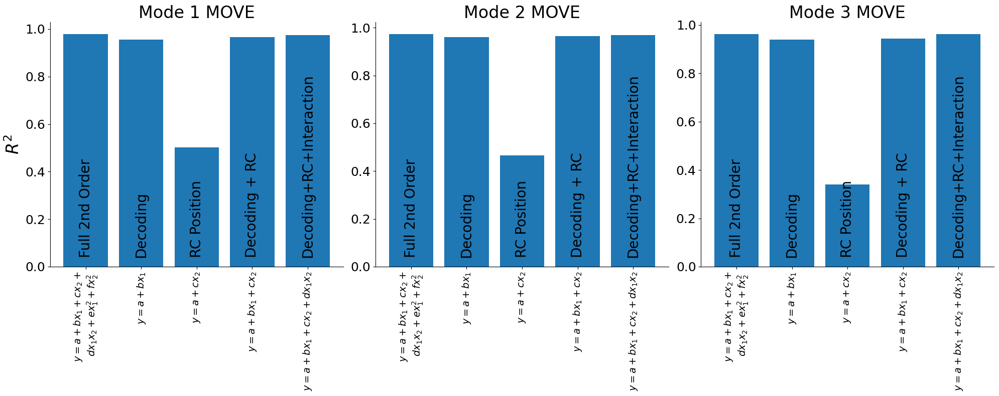

In [191]:
annotate_text = ['Full 2nd Order', 'Decoding', 'RC Position', 'Decoding + RC', 'Decoding+RC+Interaction']
for align_event in align_events:
    fig, ax = plt.subplots(1,nmodes_plot, figsize=(20,8))
    for mode in range(nmodes_plot):
        ax[mode].bar(np.arange(5), r2_scores[align_event][str(mode+1)])
        ax[mode].set_xticks(np.arange(5), ['$y=a+bx_1+cx_2+$\n $dx_1x_2+ex_1^2 + f x_2^2$', '$y=a+bx_1$', '$y=a+cx_2$', '$y=a+bx_1+cx_2$', '$y=a+bx_1+cx_2+dx_1x_2$'], rotation=90, fontsize=14)
        ax[mode].set_title(f'Mode {mode+1} {align_event[:4]}')
        for ii in range(5):
            ax[mode].annotate(str(annotate_text[ii]), (ii, 0.05), rotation = 90, ha='center', fontsize=20)
        if mode == 0:
            ax[mode].set(ylabel='$R^2$')

    fig.tight_layout()
    plt.show()

In [192]:
### Predicting R2 computed of neighboring sites organized by RC Axis - How much does decoding accuracy add information about similar dynamics to RC axis
for align_event in align_events:
    print(f"{align_event}")
    input_data = sklearn.preprocessing.PolynomialFeatures().fit_transform(np.array(cca_similarity_df[align_event][['accuracy','rc_pos']]))
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data, np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode1']))
    print('Full 2nd Order R2 Mode 1: ',np.round(lin_reg_model.score(input_data, np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode1'])),4))
    lin_reg_model_deltadec = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode1']))
    print('Decoding R2 Mode 1: ', np.round(lin_reg_model_deltadec.score(input_data[:,[0,1]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode1'])),4))
    lin_reg_model_rcpos = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,2]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode1']))
    print('RC Pos R2 Mode 1: ', np.round(lin_reg_model_rcpos.score(input_data[:,[0,2]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode1'])),4))
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1,2]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode1']))
    print('Both terms dec R2 Mode 1: ', np.round(lin_reg_model.score(input_data[:,[0,1,2]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode1'])),6))
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1,2,4]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode1']))
    print('With Interaction R2 Mode 1: ', np.round(lin_reg_model.score(input_data[:,[0,1,2,4]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode1'])),7))

    print('\n')
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data, np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode2']))
    print('Full 2nd Order R2 Mode 2: ',np.round(lin_reg_model.score(input_data, np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode2'])),4))
    lin_reg_model_deltadec = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode2']))
    print('Decoding R2 Mode 2: ', np.round(lin_reg_model_deltadec.score(input_data[:,[0,1]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode2'])),4))
    lin_reg_model_rcpos = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,2]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode2']))
    print('RC Pos R2 Mode 2: ', np.round(lin_reg_model_rcpos.score(input_data[:,[0,2]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode2'])),4))
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1,2]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode2']))
    print('Both terms dec R2 Mode 2: ', np.round(lin_reg_model.score(input_data[:,[0,1,2]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode2'])),6))
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1,2,4]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode2']))
    print('With Interaction R2 Mode 2: ', np.round(lin_reg_model.score(input_data[:,[0,1,2,4]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode2'])),7))

    print('\n')
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data, np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode3']))
    print('Full 2nd Order R2 Mode 3: ',np.round(lin_reg_model.score(input_data, np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode3'])),4))
    lin_reg_model_deltadec = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode3']))
    print('Decoding R2 Mode 3: ', np.round(lin_reg_model_deltadec.score(input_data[:,[0,1]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode3'])),4))
    lin_reg_model_rcpos = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,2]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode3']))
    print('RC Pos R2 Mode 3: ', np.round(lin_reg_model_rcpos.score(input_data[:,[0,2]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode3'])),4))
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1,2]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode3']))
    print('Both terms dec R2 Mode 3: ', np.round(lin_reg_model.score(input_data[:,[0,1,2]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode3'])),6))
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1,2,4]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode3']))
    print('With Interaction R2 Mode 3: ', np.round(lin_reg_model.score(input_data[:,[0,1,2,4]], np.array(cca_similarity_df[align_event]['cca_similarity_rc_pos_mode3'])),7))
    print('\n')

TARGET ONSET
Full 2nd Order R2 Mode 1:  0.8145
Decoding R2 Mode 1:  0.2986
RC Pos R2 Mode 1:  0.0002
Both terms dec R2 Mode 1:  0.30535
With Interaction R2 Mode 1:  0.3441266


Full 2nd Order R2 Mode 2:  0.6724
Decoding R2 Mode 2:  0.3593
RC Pos R2 Mode 2:  0.0001
Both terms dec R2 Mode 2:  0.372567
With Interaction R2 Mode 2:  0.4043346


Full 2nd Order R2 Mode 3:  0.621
Decoding R2 Mode 3:  0.3585
RC Pos R2 Mode 3:  0.0001
Both terms dec R2 Mode 3:  0.371834
With Interaction R2 Mode 3:  0.3919599


GO CUE
Full 2nd Order R2 Mode 1:  0.87
Decoding R2 Mode 1:  0.4118
RC Pos R2 Mode 1:  0.6753
Both terms dec R2 Mode 1:  0.816974
With Interaction R2 Mode 1:  0.8316205


Full 2nd Order R2 Mode 2:  0.8398
Decoding R2 Mode 2:  0.4179
RC Pos R2 Mode 2:  0.6558
Both terms dec R2 Mode 2:  0.804755
With Interaction R2 Mode 2:  0.8104256


Full 2nd Order R2 Mode 3:  0.7612
Decoding R2 Mode 3:  0.3856
RC Pos R2 Mode 3:  0.5945
Both terms dec R2 Mode 3:  0.733823
With Interaction R2 Mode 3:  0.7356

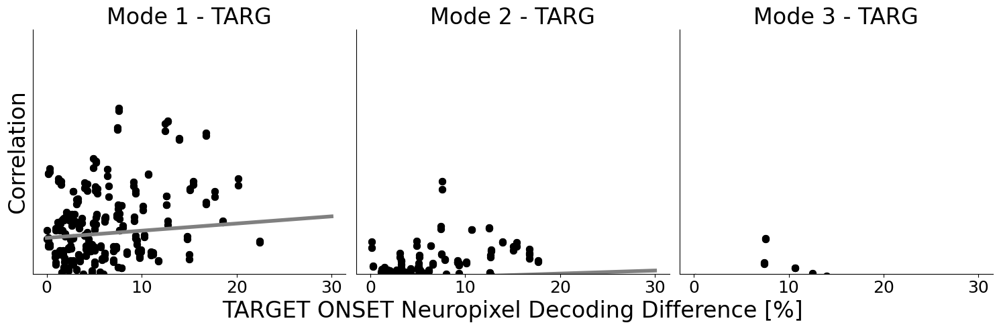

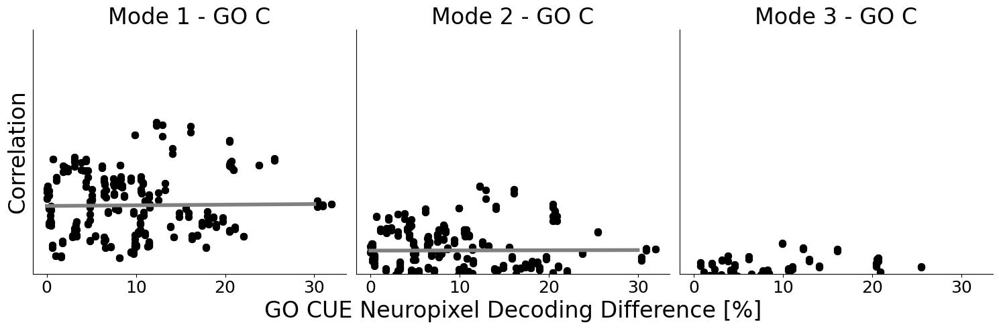

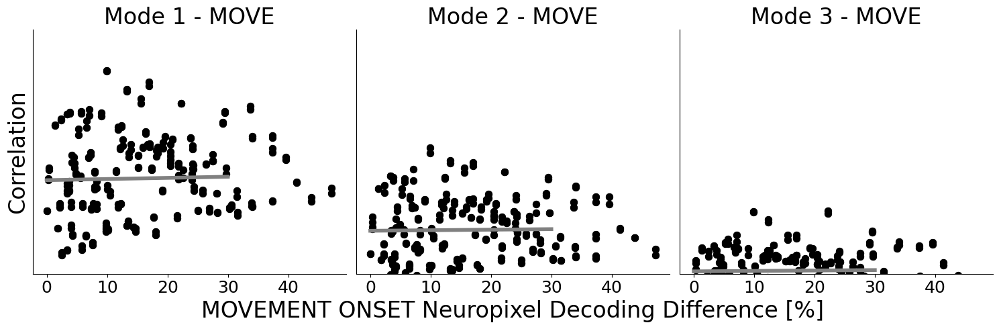

In [193]:
nmodes_plot = 3
for align_event in align_events:

    fig, ax = plt.subplots(1,nmodes_plot,figsize=(nmodes_plot*5,5))
    np_acc_arg_sort = np.argsort(max_np_decoding[align_event])
    dec_diff = np.zeros((ccs_control_units[align_event].shape[0], ccs_control_units[align_event].shape[1]))*np.nan
    for irec1 in range(ccs_control_units[align_event].shape[0]):
        for irec2 in range(ccs_control_units[align_event].shape[1]):
            # if irec1 != 0 and irec2 != 0:
            if irec1 != irec2:
                dec_diff[irec1,irec2] = np.abs(max_np_decoding[align_event][irec1] - max_np_decoding[align_event][irec2]) 

    for ipc in range(nmodes_plot):
        dec_diff_map = ax[ipc].scatter(100*dec_diff.flatten(), ccs_control_units[align_event][:,:,ipc].flatten(),s=50, c='black')
        for ipt in range(len(dec_diff.flatten())):
            dec_diff_map = ax[ipc].scatter(100*dec_diff.flatten()[ipt], ccs_control_units[align_event][:,:,ipc].flatten()[ipt],s=50, c='black')

        nan_mask = np.logical_and(~np.isnan(dec_diff.flatten()), ~np.isnan(ccs_control_units[align_event][:,:,ipc].flatten()))
        fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(100*dec_diff.flatten()[nan_mask], ccs_control_units[align_event][:,:,ipc].flatten()[nan_mask])
        intercept = regfit.intercept_
        # intercepts.append(intercept)
        slope = regfit.coef_[0]
        # slopes.append(slope)
        ax[ipc].annotate(f'p={np.round(pval,2)}',(20,.05), fontsize=24, color=(0.5,0.5,0.5))
        ax[ipc].annotate(f'$R^2$={np.round(fitscore,2)}',(20,.15), fontsize=24, color=(0.5,0.5,0.5))

        ax[ipc].plot([0,30], [intercept, slope*10 + intercept], color=(0.5, 0.5, 0.5))
        ax[ipc].set_yticks([])
        ax[ipc].set(title=f"Mode {ipc+1} - {align_event[:4]}", ylim=(0.25,.75))
        if ipc == 0:
            # ax[ipc].set_yticks([0,.5,1])
            ax[ipc].set(ylabel='Correlation')
        if ipc == 1:
            ax[ipc].set(xlabel=f'{align_event} Neuropixel Decoding Difference [%]')
        # elif ipc == npcs-1:
        #     cb = plt.colorbar(dec_diff_map, label='X-Position \n Difference [mm]')
    fig.tight_layout()
    # aopy.visualization.savefig(base_save_dir, f'cca_cc_delta_dec.svg')

In [194]:
# Create a dataframe where each row is a pair of sites
cca_df = {}
for align_event in align_events:
    # good_nan_idx = np.where(np.sum(np.isnan(ccs_control_units[align_event][:,:,ipc]), axis=0) < nrecs)[0]
    good_nan_idx = np.where(np.logical_and(np.sum(np.isnan(ccs_control_units[align_event][:,:,ipc]), axis=0) < nrecs, ~np.isnan(np.array(max_np_decoding[align_event]))))[0]
    df_dict = {}
    df_dict['site1'] = []
    df_dict['site2'] = []
    df_dict['cca_r2_mode1'] = []
    df_dict['cca_r2_mode2'] = []
    df_dict['cca_r2_mode3'] = []
    df_dict['delta_dec'] = []
    df_dict['delta_rcpos'] = []
    for isite1 in good_nan_idx:
        for isite2 in good_nan_idx:
            if isite1 != isite2:
                df_dict['site1'].append(isite1)
                df_dict['site2'].append(isite2)
                df_dict['cca_r2_mode1'].append(ccs_control_units[align_event][isite1,isite2,0])
                df_dict['cca_r2_mode2'].append(ccs_control_units[align_event][isite1,isite2,1])
                df_dict['cca_r2_mode3'].append(ccs_control_units[align_event][isite1,isite2,2])
                df_dict['delta_dec'].append(np.abs(np.array(max_np_decoding[align_event])[isite2] - np.array(max_np_decoding[align_event])[isite1]))
                df_dict['delta_rcpos'].append(np.abs(ecog_dec_acc[subject]['rc_axis'][isite2,0] - ecog_dec_acc[subject]['rc_axis'][isite1,0]))

    cca_df[align_event] = pds.DataFrame(df_dict)

In [195]:
for align_event in align_events:
    print(f"{align_event}")
    input_data = sklearn.preprocessing.PolynomialFeatures().fit_transform(np.array(cca_df[align_event][['delta_dec','delta_rcpos']]))
    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data, np.array(cca_df[align_event]['cca_r2_mode1']))
    print('Full 2nd Order R2: ',np.round(lin_reg_model.score(input_data, np.array(cca_df[align_event]['cca_r2_mode1'])),4))

    lin_reg_model_deltadec = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1]], np.array(cca_df[align_event]['cca_r2_mode1']))
    print('delta dec R2: ', np.round(lin_reg_model_deltadec.score(input_data[:,[0,1]], np.array(cca_df[align_event]['cca_r2_mode1'])),4))

    lin_reg_model_rcpos = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,2]], np.array(cca_df[align_event]['cca_r2_mode1']))
    print('delta rcpos R2: ', np.round(lin_reg_model_rcpos.score(input_data[:,[0,2]], np.array(cca_df[align_event]['cca_r2_mode1'])),4))

    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1,2]], np.array(cca_df[align_event]['cca_r2_mode1']))
    print('Both terms dec R2: ', np.round(lin_reg_model.score(input_data[:,[0,1,2]], np.array(cca_df[align_event]['cca_r2_mode1'])),6))

    lin_reg_model = sklearn.linear_model.LinearRegression().fit(input_data[:,[0,1,2,4]], np.array(cca_df[align_event]['cca_r2_mode1']))
    print('With Interaction R2: ', np.round(lin_reg_model.score(input_data[:,[0,1,2,4]], np.array(cca_df[align_event]['cca_r2_mode1'])),7))
    print('\n')


TARGET ONSET
Full 2nd Order R2:  0.1979
delta dec R2:  0.0796
delta rcpos R2:  0.0799
Both terms dec R2:  0.149657
With Interaction R2:  0.1713349


GO CUE
Full 2nd Order R2:  0.0401
delta dec R2:  0.0018
delta rcpos R2:  0.0061
Both terms dec R2:  0.007646
With Interaction R2:  0.0111807


MOVEMENT ONSET
Full 2nd Order R2:  0.0937
delta dec R2:  0.0089
delta rcpos R2:  0.0054
Both terms dec R2:  0.020624
With Interaction R2:  0.0711467




### Pseudopopulations

In [40]:
rand_keys = list(rasters['neural']['RANDOM'].keys())
random_prep_data_all = {}
for rand_key in rand_keys:
    random_prep_data_all[rand_key] = []
    for irec in tqdm(range(nrecs)):
        # Prepare neural activity    
        neural_data = fr_zscore['RANDOM'][rand_key]['align_spikes_zscore'][irec]
        if neural_data.shape[2] > 0:
            # Compute low firing units for each day
            fr_neural_data = rasters['neural']['RANDOM'][rand_key][irec][:,:,stable_unit_idx[irec]]
            nt, ntr, nunit = fr_neural_data.shape
            unit_fr = ((np.sum(fr_neural_data, axis=(0,1))/(nt*ntr))).flatten()
            high_fr_unit_mask = unit_fr >= 1
            if np.sum(unit_fr < 1) > 0:
                print(f"Number of low FR units: {np.sum(unit_fr < 1)}")

            if cca_bin_fs < preproc_metadata['neural_samplerate']:
                neural_data_resample = np.sqrt(aopy.precondition.downsample(neural_data[:,:,high_fr_unit_mask], preproc_metadata['neural_samplerate'], cca_bin_fs))
                new_time_axis = (np.arange(neural_data_resample.shape[0])/cca_bin_fs) - preproc_metadata['tbefore']
                smoothed_neural_data = smooth_timeseries_gaus(neural_data_resample, cca_bin_fs, kernel_width, conv_mode='valid')
            else:
                smoothed_neural_data = smooth_timeseries_gaus(neural_data[:,:,high_fr_unit_mask], cca_bin_fs, kernel_width, conv_mode='valid')
                new_time_axis = (np.arange(neural_data.shape[0])/cca_bin_fs) - preproc_metadata['tbefore']

            kernel_size = int(cca_bin_fs*kernel_width/1000)
            neural_idx_start = np.where(new_time_axis >= -tbefore_cca)[0][0] - kernel_size
            neural_idx_stop = np.where(new_time_axis <= tafter_cca)[0][-1]- kernel_size

            random_prep_data = []

            trials = np.arange(neural_data.shape[1])
            for trial_idx in trials:
                random_prep_data.extend(smoothed_neural_data[neural_idx_start:neural_idx_stop,trial_idx,:])
            random_prep_data_all[rand_key].append(np.array(random_prep_data))
        else:
            random_prep_data_all[rand_key].append([])

intertrial_array = {}        
for rand_key in rand_keys:
    intertrial_array[rand_key] = np.concatenate([random_prep_data_all[rand_key][irec] for irec in range(len(random_prep_data_all[rand_key])) if len(random_prep_data_all[rand_key][irec])>0], axis=1)

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

#### All units

In [41]:
# Across events for all units
### Now align activity from each even for each group to another (across events)
npcs = 10
across_events_alignment = np.zeros((len(align_events), len(align_events), npcs, niterations))*np.nan
for ievent_train, align_event_train in enumerate(tqdm(align_events)):
    for ievent_test, align_event_test in enumerate(align_events):
        for iiter in range(niterations):
            random_unit_idx = np.random.choice(np.arange(all_prep_data[align_events[-1]].shape[1]), 50)
            train_temp_proj_data = PCA(svd_solver='full').fit_transform(all_prep_data[align_event_train][:,random_unit_idx]/np.std(all_prep_data[align_event_train][:,random_unit_idx],axis=0))
            test_temp_proj_data = PCA(svd_solver='full').fit_transform(all_prep_data[align_event_test][:,random_unit_idx]/np.std(all_prep_data[align_event_test][:,random_unit_idx],axis=0))

            La = train_temp_proj_data[:,:npcs]
            Lb = test_temp_proj_data[:,:npcs]

            across_events_alignment[ievent_train, ievent_test,:,iiter] = canoncorr_gallego(La, Lb)

  0%|          | 0/3 [00:00<?, ?it/s]

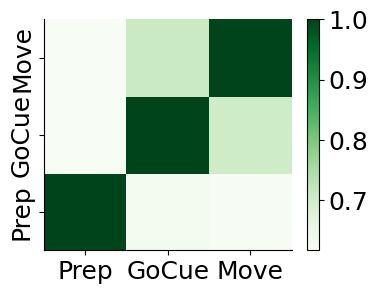

In [42]:
fig, ax = plt.subplots(1,1,figsize=(4,3))
im = ax.pcolor(np.mean(across_events_alignment, axis=3)[:,:,0], cmap='Greens')
cb = plt.colorbar(im)
ax.set_xticks(np.arange(3)+.5, ['Prep', 'GoCue', 'Move'], fontsize=18)
ax.set_yticks(np.arange(3)+.5, ['Prep', 'GoCue', 'Move'], rotation=90, va='center', fontsize=18)
plt.show()

#### Top 30 vs. bottom 30

In [43]:
# Compute CCs the same way as Gallego paper
nunits_per_group = 50
nunits_per_group_split = nunits_per_group*2
proj_data_all = {}
proj_data_low_decoding = {}
proj_data_high_decoding = {}
proj_data_low_intertrial = {}
proj_data_high_intertrial = {}
high_group_min = {}
single_ch_decoding = {}
for align_event in tqdm(align_events):
    single_ch_low_decoding_prep_data = []
    single_ch_high_decoding_prep_data = []

    single_ch_decoding[align_event] = []
    [single_ch_decoding[align_event].extend(single_ch_np_decoding[align_event][irec]) for irec in range(len(single_ch_np_decoding[align_event]))]
    # low_group_max = np.max(np.array(single_ch_decoding[align_event])[np.argsort(np.array(single_ch_decoding[align_event]))][:nunits_per_group])
    # high_group_min[align_event] = np.min(np.array(single_ch_decoding[align_event])[np.argsort(np.array(single_ch_decoding[align_event]))][-nunits_per_group:])
    low_group_max = np.max(np.array(single_ch_decoding[align_event])[np.argsort(np.array(single_ch_decoding[align_event]))][:nunits_per_group_split])
    high_group_min[align_event] = np.min(np.array(single_ch_decoding[align_event])[np.argsort(np.array(single_ch_decoding[align_event]))][-nunits_per_group_split:])
    
    random_unit_idx_low = np.random.choice(np.where(np.array(single_ch_decoding[align_event]) <= low_group_max)[0], nunits_per_group, replace=False)
    random_unit_idx_high = np.random.choice(np.where(np.array(single_ch_decoding[align_event]) >= high_group_min[align_event])[0], nunits_per_group, replace=False)

    proj_data_low_decoding[align_event] = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,random_unit_idx_low]/np.std(all_prep_data[align_event][:,random_unit_idx_low],axis=0))
    proj_data_high_decoding[align_event] = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,random_unit_idx_high]/np.std(all_prep_data[align_event][:,random_unit_idx_high], axis=0))

    proj_data_low_intertrial[align_event] = PCA(svd_solver='full').fit_transform(intertrial_array[rand_keys[0]][:,random_unit_idx_low]/np.std(intertrial_array[rand_keys[0]][:,random_unit_idx_low], axis=0))
    proj_data_high_intertrial[align_event] = PCA(svd_solver='full').fit_transform(intertrial_array[rand_keys[0]][:,random_unit_idx_high]/np.std(intertrial_array[rand_keys[0]][:,random_unit_idx_high], axis=0))
    
    proj_data_all[align_event] = PCA(svd_solver='full').fit_transform(all_prep_data[align_event])

  0%|          | 0/3 [00:00<?, ?it/s]

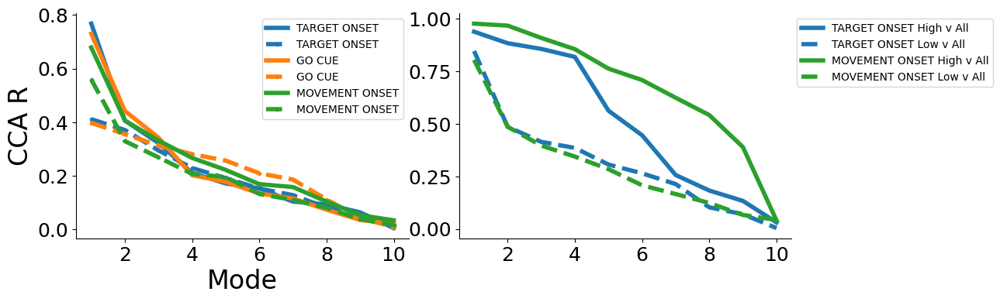

In [44]:
# print(single_ch_low_decoding_prep_data.shape, single_ch_high_decoding_prep_data.shape)
fig, ax = plt.subplots(1,2,figsize=(13,4))
for ievent, align_event in enumerate(align_events):
    ccs_pp = canoncorr_gallego(proj_data_high_decoding[align_event][:,:npcs], proj_data_low_decoding[align_event][:,:npcs])
    ccs_pp_intertrial = canoncorr_gallego(proj_data_low_intertrial[align_event][:,:npcs], proj_data_high_intertrial[align_event][:,:npcs])
    ax[0].plot(np.arange(npcs)+1, ccs_pp[:npcs], color=f"C{ievent}", label=f"{align_event}")
    ax[0].plot(np.arange(npcs)+1, ccs_pp_intertrial[:npcs], '--.', color=f"C{ievent}", label=f"{align_event}")
    
    # High group vs. all
    ccs_pp_highVall = canoncorr_gallego(proj_data_high_decoding[align_event][:,:npcs], proj_data_all[align_event][:,:npcs],)
    ccs_pp_lowVall = canoncorr_gallego(proj_data_low_decoding[align_event][:,:npcs], proj_data_all[align_event][:,:npcs])
    if ievent != 1:
        ax[1].plot(np.arange(npcs)+1, ccs_pp_highVall, color=f"C{ievent}", label=f"{align_event} High v All")
        ax[1].plot(np.arange(npcs)+1, ccs_pp_lowVall,'--', color=f"C{ievent}", label=f"{align_event} Low v All")
        
ax[0].set(xlabel='Mode', ylabel='CCA R')

ax[0].legend(bbox_to_anchor=(1,1))
ax[1].legend(bbox_to_anchor=(1,1))
fig.tight_layout()
plt.show()

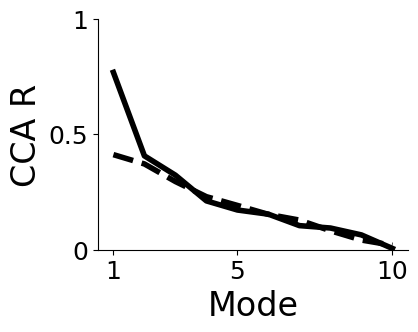

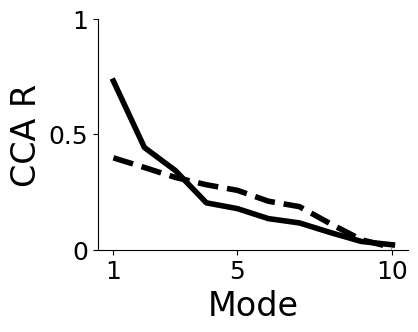

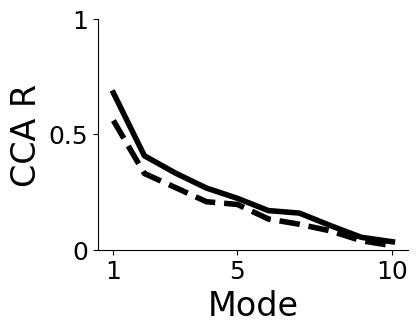

In [45]:
for ievent, align_event in enumerate(align_events):
    fig, ax = plt.subplots(1,1,figsize=(4,3))
    ccs_pp = canoncorr_gallego(proj_data_high_decoding[align_event][:,:10], proj_data_low_decoding[align_event][:,:10])
    ccs_pp_intertrial = canoncorr_gallego(proj_data_low_intertrial[align_event][:,:npcs], proj_data_high_intertrial[align_event][:,:npcs])
    ax.plot(np.arange(1,10+1), ccs_pp,'k')
    ax.plot(np.arange(1,10+1), ccs_pp_intertrial,'k--')
    ax.set(xlabel='Mode', ylabel='CCA R', ylim=(0,1), xlim=(0.5,10.5))
    ax.set_xticks([1,5,10], [1,5,10])
    ax.set_yticks([0, 0.5, 1], [0, 0.5, 1])
    aopy.visualization.savefig(base_save_dir, f'{subject}_high_low_cca_{align_event}.svg')

In [46]:
## Look at spatial distribution of units
unit_pos = []
for irec in tqdm(range(nrecs)):
    if len(stable_unit_idx[irec]) > 0:
        unit_pos.extend([ecog_dec_acc[subject]['rc_axis'][irec,:] for iunit in range(nstable_unit[irec])])
        
unit_pos = np.array(unit_pos)

  0%|          | 0/16 [00:00<?, ?it/s]

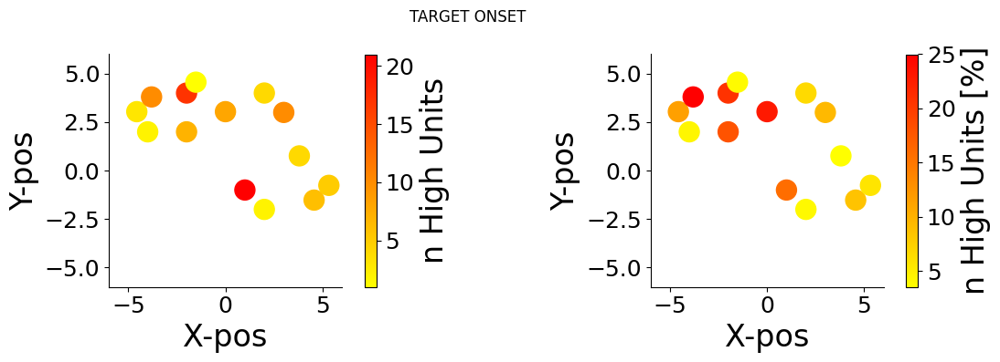

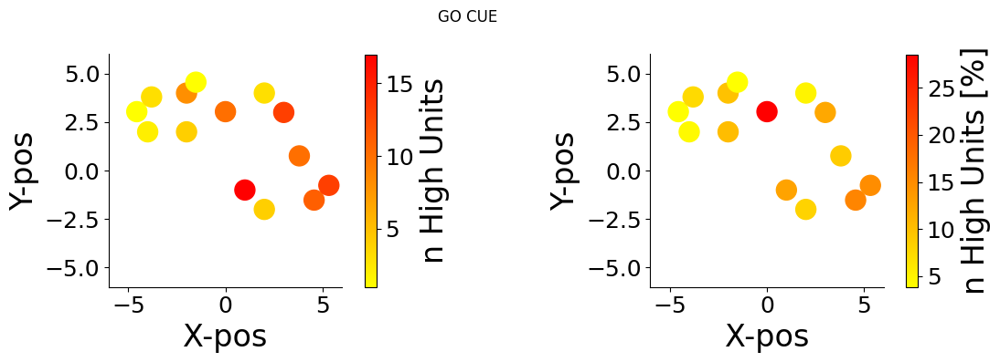

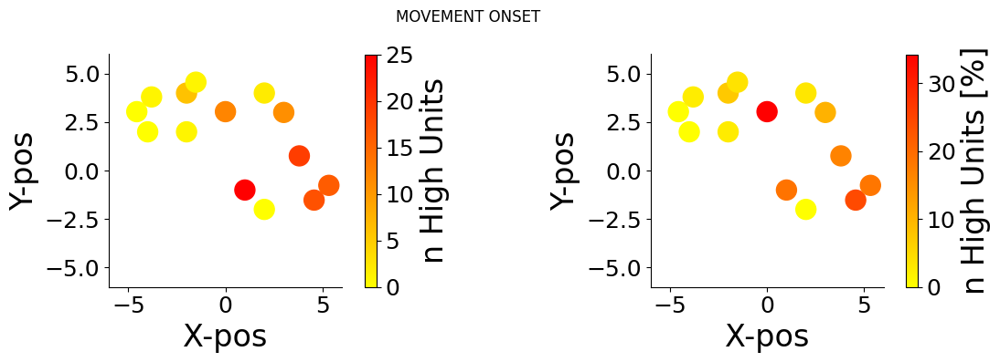

In [47]:
unique_pos = np.unique(unit_pos, axis=0)
nunits_per_pos = np.zeros(unique_pos.shape[0])*np.nan
total_units_per_pos = np.zeros(unique_pos.shape[0])*np.nan

for align_event in align_events:
    high_mod_unit_pos = unit_pos[np.array(single_ch_decoding[align_event]) >= high_group_min[align_event],:]
    for ipos in range(unique_pos.shape[0]):
        nunits_per_pos[ipos] = np.sum(np.logical_and(high_mod_unit_pos[:,0] == unique_pos[ipos,0], high_mod_unit_pos[:,1] == unique_pos[ipos,1]))
        total_units_per_pos[ipos] = np.sum(np.logical_and(unit_pos[:,0] == unique_pos[ipos,0], unit_pos[:,1] == unique_pos[ipos,1]))
        
    fig, ax = plt.subplots(1,2,figsize=(12,4))
    high_unit_prop = (nunits_per_pos/total_units_per_pos)*100
    dec_map = ax[0].scatter(unique_pos[:,0], unique_pos[:,1], s=250, c=nunits_per_pos, cmap='autumn_r')
    ax[0].set(xlim=(-6,6), ylim=(-6,6), xlabel='X-pos', ylabel='Y-pos')
    ax[0].set_aspect('equal')
    cb = plt.colorbar(dec_map, label='n High Units')

    dec_map = ax[1].scatter(unique_pos[:,0], unique_pos[:,1], s=250, c=high_unit_prop, cmap='autumn_r')
    ax[1].set(xlim=(-6,6), ylim=(-6,6), xlabel='X-pos', ylabel='Y-pos')
    ax[1].set_aspect('equal')
    cb = plt.colorbar(dec_map, label='n High Units [%]')

    plt.suptitle(f"{align_event}")
    fig.tight_layout()
    plt.show()

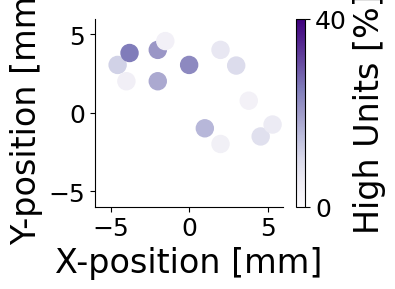

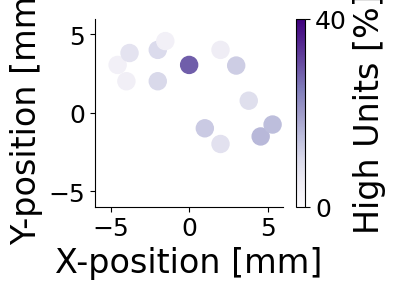

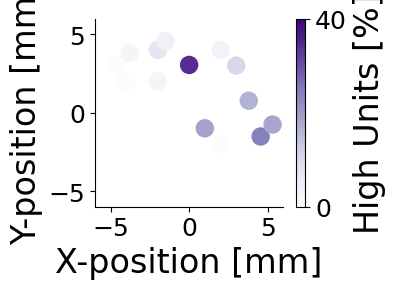

In [48]:
unique_pos = np.unique(unit_pos, axis=0)
nunits_per_pos = np.zeros(unique_pos.shape[0])*np.nan
total_units_per_pos = np.zeros(unique_pos.shape[0])*np.nan

for align_event in align_events:
    high_mod_unit_pos = unit_pos[np.array(single_ch_decoding[align_event]) >= high_group_min[align_event],:]
    for ipos in range(unique_pos.shape[0]):
        nunits_per_pos[ipos] = np.sum(np.logical_and(high_mod_unit_pos[:,0] == unique_pos[ipos,0], high_mod_unit_pos[:,1] == unique_pos[ipos,1]))
        total_units_per_pos[ipos] = np.sum(np.logical_and(unit_pos[:,0] == unique_pos[ipos,0], unit_pos[:,1] == unique_pos[ipos,1]))
        
    fig, ax = plt.subplots(1,1,figsize=(4,3))
    high_unit_prop = (nunits_per_pos/total_units_per_pos)*100
    dec_map = ax.scatter(unique_pos[:,0], unique_pos[:,1], s=150, c=high_unit_prop, cmap='Purples')
    ax.set(xlim=(-6,6), ylim=(-6,6), xlabel='X-position [mm]', ylabel='Y-position [mm]')
    ax.set_aspect('equal')
    cb = plt.colorbar(dec_map, label='High Units [%]')
    dec_map.set_clim([0,40])
    cb.set_ticks([0,40])
    
    # plt.suptitle(f"{align_event}")
    fig.tight_layout()
    aopy.visualization.savefig(base_save_dir, f'{subject}_high_unit_spatial_dist_{align_event}.svg')

In [49]:
nunits_unit_adding = np.arange(5,nunits_per_group*2,2)
ccs_pp_unit_add = {}
ccs_pp_unit_add_intertrial = {}
ccs_pp_random_unit_add = {}
ccs_pp_random_unit_add_intertrial = {}
for align_event in align_events:
    
    low_group_max = np.max(np.array(single_ch_decoding[align_event])[np.argsort(np.array(single_ch_decoding[align_event]))][:np.max(nunits_unit_adding)])
    high_group_min = np.min(np.array(single_ch_decoding[align_event])[np.argsort(np.array(single_ch_decoding[align_event]))][-np.max(nunits_unit_adding):])

    low_group_mask = np.array(single_ch_decoding[align_event]) <= low_group_max
    high_group_mask = np.array(single_ch_decoding[align_event]) >= high_group_min

    nmin_units = np.min(nunits_unit_adding)
    ccs_pp_unit_add[align_event] = np.zeros((len(nunits_unit_adding), nmin_units , niterations))*np.nan
    ccs_pp_unit_add_intertrial[align_event] = np.zeros((len(nunits_unit_adding), nmin_units , niterations))*np.nan
    ccs_pp_random_unit_add[align_event] = np.zeros((len(nunits_unit_adding), nmin_units , niterations))*np.nan
    ccs_pp_random_unit_add_intertrial[align_event] = np.zeros((len(nunits_unit_adding), nmin_units , niterations))*np.nan
    for igroup, unit_group_size in enumerate(tqdm(nunits_unit_adding)):
        for iiter in range(niterations):
            low_unit_idx = np.random.choice(np.where(low_group_mask)[0], unit_group_size, replace=False)
            high_unit_idx = np.random.choice(np.where(high_group_mask)[0], unit_group_size, replace=False)

            possible_unit_idx1 = np.arange(np.array(all_prep_data[align_event]).shape[1])
            random_unit_idx1 = np.random.choice(possible_unit_idx1, unit_group_size, replace=False)
            possible_unit_idx2 = possible_unit_idx1[np.logical_not(np.in1d(possible_unit_idx1, random_unit_idx1))]
            random_unit_idx2 = np.random.choice(possible_unit_idx2, unit_group_size, replace=False)

            proj_data_low_decoding = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,low_unit_idx]/np.std(all_prep_data[align_event][:,low_unit_idx], axis=0))
            proj_data_high_decoding = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,high_unit_idx]/np.std(all_prep_data[align_event][:,high_unit_idx],axis=0))
            proj_data_rand1_decoding = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,random_unit_idx1]/np.std(all_prep_data[align_event][:,random_unit_idx1],axis=0))
            proj_data_rand2_decoding = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,random_unit_idx2]/np.std(all_prep_data[align_event][:,random_unit_idx2],axis=0))
            proj_data_low_intertrial = PCA(svd_solver='full').fit_transform(intertrial_array[rand_keys[0]][:,low_unit_idx]/np.std(intertrial_array[rand_keys[0]][:,low_unit_idx],axis=0))
            proj_data_high_intertrial = PCA(svd_solver='full').fit_transform(intertrial_array[rand_keys[0]][:,high_unit_idx]/np.std(intertrial_array[rand_keys[0]][:,high_unit_idx],axis=0))
            proj_data_rand1_intertrial = PCA(svd_solver='full').fit_transform(intertrial_array[rand_keys[0]][:,random_unit_idx1]/np.std(intertrial_array[rand_keys[0]][:,random_unit_idx1],axis=0))
            proj_data_rand2_intertrial = PCA(svd_solver='full').fit_transform(intertrial_array[rand_keys[0]][:,random_unit_idx2]/np.std(intertrial_array[rand_keys[0]][:,random_unit_idx2],axis=0))

            ccs_pp_unit_add[align_event][igroup,:,iiter] = canoncorr_gallego(proj_data_low_decoding[:,:nmin_units], proj_data_high_decoding[:,:nmin_units])
            ccs_pp_random_unit_add[align_event][igroup,:,iiter] = canoncorr_gallego(proj_data_rand1_decoding[:,:nmin_units], proj_data_rand2_decoding[:,:nmin_units])
            ccs_pp_unit_add_intertrial[align_event][igroup,:,iiter] = canoncorr_gallego(proj_data_low_intertrial[:,:nmin_units], proj_data_high_intertrial[:,:nmin_units])
            ccs_pp_random_unit_add_intertrial[align_event][igroup,:,iiter] = canoncorr_gallego(proj_data_rand1_intertrial[:,:nmin_units], proj_data_rand2_intertrial[:,:nmin_units])

  0%|          | 0/48 [00:00<?, ?it/s]

KeyboardInterrupt: 

/tmp/ipykernel_3014130/296566696.py:16: MatplotlibDeprecationWarning: Getting the array from a PolyQuadMesh will return the full array in the future (uncompressed). To get this behavior now set the PolyQuadMesh with a 2D array .set_array(data2d).
  cb = plt.colorbar(im1, label='CCA $R^2$')


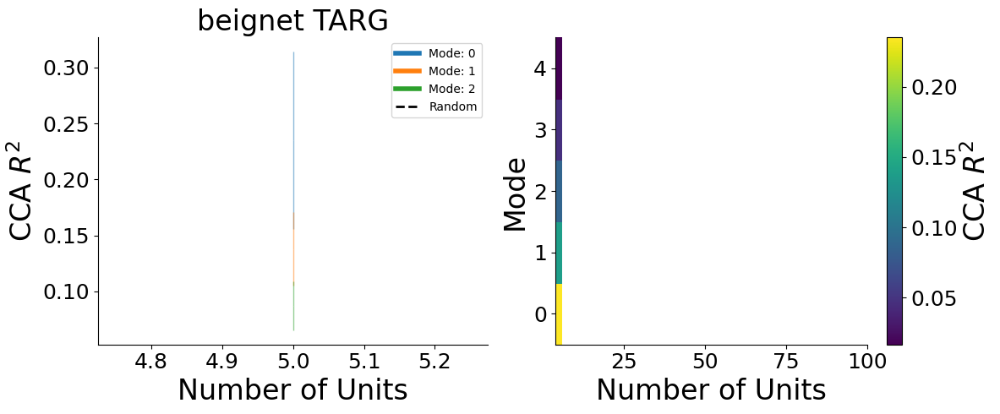

KeyError: 'GO CUE'

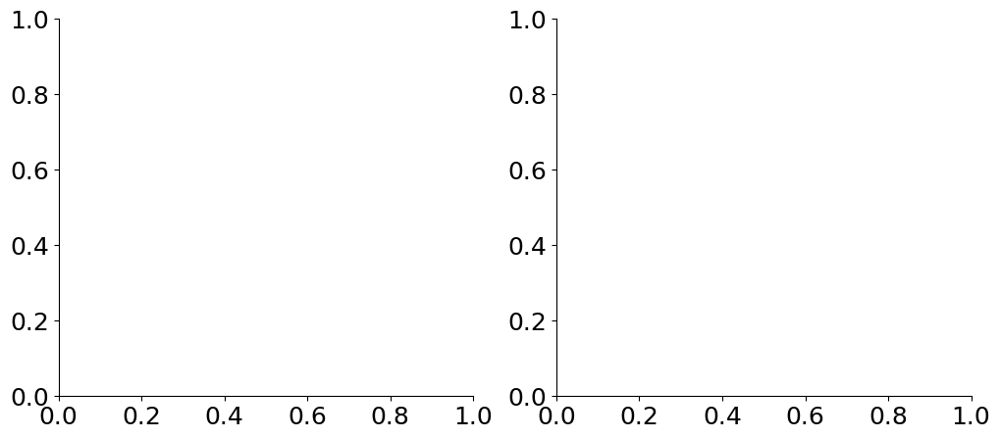

In [50]:
# Controls for the specific units chosen
for align_event in align_events:
    fig, ax = plt.subplots(1,2,figsize=(12,5))
    ax[0].plot(nunits_unit_adding, np.mean(ccs_pp_unit_add[align_event], axis=2)[:,:nmodes_plot])
    ax[0].plot([], 'k--', linewidth=2)
    ax[0].legend([f"Mode: {ipc}" for ipc in range(nmodes_plot)] + ['Random'])
    for ipc in range(nmodes_plot):
        ax[0].plot(nunits_unit_adding, np.mean(ccs_pp_random_unit_add[align_event], axis=2)[:,ipc], '--', color=f"C{ipc}")
        ax[0].fill_between(nunits_unit_adding, np.mean(ccs_pp_unit_add[align_event], axis=2)[:,ipc],  np.mean(ccs_pp_unit_add[align_event], axis=2)[:,ipc]-np.std(ccs_pp_unit_add[align_event], axis=2)[:,ipc], alpha=0.5, color=f"C{ipc}")
        ax[0].fill_between(nunits_unit_adding, np.mean(ccs_pp_unit_add[align_event], axis=2)[:,ipc],  np.mean(ccs_pp_unit_add[align_event], axis=2)[:,ipc]+np.std(ccs_pp_unit_add[align_event], axis=2)[:,ipc], alpha=0.5, color=f"C{ipc}")

    ax[0].set(xlabel='Number of Units', ylabel='CCA $R^2$',title=f"{subject} {align_event[:4]}")
# 
    im1 = ax[1].pcolor(nunits_unit_adding, np.arange(nmin_units), np.mean(ccs_pp_unit_add[align_event], axis=2).T)
    ax[1].set(xlabel='Number of Units', ylabel='Mode')
    cb = plt.colorbar(im1, label='CCA $R^2$')
    fig.tight_layout()
    plt.show()

In [ ]:
# Controls for the specific units chosen
for align_event in align_events:
    fig, ax = plt.subplots(1,2,figsize=(12,5))
    ax[0].plot(nunits_unit_adding, np.mean(ccs_pp_unit_add_intertrial[align_event], axis=2)[:,:nmodes_plot])
    ax[0].plot([], 'k--', linewidth=2)
    ax[0].legend([f"Mode: {ipc}" for ipc in range(nmodes_plot)] + ['Random'])
    for ipc in range(nmodes_plot):
        ax[0].plot(nunits_unit_adding, np.mean(ccs_pp_random_unit_add_intertrial[align_event], axis=2)[:,ipc], '--', color=f"C{ipc}")
        ax[0].fill_between(nunits_unit_adding, np.mean(ccs_pp_unit_add_intertrial[align_event], axis=2)[:,ipc],  np.mean(ccs_pp_unit_add_intertrial[align_event], axis=2)[:,ipc]-np.std(ccs_pp_unit_add_intertrial[align_event], axis=2)[:,ipc], alpha=0.5, color=f"C{ipc}")
        ax[0].fill_between(nunits_unit_adding, np.mean(ccs_pp_unit_add_intertrial[align_event], axis=2)[:,ipc],  np.mean(ccs_pp_unit_add_intertrial[align_event], axis=2)[:,ipc]+np.std(ccs_pp_unit_add_intertrial[align_event], axis=2)[:,ipc], alpha=0.5, color=f"C{ipc}")

    ax[0].set(xlabel='Number of Units', ylabel='CCA $R^2$',title=f"{subject} {align_event[:4]}", ylim=(0,0.8))
# 
    im1 = ax[1].pcolor(nunits_unit_adding, np.arange(nmin_units), np.mean(ccs_pp_unit_add[align_event], axis=2).T)
    ax[1].set(xlabel='Number of Units', ylabel='Mode')
    cb = plt.colorbar(im1, label='CCA $R^2$')
    fig.tight_layout()
    plt.show()

In [ ]:
# Control for the temporal structure of the data
nunits_unit_adding = np.arange(5,nunits_per_group*2,2)
ccs_pp_unit_add_shuffled = {}
ccs_pp_random_unit_add_shuffled = {}
for align_event in align_events:
    low_group_max = np.max(np.array(single_ch_decoding[align_event])[np.argsort(np.array(single_ch_decoding[align_event]))][:np.max(nunits_unit_adding)])
    high_group_min = np.min(np.array(single_ch_decoding[align_event])[np.argsort(np.array(single_ch_decoding[align_event]))][-np.max(nunits_unit_adding):])

    low_group_mask = np.array(single_ch_decoding[align_event]) <= low_group_max
    high_group_mask = np.array(single_ch_decoding[align_event]) >= high_group_min

    nmin_units = np.min(nunits_unit_adding)
    ccs_pp_unit_add_shuffled[align_event] = np.zeros((len(nunits_unit_adding), nmin_units , niterations))*np.nan
    ccs_pp_random_unit_add_shuffled[align_event] = np.zeros((len(nunits_unit_adding), nmin_units , niterations))*np.nan
    for igroup, unit_group_size in enumerate(tqdm(nunits_unit_adding)):
        for iiter in range(niterations):
            low_unit_idx = np.random.choice(np.where(low_group_mask)[0], unit_group_size, replace=False)
            high_unit_idx = np.random.choice(np.where(high_group_mask)[0], unit_group_size, replace=False)

            possible_unit_idx1 = np.arange(np.array(single_ch_decoding_prep_data[align_event]).shape[1])
            random_unit_idx1 = np.random.choice(possible_unit_idx1, unit_group_size, replace=False)
            possible_unit_idx2 = possible_unit_idx1[np.logical_not(np.in1d(possible_unit_idx1, random_unit_idx1))]
            random_unit_idx2 = np.random.choice(possible_unit_idx2, unit_group_size, replace=False)

            proj_data_low_decoding = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,low_unit_idx])
            proj_data_high_decoding = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,high_unit_idx])
            proj_data_rand1_decoding = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,random_unit_idx1])
            proj_data_rand2_decoding = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,random_unit_idx2])

            random_timestamps_low = np.random.choice(np.arange(proj_data_low_decoding.shape[0]), proj_data_low_decoding.shape[0], replace=False)
            random_timestamps_high = np.random.choice(np.arange(proj_data_low_decoding.shape[0]), proj_data_low_decoding.shape[0], replace=False)
            random_timestamps_rand1 = np.random.choice(np.arange(proj_data_low_decoding.shape[0]), proj_data_low_decoding.shape[0], replace=False)
            random_timestamps_rand2 = np.random.choice(np.arange(proj_data_low_decoding.shape[0]), proj_data_low_decoding.shape[0], replace=False)
            ccs_pp_unit_add_shuffled[align_event][igroup,:,iiter] = canoncorr_gallego(proj_data_low_decoding[random_timestamps_low,:nmin_units], proj_data_high_decoding[random_timestamps_high,:nmin_units])
            ccs_pp_random_unit_add_shuffled[align_event][igroup,:,iiter] = canoncorr_gallego(proj_data_rand1_decoding[random_timestamps_rand1,:nmin_units], proj_data_rand2_decoding[random_timestamps_rand2,:nmin_units])

In [ ]:
# Controls for the specific units chosen
for align_event in align_events:
    fig, ax = plt.subplots(1,2,figsize=(12,5))
    ax[0].plot(nunits_unit_adding, np.mean(ccs_pp_unit_add_shuffled[align_event], axis=2)[:,:nmodes_plot])
    ax[0].plot([], 'k--', linewidth=2)
    ax[0].legend([f"Mode: {ipc}" for ipc in range(nmodes_plot)] + ['Random'])
    for ipc in range(nmodes_plot):
        ax[0].plot(nunits_unit_adding, np.mean(ccs_pp_random_unit_add_shuffled[align_event], axis=2)[:,ipc], '--', color=f"C{ipc}")
        ax[0].fill_between(nunits_unit_adding, np.mean(ccs_pp_unit_add_shuffled[align_event], axis=2)[:,ipc],  np.mean(ccs_pp_unit_add_shuffled[align_event], axis=2)[:,ipc]-np.std(ccs_pp_unit_add_shuffled[align_event], axis=2)[:,ipc], alpha=0.5, color=f"C{ipc}")
        ax[0].fill_between(nunits_unit_adding, np.mean(ccs_pp_unit_add_shuffled[align_event], axis=2)[:,ipc],  np.mean(ccs_pp_unit_add_shuffled[align_event], axis=2)[:,ipc]+np.std(ccs_pp_unit_add_shuffled[align_event], axis=2)[:,ipc], alpha=0.5, color=f"C{ipc}")

    ax[0].set(xlabel='Number of Units', ylabel='CCA $R^2$',title=f"{subject} {align_event[:4]} shuffled")

    im1 = ax[1].pcolor(nunits_unit_adding, np.arange(nmin_units), np.mean(ccs_pp_unit_add_shuffled[align_event], axis=2).T)
    ax[1].set(xlabel='Number of Units', ylabel='Mode')
    cb = plt.colorbar(im1, label='CCA $R^2$')
    fig.tight_layout()
    plt.show()

In [ ]:
# Compare chance level to actual levels
unit_add_idx = np.where(nunits_unit_adding>=npcs)[0][0]
fig, ax = plt.subplots(1,len(align_events), figsize=(15,4))
for ievent, align_event in enumerate(align_events):
    ax[ievent].plot(np.mean(ccs_pp_unit_add[align_event], axis=2)[unit_add_idx,:])
    ax[ievent].plot(np.mean(ccs_pp_unit_add_shuffled[align_event], axis=2)[unit_add_idx,:])
    
    ax[ievent].set(xlabel='PC', ylabel='CCA R', title=f"{align_event[:4]} {nunits_unit_adding[unit_add_idx]} Units", ylim=(0,0.3))
    ax[ievent].legend(['Time structured', 'Time shuffled'])

#### Top 60 and bottom 60 randomly split into two groups 

In [51]:
# Compute CCs the same way as Gallego paper
proj_data_low_decoding_g1 = {}
proj_data_low_decoding_g2 = {}
proj_data_high_decoding_g1 = {}
proj_data_high_decoding_g2 = {}
proj_data_low_intertrial_g1 = {}
proj_data_low_intertrial_g2 = {}
proj_data_high_intertrial_g1 = {}
proj_data_high_intertrial_g2 = {}
ccs_pp = {}
proj_data_pp_splits = {}
ccs_pp_intertrial = {}
proj_data_pp_splits_intertrial = {}

for align_event in align_events:
    ccs_pp[align_event] = np.zeros((4,4, npcs, niterations))*np.nan
    ccs_pp_intertrial[align_event] = np.zeros((4,4, npcs, niterations))*np.nan
    proj_data_pp_splits[align_event] = []
    proj_data_pp_splits_intertrial[align_event] = []
    for iiter in tqdm(range(niterations)):
        np.random.seed(iiter)
        single_ch_low_decoding_prep_data_split = []
        single_ch_high_decoding_prep_data_split = []
        low_group_max = np.max(np.array(single_ch_decoding[align_event])[np.argsort(np.array(single_ch_decoding[align_event]))][:nunits_per_group_split])
        high_group_min = np.min(np.array(single_ch_decoding[align_event])[np.argsort(np.array(single_ch_decoding[align_event]))][-nunits_per_group_split:])
        # low_group_max = 0.125
        # high_group_min = np.median(single_ch_decoding[align_event]) + 1*np.std(single_ch_decoding[align_event])
        # print(low_group_max, high_group_min)

        low_unit_idx = np.random.choice(np.where(np.array(single_ch_decoding[align_event]) <= low_group_max)[0], (nunits_per_group,2), replace=False)
        high_unit_idx = np.random.choice(np.where(np.array(single_ch_decoding[align_event]) >= high_group_min)[0], (nunits_per_group,2), replace=False)

        proj_data_low_decoding_g1[align_event] = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,low_unit_idx[:,0]]/np.std(all_prep_data[align_event][:,low_unit_idx[:,0]] ,axis=0))
        proj_data_low_decoding_g2[align_event] = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,low_unit_idx[:,1]]/np.std( all_prep_data[align_event][:,low_unit_idx[:,1]],axis=0))
        proj_data_high_decoding_g1[align_event] = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,high_unit_idx[:,0]]/np.std(all_prep_data[align_event][:,high_unit_idx[:,0]] ,axis=0))
        proj_data_high_decoding_g2[align_event] = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,high_unit_idx[:,1]]/np.std(all_prep_data[align_event][:,high_unit_idx[:,1]] ,axis=0))

        proj_data_low_intertrial_g1[align_event] = PCA(svd_solver='full').fit_transform(intertrial_array[rand_keys[0]][:,low_unit_idx[:,0]]/np.std(intertrial_array[rand_keys[0]][:,low_unit_idx[:,0]],axis=0))
        proj_data_low_intertrial_g2[align_event] = PCA(svd_solver='full').fit_transform(intertrial_array[rand_keys[0]][:,low_unit_idx[:,1]]/np.std(intertrial_array[rand_keys[0]][:,low_unit_idx[:,1]] ,axis=0))
        proj_data_high_intertrial_g1[align_event] = PCA(svd_solver='full').fit_transform(intertrial_array[rand_keys[0]][:,high_unit_idx[:,0]]/np.std(intertrial_array[rand_keys[0]][:,high_unit_idx[:,0]] ,axis=0))
        proj_data_high_intertrial_g2[align_event] = PCA(svd_solver='full').fit_transform(intertrial_array[rand_keys[0]][:,high_unit_idx[:,1]]/np.std( intertrial_array[rand_keys[0]][:,high_unit_idx[:,1]],axis=0))
        
        proj_data_pp_splits[align_event].append([proj_data_low_decoding_g1[align_event], proj_data_low_decoding_g2[align_event], proj_data_high_decoding_g1[align_event], proj_data_high_decoding_g2[align_event]])
        proj_data_pp_splits_intertrial[align_event].append([proj_data_low_intertrial_g1[align_event], proj_data_low_intertrial_g2[align_event], proj_data_high_intertrial_g1[align_event], proj_data_high_intertrial_g2[align_event]])

        for itrain, train_data in enumerate(proj_data_pp_splits[align_event][iiter]):
            for itest, test_data in enumerate(proj_data_pp_splits[align_event][iiter]):
                ccs_pp[align_event][itrain,itest,:, iiter] = canoncorr_gallego(train_data[:,:npcs], test_data[:,:npcs])
                ccs_pp_intertrial[align_event][itrain,itest,:, iiter] = canoncorr_gallego(proj_data_pp_splits_intertrial[align_event][iiter][itrain][:,:npcs], proj_data_pp_splits_intertrial[align_event][iiter][itest][:,:npcs])

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

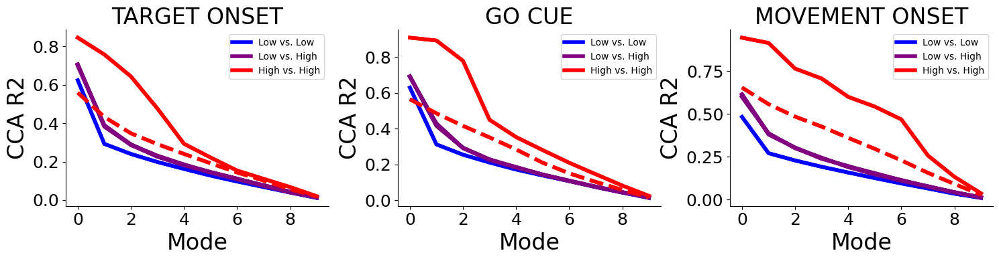

In [52]:
fig, ax = plt.subplots(1,len(align_events),figsize=(5*len(align_events),4))
for ievent, align_event in enumerate(align_events):
    ax[ievent].plot([], color='blue') # Plot no show lone for legend
    ax[ievent].plot([], color='purple') # Plot no show lone for legend
    ax[ievent].plot([], color='red') # Plot no show lone for legend

    for itrain in range(len(proj_data_pp_splits[align_event][0])):
        for itest in range(len(proj_data_pp_splits[align_event][0])):
            if itrain != itest:
                if itrain < 2 and itest < 2: 
                    ax[ievent].plot(np.mean(ccs_pp[align_event],axis=3)[itrain,itest,:],'b')
                elif (itrain < 2 & itest >= 2) or (itrain >= 2 & itest < 2):
                    ax[ievent].plot(np.mean(ccs_pp[align_event],axis=3)[itrain,itest,:],color='purple')
                elif itrain >= 2 and itest >= 2:
                    ax[ievent].plot(np.mean(ccs_pp[align_event],axis=3)[itrain,itest,:],color='red', label='High vs. High')
                    ax[ievent].plot(np.mean(ccs_pp_intertrial[align_event], axis=3)[itrain,itest,:], '--', color='red')
    ax[ievent].legend(['Low vs. Low','Low vs. High', 'High vs. High'])
    ax[ievent].set(xlabel='Mode', ylabel='CCA R2', title=f"{align_event}")
fig.tight_layout()
plt.show()

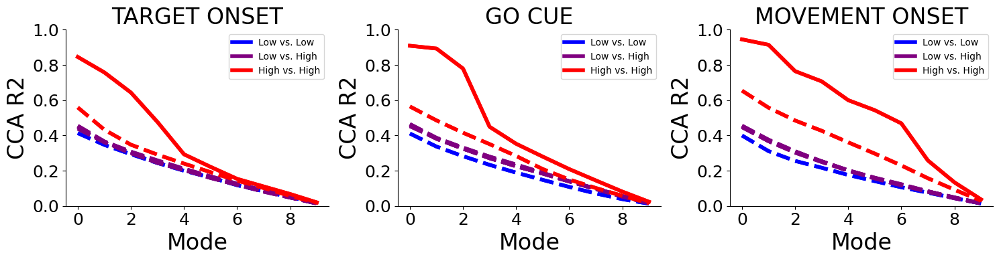

In [53]:
fig, ax = plt.subplots(1,len(align_events),figsize=(5*len(align_events),4))
for ievent, align_event in enumerate(align_events):
    ax[ievent].plot([], color='blue') # Plot no show lone for legend
    ax[ievent].plot([], color='purple') # Plot no show lone for legend
    ax[ievent].plot([], color='red') # Plot no show lone for legend

    for itrain in range(len(proj_data_pp_splits[align_event][0])):
        for itest in range(len(proj_data_pp_splits[align_event][0])):
            if itrain != itest:
                if itrain < 2 and itest < 2: 
                    ax[ievent].plot(np.mean(ccs_pp_intertrial[align_event], axis=3)[itrain,itest,:], '--', color='b')
                elif (itrain < 2 & itest >= 2) or (itrain >= 2 & itest < 2):
                    ax[ievent].plot(np.mean(ccs_pp_intertrial[align_event],axis=3)[itrain,itest,:], '--', color='purple')
                elif itrain >= 2 and itest >= 2:
                    ax[ievent].plot(np.mean(ccs_pp[align_event], axis=3)[itrain,itest,:],color='red', label='High vs. High')
                    ax[ievent].plot(np.mean(ccs_pp_intertrial[align_event], axis=3)[itrain,itest,:], '--', color='red')
    ax[ievent].legend(['Low vs. Low','Low vs. High', 'High vs. High'])
    ax[ievent].set(xlabel='Mode', ylabel='CCA R2', title=f"{align_event}", ylim=(0,1))
fig.tight_layout()
plt.show()

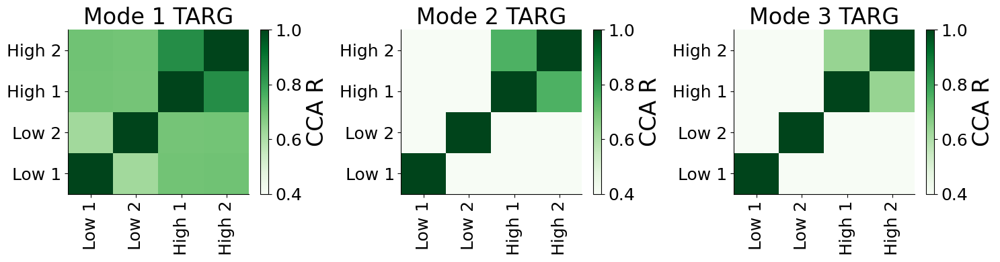

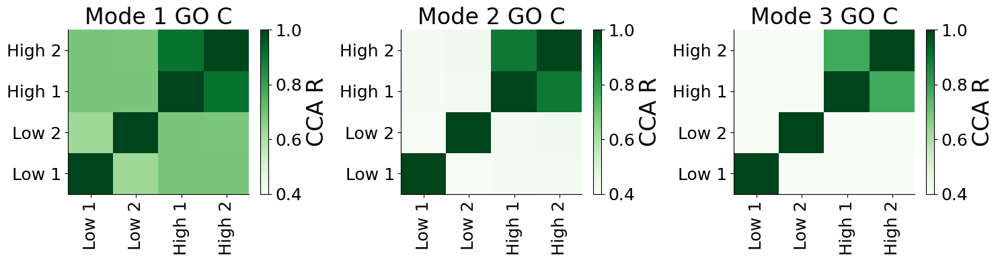

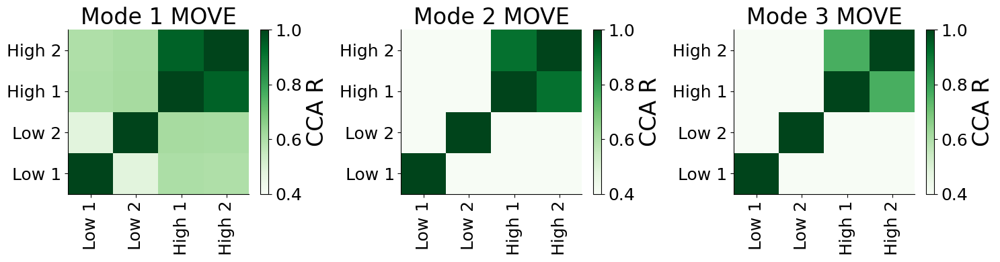

In [54]:
for align_event in align_events:
    fig, ax = plt.subplots(1,nmodes_plot,figsize=(nmodes_plot*5,4))
    for imode in range(nmodes_plot):
        im_pp = ax[imode].pcolor(np.arange(len(proj_data_pp_splits[align_event][0])), np.arange(len(proj_data_pp_splits[align_event][0])), np.mean(ccs_pp[align_event], axis=3)[:,:,imode], cmap='Greens', vmin=0.4, vmax=1)
        cb = plt.colorbar(im_pp, label='CCA R')
        ax[imode].set_xticks(np.arange(len(proj_data_pp_splits[align_event][0])), ['Low 1', 'Low 2', 'High 1', 'High 2'], rotation=90)
        ax[imode].set_yticks(np.arange(len(proj_data_pp_splits[align_event][0])), ['Low 1', 'Low 2', 'High 1', 'High 2'], rotation=0)
        # for itrain in range(len(proj_data_pp_splits[align_event])):
        #     for itest in range(len(proj_data_pp_splits[align_event])):
        #         ax[imode].annotate(np.round(ccs_pp[align_event][itrain,itest,imode],2), (itrain,itest), color='red', ha='center', va='center')
        ax[imode].set(title=f"Mode {imode+1} {align_event[:4]}")
    fig.tight_layout()
    plt.show()

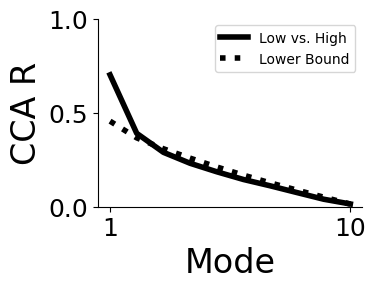

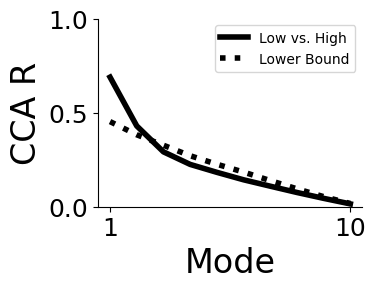

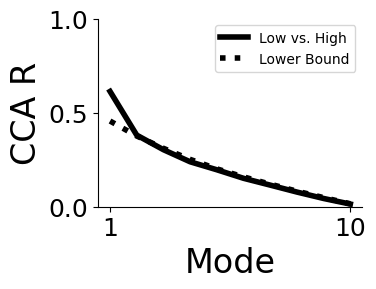

In [55]:
for ievent, align_event in enumerate(align_events):
    fig, ax = plt.subplots(1,1,figsize=(4,3))
    ax.plot(np.mean(ccs_pp[align_event], axis=3)[1,3,:],color='black')
    ax.plot(np.mean(ccs_pp_intertrial[align_event],axis=3)[1,3,:], ':', color='black')

    ax.legend(['Low vs. High','Lower Bound'])
    ax.set(xlabel='Mode', ylabel='CCA R', ylim=(0,1))
    ax.set_xticks([0,9], [1,10])
    fig.tight_layout()
    aopy.visualization.savefig(base_save_dir, f'{subject}_high_low_cca_{align_event}.svg')

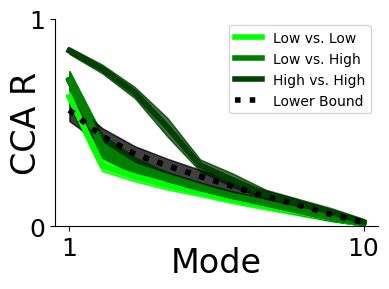

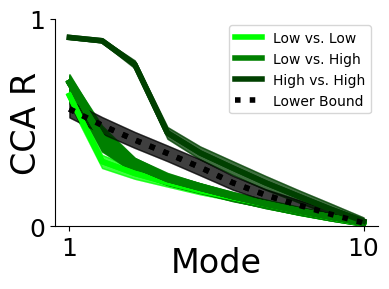

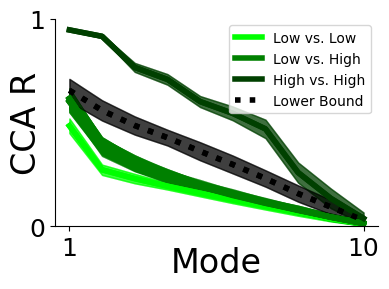

In [56]:
for ievent, align_event in enumerate(align_events):
    fig, ax = plt.subplots(1,1,figsize=(4,3))
    ax.plot([], color=[0,1,0]) # Plot no show lone for legend
    ax.plot([], color=[0,.5,0]) # Plot no show lone for legend
    ax.plot([], color=[0,.25,0]) # Plot no show lone for legend
    ax.plot([], 'k:') # Plot no show lone for legend

    for itrain in range(4):
        for itest in range(4):
            if itrain != itest:
                mean_value = np.mean(ccs_pp[align_event][itrain,itest,:,:], axis=1) 
                std_value = np.std(ccs_pp[align_event][itrain,itest,:,:], axis=1) 
                mean_value_intertrial = np.mean(ccs_pp_intertrial[align_event][itrain,itest,:], axis=1) 
                std_value_intertrial = np.std(ccs_pp_intertrial[align_event][itrain,itest,:], axis=1) 
                if itrain < 2 and itest < 2: 
                    ax.plot(mean_value,color=[0,1,0])
                    ax.fill_between(np.arange(npcs), mean_value-std_value, mean_value+std_value, alpha=0.5, color=[0,1,0])
                elif (itrain < 2 & itest >= 2) or (itrain >= 2 & itest < 2):
                    ax.plot(mean_value,color=[0,.5,0])
                    ax.fill_between(np.arange(npcs), mean_value-std_value, mean_value+std_value, alpha=0.5, color=[0,.5,0])
                elif itrain >= 2 and itest >= 2:
                    ax.plot(mean_value,color=[0,.25,0], label='High vs. High')
                    ax.fill_between(np.arange(npcs), mean_value-std_value, mean_value+std_value, alpha=0.5, color=[0,.25,0])
                    ax.fill_between(np.arange(npcs), mean_value_intertrial-std_value_intertrial, mean_value_intertrial+std_value_intertrial, alpha=0.5, color='black')
                    ax.plot(np.mean(ccs_pp_intertrial[align_event][itrain,itest,:], axis=1), 'k:')
    ax.legend(['Low vs. Low','Low vs. High', 'High vs. High', 'Lower Bound'])
    ax.set(ylim=(0,1))
    ax.set_xlabel('Mode', labelpad=-10)
    ax.set_ylabel('CCA R', labelpad=-10)
    ax.set_xticks([0,9], [1,10])
    ax.set_yticks([0,1], [0,1])
    
    fig.tight_layout()
    aopy.visualization.savefig(base_save_dir, f'{subject}_high_high_low_low_cca_{align_event}.svg')

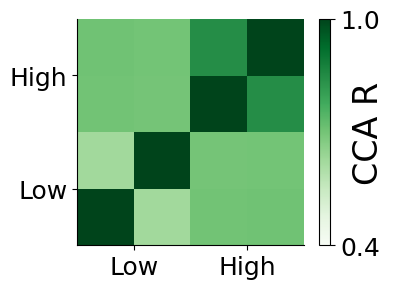

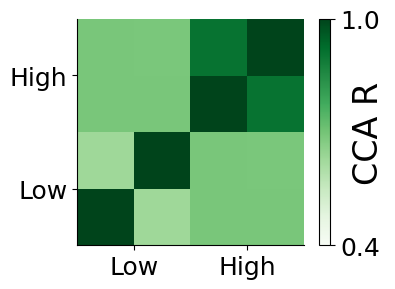

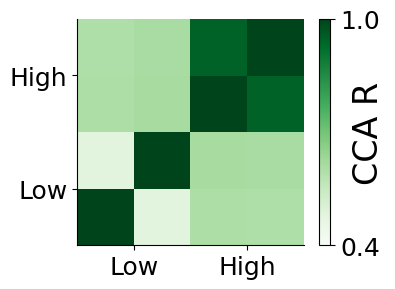

In [57]:
for align_event in align_events:
    fig, ax = plt.subplots(1,1,figsize=(4,3))
    
    im_pp = ax.pcolor(np.arange(len(proj_data_pp_splits[align_event][0])), np.arange(len(proj_data_pp_splits[align_event][0])), np.mean(ccs_pp[align_event], axis=3)[:,:,0], cmap='Greens', vmin=0.4, vmax=1)
    cb = plt.colorbar(im_pp)
    cb.set_ticks([0.4,1])
    cb.set_label('CCA R', labelpad=-20.)
    # ax.set_xticks(np.arange(len(proj_data_pp_splits[align_event])), ['Low 1', 'Low 2', 'High 1', 'High 2'], rotation=90)
    # ax.set_yticks(np.arange(len(proj_data_pp_splits[align_event])), ['Low 1', 'Low 2', 'High 1', 'High 2'], rotation=0)
    ax.set_xticks([.5,2.5], ['Low', 'High'])
    ax.set_yticks([.5,2.5], ['Low', 'High'])
    ax.set_aspect('equal')
    fig.tight_layout()
    aopy.visualization.savefig(base_save_dir, f'{subject}_high_high_low_low_cca_heatmap_{align_event}.svg')

In [156]:
nunits_unit_adding_split = np.arange(5,nunits_per_group*2,2)
ccs_pp_unit_add_split = {}
ccs_pp_unit_add_split_intertrial = {}
for align_event in align_events:
    low_group_max = np.max(np.array(single_ch_decoding[align_event])[np.argsort(np.array(single_ch_decoding[align_event]))][:np.max(nunits_unit_adding_split)*2])
    high_group_min = np.min(np.array(single_ch_decoding[align_event])[np.argsort(np.array(single_ch_decoding[align_event]))][-np.max(nunits_unit_adding_split)*2:])

    low_group_mask = np.array(single_ch_decoding[align_event]) <= low_group_max
    high_group_mask = np.array(single_ch_decoding[align_event]) >= high_group_min

    nmin_units = np.min(nunits_unit_adding_split)
    ccs_pp_unit_add_split[align_event] = np.zeros((4,4,len(nunits_unit_adding_split), nmin_units, niterations))*np.nan
    ccs_pp_unit_add_split_intertrial[align_event] = np.zeros((4,4,len(nunits_unit_adding_split), nmin_units, niterations))*np.nan
    for igroup, unit_group_size in enumerate(tqdm(nunits_unit_adding_split)):
        for iiter in range(niterations):
            low_unit_idx = np.random.choice(np.where(low_group_mask)[0], (unit_group_size, 2), replace=False)
            high_unit_idx = np.random.choice(np.where(high_group_mask)[0], (unit_group_size, 2), replace=False)

            proj_data_low_decoding1 = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,low_unit_idx[:,0]])
            proj_data_low_decoding2 = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,low_unit_idx[:,1]])
            proj_data_high_decoding1 = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,high_unit_idx[:,0]])
            proj_data_high_decoding2 = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,high_unit_idx[:,1]])
            proj_data_low_intertrial1 = PCA(svd_solver='full').fit_transform(intertrial_array[rand_keys[0]][:,low_unit_idx[:,0]])
            proj_data_low_intertrial2 = PCA(svd_solver='full').fit_transform(intertrial_array[rand_keys[0]][:,low_unit_idx[:,1]])
            proj_data_high_intertrial1 = PCA(svd_solver='full').fit_transform(intertrial_array[rand_keys[0]][:,high_unit_idx[:,0]])
            proj_data_high_intertrial2 = PCA(svd_solver='full').fit_transform(intertrial_array[rand_keys[0]][:,high_unit_idx[:,1]])

            proj_data_pp_splits_unit_add = [proj_data_low_decoding1, proj_data_low_decoding2, proj_data_high_decoding1, proj_data_high_decoding2]
            proj_data_pp_splits_unit_add_intertrial = [proj_data_low_intertrial1, proj_data_low_intertrial2, proj_data_high_intertrial1, proj_data_high_intertrial2]

            for itrain, train_data in enumerate(proj_data_pp_splits_unit_add):
                for itest, test_data in enumerate(proj_data_pp_splits_unit_add):
                    ccs_pp_unit_add_split[align_event][itrain,itest,igroup,:,iiter] = canoncorr_gallego(train_data[:,:nmin_units], test_data[:,:nmin_units])
                    ccs_pp_unit_add_split_intertrial[align_event][itrain,itest,igroup,:,iiter] = canoncorr_gallego(proj_data_pp_splits_unit_add_intertrial[itrain][:,:nmin_units], proj_data_pp_splits_unit_add_intertrial[itest][:,:nmin_units])

  0%|          | 0/48 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [ ]:
for align_event in align_events:
    fig, ax = plt.subplots(1,nmodes_plot,figsize=(nmodes_plot*6,4.5))
    for ipc in range(nmodes_plot):
        ax[ipc].plot(nunits_unit_adding, np.mean(ccs_pp_random_unit_add[align_event],axis=2)[:,ipc],'k--') 
        ax[ipc].plot([], color='blue') # Plot no show lone for legend
        ax[ipc].plot([], color='purple') # Plot no show lone for legend
        ax[ipc].plot([], color='red') # Plot no show lone for legend
        ax[ipc].fill_between(nunits_unit_adding, np.mean(ccs_pp_random_unit_add[align_event],axis=2)[:,ipc]-np.std(ccs_pp_random_unit_add[align_event],axis=2)[:,ipc], np.mean(ccs_pp_random_unit_add[align_event],axis=2)[:,ipc]+np.std(ccs_pp_random_unit_add[align_event],axis=2)[:,ipc], alpha=0.5, color='black')

        for itrain in range(len(proj_data_pp_splits)):
            for itest in range(len(proj_data_pp_splits)):
                if itrain != itest:
                    data2plot = np.mean(ccs_pp_unit_add_split[align_event], axis=4)[itrain,itest,:,ipc]
                    sd2plot = np.std(ccs_pp_unit_add_split[align_event], axis=4)[itrain,itest,:,ipc]
                    if itrain < 2 and itest < 2: 
                        ax[ipc].plot(nunits_unit_adding_split, data2plot,'b')
                        ax[ipc].fill_between(nunits_unit_adding_split, data2plot-sd2plot, data2plot+sd2plot, alpha=0.5, color='b')
                    elif (itrain < 2 & itest >= 2) or (itrain >= 2 & itest < 2):
                        ax[ipc].fill_between(nunits_unit_adding_split, data2plot-sd2plot, data2plot+sd2plot, alpha=0.5, color='purple')
                        ax[ipc].plot(nunits_unit_adding_split, data2plot,color='purple')

                    elif itrain >= 2 and itest >= 2:
                        ax[ipc].plot(nunits_unit_adding_split, data2plot,color='red', label='High vs. High')
                        ax[ipc].fill_between(nunits_unit_adding_split, data2plot-sd2plot, data2plot+sd2plot, alpha=0.5, color='red')
        ax[ipc].legend(['Random', 'Low vs. Low','Low vs. High', 'High vs. High'], bbox_to_anchor=(1,.65))
        ax[ipc].set(xlabel='Number of units', ylabel='CCA R2', title=f"{subject} Mode {ipc}", ylim=(0,1))
    plt.suptitle(f"{align_event}")
    fig.tight_layout()
    plt.show()

In [ ]:
for align_event in align_events:
    fig, ax = plt.subplots(1,nmodes_plot,figsize=(nmodes_plot*6,4.5))
    for ipc in range(nmodes_plot):
        ax[ipc].plot(nunits_unit_adding, np.mean(ccs_pp_unit_add_split_intertrial[align_event],axis=2)[:,ipc],'k--') 
        ax[ipc].plot([], color='blue') # Plot no show lone for legend
        ax[ipc].plot([], color='purple') # Plot no show lone for legend
        ax[ipc].plot([], color='red') # Plot no show lone for legend
        ax[ipc].fill_between(nunits_unit_adding, np.mean(ccs_pp_unit_add_split_intertrial[align_event],axis=2)[:,ipc]-np.std(ccs_pp_unit_add_split_intertrial[align_event],axis=2)[:,ipc], np.mean(ccs_pp_unit_add_split_intertrial[align_event],axis=2)[:,ipc]+np.std(ccs_pp_unit_add_split_intertrial[align_event],axis=2)[:,ipc], alpha=0.5, color='black')

        for itrain in range(len(proj_data_pp_splits)):
            for itest in range(len(proj_data_pp_splits)):
                if itrain != itest:
                    data2plot = np.mean(ccs_pp_unit_add_split_intertrial[align_event], axis=4)[itrain,itest,:,ipc]
                    sd2plot = np.std(ccs_pp_unit_add_split_intertrial[align_event], axis=4)[itrain,itest,:,ipc]
                    if itrain < 2 and itest < 2: 
                        ax[ipc].plot(nunits_unit_adding_split, data2plot,'b')
                        ax[ipc].fill_between(nunits_unit_adding_split, data2plot-sd2plot, data2plot+sd2plot, alpha=0.5, color='b')
                    elif (itrain < 2 & itest >= 2) or (itrain >= 2 & itest < 2):
                        ax[ipc].fill_between(nunits_unit_adding_split, data2plot-sd2plot, data2plot+sd2plot, alpha=0.5, color='purple')
                        ax[ipc].plot(nunits_unit_adding_split, data2plot,color='purple')

                    elif itrain >= 2 and itest >= 2:
                        ax[ipc].plot(nunits_unit_adding_split, data2plot,color='red', label='High vs. High')
                        ax[ipc].fill_between(nunits_unit_adding_split, data2plot-sd2plot, data2plot+sd2plot, alpha=0.5, color='red')
        ax[ipc].legend(['Random', 'Low vs. Low','Low vs. High', 'High vs. High'], bbox_to_anchor=(1,.65))
        ax[ipc].set(xlabel='Number of units', ylabel='CCA R2', title=f"{subject} Mode {ipc}", ylim=(0,1))
    plt.suptitle(f"{align_event}")
    fig.tight_layout()
    plt.show()

#### Split by task relevance (prep vs. move vs. shared) groups

In [60]:
# Compute CCs the same way as Gallego paper
task_event_cca = {}
nunits_per_group = 25
for align_event in align_events:
    task_event_cca[align_event] = []
    for iiter in tqdm(range(niterations)):
        temp_proj_data = {}
        for igroup, group in enumerate(list(high_dec_groups.keys())):
            unit_idx = np.random.choice(np.where(high_dec_groups[group])[0], nunits_per_group, replace=False)
            temp_proj_data[group] = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,unit_idx]/np.std(all_prep_data[align_event][:,unit_idx],axis=0))

        compiled_cca = np.zeros((len(list(high_dec_groups.keys())), len(list(high_dec_groups.keys())), npcs))*np.nan
        for itraingroup, traingroup in enumerate(list(high_dec_groups.keys())):
            for itestgroup, testgroup in enumerate(list(high_dec_groups.keys())):
                compiled_cca[itraingroup, itestgroup, :] = canoncorr_gallego(temp_proj_data[traingroup][:,:npcs], temp_proj_data[testgroup][:,:npcs])

        task_event_cca[align_event].append(compiled_cca)

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

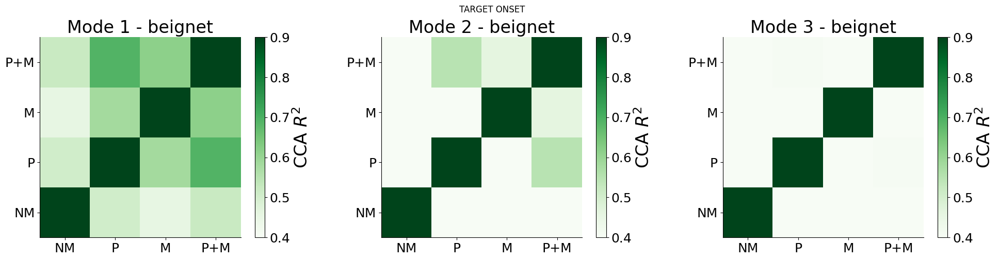

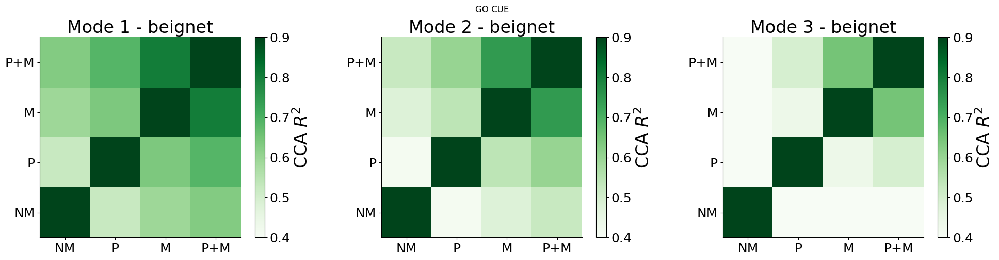

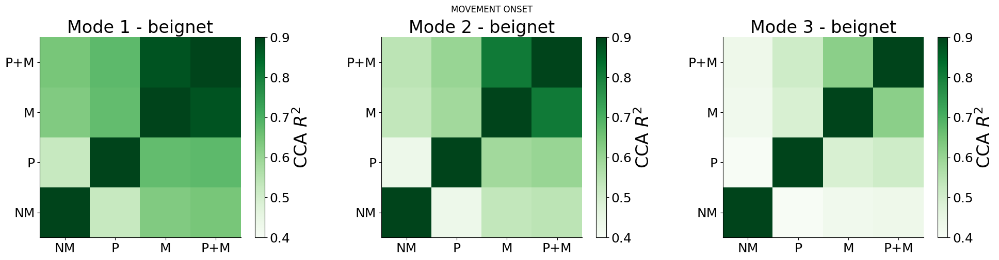

In [61]:
tick_labels = ['NM', 'P', 'M', 'P+M']
for align_event in align_events:
    fig, ax = plt.subplots(1,nmodes_plot, figsize=(20,5))
    for ipc in range(nmodes_plot):
        temp_im = ax[ipc].pcolor(np.mean(np.array(task_event_cca[align_event]), axis=0)[:,:,ipc], cmap='Greens', vmin=0.4, vmax=.9)
        ax[ipc].set_xticks(np.arange(len(list(high_dec_groups.keys())))+0.5, tick_labels)
        ax[ipc].set_yticks(np.arange(len(list(high_dec_groups.keys())))+0.5, tick_labels)
        cb = plt.colorbar(temp_im, label='CCA $R^2$')
        ax[ipc].set_aspect('equal')
        ax[ipc].set(title=f"Mode {ipc+1} - {subject}")
    plt.suptitle(f"{align_event}")
    fig.tight_layout()
    plt.show()

In [62]:
high_dec_groups_npos={}
for igroup, group_name in enumerate(list(high_dec_groups.keys())):
    high_dec_groups_npos[group_name] = np.zeros(unique_pos.shape[0])*np.nan
    temp_unit_pos = unit_pos[high_dec_groups[group_name],:]
    for ipos in range(unique_pos.shape[0]):
        high_dec_groups_npos[group_name][ipos] = np.sum(np.logical_and(temp_unit_pos[:,0] == unique_pos[ipos,0], temp_unit_pos[:,1] == unique_pos[ipos,1]))

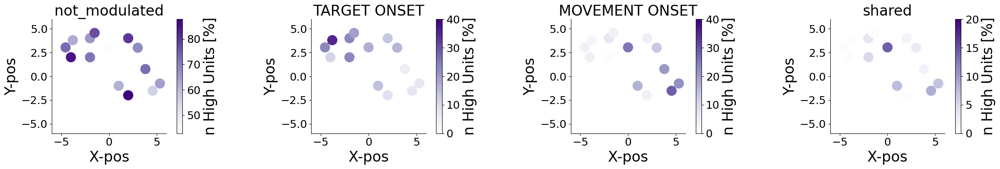

In [63]:
## Plot spatial distribution of each group
fig, ax = plt.subplots(1, len(list(high_dec_groups.keys())), figsize=(len(list(high_dec_groups.keys()))*6, 4))
for igroup, group in enumerate(list(high_dec_groups.keys())):
    dec_map = ax[igroup].scatter(unique_pos[:,0], unique_pos[:,1], s=250, c=(100*high_dec_groups_npos[group]/total_units_per_pos), cmap='Purples')
    ax[igroup].set(xlim=(-6,6), ylim=(-6,6), xlabel='X-pos', ylabel='Y-pos', title=f"{group}")
    ax[igroup].set_aspect('equal')
    if igroup > 0 and igroup!=3:
        dec_map.set_clim(0,40)
    elif igroup == 3:
        dec_map.set_clim(0,20)
    cb = plt.colorbar(dec_map, label='n High Units [%]')
        
fig.tight_layout()
plt.show()

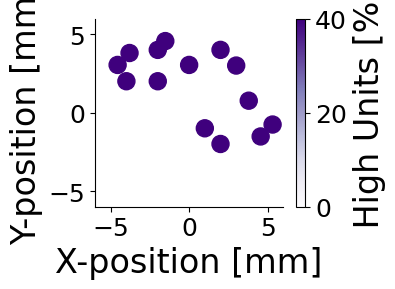

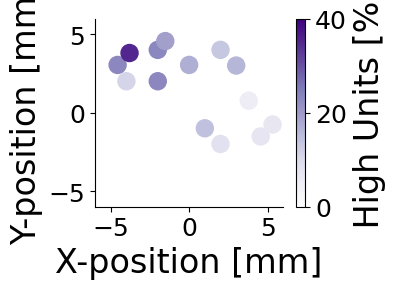

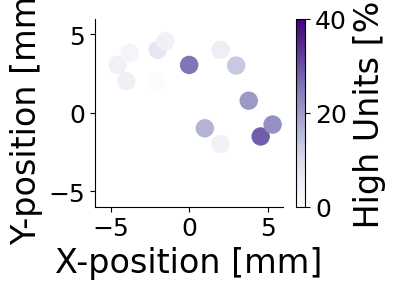

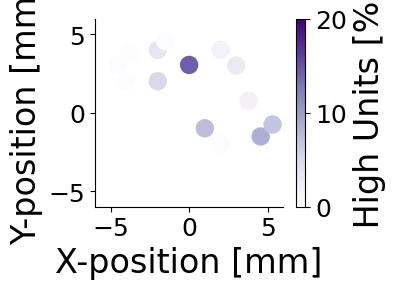

In [64]:
## Plot spatial distribution of each group
for igroup, group in enumerate(list(high_dec_groups.keys())):
    fig, ax = plt.subplots(1, 1, figsize=(4,3))
    dec_map = ax.scatter(unique_pos[:,0], unique_pos[:,1], s=150, c=(100*high_dec_groups_npos[group]/total_units_per_pos), cmap='Purples')
    ax.set(xlim=(-6,6), ylim=(-6,6), xlabel='X-position [mm]', ylabel='Y-position [mm]')
    ax.set_aspect('equal')
    if igroup == 3:
        dec_map.set_clim(0,20)
    else:
        dec_map.set_clim(0,40)
    cb = plt.colorbar(dec_map, label=' High Units [%]')

    fig.tight_layout()
    aopy.visualization.savefig(base_save_dir, f'{subject}_{group}_n_high_dec_units.svg')

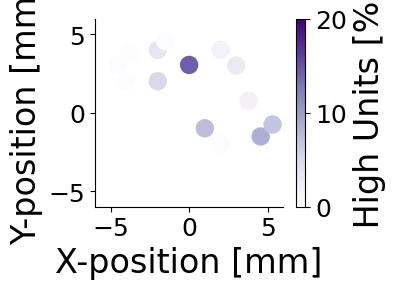

In [65]:
## Plot spatial distribution of each group
fig, ax = plt.subplots(1, 1, figsize=(4,3))
dec_map = ax.scatter(unique_pos[:,0], unique_pos[:,1], s=150, c=(100*high_dec_groups_npos['shared']/total_units_per_pos), cmap='Purples')
ax.set(xlim=(-6,6), ylim=(-6,6), xlabel='X-position [mm]', ylabel='Y-position [mm]')
ax.set_aspect('equal')
dec_map.set_clim(0,20)
cb = plt.colorbar(dec_map, label=' High Units [%]')
        
fig.tight_layout()
aopy.visualization.savefig(base_save_dir, f'{subject}_shared_n_high_dec_units.svg')

In [ ]:
max_group_size = np.min([np.sum(high_dec_groups[label]) for label in list(high_dec_groups.keys())])
# nunits_unit_adding_event = np.arange(5, max_group_size)
nunits_unit_adding_event = np.arange(5,nunits_per_group*2,2)
nmin_units = np.min(nunits_unit_adding_event)
ccs_pp_unit_add_event = {}
for align_event in align_events:
    ccs_pp_unit_add_event[align_event] = np.zeros((len(list(high_dec_groups.keys())),len(list(high_dec_groups.keys())),len(nunits_unit_adding_event), nmin_units, niterations))*np.nan

    for igroup, unit_group_size in enumerate(tqdm(nunits_unit_adding_event)):
        for iiter in range(niterations):
            for itraingroup, traingroup in enumerate(list(high_dec_groups.keys())):
                for itestgroup, testgroup in enumerate(list(high_dec_groups.keys())):
                    if np.sum(high_dec_groups[traingroup]) >= unit_group_size and np.sum(high_dec_groups[testgroup]) >= unit_group_size:
                        train_unit_idx = np.random.choice(np.where(high_dec_groups[traingroup])[0], unit_group_size, replace=False)
                        test_unit_idx = np.random.choice(np.where(high_dec_groups[testgroup])[0], unit_group_size, replace=False)
                        train_temp_proj_data = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,train_unit_idx]/np.std(all_prep_data[align_event][:,train_unit_idx],axis=0))
                        test_temp_proj_data = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,test_unit_idx]/np.std(all_prep_data[align_event][:,test_unit_idx],axis=0)

                        ccs_pp_unit_add_event[align_event][itraingroup, itestgroup, igroup, :, iiter] = canoncorr_gallego(train_temp_proj_data[:,:nmin_units], test_temp_proj_data[:,:nmin_units])

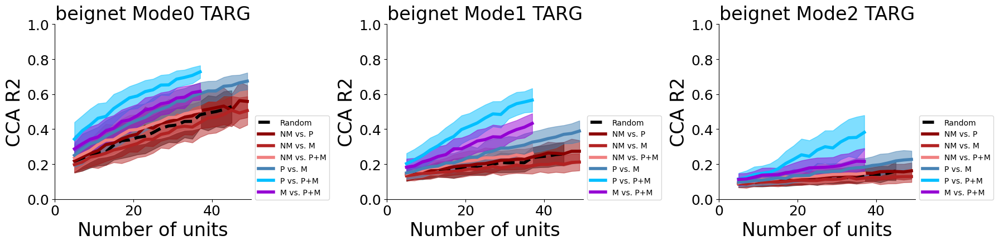

KeyError: 'GO CUE'

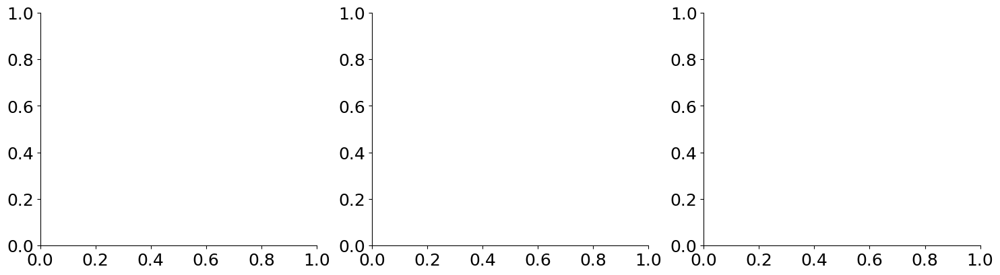

In [72]:
for align_event in align_events:
    fig, ax = plt.subplots(1,nmodes_plot,figsize=(nmodes_plot*6,4.5))
    for ipc in range(nmodes_plot):
        ax[ipc].plot(nunits_unit_adding, np.mean(ccs_pp_random_unit_add[align_event],axis=2)[:,ipc],'k--') 
        ax[ipc].plot([], color='darkred') # Plot no show lone for legend
        ax[ipc].plot([], color='firebrick') # Plot no show lone for legend
        ax[ipc].plot([], color='lightcoral') # Plot no show lone for legend
        ax[ipc].plot([], color='steelblue') # Plot no show lone for legend
        ax[ipc].plot([], color='deepskyblue') # Plot no show lone for legend
        ax[ipc].plot([], color='darkviolet') # Plot no show lone for legend
        ax[ipc].fill_between(nunits_unit_adding, np.mean(ccs_pp_random_unit_add[align_event],axis=2)[:,ipc]-np.std(ccs_pp_random_unit_add[align_event],axis=2)[:,ipc], np.mean(ccs_pp_random_unit_add[align_event],axis=2)[:,ipc]+np.std(ccs_pp_random_unit_add[align_event],axis=2)[:,ipc], alpha=0.5, color='black')

        for itraingroup, traingroup in enumerate(list(high_dec_groups.keys())):
            for itestgroup, testgroup in enumerate(list(high_dec_groups.keys())):
                if itraingroup != itestgroup:
                    data2plot = np.mean(ccs_pp_unit_add_event[align_event], axis=4)[itraingroup,itestgroup,:,ipc]
                    sd2plot = np.std(ccs_pp_unit_add_event[align_event], axis=4)[itraingroup,itestgroup,:,ipc]

                    if itraingroup == 0 and itestgroup == 1: 
                        ax[ipc].plot(nunits_unit_adding_event, data2plot,'darkred')
                        ax[ipc].fill_between(nunits_unit_adding_event, data2plot-sd2plot, data2plot+sd2plot, alpha=0.5, color='darkred')
                    elif itraingroup == 0 and itestgroup == 2:
                        ax[ipc].plot(nunits_unit_adding_event, data2plot,'firebrick')
                        ax[ipc].fill_between(nunits_unit_adding_event, data2plot-sd2plot, data2plot+sd2plot, alpha=0.5, color='firebrick')
                    elif itraingroup == 0 and itestgroup == 3:
                        ax[ipc].plot(nunits_unit_adding_event, data2plot,'lightcoral')
                        ax[ipc].fill_between(nunits_unit_adding_event, data2plot-sd2plot, data2plot+sd2plot, alpha=0.5, color='lightcoral')
                    elif itraingroup == 1 and itestgroup == 2:
                        ax[ipc].plot(nunits_unit_adding_event, data2plot,'steelblue')
                        ax[ipc].fill_between(nunits_unit_adding_event, data2plot-sd2plot, data2plot+sd2plot, alpha=0.5, color='steelblue')
                    elif itraingroup == 1 and itestgroup == 3:
                        ax[ipc].plot(nunits_unit_adding_event, data2plot,'deepskyblue')
                        ax[ipc].fill_between(nunits_unit_adding_event, data2plot-sd2plot, data2plot+sd2plot, alpha=0.5, color='deepskyblue')
                    elif itraingroup == 2 and itestgroup == 3:
                        ax[ipc].plot(nunits_unit_adding_event, data2plot,'darkviolet')
                        ax[ipc].fill_between(nunits_unit_adding_event, data2plot-sd2plot, data2plot+sd2plot, alpha=0.5, color='darkviolet')
        ax[ipc].legend(['Random', 'NM vs. P','NM vs. M', 'NM vs. P+M', 'P vs. M', 'P vs. P+M', 'M vs. P+M'], bbox_to_anchor=(1,.5))
        ax[ipc].set(xlabel='Number of units', ylabel='CCA R2', title=f"{subject} Mode{ipc} {align_event[:4]}", xlim=(0, 50), ylim=(0,1))
    fig.tight_layout()
    plt.show()

In [68]:
### Now align activity from each even for each group to another (across events)
across_groups_and_events_alignment = np.zeros((len(list(high_dec_groups.keys())), len(align_events), len(align_events), npcs, niterations))*np.nan
across_groups_and_events_alignment_intertrial = np.zeros((len(list(high_dec_groups.keys())), len(align_events), len(align_events), npcs, niterations))*np.nan
for idec_group, decoding_group in enumerate(tqdm(list(high_dec_groups.keys()))):
    for ievent_train, align_event_train in enumerate(align_events):
        for ievent_test, align_event_test in enumerate(align_events):
            for iiter in range(niterations):
                
                unit_idx = np.random.choice(np.where(high_dec_groups[decoding_group])[0], nunits_per_group, replace=False)
                
                train_temp_proj_data = PCA(svd_solver='full').fit_transform(all_prep_data[align_event_train][:,unit_idx]/np.std(all_prep_data[align_event_train][:,unit_idx],axis=0))
                test_temp_proj_data = PCA(svd_solver='full').fit_transform(all_prep_data[align_event_test][:,unit_idx]/np.std(all_prep_data[align_event_test][:,unit_idx],axis=0))
                train_temp_proj_data_intertrial = PCA(svd_solver='full').fit_transform(all_prep_data[align_event_train][:,unit_idx]/np.std(all_prep_data[align_event_train][:,unit_idx],axis=0))
                test_temp_proj_data_intertrial = PCA(svd_solver='full').fit_transform(all_prep_data[align_event_test][:,unit_idx]/np.std(all_prep_data[align_event_test][:,unit_idx],axis=0))

                La = train_temp_proj_data[:,:npcs]
                Lb = test_temp_proj_data[:,:npcs]

                across_groups_and_events_alignment[idec_group, ievent_train, ievent_test,:, iiter] = canoncorr_gallego(La, Lb)

  0%|          | 0/4 [00:00<?, ?it/s]

In [69]:
across_events_alignment_random = np.zeros((len(list(high_dec_groups.keys())), len(align_events), npcs, niterations))*np.nan
for idec_group, decoding_group in enumerate(tqdm(list(high_dec_groups.keys()))):
    for ievent_train, align_event_train in enumerate(align_events):
        for iiter in range(niterations):
            np.random.seed(iiter)
            unit_idx = np.random.choice(np.where(high_dec_groups[decoding_group])[0], nunits_per_group, replace=False)

            train_temp_proj_data = PCA(svd_solver='full').fit_transform(all_prep_data[align_event_train][:,unit_idx])
            test_temp_proj_data = PCA(svd_solver='full').fit_transform(intertrial_array[rand_keys[0]][:,unit_idx])

            La = train_temp_proj_data[:,:npcs]
            Lb = test_temp_proj_data[:,:npcs]

            across_events_alignment_random[idec_group, ievent_train, :, iiter] = canoncorr_gallego(La, Lb)

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

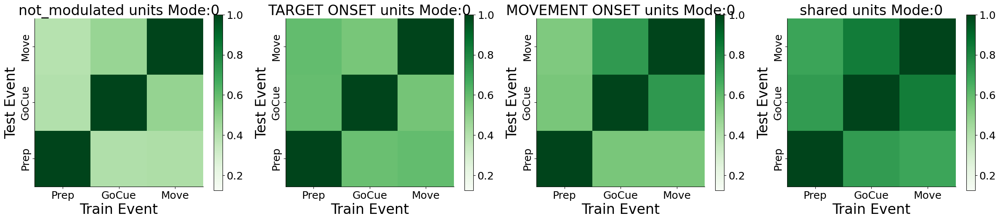

  0%|          | 0/4 [00:00<?, ?it/s]

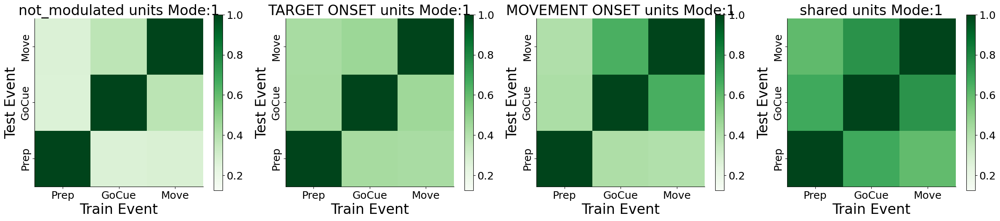

  0%|          | 0/4 [00:00<?, ?it/s]

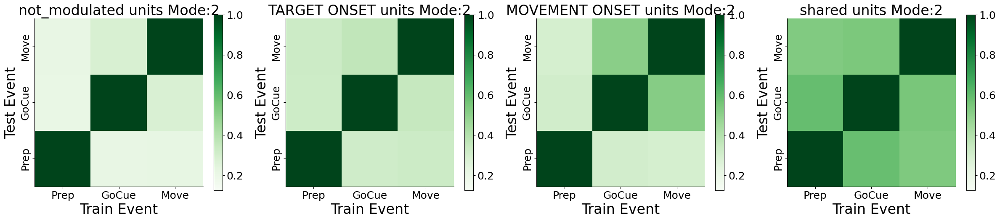

In [70]:
for ipc in range(nmodes_plot):
    fig, ax = plt.subplots(1,len(list(high_dec_groups.keys())),figsize=(6*len(list(high_dec_groups.keys())),5))
    for igroup, decoding_group in enumerate(tqdm(list(high_dec_groups.keys()))):
        im0 = ax[igroup].pcolor(np.mean(across_groups_and_events_alignment, axis=4)[igroup,:,:,ipc].T, cmap='Greens', vmin=0.125, vmax=1)
        ax[igroup].set(title=f'{decoding_group} units Mode:{ipc}', xlabel='Train Event', ylabel='Test Event')
        ax[igroup].set_aspect('equal')
        cb = plt.colorbar(im0)
        ax[igroup].set_xticks(np.arange(3)+.5, ['Prep', 'GoCue', 'Move'], fontsize=18)
        ax[igroup].set_yticks(np.arange(3)+.5, ['Prep', 'GoCue', 'Move'], rotation=90, va='center', fontsize=18)
    fig.tight_layout()
    plt.show()

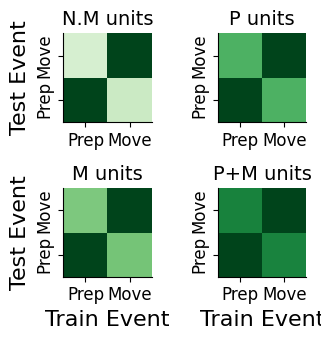

In [71]:
fig, ax = plt.subplots(2,2,figsize=(3.5,3.5))
# for igroup, decoding_group in enumerate(tqdm(list(high_dec_groups.keys()))):
im0 = ax[0,0].pcolor(np.mean(across_groups_and_events_alignment, axis=4)[0,:,:,0][[0,2],:][:,[0,2]].T, vmin=0.3, vmax=.8, cmap='Greens')
ax[0,0].set_title(f'N.M units', fontsize=14)
ax[0,0].set_ylabel('Test Event', fontsize=16)
ax[0,0].set_aspect('equal')
# cb = plt.colorbar(im0)
ax[0,0].set_xticks(np.arange(2)+.5, ['Prep', 'Move'], fontsize=12)
ax[0,0].set_yticks(np.arange(2)+.5, ['Prep', 'Move'], rotation=90, va='center', fontsize=12)

im0 = ax[0,1].pcolor(np.mean(across_groups_and_events_alignment, axis=4)[1,:,:,0][[0,2],:][:,[0,2]].T,vmin=0.3, vmax=.8, cmap='Greens')
ax[0,1].set_title(f'P units', fontsize=14)
ax[0,1].set_aspect('equal')
# cb = plt.colorbar(im0)
ax[0,1].set_xticks(np.arange(2)+.5, ['Prep', 'Move'], fontsize=12)
ax[0,1].set_yticks(np.arange(2)+.5, ['Prep', 'Move'], rotation=90, va='center', fontsize=12)

im0 = ax[1,0].pcolor(np.mean(across_groups_and_events_alignment, axis=4)[2,:,:,0][[0,2],:][:,[0,2]].T, vmin=0.3, vmax=.8, cmap='Greens')
ax[1,0].set_title(f'M units', fontsize=14)
ax[1,0].set_xlabel('Train Event', fontsize=16)
ax[1,0].set_ylabel('Test Event', fontsize=16)
ax[1,0].set_aspect('equal')
# cb = plt.colorbar(im0)
ax[1,0].set_xticks(np.arange(2)+.5, ['Prep', 'Move'], fontsize=12)
ax[1,0].set_yticks(np.arange(2)+.5, ['Prep', 'Move'], rotation=90, va='center', fontsize=12)

im0 = ax[1,1].pcolor(np.mean(across_groups_and_events_alignment, axis=4)[3,:,:,0][[0,2],:][:,[0,2]].T,vmin=0.3, vmax=.8, cmap='Greens')
ax[1,1].set_title(f'P+M units', fontsize=14)
ax[1,1].set_xlabel('Train Event', fontsize=16)
ax[1,1].set_aspect('equal')
# cb = plt.colorbar(im0)
ax[1,1].set_xticks(np.arange(2)+.5, ['Prep', 'Move'], fontsize=12)
ax[1,1].set_yticks(np.arange(2)+.5, ['Prep', 'Move'], rotation=90, va='center', fontsize=12)

fig.tight_layout()
aopy.visualization.savefig(base_save_dir, f'{subject}_{group}_acrros_event_group_dynamics_heatmap.svg')

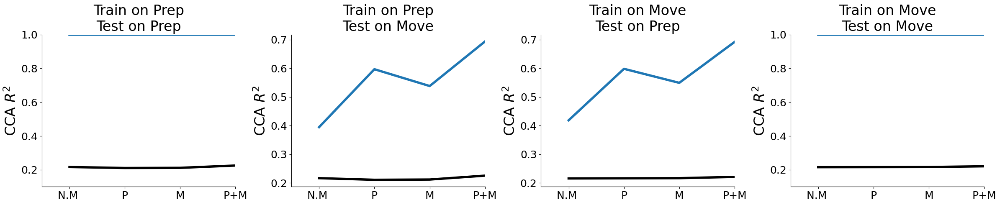

In [72]:
fig, ax = plt.subplots(1,len(list(high_dec_groups.keys())),figsize=(6*len(list(high_dec_groups.keys())),5))

ax[0].plot(np.mean(across_groups_and_events_alignment, axis=4)[:,0,0,0])
ax[0].plot(np.mean(across_events_alignment_random, axis=3)[:,0,1], color='k')
ax[0].set(ylabel='CCA $R^2$', title='Train on Prep\nTest on Prep', ylim=(0.1,1), xlim=(-0.5, 1.5))
ax[0].set_xticks(np.arange(4), ['N.M ','P','M', 'P+M'], fontsize=18)

ax[1].plot(np.mean(across_groups_and_events_alignment, axis=4)[:,0,2,0])
ax[1].plot(np.mean(across_events_alignment_random, axis=3)[:,0,1], color='k')
ax[1].set(ylabel='CCA $R^2$', title='Train on Prep\nTest on Move', xlim=(-0.5, 1.5))
ax[1].set_xticks(np.arange(4), ['N.M ','P','M', 'P+M'], fontsize=18)

ax[2].plot(np.mean(across_groups_and_events_alignment, axis=4)[:,2,0,0])
ax[2].plot(np.mean(across_events_alignment_random, axis=3)[:,2,1], color='k')
ax[2].set(ylabel='CCA $R^2$', title='Train on Move\nTest on Prep', ylim=ax[1].get_ylim(), xlim=(-0.5, 1.5))
ax[2].set_xticks(np.arange(4), ['N.M ','P','M', 'P+M'], fontsize=18)

ax[3].plot(np.mean(across_groups_and_events_alignment, axis=4)[:,2,2,0])
ax[3].plot(np.mean(across_events_alignment_random, axis=3)[:,2,1], color='k')
ax[3].set(ylabel='CCA $R^2$', title='Train on Move\nTest on Move', ylim=(0.1,1), xlim=(-0.5, 1.5))
ax[3].set_xticks(np.arange(4), ['N.M ','P','M', 'P+M'], fontsize=18)
# plt.suptitle(f"Mode: {ipc}")
fig.tight_layout()
plt.show()

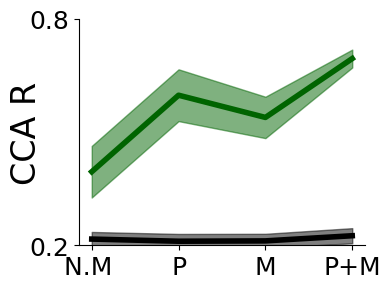

In [73]:
fig, ax = plt.subplots(1,1,figsize=(4,3))
ax.plot(np.mean(across_groups_and_events_alignment, axis=4)[:,0,2,0], color='darkgreen')
ax.fill_between(np.arange(4), np.mean(across_groups_and_events_alignment, axis=4)[:,0,2,0]-np.std(across_groups_and_events_alignment, axis=4)[:,0,2,0], np.mean(across_groups_and_events_alignment, axis=4)[:,0,2,0]+np.std(across_groups_and_events_alignment, axis=4)[:,0,2,0], alpha=0.5, color='darkgreen')

ax.plot(np.mean(across_events_alignment_random, axis=3)[:,0,1], color='k')
ax.fill_between(np.arange(4), np.mean(across_events_alignment_random, axis=3)[:,0,1]-np.std(across_events_alignment_random, axis=3)[:,0,1], np.mean(across_events_alignment_random, axis=3)[:,0,1]+np.std(across_events_alignment_random, axis=3)[:,0,1], alpha=0.5, color='black')
ax.set_ylabel('CCA R', labelpad=-10)
ax.set(ylim=(0.2,.8))
ax.set_xticks(np.arange(4), ['N.M ','P','M', 'P+M'], fontsize=18)
ax.set_yticks([0.2,0.8])
fig.tight_layout()
aopy.visualization.savefig(base_save_dir, f'{subject}_across_event_dynamics.svg')

#### Use Gallego approach to split units into tuned and untuned

In [74]:
align_event = align_events[-1]
ntargets = len(unique_targets)
ntrials = 320
mean_fr_per_cond = []
for irec in range(nrecs):
    if len(prep_data_all[align_event][irec]) > 0:
        mean_fr_per_cond_temp = np.zeros((prep_data_all[align_event][irec].shape[1], ntargets))*np.nan
        for itarg in range(ntargets):
            temp_target_idx = target_data_all[align_event][irec] == (itarg+1)
            mean_fr_per_cond_temp[:,itarg] = np.mean(prep_data_all[align_event][irec][temp_target_idx,:], axis=0)
        mean_fr_per_cond.append(mean_fr_per_cond_temp)
mean_fr_per_cond = np.concatenate(mean_fr_per_cond)

In [75]:
# Compute tuning
thetas = np.arange(ntargets)*45
fit_params, md, pd = aopy.analysis.tuning.run_tuningcurve_fit(mean_fr_per_cond, thetas)

In [76]:
# Compute R2 between fit curve and actual data
tuning_r2 = np.zeros(mean_fr_per_cond.shape[0])*np.nan
for iunit in range(mean_fr_per_cond.shape[0]):
    fit_curve = fit_params[iunit,0]*np.cos(thetas) + fit_params[iunit,1]*np.sin(thetas) + fit_params[iunit, 2]
    tuning_r2[iunit] = sklearn.metrics.r2_score(mean_fr_per_cond[iunit,:], fit_curve)

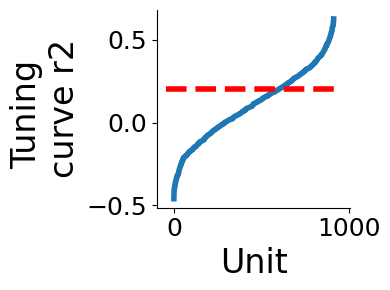

In [77]:
r2_thresh = 0.2
fig, ax = plt.subplots(1,1,figsize=(4,3))
ax.plot(tuning_r2[np.argsort(tuning_r2)])
ax.plot(ax.get_xlim(), [r2_thresh, r2_thresh], 'r--')
ax.set(xlabel='Unit', ylabel='Tuning \ncurve r2')
fig.tight_layout()
plt.show()

In [78]:
# Compute CCs the same way as Gallego paper
proj_data_all = {}
proj_data_untuned = {}
proj_data_tuned = {}

# for align_event in align_events:
all_prep_data = []
for irec in range(nrecs):
    if len(prep_data_all[align_event][irec]) > 0:
        all_prep_data.append(prep_data_all[align_event][irec])
all_prep_data = np.concatenate(all_prep_data, axis=1)

unit_mask_tuned = tuning_r2 > r2_thresh
unit_mask_untuned = np.argsort(tuning_r2)[:np.sum(unit_mask_tuned)]

proj_data_all[align_event] = PCA(svd_solver='full').fit_transform(all_prep_data[:,:]/np.std(all_prep_data[:,:],axis=0))
proj_data_tuned[align_event] = PCA(svd_solver='full').fit_transform(all_prep_data[:,unit_mask_tuned]/np.std(all_prep_data[:,unit_mask_tuned],axis=0))
proj_data_untuned[align_event] = PCA(svd_solver='full').fit_transform(all_prep_data[:,unit_mask_untuned]/np.std(all_prep_data[:,unit_mask_untuned],axis=0))

In [79]:
ccs_pp_tuning = canoncorr_gallego(proj_data_tuned[align_event][:,:npcs], proj_data_untuned[align_event][:,:npcs])
ccs_pp_tuning_tunedvall = canoncorr_gallego(proj_data_tuned[align_event][:,:npcs], proj_data_all[align_event][:,:npcs])
ccs_pp_tuning_untunedvall = canoncorr_gallego(proj_data_untuned[align_event][:,:npcs], proj_data_all[align_event][:,:npcs])

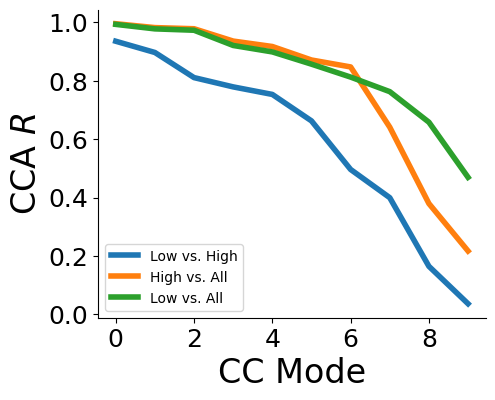

In [80]:
fig, ax = plt.subplots(1,1,figsize=(5,4))
ax.plot(ccs_pp_tuning)
ax.plot(ccs_pp_tuning_tunedvall)
ax.plot(ccs_pp_tuning_untunedvall)
ax.set(xlabel='CC Mode', ylabel='CCA $R$')
ax.legend(['Low vs. High', 'High vs. All', 'Low vs. All'])
plt.show()

#### Look at contributions to null space during prep and movement periods (ala shenoy 2014 paper)  

In [ ]:
# all_prep_data = {}
# for align_event in align_events:
#     all_prep_data_temp = []
#     for irec in range(nrecs):
#         if len(prep_data_all[align_event][irec]) > 0:
#             all_prep_data_temp.append(prep_data_all[align_event][irec])
#     all_prep_data[align_event] = np.concatenate(all_prep_data_temp, axis=1)

In [81]:
prep_event = align_events[0]
move_event = align_events[2]
prep_tavg = []
move_tavg = []
prep_tavg_array = np.concatenate([tavg_prep_data[prep_event][irec] for irec in range(len(tavg_prep_data[prep_event])) if len(tavg_prep_data[prep_event][irec])>0], axis=2)
move_tavg_array = np.concatenate([tavg_prep_data[move_event][irec] for irec in range(len(tavg_prep_data[move_event])) if len(tavg_prep_data[move_event][irec])>0], axis=2)
prep_tavg_array = (prep_tavg_array - np.mean(prep_tavg_array,axis=1)[:,None,:])
move_tavg_array = (move_tavg_array - np.mean(move_tavg_array,axis=1)[:,None,:])
for itarget in range(ntargets):
    prep_tavg.extend(prep_tavg_array[:,itarget,:])
    move_tavg.extend(move_tavg_array[:,itarget,:])
prep_tavg = np.array(prep_tavg)
move_tavg = np.array(move_tavg)
prep_pca = PCA(svd_solver='full').fit(prep_tavg/np.std(prep_tavg,axis=0))
move_pca = PCA(svd_solver='full').fit(move_tavg/np.std(move_tavg,axis=0))

In [82]:
prep_onto_prep = prep_pca.transform(prep_tavg/np.std(prep_tavg,axis=0))
prep_onto_move = move_pca.transform(prep_tavg/np.std(prep_tavg,axis=0))
move_onto_prep = prep_pca.transform(move_tavg/np.std(move_tavg,axis=0))
move_onto_move = move_pca.transform(move_tavg/np.std(move_tavg,axis=0))

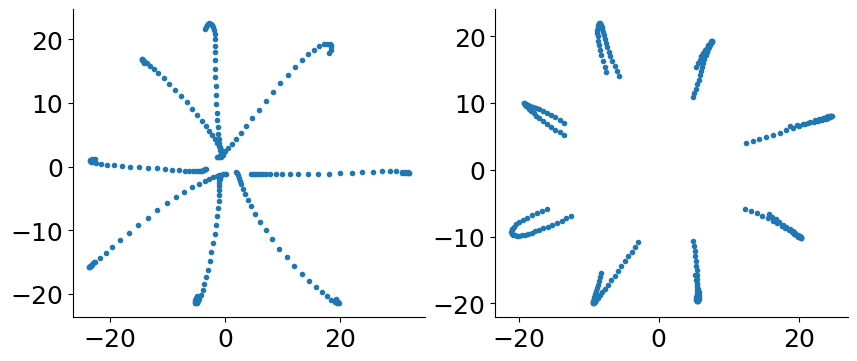

In [83]:
fig, ax = plt.subplots(1,2,figsize=(10,4))
ax[0].plot(prep_onto_prep[:,0], prep_onto_prep[:,1], '.')

ax[1].plot(move_onto_move[:,0], move_onto_move[:,1], '.')

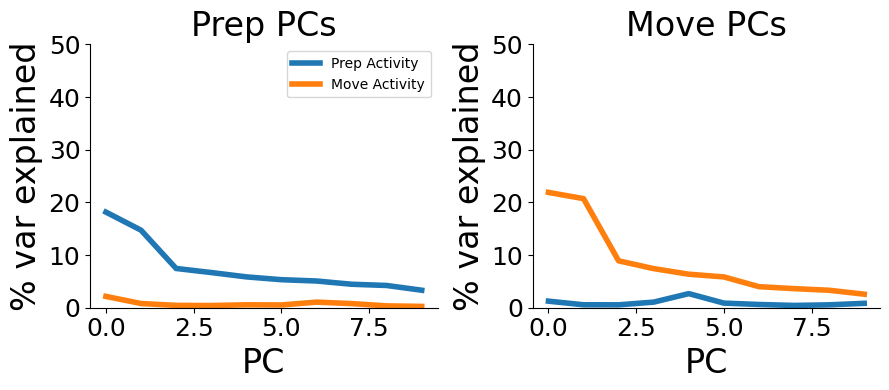

In [84]:
# Replicate Elsayed results
npcs = 10
fig, ax = plt.subplots(1,2,figsize=(9,4))
ax[0].plot(100*np.var(prep_onto_prep, axis=0)[:npcs]/np.sum(np.var(prep_onto_prep, axis=0)))
ax[0].plot(100*np.var(move_onto_prep, axis=0)[:npcs]/np.sum(np.var(move_onto_prep, axis=0)))
ax[0].set(xlabel='PC', ylabel='% var explained', title='Prep PCs', ylim=(0,50))
ax[0].legend(['Prep Activity', 'Move Activity'])

ax[1].plot(100*np.var(prep_onto_move, axis=0)[:npcs]/np.sum(np.var(prep_onto_move, axis=0)))
ax[1].plot(100*np.var(move_onto_move, axis=0)[:npcs]/np.sum(np.var(move_onto_move, axis=0)))
ax[1].set(xlabel='PC', ylabel='% var explained', title='Move PCs', ylim=(0,50))
fig.tight_layout()
plt.show()

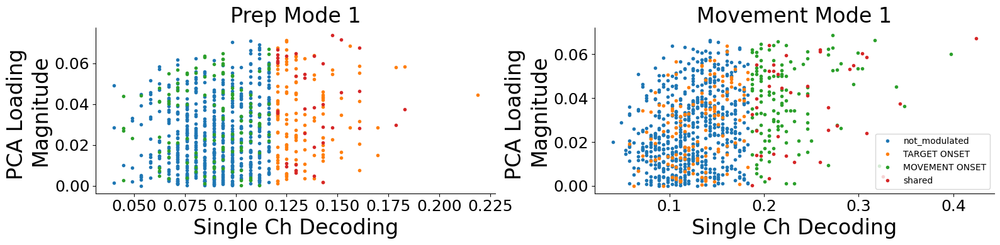

In [85]:
fig, ax = plt.subplots(1,2,figsize=(16,4))
for igroup, group_label in enumerate(list(high_dec_groups.keys())):
    ax[0].plot(np.array(single_ch_decoding[prep_event])[high_dec_groups[group_label]], np.abs(prep_pca.components_[0,high_dec_groups[group_label]]),'.', color=f"C{igroup}")
    ax[1].plot(np.array(single_ch_decoding[move_event])[high_dec_groups[group_label]], np.abs(move_pca.components_[0,high_dec_groups[group_label]]),'.', color=f"C{igroup}", label=f"{group_label}")

ax[0].set(xlabel='Single Ch Decoding', ylabel='PCA Loading \nMagnitude', title=f'Prep Mode {1}')
ax[1].set(xlabel='Single Ch Decoding', ylabel='PCA Loading \nMagnitude', title=f'Movement Mode {1}')
ax[1].legend()
fig.tight_layout()
plt.show()

In [86]:
# Regress top PCs onto cursor pos/velo to find output potent directions
kin_data_input = []
neural_data_input = []
for itarget in range(ntargets):
    
    kin_data_input.extend(np.mean(np.array([tavg_velo_data[move_event][irec] for irec in range(len(tavg_velo_data[move_event])) if len(tavg_velo_data[move_event][irec])>0]), axis=0)[:,itarget,:])
kin_data_input = np.array(kin_data_input)

subspace_units, recon_kin_units = calc_task_rel_dims(move_tavg, kin_data_input, fit_intercept=False)
trd_subspace, recon_kin = calc_task_rel_dims(move_onto_move[:,:4], kin_data_input, fit_intercept=True)

(240, 913) (240, 2)
(240, 4) (240, 3)


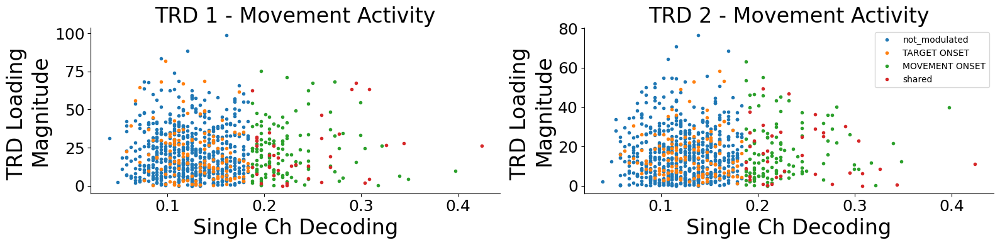

In [87]:
fig, ax = plt.subplots(1,2,figsize=(16,4))
for igroup, group_label in enumerate(list(high_dec_groups.keys())):
    # ax[0].plot(np.array(single_ch_decoding[prep_event])[high_dec_groups[group_label]], np.abs(subspace[0,high_dec_groups[group_label]]),'.', color=f"C{igroup}")
    ax[0].plot(np.array(single_ch_decoding[move_event])[high_dec_groups[group_label]], np.abs(subspace_units[high_dec_groups[group_label],0]),'.', color=f"C{igroup}", label=f"{group_label}")
    ax[1].plot(np.array(single_ch_decoding[move_event])[high_dec_groups[group_label]], np.abs(subspace_units[high_dec_groups[group_label],1]),'.', color=f"C{igroup}", label=f"{group_label}")

ax[0].set(xlabel='Single Ch Decoding', ylabel='TRD Loading \nMagnitude', title=f'TRD {1} - Movement Activity')
ax[1].set(xlabel='Single Ch Decoding', ylabel='TRD Loading \nMagnitude', title=f'TRD {2} - Movement Activity')
ax[1].legend()
fig.tight_layout()
plt.show()

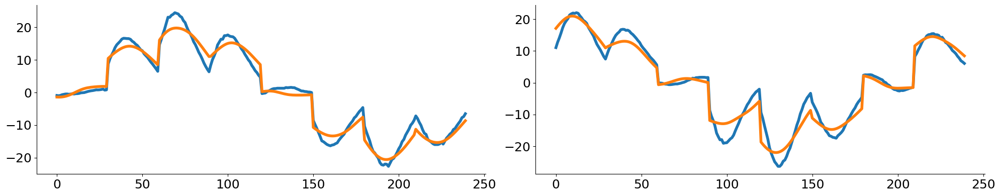

In [88]:
# Plot reconstructed kinematics to verify it worked
fig, ax = plt.subplots(1,2,figsize=(20,4))
ax[0].plot(kin_data_input[:,0])
ax[0].plot(recon_kin[0][:,-2])
ax[1].plot(kin_data_input[:,1])
ax[1].plot(recon_kin[0][:,-1])
fig.tight_layout()
plt.show()

In [89]:
## Project prep and move activity onto move TRD - Replicate Shenoy 2014 results
print(trd_subspace.shape, prep_onto_move[:,2].shape)
trd_null_space = scipy.linalg.null_space(trd_subspace[:,1:].T, rcond=2)
prep_onto_trd = prep_onto_move[:,:4] @ trd_subspace[:,1:]
prep_onto_null = prep_onto_move[:,:4] @ trd_null_space
trd_null_space.shape

(4, 3) (240,)


(4, 4)

In [90]:
prep_onto_trd.shape, trd_subspace.shape

((240, 2), (4, 3))

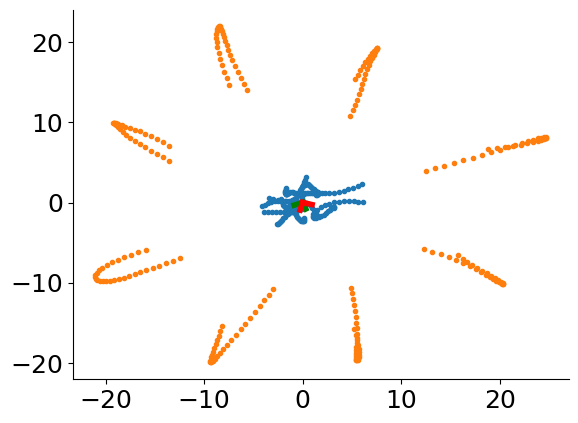

In [91]:
plt.plot(prep_onto_move[:,0], prep_onto_move[:,1], '.')
plt.plot(move_onto_move[:,0], move_onto_move[:,1], '.')
plt.plot([0,trd_subspace[0,1]], [0,trd_subspace[0,2]], 'g')
plt.plot([0,trd_subspace[1,1]], [0,trd_subspace[1,2]], 'g')
plt.plot([0,trd_null_space[0,0]], [0,trd_null_space[0,1]], 'r')
plt.plot([0,trd_null_space[1,0]], [0,trd_null_space[1,1]], 'r')

In [92]:
prep_onto_null.shape, np.var(prep_onto_trd, axis=0)[:npcs], np.var(prep_onto_null, axis=0)[:npcs], np.var(prep_onto_move[:,:2], axis=0)

((240, 4),
 array([1.22755685, 3.37253262]),
 array([1.40386601, 4.31424635, 1.51659953, 2.10486589]),
 array([3.4044486 , 1.52695418]))

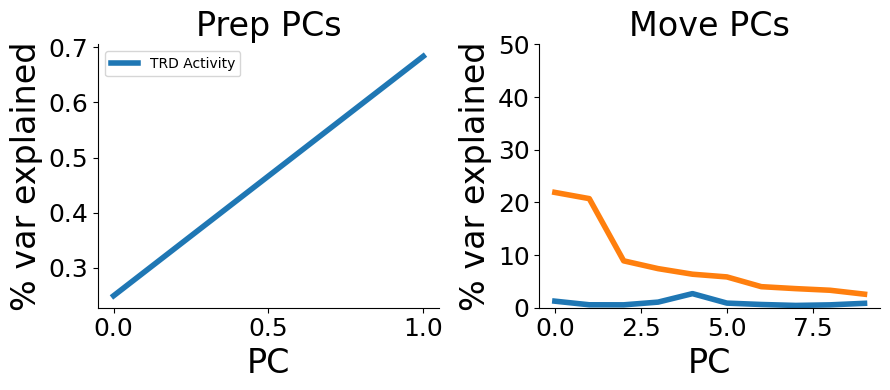

In [93]:
# Replicate Elsayed results
npcs = 10
fig, ax = plt.subplots(1,2,figsize=(9,4))
ax[0].plot(np.var(prep_onto_trd, axis=0)[:npcs]/np.sum(np.var(prep_onto_move[:,:2], axis=0)))
# ax[0].plot(np.var(prep_onto_null, axis=0)[:npcs]/np.sum(np.var(prep_onto_move, axis=0)))
ax[0].set(xlabel='PC', ylabel='% var explained', title='Prep PCs')
ax[0].legend(['TRD Activity', 'Null Activity'])

ax[1].plot(100*np.var(prep_onto_move, axis=0)[:npcs]/np.sum(np.var(prep_onto_move, axis=0)))
ax[1].plot(100*np.var(move_onto_move, axis=0)[:npcs]/np.sum(np.var(move_onto_move, axis=0)))
ax[1].set(xlabel='PC', ylabel='% var explained', title='Move PCs', ylim=(0,50))
fig.tight_layout()
plt.show()

In [94]:
# Repeat for different groups of units
nunits_per_group = 50
prep_onto_prep_groups_var_ratio = np.zeros((len(list(high_dec_groups.keys())), npcs, niterations))*np.nan
prep_onto_move_groups_var_ratio = np.zeros((len(list(high_dec_groups.keys())), npcs, niterations))*np.nan
move_onto_prep_groups_var_ratio = np.zeros((len(list(high_dec_groups.keys())), npcs, niterations))*np.nan
move_onto_move_groups_var_ratio = np.zeros((len(list(high_dec_groups.keys())), npcs, niterations))*np.nan
for igroup, group_label in enumerate(tqdm(list(high_dec_groups.keys()))):
    for iiter in range(niterations):
        unit_idx = np.random.choice(np.where(high_dec_groups[group_label])[0], nunits_per_group, replace=False)
        
        prep_tavg_group = []
        move_tavg_group = []
        prep_tavg_group_array = np.concatenate([tavg_prep_data[prep_event][irec] for irec in range(len(tavg_prep_data[prep_event])) if len(tavg_prep_data[prep_event][irec])>0], axis=2)[:,:,unit_idx]
        move_tavg_group_array = np.concatenate([tavg_prep_data[move_event][irec] for irec in range(len(tavg_prep_data[move_event])) if len(tavg_prep_data[move_event][irec])>0], axis=2)[:,:,unit_idx]
        prep_tavg_group_array = (prep_tavg_group_array - np.mean(prep_tavg_group_array,axis=1)[:,None,:])
        move_tavg_group_array = (move_tavg_group_array - np.mean(move_tavg_group_array,axis=1)[:,None,:])
        for itarget in range(ntargets):
            prep_tavg_group.extend(prep_tavg_group_array[:,itarget,:])
            move_tavg_group.extend(move_tavg_group_array[:,itarget,:])
        prep_tavg_group = np.array(prep_tavg_group)
        move_tavg_group = np.array(move_tavg_group)
        
        prep_pca = PCA(svd_solver='full').fit(prep_tavg_group/np.std(prep_tavg_group,axis=0)) # Use only top 2 prep pcs (from Elsayed paper)
        move_pca = PCA(svd_solver='full').fit(move_tavg_group/np.std(move_tavg_group,axis=0)) # Use only top 4 move pcs (From Elsayed paper)

        prep_onto_prep_groups_var_ratio[igroup, :, iiter] = 100*np.var(prep_pca.transform(prep_tavg_group), axis=0)[:npcs]/np.sum(np.var(prep_pca.transform(prep_tavg_group), axis=0))
        prep_onto_move_groups_var_ratio[igroup, :, iiter] = 100*np.var(move_pca.transform(prep_tavg_group), axis=0)[:npcs]/np.sum(np.var(move_pca.transform(prep_tavg_group), axis=0))
        move_onto_prep_groups_var_ratio[igroup, :, iiter] = 100*np.var(prep_pca.transform(move_tavg_group), axis=0)[:npcs]/np.sum(np.var(prep_pca.transform(move_tavg_group), axis=0))
        move_onto_move_groups_var_ratio[igroup, :,iiter] = 100*np.var(move_pca.transform(move_tavg_group), axis=0)[:npcs]/np.sum(np.var(move_pca.transform(move_tavg_group), axis=0))

  0%|          | 0/4 [00:00<?, ?it/s]

ValueError: Cannot take a larger sample than population when 'replace=False'

In [ ]:
# Replicate Elsayed results
for igroup, group_name in enumerate(list(high_dec_groups.keys())):
    npcs = 10
    fig, ax = plt.subplots(1,2,figsize=(9,4))
    ax[0].plot(np.mean(prep_onto_prep_groups_var_ratio, axis=2)[igroup,:])
    ax[0].plot(np.mean(move_onto_prep_groups_var_ratio, axis=2)[igroup,:])
    ax[0].set(xlabel='PC', ylabel='% var explained', title='Prep PCs', ylim=(0,50))
    ax[0].legend(['Prep Activity', 'Move Activity'])

    ax[1].plot(np.mean(prep_onto_move_groups_var_ratio, axis=2)[igroup,:])
    ax[1].plot(np.mean(move_onto_move_groups_var_ratio, axis=2)[igroup,:])
    ax[1].set(xlabel='PC', ylabel='% var explained', title='Move PCs', ylim=(0,50))
    plt.suptitle(f"{group_name}")
    fig.tight_layout()
    plt.show()

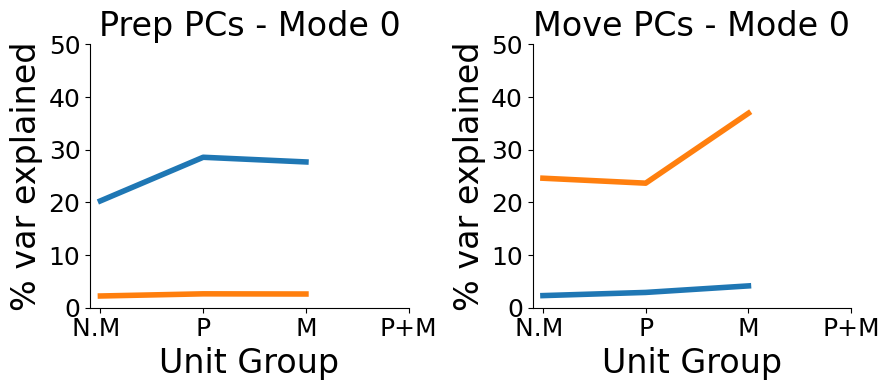

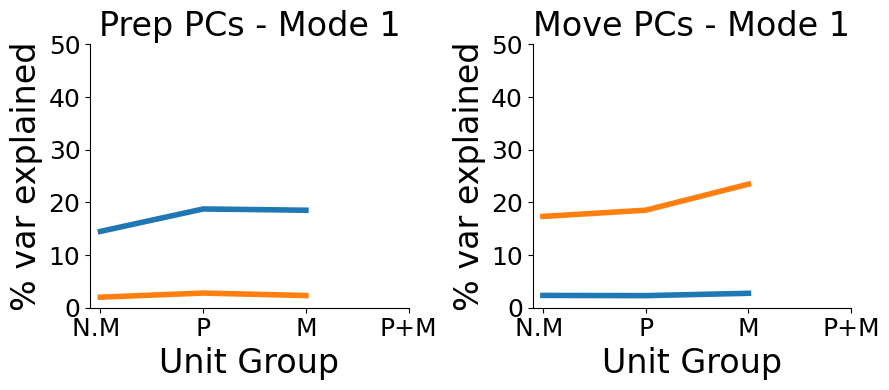

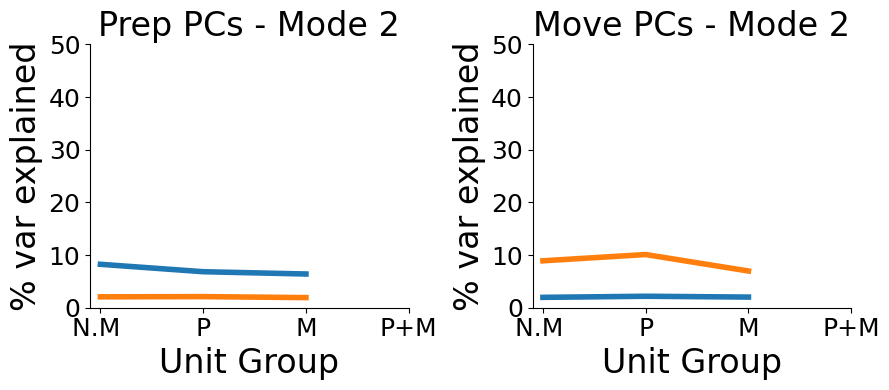

In [95]:
temp_plt_array_mean = np.mean(np.array([prep_onto_prep_groups_var_ratio, prep_onto_move_groups_var_ratio, move_onto_prep_groups_var_ratio, move_onto_move_groups_var_ratio]), axis=3)
temp_plt_array_sd = np.std(np.array([prep_onto_prep_groups_var_ratio, prep_onto_move_groups_var_ratio, move_onto_prep_groups_var_ratio, move_onto_move_groups_var_ratio]), axis=3)
for ipc in range(nmodes_plot):
    fig, ax = plt.subplots(1,2,figsize=(9,4))
    ax[0].plot(temp_plt_array_mean[:2,:,ipc].T)
    ax[1].plot(temp_plt_array_mean[2:,:,ipc].T)
    ax[0].set_xticks(np.arange(4), ['N.M ','P','M', 'P+M'], fontsize=18), ax[1].set_xticks(np.arange(4), ['N.M ','P','M', 'P+M'], fontsize=18)
    ax[0].set(xlabel='Unit Group', ylabel='% var explained', title=f'Prep PCs - Mode {ipc}', ylim=(0,50))
    ax[1].set(xlabel='Unit Group', ylabel='% var explained', title=f'Move PCs - Mode {ipc}', ylim=(0,50))
    fig.tight_layout()
    plt.show()

### TRD projection alignment

In [ ]:
# ntrd = 2
# fig, ax = plt.subplots(1, ntrd, figsize=(ntrd*10, 5.5))
# for ipc in range(ntrd):
#     im = ax[ipc].pcolor(ccs_trd[:,:,ipc], vmin=0.5, vmax=1)
#     cb = plt.colorbar(im)
#     ax[ipc].set_xticks(np.arange(nrecs)+0.5, recording_site)
#     ax[ipc].set_yticks(np.arange(nrecs)+0.5, recording_site)
#     ax[ipc].set(xlabel='Recording Site', ylabel='Recording Site', title=f"CC: {ipc+1}")

In [ ]:
# # Plot subspace angle for each site:
# trd_subspace_angle = np.zeros(nrecs)*np.nan
# for irec in range(nrecs):
#     if len(trd_subspace[irec]) > 0:
#         if trd_subspace[irec].shape[0] > npcs:
#             trd_subspace_angle[irec] = np.rad2deg(scipy.linalg.subspace_angles(trd_subspace[irec][:,1][:,None], trd_subspace[irec][:,2][:,None]))

In [ ]:
# for align_event in align_events:
#     np_acc_arg_sort = np.argsort(np.array(max_np_decoding[align_event]))
#     fig, ax = plt.subplots(1,2, figsize=(14,5))
#     ax[0].plot(np.arange(nrecs), trd_subspace_angle,'.', markersize=20)
#     ax[0].set_xticks(np.arange(nrecs), recording_site, rotation=90)
#     ax[0].set(xlabel='Recording Site', ylabel='TRD 1vs.2 [deg]')
    
#     ax[1].plot(np.array(max_np_decoding[align_event])[np_acc_arg_sort], trd_subspace_angle[np_acc_arg_sort],'.', markersize=20)
#     ax[1].set(xlabel='NP Decoding', ylabel='TRD 1vs.2 [deg]')

#     fig.tight_layout()

In [ ]:
# for align_event in align_events:
#     fig, ax = plt.subplots(1, ntrd, figsize=(ntrd*6, 5))
#     np_acc_arg_sort = np.argsort(np.array(max_np_decoding[align_event]))
#     for ipc in range(ntrd):
#         good_nan_mask = np.sum(np.isnan(ccs_trd[np_acc_arg_sort,:,:][:,np_acc_arg_sort,ipc]), axis=0) < nrecs
#         input_array = ccs_trd[np_acc_arg_sort,:,:][:,np_acc_arg_sort,ipc]
#         im = ax[ipc].pcolor(input_array[good_nan_mask,:][:,good_nan_mask], vmin=0.5, vmax=1)
#         # im = ax[ipc].pcolor(input_array[good_nan_mask,:][:,good_nan_mask], vmin=0, vmax=1)
#         cb = plt.colorbar(im)
#         ax[ipc].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(np.array(max_np_decoding[align_event])[np_acc_arg_sort][good_nan_mask][::2], 2), rotation = 90)
#         ax[ipc].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, np.round(np.array(recording_site)[np_acc_arg_sort][good_nan_mask], 2), fontsize=10)
#         ax[ipc].set(xlabel='Neuropixel Decoding', ylabel='Neuropixel Decoding')

#         ax[ipc].set_title(f"Mode: {ipc+1}")
#         ax[ipc].set_aspect('equal')
#     plt.suptitle(f"{align_event}")
#     fig.tight_layout()
#     plt.show()

In [ ]:
# # Sort by caudal to rostral
# cr_sort = np.argsort(ecog_dec_acc[subject]['rc_axis'][:,0])
# # cr_sort = cr_sort[np.logical_and(cr_sort != 0, cr_sort!=3)]
# fig, ax = plt.subplots(1, ntrd, figsize=(ntrd*5.5,5))
# for ipc in range(ntrd):
#     good_nan_mask = np.sum(np.isnan(ccs_trd[cr_sort,:,:][:,cr_sort,ipc]), axis=0) < nrecs
#     input_array = ccs_trd[cr_sort,:,:][:,cr_sort,ipc]
#     im = ax[ipc].pcolor(input_array[good_nan_mask,:][:,good_nan_mask], vmin=.3, vmax=1)
#     cb = plt.colorbar(im)
#     # ax[ipc].set_yticks(np.arange(nrecs)+0.5, recording_site[cr_sort], rotation = 30)
#     ax[ipc].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(ecog_dec_acc[subject]['rc_axis'][:,0][cr_sort][good_nan_mask][::2], 1), rotation = 90)
#     # ax[ipc].set_xticks(np.arange(len(cr_sort), step=2)+0.5, np.arange(np.sum(mask),step=2)+1)
#     ax[ipc].set_yticks([],[])
#     ax[ipc].set(xlabel='Site X-pos [mm]')
#     ax[ipc].set_aspect('equal')
    
#     if ipc == 0:
#         ax[ipc].set_ylabel('Site X-pos [mm]')
#         # ax[ipc].set_yticks(np.arange(np.sum(mask), step=2)+0.5, np.arange(np.sum(mask), step=2)+1)
#         # ax[ipc].set_yticks(np.arange(len(cr_sort),step=2)+0.5, np.round(ecog_dec_acc[subject]['rc_axis'][:,0][cr_sort][::2], 1))
#         ax[ipc].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, recording_site[cr_sort][good_nan_mask])
#     elif ipc == npcs-1:
#         cb = plt.colorbar(im)    
#     ax[ipc].set_title(f'Mode {ipc+1}')
        
# fig.tight_layout()
# # aopy.visualization.savefig(base_save_dir, f'cc_rostral_caudal.svg')

In [ ]:
# # Sort by medial to lateral
# cr_sort = np.argsort(ecog_dec_acc[subject]['rc_axis'][:,1])
# fig, ax = plt.subplots(1, 3, figsize=(npcs*3, 5))
# for ipc in range(ntrd):
#     im = ax[ipc].pcolor(ccs_trd[cr_sort,:,:][:,cr_sort,ipc], vmin=0.1, vmax=1)
#     cb = plt.colorbar(im)
#     ax[ipc].set_yticks(np.arange(nrecs)+0.5, recording_site[cr_sort], rotation = 30)
#     ax[ipc].set_xticks(np.arange(nrecs)+0.5, np.round(ecog_dec_acc[subject]['rc_axis'][:,1][cr_sort], 2), rotation = 60)
#     ax[ipc].set(xlabel='Medial - Lateral Position', ylabel='Recording Site Number', title=f"PC: {ipc+1}")
#     ax[ipc].set_aspect('equal')

In [ ]:

# fig, ax = plt.subplots(1,ntrd,figsize=(4*ntrd,4))
# pos_diff = np.zeros((ccs.shape[0], ccs.shape[1]))*np.nan
# pos_labels = np.zeros((ccs.shape[0], ccs.shape[1],2))*np.nan
# for irec1 in range(ccs.shape[0]):
#     for irec2 in range(ccs.shape[1]):
#         if irec1 != irec2:
#             pos_diff[irec1,irec2] = np.abs(ecog_dec_acc[subject]['rc_axis'][irec1,0] - ecog_dec_acc[subject]['rc_axis'][irec2,0])
#             pos_labels[irec1,irec2,0] = irec1
#             pos_labels[irec1,irec2,1] = irec2
# slopes = []
# intercepts = []
# for ipc in range(ntrd):
#     nan_mask = np.logical_and(~np.isnan(pos_diff.flatten()), ~np.isnan(ccs_trd[:,:,ipc].flatten()))
#     fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(pos_diff.flatten()[nan_mask], ccs_trd[:,:,ipc].flatten()[nan_mask])
#     intercept = regfit.intercept_
#     intercepts.append(intercept)
#     slope = regfit.coef_[0]
#     slopes.append(slope)
#     ax[ipc].plot(pos_diff.flatten(), ccs_trd[:,:,ipc].flatten(),'.')
#     ax[ipc].plot([0,10], [intercept, slope*10 + intercept], 'k')
#     ax[ipc].set(xlabel='$\Delta$ Ros-Caud Position', ylabel='Correlation')
#     ax[ipc].set(title=f"CC{ipc+1} p={np.round(pval,3)}")
# fig.tight_layout()
# plt.show()

In [ ]:
# for align_event in align_events:
#     fig, ax = plt.subplots(1,ntrd,figsize=(ntrd*5,5))
#     np_acc_arg_sort = np.argsort(max_np_decoding[align_event])
#     dec_diff = np.zeros((ccs.shape[0], ccs.shape[1]))*np.nan
#     for irec1 in range(ccs.shape[0]):
#         for irec2 in range(ccs.shape[1]):
#             if irec1 != 0 and irec2 != 0 and irec1 != irec2:
#                 dec_diff[irec1,irec2] = np.abs(max_np_decoding[align_event][irec1] - max_np_decoding[align_event][irec2]) 

#     for ipc in range(ntrd):
#         dec_diff_map = ax[ipc].scatter(100*dec_diff.flatten(), ccs_trd[:,:,ipc].flatten(),s=50, c='black')
#         for ipt in range(len(dec_diff.flatten())):
#             dec_diff_map = ax[ipc].scatter(100*dec_diff.flatten()[ipt], ccs_trd[:,:,ipc].flatten()[ipt],s=50, c='black')

#         nan_mask = np.logical_and(~np.isnan(dec_diff.flatten()), ~np.isnan(ccs_trd[:,:,ipc].flatten()))
#         fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(100*dec_diff.flatten()[nan_mask], ccs_trd[:,:,ipc].flatten()[nan_mask])
#         intercept = regfit.intercept_
#         # intercepts.append(intercept)
#         slope = regfit.coef_[0]
#         # slopes.append(slope)
#         ax[ipc].annotate(f'p={np.round(pval,2)}',(20,.65), fontsize=24, color=(0.5,0.5,0.5))
#         ax[ipc].annotate(f'$R^2$={np.round(fitscore,2)}',(20,.7), fontsize=24, color=(0.5,0.5,0.5))

#         ax[ipc].plot([0,30], [intercept, slope*10 + intercept], color=(0.5, 0.5, 0.5))
#         # ax[ipc].set_yticks([])
#         ax[ipc].set(title=f"Mode {ipc+1}")
#         if ipc == 0:
#             # ax[ipc].set_yticks([0,.5,1])
#             ax[ipc].set(ylabel='Correlation')
#         if ipc == 1:
#             ax[ipc].set(xlabel=f'Neuropixel Decoding Difference [%]')
#         plt.suptitle(f"{align_event}")
#     fig.tight_layout()
#     plt.show()
#     # aopy.visualization.savefig(base_save_dir, f'cca_cc_delta_dec.svg')

In [ ]:
# fig, ax = plt.subplots(1,ntrd,figsize=(ntrd*5,5))
# avg_pos = np.zeros((ccs_trd.shape[0], ccs_trd.shape[1]))*np.nan
# # pos_labels = np.zeros((ccs_trd.shape[0], ccs_trd.shape[1],2))*np.nan
# for irec1 in range(ccs_trd.shape[0]):
#     for irec2 in range(ccs_trd.shape[1]):
#         if irec1 != irec2:
#             avg_pos[irec1,irec2] = np.mean([ecog_dec_acc[subject]['rc_axis'][irec1,0], ecog_dec_acc[subject]['rc_axis'][irec2,0]])

# for ipc in range(ntrd):
#     # ax[ipc].plot(100*dec_diff.flatten(), ccs[:,:,ipc].flatten(),'k.', markersize=10)
#     dec_diff_map = ax[ipc].scatter(100*dec_diff.flatten(), ccs_trd[:,:,ipc].flatten(),s=50, c=avg_pos.flatten(), cmap='plasma')
#     if ipc == ntrd-1:
#         cb = plt.colorbar(dec_diff_map, label='Average RC Position')
#     ax[ipc].set_yticks([])
#     ax[ipc].set(xlabel='Decoding \n Difference [%]', title=f"CC{ipc+1}", ylim=(0.0,1.05))
#     if ipc == 0:
#         ax[ipc].set_yticks([0,.5,1])
#         ax[ipc].set(ylabel='Correlation')
        
#     # elif ipc == npcs-1:
#     #     cb = plt.colorbar(dec_diff_map, label='X-Position \n Difference [mm]')
# fig.tight_layout()
# # aopy.visualization.savefig(base_save_dir, f'cca_cc_delta_dec_colored.svg')

In [ ]:
# for align_event in align_events:
#     #     fig, ax = plt.subplots(1,ntrd,figsize=(ntrd*5,5))
#     # np_acc_arg_sort = np.argsort(max_np_decoding[align_event])
#     # dec_diff = np.zeros((ccs.shape[0], ccs.shape[1]))*np.nan
#     # for irec1 in range(ccs.shape[0]):
#     #     for irec2 in range(ccs.shape[1]):
#     #         if irec1 != 0 and irec2 != 0 and irec1 != irec2:
#                 # dec_diff[irec1,irec2] = np.abs(max_np_decoding[align_event][irec1] - max_np_decoding[align_event][irec2]) 
#     fig, ax = plt.subplots(1,ntrd,figsize=(ntrd*5,5))
#     ecog_diff = np.zeros((ccs.shape[0], ccs.shape[1]))*np.nan
#     for irec1 in range(ccs.shape[0]):
#         for irec2 in range(ccs.shape[1]):
#             if irec1 != 0 and irec2 != 0 and irec1 != 3 and irec2 != 3 and irec1 != irec2:
#                 irec1_ecog = ecog_dec_acc_rec_site[align_events[-1]][irec1]/np.max(ecog_dec_acc_rec_site[align_events[-1]])
#                 irec2_ecog = ecog_dec_acc_rec_site[align_events[-1]][irec2]/np.max(ecog_dec_acc_rec_site[align_events[-1]])
#                 ecog_diff[irec1,irec2] = np.abs(irec1_ecog - irec2_ecog) 

#     for ipc in range(ntrd):
#         dec_diff_map = ax[ipc].scatter(ecog_diff.flatten(), ccs_trd[:,:,ipc].flatten(),s=50, c='black')
#         for ipt in range(len(ecog_diff.flatten())):
#             dec_diff_map = ax[ipc].scatter(ecog_diff.flatten()[ipt], ccs_trd[:,:,ipc].flatten()[ipt],s=50, c='black')

#         nan_mask = np.logical_and(~np.isnan(ecog_diff.flatten()), ~np.isnan(ccs_trd[:,:,ipc].flatten()))
#         fit, fitscore, pcc, pval, regfit = aopy.analysis.base.linear_fit_analysis2D(ecog_diff.flatten()[nan_mask], ccs_trd[:,:,ipc].flatten()[nan_mask])
#         intercept = regfit.intercept_
#         slope = regfit.coef_[0]
#         ax[ipc].annotate(f'p={np.round(pval,2)}',(.20,.05), fontsize=24, color=(0.5,0.5,0.5))
#         ax[ipc].annotate(f'$R^2$={np.round(fitscore,2)}',(.20,.15), fontsize=24, color=(0.5,0.5,0.5))

#         ax[ipc].plot([0,1], [intercept, slope + intercept], color=(0.5, 0.5, 0.5))
#         ax[ipc].set(title=f"Mode {ipc+1}")
#         if ipc == 0:
#             ax[ipc].set_yticks([0,.5,1])
#             ax[ipc].set(ylabel='Correlation', ylim=(0,1.05))
#         if ipc == 1:
#             ax[ipc].set(xlabel='ECoG Response Difference [%]')
#         # elif ipc == npcs-1:
#         #     cb = plt.colorbar(dec_diff_map, label='X-Position \n Difference [mm]')
#     fig.tight_layout()
#     plt.show()
#     # aopy.visualization.savefig(base_save_dir, f'cca_cc_delta_dec.svg')

## Decoding in different PCs

### Linear regression decoder

In [165]:
# Gallego paper used Wiener filters with 3 bins (90ms) - decoded velocity - 10 dimensions

In [ ]:
# Use data projected into same-day PCs to train
nlags = 4
niterations = 100
within_day_decoding = {}
within_day_decoding_tidx1 = {}
within_day_decoding_tidx2 = {}
cca_decoding_kin_data = {}
for align_event in align_events:
    within_day_decoding[align_event] = np.zeros((nrecs))*np.nan
    within_day_decoding_tidx1[align_event] = np.zeros((nrecs))*np.nan
    within_day_decoding_tidx2[align_event] = np.zeros((nrecs))*np.nan
    
    # cca_decoding_kin_data = velo_data_all
    cca_decoding_kin_data[align_event] = pos_data_all[align_event]

    # Train on day 1
    for irec in range(nrecs):
        if len(proj_data[align_event][irec]) > 0:
            subspace, kin_recon = weiner_filter(proj_data[align_event][irec][:,:npcs], cca_decoding_kin_data[align_event][irec], regularization=None, alpha=10000, lags=nlags, fit_intercept=False)
            r2x = sklearn.metrics.r2_score(cca_decoding_kin_data[align_event][irec][nlags:,0], kin_recon[:,0])
            r2y = sklearn.metrics.r2_score(cca_decoding_kin_data[align_event][irec][nlags:,1], kin_recon[:,1])
            within_day_decoding[align_event][irec] = np.mean([r2x, r2y])

            # Compute for split data - first half
            subspace, kin_recon = weiner_filter(proj_data[align_event][irec][tidx1,:npcs], cca_decoding_kin_data[align_event][irec][tidx1,:], regularization=None, alpha=10000, lags=nlags, fit_intercept=False)
            r2xtidx1 = sklearn.metrics.r2_score(cca_decoding_kin_data[align_event][irec][tidx1,0][nlags:], kin_recon[:,0])
            r2ytidx1 = sklearn.metrics.r2_score(cca_decoding_kin_data[align_event][irec][tidx1,1][nlags:], kin_recon[:,1])
            within_day_decoding_tidx1[align_event][irec] = np.mean([r2xtidx1, r2ytidx1])

            # Compute for split data - second half
            subspace, kin_recon = weiner_filter(proj_data[align_event][irec][tidx2,:npcs], cca_decoding_kin_data[align_event][irec][tidx2,:], regularization=None, alpha=10000, lags=nlags, fit_intercept=False)
            r2xtidx2 = sklearn.metrics.r2_score(cca_decoding_kin_data[align_event][irec][tidx2,0][nlags:], kin_recon[:,0])
            r2ytidx2 = sklearn.metrics.r2_score(cca_decoding_kin_data[align_event][irec][tidx2,1][nlags:], kin_recon[:,1])
            within_day_decoding_tidx2[align_event][irec] = np.mean([r2xtidx2, r2ytidx2])


            print(f"{irec} Site: {recording_site[irec]}", np.round(r2x, 3), np.round(r2y,3), np.round(np.mean([r2x, r2y]),3),  np.round(np.mean([r2xtidx1, r2ytidx1]),3),  np.round(np.mean([r2xtidx2, r2ytidx2]),3))

In [ ]:
fig, ax = plt.subplots(1,len(align_events), figsize=(6*len(align_events),4))
for ievent, align_event in enumerate(align_events):
    ax[ievent].plot(within_day_decoding[align_event], label='All Time')
    ax[ievent].plot(within_day_decoding_tidx2[align_event], label='Second Half')
    ax[ievent].plot(within_day_decoding_tidx1[align_event], label='First Half')

    ax[ievent].set(xlabel='Recording Site', ylabel='R2', title=f"{align_event}", ylim=(-0.1, 1))
    ax[ievent].legend()
plt.show()

In [ ]:
# # Test CCA decoding/transformation on data from the same day split in time with linear regression
# # Decode using CCA transformation 
# same_day_align_R = np.zeros((nrecs, npcs))*np.nan
# same_day_aligned_decoding = np.zeros((nrecs))*np.nan
# same_day_aligned_decoding_x = np.zeros((nrecs))*np.nan
# same_day_aligned_decoding_y = np.zeros((nrecs))*np.nan
# same_day_aligned_dynamics = []

# for irec in range(nrecs):
#     if len(proj_data[irec]) > 0 and proj_data[irec].shape[1] >= npcs:
#         La = proj_data_tidx1[irec][:,:npcs]
#         Lb = proj_data_tidx2[irec][:,:npcs]
#         ntime_split = proj_data[irec].shape[0]//2

#         # Align data
#         # Ma, Mb, S = compute_CCA(La, Lb)
#         Ma, Mb, S, U, V = canoncorr_gallego(La, Lb, fullReturn=True)
#         same_day_align_R[irec,:npcs] =S[:npcs]
#         # same_day_align_proj_data = Lb @ Mb @ np.linalg.pinv(Ma) # Only project onto the first npc planes
#         # same_day_align_proj_data = La @ Ma @ np.linalg.pinv(Mb) # Only project onto the first npc planes

#        # Train decoder using baseline site dynamics projected onto the shared dimensions
#         same_day_aligned_subspace, kin_recon = weiner_filter(U, cca_decoding_kin_data[irec][tidx1,:], regularization=None, alpha=.00001, lags=nlags, fit_intercept=False)

#         # Test decoder using new site dynamics projected onto baseline laten tdynamics
#         aligned_dynamics = make_lagged_matrix(V, nlags) @ same_day_aligned_subspace
#         same_day_aligned_dynamics.append(aligned_dynamics)

#         # Compute R2 metrics
#         r2x = sklearn.metrics.r2_score(cca_decoding_kin_data[irec][tidx2[nlags:],0], aligned_dynamics[:,0])
#         r2y = sklearn.metrics.r2_score(cca_decoding_kin_data[irec][tidx2[nlags:],1], aligned_dynamics[:,1])
#         print(r2x, r2y)
#         same_day_aligned_decoding_x[irec] = np.mean(r2x)
#         same_day_aligned_decoding_y[irec] = np.mean(r2y)
#         same_day_aligned_decoding[irec] = np.mean([r2x, r2y])

#     else:
#         same_day_aligned_dynamics.append([])

In [ ]:
# stop_idx=500
# irec = 14
# fig, ax = plt.subplots(2,1,figsize=(20,7))
# ax[0].plot(cca_decoding_kin_data[irec][tidx2[nlags:stop_idx],0])
# ax[0].plot(same_day_aligned_dynamics[irec][:stop_idx,0])
# ax[0].legend(['Cursor', 'Reconstructed'])
# ax[0].set(ylabel='X-Position',ylim=(-7, 7))
# ax[0].annotate(f"$R^2$ = {np.round(same_day_aligned_decoding_x[irec],3)}", (0, 3), fontsize=20)

# ax[1].plot(cca_decoding_kin_data[irec][tidx2[nlags:stop_idx],1])
# ax[1].plot(same_day_aligned_dynamics[irec][:stop_idx,1])
# ax[1].legend(['Cursor', 'Reconstructed'])
# ax[1].set(ylabel='Y-Position',ylim=(-7, 7))
# ax[1].annotate(f"$R^2$ = {np.round(same_day_aligned_decoding_y[irec],3)}", (0, 3), fontsize=20)
# # plt.suptitle(f"{filenames[new_rec]} aligned to {filenames[baseline_rec]}")
# fig.tight_layout()
# plt.show()

In [ ]:
# nan_mask = ~np.isnan(same_day_aligned_decoding)
# fig, ax = plt.subplots(1,1,figsize=(8,4))
# ax.plot(np.arange(np.sum(nan_mask)), same_day_aligned_decoding[nan_mask], '.', markersize=20)
# ax.set_xticks(np.arange(np.sum(nan_mask)), recording_site[nan_mask], rotation=45)
# ax.set(xlabel='Recording Site', ylabel='Same day \n aligned $R^2$')
# fig.tight_layout()
# plt.show()


In [ ]:
# nan_mask = ~np.isnan(same_day_aligned_decoding)
# fig, ax = plt.subplots(1,2,figsize=(10,4))
# ax[0].plot(within_day_decoding[nan_mask], same_day_aligned_decoding[nan_mask], '.', markersize=20)
# ax[1].plot((within_day_decoding_tidx2-within_day_decoding_tidx1)[nan_mask], same_day_aligned_decoding[nan_mask], '.', markersize=20)
# ax[0].set(xlabel='$R^2$', ylabel='Same day \n aligned $R^2$')
# ax[1].set(xlabel='$\Delta R^2$', ylabel='Same day \n aligned $R^2$')
# fig.tight_layout()
# plt.show()



In [ ]:
# Decode using CCA transformation 
across_day_decoding = {}
across_day_decoding_x = {}
across_day_decoding_y = {}
for align_event in align_events:
    across_day_decoding[align_event] = np.zeros((nrecs, nrecs))*np.nan
    across_day_decoding_x[align_event] = np.zeros((nrecs, nrecs))*np.nan
    across_day_decoding_y[align_event] = np.zeros((nrecs, nrecs))*np.nan
    for baseline_rec in range(nrecs):
        for new_rec in range(nrecs):
            if len(proj_data[align_event][baseline_rec]) > 0 and len(proj_data[align_event][new_rec])>0:
                if proj_data[align_event][baseline_rec].shape[1] >= npcs and proj_data[align_event][new_rec].shape[1] >= npcs:
                    La = proj_data[align_event][baseline_rec][:,:npcs]
                    Lb = proj_data[align_event][new_rec][:,:npcs]

                    Ma, Mb, S, U, V = canoncorr_gallego(La, Lb, fullReturn=True)

                    # Train decoder using baseline site dynamics projected onto the shared dimensions
                    baseline_aligned_subspace, kin_recon = weiner_filter(U, cca_decoding_kin_data[align_event][baseline_rec], regularization=None, alpha=.00001, lags=nlags, fit_intercept=False)

                    # Test decoder using new site dynamics projected onto the shared dimensions
                    aligned_dynamics = make_lagged_matrix(V, nlags) @ baseline_aligned_subspace

                    # Compute R2 metrics
                    r2x = sklearn.metrics.r2_score(cca_decoding_kin_data[align_event][new_rec][nlags:,0], aligned_dynamics[:,0])
                    r2y = sklearn.metrics.r2_score(cca_decoding_kin_data[align_event][new_rec][nlags:,1], aligned_dynamics[:,1])
                    across_day_decoding_x[align_event][baseline_rec, new_rec] = r2x
                    across_day_decoding_y[align_event][baseline_rec, new_rec] = r2y
                    across_day_decoding[align_event][baseline_rec, new_rec] = np.mean([r2x, r2y])

In [ ]:
fig, ax = plt.subplots(1,len(align_events), figsize=(5*len(align_events), 4))
for ievent, align_event in enumerate(align_events):
    ax[ievent].plot(across_day_decoding[align_event][np.diag_indices(nrecs)], '*', markersize=20, label='Align own dynamics')
    ax[ievent].plot(within_day_decoding[align_event],'.', markersize=20, label='Train + test on same day')
    ax[ievent].set(xlabel='Recording', ylabel='$R^2$', title=f"{align_event}")
    ax[ievent].legend()
fig.tight_layout()
plt.show()

In [ ]:
cr_sort = np.argsort(ecog_dec_acc[subject]['rc_axis'][:,0])

fig, ax = plt.subplots(1,len(align_events),figsize=(6*len(align_events),5))
for ievent, align_event in enumerate(align_events):
    good_nan_mask = np.sum(np.isnan(across_day_decoding[align_event][cr_sort,:][:,cr_sort]), axis=0) < nrecs
    input_array = across_day_decoding[align_event][cr_sort,:][:,cr_sort]
    im = ax[ievent].pcolor(input_array[good_nan_mask,:][:,good_nan_mask].T, vmin=0)
    cb = plt.colorbar(im, label='Across Day Decoding $R^2$')

    ax[ievent].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, recording_site[cr_sort][good_nan_mask], rotation = 0, fontsize=10)
    ax[ievent].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(ecog_dec_acc[subject]['rc_axis'][:,0][cr_sort], 1)[good_nan_mask][::2], rotation = 90)
    ax[ievent].set(xlabel='Train Site [mm]',  ylabel='Test Site [mm]', title=f"Aligned R2")
    ax[ievent].set_aspect('equal')
fig.tight_layout()
plt.show()

In [ ]:
fig, ax = plt.subplots(1,len(align_events),figsize=(6*len(align_events),5))
for ievent, align_event in enumerate(align_events):
    np_acc_arg_sort = np.argsort(max_np_decoding[align_event])
    good_nan_mask = np.sum(np.isnan(across_day_decoding[align_event][np_acc_arg_sort,:][:,np_acc_arg_sort]), axis=0) < nrecs
    input_array = across_day_decoding[align_event][np_acc_arg_sort,:][:,np_acc_arg_sort]
    im = ax[ievent].pcolor(input_array[good_nan_mask,:][:,good_nan_mask].T, vmin=0)
    cb = plt.colorbar(im)
    #     input_array = ccs[cr_sort,:,:][:,cr_sort,ipc]
    #     im = ax[ipc].pcolor(input_array[good_nan_mask,:][:,good_nan_mask], vmin=0, vmax=1)

    ax[ievent].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, recording_site[np_acc_arg_sort][good_nan_mask], rotation = 0, fontsize=10)
    ax[ievent].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(np.array(max_np_decoding[align_event])[np_acc_arg_sort], 1)[good_nan_mask][::2], rotation = 90)
    ax[ievent].set(xlabel='Baseline Site decoding%', ylabel='Aligned Site decoding%', title=f"Aligned R2 {align_event[:4]}")
    ax[ievent].set_aspect('equal')
fig.tight_layout()
plt.show()

In [ ]:
fig, ax = plt.subplots(1,len(align_events),figsize=(6*len(align_events),5))
for ievent, align_event in enumerate(align_events):
    np_acc_arg_sort = np.argsort(max_np_decoding[align_event])
    within_across_decoding_difference = within_day_decoding[align_event] - across_day_decoding[align_event]
    good_nan_mask = np.sum(np.isnan(within_across_decoding_difference[np_acc_arg_sort,:][:,np_acc_arg_sort]), axis=0) < nrecs
    input_array = within_across_decoding_difference[np_acc_arg_sort,:][:,np_acc_arg_sort]
    im = ax[ievent].pcolor(input_array[good_nan_mask,:][:,good_nan_mask].T, vmin=0)
    cb = plt.colorbar(im, label='Within - Aligned')
    ax[ievent].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, recording_site[np_acc_arg_sort][good_nan_mask], rotation = 0, fontsize=10)
    ax[ievent].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(np.array(max_np_decoding[align_event])[np_acc_arg_sort], 1)[good_nan_mask][::2], rotation = 90)
    ax[ievent].set(xlabel='Baseline Site NPacc%', ylabel='Aligned Site NPacc%', title=f"R2 {subject} {align_event[:4]}")
fig.tight_layout()
plt.show()

In [ ]:
fig, ax = plt.subplots(1,len(align_events),figsize=(6*len(align_events),5))
n_units_sort = np.argsort(nstable_unit)
for ievent, align_event in enumerate(align_events):
    good_nan_mask = np.sum(np.isnan(across_day_decoding[align_event][n_units_sort,:][:,n_units_sort]), axis=0) < nrecs
    input_array = across_day_decoding[align_event][n_units_sort,:][:,n_units_sort]
    im = ax[ievent].pcolor(input_array[good_nan_mask,:][:,good_nan_mask].T, vmin=0)
    cb = plt.colorbar(im)

    ax[ievent].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, recording_site[n_units_sort][good_nan_mask], rotation = 0, fontsize=10)
    ax[ievent].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(nstable_unit[n_units_sort], 1)[good_nan_mask][::2], rotation = 90)
    ax[ievent].set(xlabel='Baseline Site (nunits)', ylabel='Aligned Site', title=f"R2 {subject} {align_event[:4]}")
    ax[ievent].set_aspect('equal')
fig.tight_layout()
plt.show()

#### Control for number of units

In [ ]:
# Use data projected into same-day PCs to train
nlags = 4
niterations = 100
within_day_decoding_control_units = {}
cca_decoding_kin_data = {}
for align_event in align_events:
    # cca_decoding_kin_data = velo_data_all
    cca_decoding_kin_data[align_event] = pos_data_all[align_event]
    within_day_decoding_control_units[align_event] = np.zeros((nrecs))*np.nan

    for irec in range(nrecs):
        if len(proj_data[align_event][irec]) > 0:
            if prep_data_all[align_event][irec].shape[1] >= npcs:
                temp_r2x = np.zeros(niterations)*np.nan
                temp_r2y = np.zeros(niterations)*np.nan
                for iiter in range(niterations):
                    nunits = prep_data_all[align_event][irec].shape[1]
                    random_unit_idx = np.random.choice(np.arange(nunits), npcs, replace=False)
                    proj_data_temp = PCA(svd_solver='full').fit_transform(prep_data_all[align_event][irec][:,random_unit_idx]/np.std(prep_data_all[align_event][irec][:,random_unit_idx],axis=0))        

                    subspace, kin_recon = weiner_filter(proj_data_temp, cca_decoding_kin_data[align_event][irec], regularization=None, alpha=10000, lags=nlags, fit_intercept=False)
                    temp_r2x[iiter] = sklearn.metrics.r2_score(cca_decoding_kin_data[align_event][irec][nlags:,0], kin_recon[:,0])
                    temp_r2y[iiter] = sklearn.metrics.r2_score(cca_decoding_kin_data[align_event][irec][nlags:,1], kin_recon[:,1])


                within_day_decoding_control_units[align_event][irec] = np.mean([temp_r2x, temp_r2y])


                print(f"{irec} Site: {recording_site[irec]}", np.round(np.mean(temp_r2x), 3), np.round(np.mean(temp_r2y),3), np.round(np.mean([temp_r2x, temp_r2y]),3))

In [ ]:
# Decode using CCA transformation  but controlling for the number of units
across_day_decoding_control_units = {}
across_day_decoding_x_control_units = {}
across_day_decoding_y_control_units = {}
for align_event in align_events:
    across_day_decoding_control_units[align_event] = np.zeros((nrecs, nrecs))*np.nan
    across_day_decoding_x_control_units[align_event] = np.zeros((nrecs, nrecs))*np.nan
    across_day_decoding_y_control_units[align_event] = np.zeros((nrecs, nrecs))*np.nan

    for train_rec in tqdm(range(nrecs)):
        for test_rec in range(nrecs):
            if len(proj_data[align_event][train_rec]) > 0 and len(proj_data[align_event][test_rec])>0:
                if proj_data[align_event][train_rec].shape[1] >= npcs and proj_data[align_event][test_rec].shape[1] >= npcs:
                    temp_r2x = np.zeros(niterations)*np.nan
                    temp_r2y = np.zeros(niterations)*np.nan
                    for iiter in range(niterations):
                        nunits1 = prep_data_all[align_event][train_rec].shape[1]
                        nunits2 = prep_data_all[align_event][test_rec].shape[1]
                        random_unit_idx1 = np.random.choice(np.arange(nunits1), npcs, replace=False)
                        random_unit_idx2 = np.random.choice(np.arange(nunits2), npcs, replace=False)
                        La = PCA(svd_solver='full').fit_transform(prep_data_all[align_event][train_rec][:,random_unit_idx1]/np.std(prep_data_all[align_event][train_rec][:,random_unit_idx1],axis=0))
                        Lb = PCA(svd_solver='full').fit_transform(prep_data_all[align_event][test_rec][:,random_unit_idx2]/np.std(prep_data_all[align_event][test_rec][:,random_unit_idx2],axis=0))   

                        Ma, Mb, S, U, V = canoncorr_gallego(La, Lb, fullReturn=True)

                        # Train decoder using baseline site dynamics projected onto the shared dimensions
                        baseline_aligned_subspace, kin_recon = weiner_filter(U, cca_decoding_kin_data[align_event][train_rec], regularization=None, alpha=.00001, lags=nlags, fit_intercept=False)

                        # Test decoder using new site dynamics projected onto the shared dimensions
                        aligned_dynamics = make_lagged_matrix(V, nlags) @ baseline_aligned_subspace

                        # Compute R2 metrics
                        temp_r2x[iiter] = sklearn.metrics.r2_score(cca_decoding_kin_data[align_event][test_rec][nlags:,0], aligned_dynamics[:,0])
                        temp_r2y[iiter] = sklearn.metrics.r2_score(cca_decoding_kin_data[align_event][test_rec][nlags:,1], aligned_dynamics[:,1])

                    across_day_decoding_x_control_units[align_event][train_rec, test_rec] = np.mean(temp_r2x)
                    across_day_decoding_y_control_units[align_event][train_rec, test_rec] = np.mean(temp_r2y)
                    across_day_decoding_control_units[align_event][train_rec, test_rec] = np.mean([temp_r2x, temp_r2y])                

In [ ]:
cr_sort = np.argsort(ecog_dec_acc[subject]['rc_axis'][:,0])
fig, ax = plt.subplots(1,len(align_events),figsize=(6*len(align_events),5))
for ievent, align_event in enumerate(align_events):
    good_nan_mask = np.sum(np.isnan(across_day_decoding_control_units[align_event][cr_sort,:][:,cr_sort]), axis=0) < nrecs
    input_array = across_day_decoding_control_units[align_event][cr_sort,:][:,cr_sort]
    im = ax[ievent].pcolor(input_array[good_nan_mask,:][:,good_nan_mask].T, vmin=0)
    cb = plt.colorbar(im, label='Across Day Decoding $R^2$')

    ax[ievent].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, recording_site[cr_sort][good_nan_mask], rotation = 0, fontsize=10)
    ax[ievent].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(ecog_dec_acc[subject]['rc_axis'][:,0][cr_sort], 1)[good_nan_mask][::2], rotation = 90)
    ax[ievent].set(xlabel='Train Site [mm]',  ylabel='Test Site [mm]', title=f"R2 {subject} {align_event[:4]}")
    ax[ievent].set_aspect('equal')
fig.tight_layout()
plt.show()

In [ ]:
fig, ax = plt.subplots(1,len(align_events),figsize=(6*len(align_events),5))
for ievent, align_event in enumerate(align_events):
    np_acc_arg_sort = np.argsort(max_np_decoding[align_event])
    good_nan_mask = np.sum(np.isnan(across_day_decoding_control_units[align_event][np_acc_arg_sort,:][:,np_acc_arg_sort]), axis=0) < nrecs
    input_array = across_day_decoding_control_units[align_event][np_acc_arg_sort,:][:,np_acc_arg_sort]
    im = ax[ievent].pcolor(input_array[good_nan_mask,:][:,good_nan_mask].T, vmin=0)
    cb = plt.colorbar(im)

    ax[ievent].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, recording_site[np_acc_arg_sort][good_nan_mask], rotation = 0, fontsize=10)
    ax[ievent].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(np.array(max_np_decoding[align_events[-1]])[np_acc_arg_sort], 1)[good_nan_mask][::2], rotation = 90)
    ax[ievent].set(xlabel='Train Site decoding%', ylabel='Test Site decoding%', title=f"R2 {subject} {align_event[:4]}")
    ax[ievent].set_aspect('equal')
fig.tight_layout()
plt.show()

In [ ]:
fig, ax = plt.subplots(1,len(align_events),figsize=(6*len(align_events),5))
for ievent, align_event in enumerate(align_events):
    np_acc_arg_sort = np.argsort(max_np_decoding[align_event])
    within_across_decoding_difference_control_units = within_day_decoding_control_units[align_event] - across_day_decoding_control_units[align_event]
    good_nan_mask = np.sum(np.isnan(within_across_decoding_difference_control_units[np_acc_arg_sort,:][:,np_acc_arg_sort]), axis=0) < nrecs
    input_array = within_across_decoding_difference_control_units[np_acc_arg_sort,:][:,np_acc_arg_sort]
    im = ax[ievent].pcolor(input_array[good_nan_mask,:][:,good_nan_mask].T, vmin=0.05, vmax=0.18)
    cb = plt.colorbar(im, label='Within - Aligned')
    ax[ievent].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, recording_site[np_acc_arg_sort][good_nan_mask], rotation = 0, fontsize=10)
    ax[ievent].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(np.array(max_np_decoding[align_events[-1]])[np_acc_arg_sort], 1)[good_nan_mask][::2], rotation = 90)
    ax[ievent].set(xlabel='Baseline Site NPacc%', ylabel='Aligned Site NPacc%', title=f"R2 {subject} {align_event[:4]}")
fig.tight_layout()
plt.show()

### LDA Classification decoder

#### Trial concatenated decoding

In [ ]:
# from sklearn.lda import LDA
import sklearn
def lagged_lda_function(input_data, targets, nlags):
    if nlags > 0:
        data = make_lagged_matrix(input_data, nlags)
    else:
        data = input_data

    # lda = sklearn.discriminant_analysis.LinearDiscriminantAnalysis(solver='eigen', shrinkage='auto')
    lda = sklearn.discriminant_analysis.LinearDiscriminantAnalysis()
    lda.fit(data,targets[nlags:])
    
    return lda, lda.score(data, targets[nlags:])
    

In [ ]:
# Use data projected into same-day PCs to train
nlags = 0
within_day_decoding_lda = {}
within_day_decoding_tidx1_lda = {}
within_day_decoding_tidx2_lda = {}
cca_decoding_kin_data_lda = {}
for align_event in align_events:
    
    cca_decoding_kin_data_lda[align_event] = target_data_all[align_event]
    within_day_decoding_lda[align_event] = np.zeros((nrecs))*np.nan
    within_day_decoding_tidx1_lda[align_event] = np.zeros((nrecs))*np.nan
    within_day_decoding_tidx2_lda[align_event] = np.zeros((nrecs))*np.nan
    # Train on day 1
    for irec in range(nrecs):
        if len(proj_data[align_event][irec]) > 0:
            model, score = lagged_lda_function(proj_data[align_event][irec][:,:npcs], cca_decoding_kin_data_lda[align_event][irec], nlags)
            within_day_decoding_lda[align_event][irec] = score

            # Compute for split data - first half
            model, score = lagged_lda_function(proj_data[align_event][irec][tidx1,:npcs], cca_decoding_kin_data_lda[align_event][irec][tidx1],nlags)
            within_day_decoding_tidx1_lda[align_event][irec] = score

            # Compute for split data - second half
            model, score = lagged_lda_function(proj_data[align_event][irec][tidx2,:npcs], cca_decoding_kin_data_lda[align_event][irec][tidx2],nlags)
            within_day_decoding_tidx2_lda[align_event][irec] = score


In [ ]:
fig, ax = plt.subplots(1,len(align_events),figsize=(6*len(align_events),5))
for ievent, align_event in enumerate(align_events):
    ax[ievent].plot(within_day_decoding_lda[align_event], label='All Time')
    ax[ievent].plot(within_day_decoding_tidx2_lda[align_event], label='Second Half')
    ax[ievent].plot(within_day_decoding_tidx1_lda[align_event], label='First Half')

    ax[ievent].set(xlabel='Recording Site', ylabel='Accuracy')
    ax[ievent].legend()
fig.tight_layout()
plt.show()

In [ ]:
# Test CCA decoding/transformation on data from the same day split in time with linear regression
# Decode using CCA transformation 
same_day_align_R = {}
same_day_aligned_decoding_lda = {}
for align_event in align_events:
    same_day_align_R[align_event] = np.zeros((nrecs, npcs))*np.nan
    same_day_aligned_decoding_lda[align_event] = np.zeros((nrecs))*np.nan

    for irec in range(nrecs):
        if len(proj_data[align_event][irec]) > 0:
            if proj_data[align_event][irec].shape[1] >= npcs:
                La = proj_data_tidx1[align_event][irec][:,:npcs]
                Lb = proj_data_tidx2[align_event][irec][:,:npcs]
                ntime_split = proj_data[align_event][irec].shape[0]//2

                # Align data
                Ma, Mb, S, U, V = canoncorr_gallego(La, Lb, fullReturn=True)
                same_day_align_R[align_event][irec,:npcs] =S[:npcs]

               # Train decoder using baseline site dynamics projected onto the shared dimensions
                model, score = lagged_lda_function(U, cca_decoding_kin_data_lda[align_event][irec][tidx1], nlags)

                # Test decoder using new site dynamics projected onto baseline laten tdynamics
                same_day_aligned_decoding_lda[align_event][irec] = model.score(make_lagged_matrix(V,nlags), cca_decoding_kin_data_lda[align_event][irec][tidx2[nlags:]])

In [ ]:
# Decode using CCA transformation 
across_day_decoding_lda = {}
for align_event in align_events:
    across_day_decoding_lda[align_event] = np.zeros((nrecs, nrecs))*np.nan

    for baseline_rec in tqdm(range(nrecs)):
        for new_rec in range(nrecs):
            if len(proj_data[align_event][baseline_rec]) > 0 and len(proj_data[align_event][new_rec])>0:
                if proj_data[align_event][baseline_rec].shape[1] >= npcs and proj_data[align_event][new_rec].shape[1] >= npcs:
                    La = proj_data[align_event][baseline_rec][:,:npcs]
                    Lb = proj_data[align_event][new_rec][:,:npcs]

                    Ma, Mb, S, U, V = canoncorr_gallego(La, Lb, fullReturn=True)

                    # Train decoder using baseline site dynamics projected onto the shared dimensions
                    model, score = lagged_lda_function(U, cca_decoding_kin_data_lda[align_event][baseline_rec], nlags)

                    # Test decoder using new site dynamics projected onto the shared dimensions
                    across_day_decoding_lda[align_event][baseline_rec, new_rec] = model.score(make_lagged_matrix(V,nlags), cca_decoding_kin_data_lda[align_event][new_rec][nlags:])


In [ ]:
cr_sort = np.argsort(ecog_dec_acc[subject]['rc_axis'][:,0])

fig, ax = plt.subplots(1,len(align_events),figsize=(6*len(align_events),5))
for ievent, align_event in enumerate(align_events):
    good_nan_mask = np.sum(np.isnan(across_day_decoding_lda[align_event][cr_sort,:][:,cr_sort]), axis=0) < nrecs
    input_array = across_day_decoding_lda[align_event][cr_sort,:][:,cr_sort]
    im = ax[ievent].pcolor(input_array[good_nan_mask,:][:,good_nan_mask].T, vmin=0.125, vmax=1)
    cb = plt.colorbar(im)
    ax[ievent].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, recording_site[cr_sort][good_nan_mask], rotation = 0, fontsize=10)
    ax[ievent].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(ecog_dec_acc[subject]['rc_axis'][:,0][cr_sort], 1)[good_nan_mask][::2], rotation = 90)
    ax[ievent].set(xlabel='Baseline Site [mm]',  ylabel='Aligned Site [mm]', title=f"LDA {subject} {align_event[:4]}")
    ax[ievent].set_aspect('equal')
fig.tight_layout()
plt.show()

In [ ]:
fig, ax = plt.subplots(1,len(align_events),figsize=(6*len(align_events),5))
for ievent, align_event in enumerate(align_events):
    np_acc_arg_sort = np.argsort(max_np_decoding[align_event])
    good_nan_mask = np.sum(np.isnan(across_day_decoding_lda[align_event][np_acc_arg_sort,:][:,np_acc_arg_sort]), axis=0) < nrecs
    input_array = across_day_decoding_lda[align_event][np_acc_arg_sort,:][:,np_acc_arg_sort]
    im = ax[ievent].pcolor(input_array[good_nan_mask,:][:,good_nan_mask].T, vmin=0.125, vmax=.8)
    cb = plt.colorbar(im)

    ax[ievent].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, recording_site[np_acc_arg_sort][good_nan_mask], rotation = 0, fontsize=10)
    ax[ievent].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(np.array(max_np_decoding[align_event])[np_acc_arg_sort], 1)[good_nan_mask][::2], rotation = 90)
    ax[ievent].set(xlabel='Baseline Site NPacc%', ylabel='Aligned Site NPacc%', title=f"LDA {subject} {align_event[:4]}")
    ax[ievent].set_aspect('equal')
fig.tight_layout()
plt.show()

In [ ]:
np_acc_arg_sort = np.argsort(nstable_unit)
fig, ax = plt.subplots(1,len(align_events),figsize=(6*len(align_events),5))
for ievent, align_event in enumerate(align_events):
    good_nan_mask = np.sum(np.isnan(across_day_decoding_lda[align_event][np_acc_arg_sort,:][:,np_acc_arg_sort]), axis=0) < nrecs
    input_array = across_day_decoding_lda[align_event][np_acc_arg_sort,:][:,np_acc_arg_sort]
    im = ax[ievent].pcolor(input_array[good_nan_mask,:][:,good_nan_mask].T, vmin=0.125, vmax=.8)
    cb = plt.colorbar(im)

    ax[ievent].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, recording_site[np_acc_arg_sort][good_nan_mask], rotation = 0, fontsize=10)
    ax[ievent].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(nstable_unit[np_acc_arg_sort], 1)[good_nan_mask][::2], rotation = 90)
    ax[ievent].set(xlabel='Number of units', ylabel='Recording Site', title=f"LDA {subject} {align_event[:4]}")
    ax[ievent].set_aspect('equal')
fig.tight_layout()
plt.show()

In [ ]:
fig, ax = plt.subplots(1,len(align_events),figsize=(6*len(align_events),5))
for ievent, align_event in enumerate(align_events):
    np_acc_arg_sort = np.argsort(max_np_decoding[align_event])
    within_across_decoding_difference_lda = within_day_decoding_lda[align_event] - across_day_decoding_lda[align_event]
    good_nan_mask = np.sum(np.isnan(within_across_decoding_difference_lda[np_acc_arg_sort,:][:,np_acc_arg_sort]), axis=0) < nrecs
    input_array = within_across_decoding_difference_lda[np_acc_arg_sort,:][:,np_acc_arg_sort]
    im = ax[ievent].pcolor(input_array[good_nan_mask,:][:,good_nan_mask].T, vmin=0)
    cb = plt.colorbar(im, label='Within - Aligned')
    ax[ievent].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, recording_site[np_acc_arg_sort][good_nan_mask], rotation = 0, fontsize=10)
    ax[ievent].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(np.array(max_np_decoding[align_event])[np_acc_arg_sort], 1)[good_nan_mask][::2], rotation = 90)
    ax[ievent].set(xlabel='Baseline Site NPacc%', ylabel='Aligned Site NPacc%', title=f"Aligned R2 - {subject}")
fig.tight_layout()
plt.show()

##### Control for the number of units

In [ ]:
# Use data projected into same-day PCs to train
# nlags = 4
niterations = 100
within_day_decoding_control_units_lda = {}
for align_event in align_events:
    within_day_decoding_control_units_lda[align_event] = np.zeros((nrecs))*np.nan

    for irec in range(nrecs):
        if len(proj_data[align_event][irec]) > 0:
            if prep_data_all[align_event][irec].shape[1] >= npcs:
                temp_score = np.zeros(niterations)*np.nan
                for iiter in range(niterations):
                    nunits = prep_data_all[align_event][irec].shape[1]
                    random_unit_idx = np.random.choice(np.arange(nunits), npcs, replace=False)
                    proj_data_temp = PCA(svd_solver='full').fit_transform(prep_data_all[align_event][irec][:,random_unit_idx]/np.std(prep_data_all[align_event][irec][:,random_unit_idx],axis=0))        
                    
                    lda_model, score  = lagged_lda_function(proj_data_temp, cca_decoding_kin_data_lda[align_event][irec], nlags)
                    temp_score[iiter] = score

                within_day_decoding_control_units_lda[align_event][irec] = np.mean(temp_score)

In [ ]:
fig, ax = plt.subplots(1,len(align_events),figsize=(6*len(align_events),5))
for ievent, align_event in enumerate(align_events):
    ax[ievent].plot(within_day_decoding_lda[align_event])
    ax[ievent].set(xlabel='Recording Site', ylabel='Accuracy', title=f"LDA {subject} {align_event[:4]}")
fig.tight_layout()
plt.show()

In [ ]:
# Decode using CCA transformation  but controlling for the number of units
across_day_decoding_control_units_lda = {}
for align_event in align_events:
    across_day_decoding_control_units_lda[align_event] = np.zeros((nrecs, nrecs))*np.nan
    for train_rec in tqdm(range(nrecs)):
        for test_rec in range(nrecs):
            if len(proj_data[align_event][train_rec]) > 0 and len(proj_data[align_event][test_rec])>0:
                if proj_data[align_event][train_rec].shape[1] >= npcs and proj_data[align_event][test_rec].shape[1] >= npcs:
                    temp_scores = np.zeros(niterations)*np.nan
                    for iiter in range(niterations):
                        nunits1 = prep_data_all[align_event][train_rec].shape[1]
                        nunits2 = prep_data_all[align_event][test_rec].shape[1]
                        random_unit_idx1 = np.random.choice(np.arange(nunits1), npcs, replace=False)
                        random_unit_idx2 = np.random.choice(np.arange(nunits2), npcs, replace=False)
                        La = PCA(svd_solver='full').fit_transform(prep_data_all[align_event][train_rec][:,random_unit_idx1]/np.std(prep_data_all[align_event][train_rec][:,random_unit_idx1],axis=0))
                        Lb = PCA(svd_solver='full').fit_transform(prep_data_all[align_event][test_rec][:,random_unit_idx2]/np.std(prep_data_all[align_event][test_rec][:,random_unit_idx2],axis=0))   

                        Ma, Mb, S, U, V = canoncorr_gallego(La, Lb, fullReturn=True)

                        # Train decoder using baseline site dynamics projected onto the shared dimensions
                        lda_model, score = lagged_lda_function(U, cca_decoding_kin_data_lda[align_event][train_rec], nlags)

                        temp_scores[iiter] = lda_model.score(make_lagged_matrix(V,nlags), cca_decoding_kin_data_lda[align_event][test_rec][nlags:])

                    across_day_decoding_control_units_lda[align_event][train_rec, test_rec] = np.mean(temp_scores)                

In [ ]:
cr_sort = np.argsort(ecog_dec_acc[subject]['rc_axis'][:,0])

fig, ax = plt.subplots(1,len(align_events),figsize=(6*len(align_events),5))
for ievent, align_event in enumerate(align_events):
    good_nan_mask = np.sum(np.isnan(across_day_decoding_control_units_lda[align_event][cr_sort,:][:,cr_sort]), axis=0) < nrecs
    input_array = across_day_decoding_control_units_lda[align_event][cr_sort,:][:,cr_sort]
    im = ax[ievent].pcolor(input_array[good_nan_mask,:][:,good_nan_mask].T)
    cb = plt.colorbar(im)
    ax[ievent].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, recording_site[cr_sort][good_nan_mask], rotation = 0, fontsize=10)
    ax[ievent].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(ecog_dec_acc[subject]['rc_axis'][:,0][cr_sort], 1)[good_nan_mask][::2], rotation = 90)
    ax[ievent].set(xlabel='Baseline Site [mm]',  ylabel='Aligned Site [mm]', title=f"LDA {subject} {align_event[:4]}")
    ax[ievent].set_aspect('equal')
fig.tight_layout()
plt.show()

In [ ]:
fig, ax = plt.subplots(1,len(align_events),figsize=(6*len(align_events),5))
for ievent, align_event in enumerate(align_events):
    np_acc_arg_sort = np.argsort(max_np_decoding[align_event])
    good_nan_mask = np.sum(np.isnan(across_day_decoding_control_units_lda[align_event][np_acc_arg_sort,:][:,np_acc_arg_sort]), axis=0) < nrecs
    input_array = across_day_decoding_control_units_lda[align_event][np_acc_arg_sort,:][:,np_acc_arg_sort]
    im = ax[ievent].pcolor(input_array[good_nan_mask,:][:,good_nan_mask].T)
    cb = plt.colorbar(im)

    ax[ievent].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, recording_site[np_acc_arg_sort][good_nan_mask], rotation = 0, fontsize=10)
    ax[ievent].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(np.array(max_np_decoding[align_event])[np_acc_arg_sort], 1)[good_nan_mask][::2], rotation = 90)
    ax[ievent].set(xlabel='Baseline Site NPacc%', ylabel='Aligned Site NPacc%', title=f"LDA {subject} {align_event[:4]}")
    ax[ievent].set_aspect('equal')
fig.tight_layout()
plt.show()

In [ ]:
np_acc_arg_sort = np.argsort(nstable_unit)
fig, ax = plt.subplots(1,len(align_events),figsize=(6*len(align_events),5))
for ievent, align_event in enumerate(align_events):
    good_nan_mask = np.sum(np.isnan(across_day_decoding_control_units_lda[align_event][np_acc_arg_sort,:][:,np_acc_arg_sort]), axis=0) < nrecs
    input_array = across_day_decoding_control_units_lda[align_event][np_acc_arg_sort,:][:,np_acc_arg_sort]
    im = ax[ievent].pcolor(input_array[good_nan_mask,:][:,good_nan_mask].T, vmin=0.125, vmax=.8)
    cb = plt.colorbar(im)

    ax[ievent].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, recording_site[np_acc_arg_sort][good_nan_mask], rotation = 0, fontsize=10)
    ax[ievent].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(nstable_unit[np_acc_arg_sort], 1)[good_nan_mask][::2], rotation = 90)
    ax[ievent].set(xlabel='Number of units', ylabel='Recording Site', title=f"LDA {subject} {align_event[:4]}")
    ax[ievent].set_aspect('equal')
fig.tight_layout()
plt.show()

In [ ]:
fig, ax = plt.subplots(1,len(align_events),figsize=(6*len(align_events),5))
for ievent, align_event in enumerate(align_events):
    np_acc_arg_sort = np.argsort(max_np_decoding[align_event])
    within_across_decoding_difference_control_units_lda = within_day_decoding_control_units_lda[align_event] - across_day_decoding_control_units_lda[align_event]
    good_nan_mask = np.sum(np.isnan(within_across_decoding_difference_control_units_lda[np_acc_arg_sort,:][:,np_acc_arg_sort]), axis=0) < nrecs
    input_array = within_across_decoding_difference_control_units_lda[np_acc_arg_sort,:][:,np_acc_arg_sort]
    im = ax[ievent].pcolor(input_array[good_nan_mask,:][:,good_nan_mask].T, vmin=0)
    cb = plt.colorbar(im, label='Within - Aligned')
    ax[ievent].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, recording_site[np_acc_arg_sort][good_nan_mask], rotation = 0, fontsize=10)
    ax[ievent].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(np.array(max_np_decoding[align_event])[np_acc_arg_sort], 1)[good_nan_mask][::2], rotation = 90)
    ax[ievent].set(xlabel='Baseline Site NPacc%', ylabel='Aligned Site NPacc%', title=f"LDA {subject} {align_event[:4]}")
fig.tight_layout()
plt.show()

#### Trial seperated decoding

In [ ]:
nt = neural_idx_stop - neural_idx_start
within_day_decoding_lda_trial_seperate = {}
trial_seperated_proj_data = {}
trial_seperated_target = {}
for align_event in align_events:
    within_day_decoding_lda_trial_seperate[align_event] = np.zeros((nrecs))*np.nan
    trial_seperated_proj_data[align_event] = np.zeros((nt, ntrials_per_target*8, npcs, nrecs))*np.nan
    trial_seperated_target[align_event] = np.zeros((ntrials_per_target*8, nrecs))*np.nan
    for irec in tqdm(range(nrecs)):
        if len(proj_data[align_event][irec]) > 0: # If there are any good units
            if proj_data[align_event][irec].shape[1] >= npcs: # If there are enough units to estimate PCs
                for itrial in range((ntrials_per_target*8)):
                    start_idx = itrial*nt
                    stop_idx = start_idx+nt
                    trial_seperated_proj_data[align_event][:,itrial,:,irec] = proj_data[align_event][irec][start_idx:stop_idx,:npcs]
                    trial_seperated_target[align_event][itrial,irec] = target_data_all[align_event][irec][start_idx]

                lda = sklearn.discriminant_analysis.LinearDiscriminantAnalysis()
                lda.fit(np.mean(trial_seperated_proj_data[align_event][:,:,:npcs,irec],axis=0),trial_seperated_target[align_event][:,irec])

                within_day_decoding_lda_trial_seperate[align_event][irec] = lda.score(np.mean(trial_seperated_proj_data[align_event][:,:,:npcs, irec],axis=0), trial_seperated_target[align_event][:,irec])

In [ ]:
fig, ax = plt.subplots(1,len(align_events),figsize=(6*len(align_events),5))
for ievent, align_event in enumerate(align_events):
    ax[ievent].plot(np.arange(nrecs), within_day_decoding_lda_trial_seperate[align_event], '*', markersize=20)
    ax[ievent].set(xlabel='Recording Site', ylabel='Accuracy', title=f"LDA {subject} {align_event[:4]}")
fig.tight_layout()
plt.show()

In [ ]:
# Decode using CCA transformation 
nt = neural_idx_stop - neural_idx_start
across_day_decoding_lda_trial_seperate = {}
for align_event in align_events:
    across_day_decoding_lda_trial_seperate[align_event] = np.zeros((nrecs, nrecs))*np.nan
    for train_site in tqdm(range(nrecs)):
        for test_site in range(nrecs):
            if len(proj_data[align_event][train_site]) > 0 and len(proj_data[align_event][test_site])>0:
                if proj_data[align_event][train_site].shape[1] >= npcs and proj_data[align_event][test_site].shape[1] >= npcs:
                    La = proj_data[align_event][train_site]
                    Lb = proj_data[align_event][test_site]

                    Ma, Mb, S, U, V = canoncorr_gallego(La, Lb, fullReturn=True)

                    # Separate aligned data into trials before decoding
                    trial_seperated_U = np.zeros((nt, ntrials_per_target*8, npcs))*np.nan
                    trial_seperated_V = np.zeros((nt, ntrials_per_target*8, npcs))*np.nan
                    trial_seperated_target = np.zeros((ntrials_per_target*8))*np.nan
                    for itrial in range((ntrials_per_target*8)):
                        start_idx = itrial*nt
                        stop_idx = start_idx+nt
                        trial_seperated_U[:,itrial,:] = U[start_idx:stop_idx,:npcs]
                        trial_seperated_V[:,itrial,:] = V[start_idx:stop_idx,:npcs]
                        trial_seperated_target[itrial] = target_data_all[align_event][train_site][start_idx]
                    
                    lda = sklearn.discriminant_analysis.LinearDiscriminantAnalysis()
                    lda.fit(np.mean(trial_seperated_U, axis=0), trial_seperated_target)

                    across_day_decoding_lda_trial_seperate[align_event][train_site, test_site] = lda.score(np.mean(trial_seperated_V, axis=0), trial_seperated_target)

In [ ]:
fig, ax = plt.subplots(1,len(align_events),figsize=(6*len(align_events),5))
for ievent, align_event in enumerate(align_events):
    np_acc_arg_sort = np.argsort(max_np_decoding[align_event])
    good_nan_mask = np.sum(np.isnan(across_day_decoding_lda_trial_seperate[align_event][np_acc_arg_sort,:][:,np_acc_arg_sort]), axis=0) < nrecs
    input_array = across_day_decoding_lda_trial_seperate[align_event][np_acc_arg_sort,:][:,np_acc_arg_sort]
    im = ax[ievent].pcolor(input_array[good_nan_mask,:][:,good_nan_mask].T)
    cb = plt.colorbar(im)

    ax[ievent].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, recording_site[np_acc_arg_sort][good_nan_mask], rotation = 0, fontsize=10)
    ax[ievent].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(np.array(max_np_decoding[align_event])[np_acc_arg_sort], 1)[good_nan_mask][::2], rotation = 90)
    ax[ievent].set(xlabel='Baseline Site NPacc%', ylabel='Aligned Site NPacc%', title=f"LDA {subject} {align_event[:4]}")
    ax[ievent].set_aspect('equal')
fig.tight_layout()
plt.show()

##### Control for the number of units

In [ ]:
nt = neural_idx_stop - neural_idx_start
within_day_decoding_lda_trial_seperate_control_units = {}
trial_seperated_proj_data_control_units = {}
trial_seperated_target_control_units = {}
for align_event in align_events:
    within_day_decoding_lda_trial_seperate_control_units[align_event] = np.zeros((nrecs))*np.nan
    trial_seperated_proj_data_control_units[align_event] = np.zeros((nt, ntrials_per_target*8, npcs, nrecs))*np.nan
    trial_seperated_target_control_units[align_event] = np.zeros((ntrials_per_target*8, nrecs))*np.nan
    for irec in tqdm(range(nrecs)):
        if len(proj_data[align_event][irec]) > 0: # If there are any good units
            if proj_data[align_event][irec].shape[1] >= npcs: # If there are enough units to estimate PCs
                for itrial in range((ntrials_per_target*8)):
                    start_idx = itrial*nt
                    stop_idx = start_idx+nt
                    nunits = prep_data_all[align_event][irec].shape[1]
                    random_unit_idx = np.random.choice(np.arange(nunits), npcs, replace=False)
                    proj_data_temp = PCA(svd_solver='full').fit_transform(prep_data_all[align_event][irec][:,random_unit_idx]/np.std(prep_data_all[align_event][irec][:,random_unit_idx],axis=0)) 
                    
                    trial_seperated_proj_data_control_units[align_event][:,itrial,:,irec] = proj_data_temp[start_idx:stop_idx,:]
                    trial_seperated_target_control_units[align_event][itrial,irec] = target_data_all[align_event][irec][start_idx]

                lda = sklearn.discriminant_analysis.LinearDiscriminantAnalysis()
                lda.fit(np.mean(trial_seperated_proj_data_control_units[align_event][:,:,:,irec],axis=0),trial_seperated_target_control_units[align_event][:,irec])

                within_day_decoding_lda_trial_seperate_control_units[align_event][irec] = lda.score(np.mean(trial_seperated_proj_data_control_units[align_event][:,:,:npcs, irec],axis=0), trial_seperated_target_control_units[align_event][:,irec])

In [ ]:
fig, ax = plt.subplots(1,len(align_events),figsize=(6*len(align_events),5))
for ievent, align_event in enumerate(align_events):
    ax[ievent].plot(np.arange(nrecs), within_day_decoding_lda_trial_seperate_control_units[align_event], '*', markersize=20)
    ax[ievent].set(xlabel='Recording Site', ylabel='Accuracy', title=f"LDA {subject} {align_event[:4]}")
fig.tight_layout()
plt.show()

In [ ]:
## Decode across sites in PCA space without alignment (pools units recorded at each site)
niterations = 100
accross_site_accuracy_pca = {}
nsites = len(column_units)
for align_event in align_events:
# align_event = align_events[-1]
    accross_site_accuracy_pca[align_event] = np.zeros((nsites, nsites))*np.nan
    for train_site in tqdm(range(nsites)):
        for test_site in range(nsites):
            if len(column_units[train_site]) >= npcs and len(column_units[test_site]) >= npcs:
                temp_score = np.zeros((niterations))*np.nan
                for iiter in range(niterations):
                    np.random.seed(iiter)
                    random_unit_idx1 = np.random.choice(np.array(column_units[train_site]['index']), npcs, replace=False)
                    if train_site == test_site:
                        random_unit_idx2=random_unit_idx1
                    random_unit_idx2 = np.random.choice(np.array(column_units[test_site]['index']), npcs, replace=False)

                    proj_data1 = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,random_unit_idx1]/np.std(all_prep_data[align_event][:,random_unit_idx1],axis=0))
                    proj_data2 = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,random_unit_idx2]/np.std(all_prep_data[align_event][:,random_unit_idx2],axis=0))                

                    # Separate aligned data into trials before decoding
                    trial_seperated_pd1 = np.zeros((nt, ntrials_per_target*8, npcs))*np.nan
                    trial_seperated_pd2 = np.zeros((nt, ntrials_per_target*8, npcs))*np.nan
                    trial_seperated_target = np.zeros((ntrials_per_target*8))*np.nan
                    for itrial in range((ntrials_per_target*8)):
                        start_idx = itrial*nt
                        stop_idx = start_idx+nt
                        trial_seperated_pd1[:,itrial,:] = proj_data1[start_idx:stop_idx,:npcs]
                        trial_seperated_pd2[:,itrial,:] = proj_data2[start_idx:stop_idx,:npcs]
                        trial_seperated_target[itrial] = target_data_all[align_event][train_site][start_idx]

                    lda = sklearn.discriminant_analysis.LinearDiscriminantAnalysis()
                    lda.fit(np.mean(trial_seperated_pd1, axis=0), trial_seperated_target)
                    temp_score[iiter] = lda.score(np.mean(trial_seperated_pd2, axis=0), trial_seperated_target)

                accross_site_accuracy_pca[align_event][train_site, test_site] = np.mean(temp_score)

In [ ]:
column_recording_site = np.array([column_units[irec]['rec_site'][0] for irec in range(len(column_units))])
fig, ax = plt.subplots(1,len(align_events),figsize=(6*len(align_events),5))
# for ievent, align_event in enumerate(align_events):
ievent = 2
align_event = align_events[-1]
decoding = np.array([np.mean(np_decoding[align_event]['pseudopopulations']['column_scores_event'][isite]) for isite in range(nsites)])
np_acc_arg_sort = np.argsort(decoding)
good_nan_mask = np.sum(np.isnan(accross_site_accuracy_pca[align_event][np_acc_arg_sort,:][:,np_acc_arg_sort]), axis=0) < nsites
input_array = accross_site_accuracy_pca[align_event][np_acc_arg_sort,:][:,np_acc_arg_sort]
im = ax[ievent].pcolor(input_array[good_nan_mask,:][:,good_nan_mask].T)
cb = plt.colorbar(im)

ax[ievent].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, column_recording_site[np_acc_arg_sort][good_nan_mask], rotation = 0, fontsize=10)
ax[ievent].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(np.array(decoding)[np_acc_arg_sort], 1)[good_nan_mask][::2], rotation = 90)
ax[ievent].set(xlabel='Baseline Site NPacc%', ylabel='Aligned Site NPacc%', title=f"LDA {subject} {align_event[:4]}")
ax[ievent].set_aspect('equal')
fig.tight_layout()
plt.show()

In [ ]:
# Decode using CCA transformation 
across_day_decoding_lda_trial_seperate_control_unit = {}
for align_event in align_events:
    across_day_decoding_lda_trial_seperate_control_unit[align_event] = np.zeros((nrecs, nrecs))*np.nan
    for train_site in tqdm(range(nrecs)):
        for test_site in range(nrecs):
            if len(proj_data[align_event][train_site]) > 0 and len(proj_data[align_event][test_site])>0:
                if proj_data[align_event][train_site].shape[1] >= npcs and proj_data[align_event][test_site].shape[1] >= npcs:
                    temp_score = np.zeros(niterations)*np.nan
                    for iiter in range(niterations):
                        nunits1 = prep_data_all[align_event][train_site].shape[1]
                        nunits2 = prep_data_all[align_event][test_site].shape[1]
                        random_unit_idx1 = np.random.choice(np.arange(nunits1), npcs, replace=False)
                        random_unit_idx2 = np.random.choice(np.arange(nunits2), npcs, replace=False)
                        
                        La = PCA(svd_solver='full').fit_transform(prep_data_all[align_event][train_site][:,random_unit_idx1]/np.std(prep_data_all[align_event][train_site][:,random_unit_idx1],axis=0))
                        Lb = PCA(svd_solver='full').fit_transform(prep_data_all[align_event][test_site][:,random_unit_idx2]/np.std(prep_data_all[align_event][train_site][:,random_unit_idx1],axis=0))   

                        Ma, Mb, S, U, V = canoncorr_gallego(La, Lb, fullReturn=True)

                        # Separate aligned data into trials before decoding
                        trial_seperated_U = np.zeros((nt, ntrials_per_target*8, npcs))*np.nan
                        trial_seperated_V = np.zeros((nt, ntrials_per_target*8, npcs))*np.nan
                        trial_seperated_target = np.zeros((ntrials_per_target*8))*np.nan
                        for itrial in range((ntrials_per_target*8)):
                            start_idx = itrial*nt
                            stop_idx = start_idx+nt
                            trial_seperated_U[:,itrial,:] = U[start_idx:stop_idx,:npcs]
                            trial_seperated_V[:,itrial,:] = V[start_idx:stop_idx,:npcs]
                            trial_seperated_target[itrial] = target_data_all[align_event][train_site][start_idx]

                        lda = sklearn.discriminant_analysis.LinearDiscriminantAnalysis()
                        lda.fit(np.mean(trial_seperated_U, axis=0), trial_seperated_target)
                        temp_score[iiter] = lda.score(np.mean(trial_seperated_V, axis=0), trial_seperated_target)

                    across_day_decoding_lda_trial_seperate_control_unit[align_event][train_site, test_site] = np.mean(temp_score)

In [ ]:
cr_sort = np.argsort(ecog_dec_acc[subject]['rc_axis'][:,0])

fig, ax = plt.subplots(1,len(align_events),figsize=(6*len(align_events),5))
for ievent, align_event in enumerate(align_events):
    good_nan_mask = np.sum(np.isnan(across_day_decoding_lda_trial_seperate_control_unit[align_event][cr_sort,:][:,cr_sort]), axis=0) < nrecs
    input_array = across_day_decoding_lda_trial_seperate_control_unit[align_event][cr_sort,:][:,cr_sort]
    im = ax[ievent].pcolor(input_array[good_nan_mask,:][:,good_nan_mask].T)
    cb = plt.colorbar(im)
    ax[ievent].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, recording_site[cr_sort][good_nan_mask], rotation = 0, fontsize=10)
    ax[ievent].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(ecog_dec_acc[subject]['rc_axis'][:,0][cr_sort], 1)[good_nan_mask][::2], rotation = 90)
    ax[ievent].set(xlabel='Baseline Site [mm]',  ylabel='Aligned Site [mm]', title=f"LDA {subject} {align_event[:4]}")
    ax[ievent].set_aspect('equal')
fig.tight_layout()
plt.show()

In [ ]:
fig, ax = plt.subplots(1,len(align_events),figsize=(6*len(align_events),5))
for ievent, align_event in enumerate(align_events):
    np_acc_arg_sort = np.argsort(max_np_decoding[align_event])
    good_nan_mask = np.sum(np.isnan(across_day_decoding_lda_trial_seperate_control_unit[align_event][np_acc_arg_sort,:][:,np_acc_arg_sort]), axis=0) < nrecs
    input_array = across_day_decoding_lda_trial_seperate_control_unit[align_event][np_acc_arg_sort,:][:,np_acc_arg_sort]
    im = ax[ievent].pcolor(input_array[good_nan_mask,:][:,good_nan_mask].T)
    cb = plt.colorbar(im)

    ax[ievent].set_yticks(np.arange(np.sum(good_nan_mask))+0.5, recording_site[np_acc_arg_sort][good_nan_mask], rotation = 0, fontsize=10)
    ax[ievent].set_xticks(np.arange(np.sum(good_nan_mask), step=2)+0.5, np.round(np.array(max_np_decoding[align_event])[np_acc_arg_sort], 1)[good_nan_mask][::2], rotation = 90)
    ax[ievent].set(xlabel='Baseline Site NPacc%', ylabel='Aligned Site NPacc%', title=f"LDA {subject} {align_event[:4]}")
    ax[ievent].set_aspect('equal')
fig.tight_layout()
plt.show()

### Pseudopopulation decoding

#### High vs. low

In [ ]:
# Start by splitting out high and low decoding units and decoding across them without alignment
niterations = 100
accross_highlow_accuracy_pca = {}
for align_event in align_events:
    low_group_max = np.max(np.array(single_ch_decoding[align_event])[np.argsort(np.array(single_ch_decoding[align_event]))][:nunits_per_group_split])
    high_group_min = np.min(np.array(single_ch_decoding[align_event])[np.argsort(np.array(single_ch_decoding[align_event]))][-nunits_per_group_split:])
    accross_highlow_accuracy_pca[align_event] = []
    for iiter in tqdm(range(niterations)):
        np.random.seed(iiter)
        low_unit_idx = np.random.choice(np.where(np.array(single_ch_decoding[align_event]) <= low_group_max)[0], (nunits_per_group,2), replace=False)
        high_unit_idx = np.random.choice(np.where(np.array(single_ch_decoding[align_event]) >= high_group_min)[0], (nunits_per_group,2), replace=False)
        unit_idx_interactions = [low_unit_idx[:,0], low_unit_idx[:,1], high_unit_idx[:,0], high_unit_idx[:,1]]
        
        temp_score = np.zeros((len(unit_idx_interactions), len(unit_idx_interactions)))*np.nan
        for train_site, train_unit_idx in enumerate(unit_idx_interactions):
            for test_site, test_unit_idx in enumerate(unit_idx_interactions):
                proj_data1 = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,train_unit_idx]/np.std(all_prep_data[align_event][:,train_unit_idx],axis=0))
                proj_data2 = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,test_unit_idx]/np.std(all_prep_data[align_event][:,test_unit_idx],axis=0))                

                # Separate aligned data into trials before decoding
                trial_seperated_pd1 = np.zeros((nt, ntrials_per_target*8, npcs))*np.nan
                trial_seperated_pd2 = np.zeros((nt, ntrials_per_target*8, npcs))*np.nan
                trial_seperated_target = np.zeros((ntrials_per_target*8))*np.nan
                for itrial in range((ntrials_per_target*8)):
                    start_idx = itrial*nt
                    stop_idx = start_idx+nt
                    trial_seperated_pd1[:,itrial,:] = proj_data1[start_idx:stop_idx,:npcs]
                    trial_seperated_pd2[:,itrial,:] = proj_data2[start_idx:stop_idx,:npcs]
                    trial_seperated_target[itrial] = target_data_all[align_event][0][start_idx]

                lda = sklearn.discriminant_analysis.LinearDiscriminantAnalysis()
                lda.fit(np.mean(trial_seperated_pd1, axis=0), trial_seperated_target)
                temp_score[train_site, test_site] = lda.score(np.mean(trial_seperated_pd2, axis=0), trial_seperated_target)

        accross_highlow_accuracy_pca[align_event].append(temp_score)
        
        

IndexError: index 4 is out of bounds for axis 1 with size 4

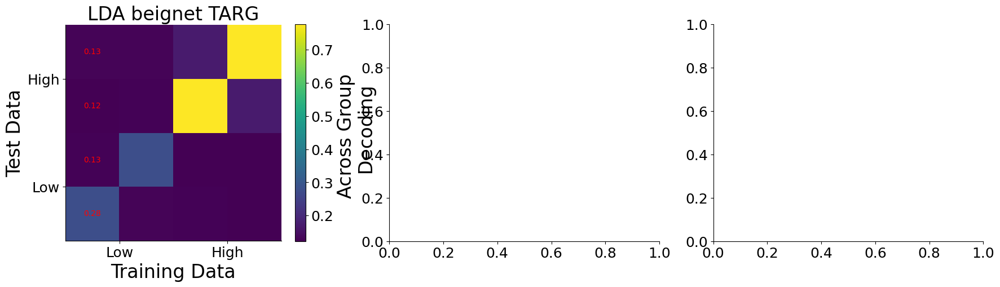

In [134]:
fig, ax = plt.subplots(1,len(align_events),figsize=(7*len(align_events),5))
for ievent, align_event in enumerate(align_events):
    dec_im = ax[ievent].pcolor(np.mean(np.array(accross_highlow_accuracy_pca[align_event]), axis=0).T)
    ax[ievent].set(xlabel='Training Data', ylabel='Test Data', title=f"LDA {subject} {align_event[:4]}")
    ax[ievent].set_xticks([1,3], ['Low', 'High'])
    ax[ievent].set_yticks([1,3], ['Low', 'High'])
    ax[ievent].set_aspect('equal')
    cb = plt.colorbar(dec_im, label='Across Group \n Decoding')
    for itrain in range(len(proj_data_pp_splits[align_event])):
        for itest in range(len(proj_data_pp_splits[align_event])):
            ax[ievent].annotate(np.round(np.mean(np.array(accross_highlow_accuracy_pca[align_event]), axis=0)[itrain,itest],2), (itrain+.5,itest+.5), color='red', ha='center', va='center')
fig.tight_layout()
plt.show()

In [135]:
# Decode using CCA transformation 
pp_across_decoding = {}
for align_event in align_events:
    pp_across_decoding[align_event] = np.zeros((4,4,niterations))*np.nan
    for iiter in range(niterations):
        for itrain, train_data in enumerate(proj_data_pp_splits[align_event][iiter]):
            for itest, test_data in enumerate(proj_data_pp_splits[align_event][iiter]):
                La = train_data[:,:npcs]
                Lb = test_data[:,:npcs]

                Ma, Mb, S, U, V = canoncorr_gallego(La, Lb, fullReturn=True)

                lda = sklearn.discriminant_analysis.LinearDiscriminantAnalysis()
                lda.fit(U, target_data_all[align_event][0])

                pp_across_decoding[align_event][itrain, itest, iiter] = lda.score(V,target_data_all[align_event][0])

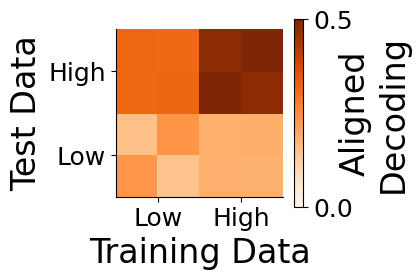

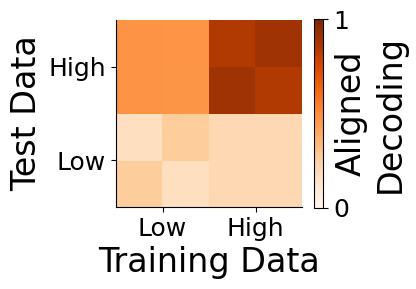

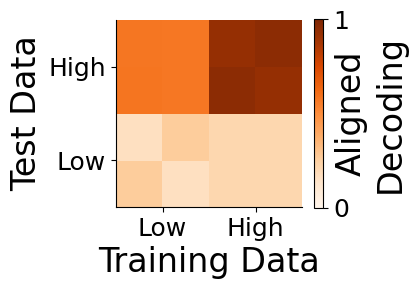

In [136]:
for ievent, align_event in enumerate(align_events):
    fig, ax = plt.subplots(1,1,figsize=(4,3))
    dec_im = ax.pcolor(np.mean(pp_across_decoding[align_event], axis=2).T, cmap='Oranges')
    ax.set(xlabel='Training Data', ylabel='Test Data')
    ax.set_xticks([1,3], ['Low', 'High'])
    ax.set_yticks([1,3], ['Low', 'High'])
    ax.set_aspect('equal')
    cb = plt.colorbar(dec_im)
    if ievent == 0:
        dec_im.set_clim(0,0.5)
        cb.set_ticks([0,0.5])
    else:
        dec_im.set_clim(0,1)
        cb.set_ticks([0,1])
    cb.set_label('Aligned\nDecoding', labelpad=-10)
    # for itrain in range(len(proj_data_pp_splits[align_event])):
    #     for itest in range(len(proj_data_pp_splits[align_event])):
    #         ax[ievent].annotate(np.round(pp_across_decoding[align_event][itrain,itest],2), (itrain+.5,itest+.5), color='red', ha='center', va='center')
    fig.tight_layout()
    aopy.visualization.savefig(base_save_dir, f'{subject}_high_high_low_low_ccadecoding_{align_event}.svg')

In [137]:
# nunits_unit_adding_split = np.arange(5,nunits_per_group,2)
pp_unit_add_split_decoding = {}
for align_event in align_events:
    low_group_max = np.max(np.array(single_ch_decoding[align_event])[np.argsort(np.array(single_ch_decoding[align_event]))][:np.max(nunits_unit_adding_split)*2])
    high_group_min = np.min(np.array(single_ch_decoding[align_event])[np.argsort(np.array(single_ch_decoding[align_event]))][-np.max(nunits_unit_adding_split)*2:])

    low_group_mask = np.array(single_ch_decoding[align_event]) <= low_group_max
    high_group_mask = np.array(single_ch_decoding[align_event]) >= high_group_min

    nmin_units = np.min(nunits_unit_adding_split)
    pp_unit_add_split_decoding[align_event] = np.zeros((4,4,len(nunits_unit_adding_split), niterations))*np.nan
    for igroup, unit_group_size in enumerate(tqdm(nunits_unit_adding_split)):
        for iiter in range(niterations):
            possible_low_unit_idx1 = np.where(low_group_mask)[0]
            low_unit_idx1 = np.random.choice(possible_low_unit_idx1, unit_group_size, replace=False)
            possible_low_unit_idx2 = possible_low_unit_idx1[np.logical_not(np.in1d(possible_low_unit_idx1, low_unit_idx1))]
            low_unit_idx2 = np.random.choice(possible_low_unit_idx2, unit_group_size, replace=False)

            possible_high_unit_idx1 = np.where(high_group_mask)[0]
            high_unit_idx1 = np.random.choice(possible_high_unit_idx1, unit_group_size, replace=False)
            possible_high_unit_idx2 = possible_high_unit_idx1[np.logical_not(np.in1d(possible_high_unit_idx1, high_unit_idx1))]
            high_unit_idx2 = np.random.choice(possible_high_unit_idx2, unit_group_size, replace=False)


            proj_data_low_decoding1 = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,low_unit_idx1]/np.std(all_prep_data[align_event][:,low_unit_idx1],axis=0))
            proj_data_low_decoding2 = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,low_unit_idx2]/np.std(all_prep_data[align_event][:,low_unit_idx2],axis=0))
            proj_data_high_decoding1 = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,high_unit_idx1]/np.std(all_prep_data[align_event][:,high_unit_idx1],axis=0))
            proj_data_high_decoding2 = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,high_unit_idx2]/np.std(all_prep_data[align_event][:,high_unit_idx2],axis=0))

            proj_data_pp_splits = [proj_data_low_decoding1, proj_data_low_decoding2, proj_data_high_decoding1, proj_data_high_decoding2]

            for itrain, train_data in enumerate(proj_data_pp_splits):
                for itest, test_data in enumerate(proj_data_pp_splits):

                    La = train_data[:,:nmin_units]
                    Lb = test_data[:,:nmin_units]

                    Ma, Mb, S, U, V = canoncorr_gallego(La, Lb, fullReturn=True)

                    lda = sklearn.discriminant_analysis.LinearDiscriminantAnalysis()
                    lda.fit(U, target_data_all[align_event][0])

                    pp_unit_add_split_decoding[align_event][itrain, itest, igroup, iiter] = lda.score(V,target_data_all[align_event][0])

NameError: name 'nunits_unit_adding_split' is not defined

In [ ]:
fig, ax = plt.subplots(1,len(align_events),figsize=(7*len(align_events),5))
for ievent, align_event in enumerate(align_events):
    # ax[ipc].plot(nunits_unit_adding, np.mean(ccs_pp_random_unit_add,axis=2)[:,ipc],'k--') 
    ax[ievent].plot([], color='blue') # Plot no show lone for legend
    ax[ievent].plot([], color='purple') # Plot no show lone for legend
    ax[ievent].plot([], color='red') # Plot no show lone for legend
    # ax[ipc].fill_between(nunits_unit_adding, np.mean(ccs_pp_random_unit_add,axis=2)[:,ipc]-np.std(ccs_pp_random_unit_add,axis=2)[:,ipc], np.mean(ccs_pp_random_unit_add,axis=2)[:,ipc]+np.std(ccs_pp_random_unit_add,axis=2)[:,ipc], alpha=0.5, color='black')

    for itrain in range(len(pp_unit_add_split_decoding[align_event])):
        for itest in range(len(pp_unit_add_split_decoding[align_event])):
            if itrain != itest:
                data2plot = np.mean(pp_unit_add_split_decoding[align_event], axis=3)[itrain,itest,:]
                sd2plot = np.std(pp_unit_add_split_decoding[align_event], axis=3)[itrain,itest,:]
                if itrain < 2 and itest < 2: 
                    ax[ievent].plot(nunits_unit_adding_split, data2plot,'b')
                    ax[ievent].fill_between(nunits_unit_adding_split, data2plot-sd2plot, data2plot+sd2plot, alpha=0.5, color='b')
                elif (itrain < 2 & itest >= 2) or (itrain >= 2 & itest < 2):
                    ax[ievent].fill_between(nunits_unit_adding_split, data2plot-sd2plot, data2plot+sd2plot, alpha=0.5, color='purple')
                    ax[ievent].plot(nunits_unit_adding_split, data2plot,color='purple')

                elif itrain >= 2 and itest >= 2:
                    ax[ievent].plot(nunits_unit_adding_split, data2plot,color='red', label='High vs. High')
                    ax[ievent].fill_between(nunits_unit_adding_split, data2plot-sd2plot, data2plot+sd2plot, alpha=0.5, color='red')
    ax[ievent].legend(['Low vs. Low','Low vs. High', 'High vs. High'], bbox_to_anchor=(1,.65))
    ax[ievent].set(xlabel='Number of units', ylabel='Decoding [%]', title=f"{subject} {align_event[:4]}", xlim=(0, np.max(nunits_unit_adding_split)), ylim=(0,1))
fig.tight_layout()
plt.show()

#### Split by task relevance (prep vs. move vs. shared) groups

In [ ]:
# Compute CCs the same way as Gallego paper
nunits_per_group = 30
task_event_cca_decoding = {}
for align_event in align_events:
    task_event_cca_decoding[align_event] = []
    
    for iiter in tqdm(range(niterations)):
        temp_proj_data = {}
        for igroup, group in enumerate(list(high_dec_groups.keys())):
            unit_idx = np.random.choice(np.where(high_dec_groups[group])[0], nunits_per_group, replace=False)
            temp_proj_data[group] = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,unit_idx]/np.std(all_prep_data[align_event][:,unit_idx],axis=0))

        compiled_cca_decoding = np.zeros((len(list(high_dec_groups.keys())), len(list(high_dec_groups.keys()))))*np.nan
        for itraingroup, traingroup in enumerate(list(high_dec_groups.keys())):
            for itestgroup, testgroup in enumerate(list(high_dec_groups.keys())):
                La = temp_proj_data[traingroup][:,:npcs]
                Lb = temp_proj_data[testgroup][:,:npcs]

                Ma, Mb, S, U, V = canoncorr_gallego(La, Lb, fullReturn=True)
                lda = sklearn.discriminant_analysis.LinearDiscriminantAnalysis()
                lda.fit(U, target_data_all[align_event][0])

                compiled_cca_decoding[itraingroup, itestgroup] = lda.score(V,target_data_all[align_event][0])


        task_event_cca_decoding[align_event].append(compiled_cca_decoding)

In [ ]:
tick_labels = ['NM', 'P', 'M', 'P+M']
fig, ax = plt.subplots(1,len(align_events),figsize=(7*len(align_events),5))
for ievent, align_event in enumerate(align_events):
    temp_im = ax[ievent].pcolor(np.mean(np.array(task_event_cca_decoding[align_event]), axis=0).T)
    ax[ievent].set_xticks(np.arange(len(list(high_dec_groups.keys())))+0.5, tick_labels)
    ax[ievent].set_yticks(np.arange(len(list(high_dec_groups.keys())))+0.5, tick_labels)
    cb = plt.colorbar(temp_im, label='Aligned decoding [%]')
    ax[ievent].set_aspect('equal')
    ax[ievent].set(title=f"{subject} {align_event}")

fig.tight_layout()
plt.show()

In [ ]:
pp_unit_add_event_decoding = {}
nunits_unit_adding_event = np.arange(5,nunits_per_group*2,2)
for align_event in align_events:
    # max_group_size = np.min([np.sum(high_dec_groups[label]) for label in list(high_dec_groups.keys())])
    # nunits_unit_adding_event = np.arange(5, max_group_size)
    
    nmin_units = np.min(nunits_unit_adding_event)

    pp_unit_add_event_decoding[align_event] = np.zeros((len(list(high_dec_groups.keys())),len(list(high_dec_groups.keys())),len(nunits_unit_adding_event), niterations))*np.nan

    for igroup, unit_group_size in enumerate(tqdm(nunits_unit_adding_event)):
        for iiter in range(niterations):
            for itraingroup, traingroup in enumerate(list(high_dec_groups.keys())):
                for itestgroup, testgroup in enumerate(list(high_dec_groups.keys())):
                    if np.sum(high_dec_groups[traingroup]) >= unit_group_size and np.sum(high_dec_groups[testgroup]) >= unit_group_size:

                        train_unit_idx = np.random.choice(np.where(high_dec_groups[traingroup])[0], unit_group_size, replace=False)
                        test_unit_idx = np.random.choice(np.where(high_dec_groups[testgroup])[0], unit_group_size, replace=False)
                        train_temp_proj_data = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,train_unit_idx]/np.std(all_prep_data[align_event][:,train_unit_idx],axis=0))
                        test_temp_proj_data = PCA(svd_solver='full').fit_transform(all_prep_data[align_event][:,test_unit_idx]/np.std(all_prep_data[align_event][:,test_unit_idx],axis=0))

                        La = train_temp_proj_data[:,:nmin_units]
                        Lb = test_temp_proj_data[:,:nmin_units]

                        Ma, Mb, S, U, V = canoncorr_gallego(La, Lb, fullReturn=True)
                        lda = sklearn.discriminant_analysis.LinearDiscriminantAnalysis()
                        lda.fit(U, target_data_all[align_event][0])

                        pp_unit_add_event_decoding[align_event][itraingroup, itestgroup, igroup, iiter] = lda.score(V,target_data_all[align_event][0])

In [ ]:
fig, ax = plt.subplots(1,len(align_events),figsize=(7*len(align_events),5))
for ievent, align_event in enumerate(align_events):
    # ax.plot(nunits_unit_adding, np.mean(ccs_pp_random_unit_add,axis=2)[:,ipc],'k--') 
    ax[ievent].plot([], color='darkred') # Plot no show lone for legend
    ax[ievent].plot([], color='firebrick') # Plot no show lone for legend
    ax[ievent].plot([], color='lightcoral') # Plot no show lone for legend
    ax[ievent].plot([], color='steelblue') # Plot no show lone for legend
    ax[ievent].plot([], color='deepskyblue') # Plot no show lone for legend
    ax[ievent].plot([], color='darkviolet') # Plot no show lone for legend
    # ax[ipc].fill_between(nunits_unit_adding, np.mean(ccs_pp_random_unit_add,axis=2)[:,ipc]-np.std(ccs_pp_random_unit_add,axis=2)[:,ipc], np.mean(ccs_pp_random_unit_add,axis=2)[:,ipc]+np.std(ccs_pp_random_unit_add,axis=2)[:,ipc], alpha=0.5, color='black')

    for itraingroup, traingroup in enumerate(list(high_dec_groups.keys())):
        for itestgroup, testgroup in enumerate(list(high_dec_groups.keys())):
            if itraingroup != itestgroup:
                data2plot = np.mean(pp_unit_add_event_decoding[align_event], axis=3)[itraingroup,itestgroup,:]
                sd2plot = np.std(pp_unit_add_event_decoding[align_event], axis=3)[itraingroup,itestgroup,:]

                if itraingroup == 0 and itestgroup == 1: 
                    ax[ievent].plot(nunits_unit_adding_event, data2plot,'darkred')
                    ax[ievent].fill_between(nunits_unit_adding_event, data2plot-sd2plot, data2plot+sd2plot, alpha=0.5, color='darkred')
                elif itraingroup == 0 and itestgroup == 2:
                    ax[ievent].plot(nunits_unit_adding_event, data2plot,'firebrick')
                    ax[ievent].fill_between(nunits_unit_adding_event, data2plot-sd2plot, data2plot+sd2plot, alpha=0.5, color='firebrick')
                elif itraingroup == 0 and itestgroup == 3:
                    ax[ievent].plot(nunits_unit_adding_event, data2plot,'lightcoral')
                    ax[ievent].fill_between(nunits_unit_adding_event, data2plot-sd2plot, data2plot+sd2plot, alpha=0.5, color='lightcoral')
                elif itraingroup == 1 and itestgroup == 2:
                    ax[ievent].plot(nunits_unit_adding_event, data2plot,'steelblue')
                    ax[ievent].fill_between(nunits_unit_adding_event, data2plot-sd2plot, data2plot+sd2plot, alpha=0.5, color='steelblue')
                elif itraingroup == 1 and itestgroup == 3:
                    ax[ievent].plot(nunits_unit_adding_event, data2plot,'deepskyblue')
                    ax[ievent].fill_between(nunits_unit_adding_event, data2plot-sd2plot, data2plot+sd2plot, alpha=0.5, color='deepskyblue')
                elif itraingroup == 2 and itestgroup == 3:
                    ax[ievent].plot(nunits_unit_adding_event, data2plot,'darkviolet')
                    ax[ievent].fill_between(nunits_unit_adding_event, data2plot-sd2plot, data2plot+sd2plot, alpha=0.5, color='darkviolet')
    ax[ievent].legend(['NM vs. P','NM vs. M', 'NM vs. P+M', 'P vs. M', 'P vs. P+M', 'M vs. P+M'], bbox_to_anchor=(1,.5))
    ax[ievent].set(xlabel='Number of units', ylabel='Decoding [%]', title=f"{subject} {align_event[:4]}", xlim=(0,50), ylim=(0.125,.85))
fig.tight_layout()
plt.show()

In [ ]:
### Now align activity from each even for each group to another (across events)
# nunits_per_group = 50
across_groups_and_events_aligned_decoding = np.zeros((len(list(high_dec_groups.keys())), len(align_events), len(align_events), niterations))*np.nan
for idec_group, decoding_group in enumerate(tqdm(list(high_dec_groups.keys()))):
    for ievent_train, align_event_train in enumerate(align_events):
        for ievent_test, align_event_test in enumerate(align_events):
            for iiter in range(niterations):
                
                unit_idx = np.random.choice(np.where(high_dec_groups[decoding_group])[0], nunits_per_group, replace=False)
                
                train_temp_proj_data = PCA(svd_solver='full').fit_transform(all_prep_data[align_event_train][:,unit_idx])
                test_temp_proj_data = PCA(svd_solver='full').fit_transform(all_prep_data[align_event_test][:,unit_idx])
                
                # Perform align dynamic decoding (Gallego 2018)
                La = train_temp_proj_data[:,:]
                Lb = test_temp_proj_data[:,:]

                Ma, Mb, S, U, V = canoncorr_gallego(La, Lb, fullReturn=True)
                lda = sklearn.discriminant_analysis.LinearDiscriminantAnalysis()
                lda.fit(U, target_data_all[align_event][0])

                across_groups_and_events_aligned_decoding[idec_group, ievent_train, ievent_test, iiter] = lda.score(V,target_data_all[align_event][0])                

In [ ]:
# Repeat but with randomly selected units
across_groups_and_events_aligned_decoding_random = np.zeros((len(align_events), len(align_events), niterations))*np.nan
for ievent_train, align_event_train in enumerate(tqdm(align_events)):
    for ievent_test, align_event_test in enumerate(align_events):
        for iiter in range(niterations):
                # Perform align dynamic decoding on randomly selected units
                random_unit_idx = np.random.choice(np.arange(all_prep_data[align_event].shape[1]), nunits_per_group, replace=False)
                
                random_train_temp_proj_data = PCA(svd_solver='full').fit_transform(all_prep_data[align_event_train][:,random_unit_idx]/np.std(all_prep_data[align_event_train][:,random_unit_idx],axis=0))
                random_test_temp_proj_data = PCA(svd_solver='full').fit_transform(all_prep_data[align_event_test][:,random_unit_idx]/np.std(all_prep_data[align_event_test][:,random_unit_idx],axis=0))
                
                # Perform align dynamic decoding (Gallego 2018)
                La = random_train_temp_proj_data[:,:]
                Lb = random_test_temp_proj_data[:,:]

                Ma, Mb, S, U, V = canoncorr_gallego(La, Lb, fullReturn=True)
                lda = sklearn.discriminant_analysis.LinearDiscriminantAnalysis()
                lda.fit(U, target_data_all[align_event][0])

                across_groups_and_events_aligned_decoding_random[ievent_train, ievent_test, iiter] = lda.score(V,target_data_all[align_event][0])   

In [ ]:
fig, ax = plt.subplots(1,len(list(high_dec_groups.keys())),figsize=(6*len(list(high_dec_groups.keys())),5))
for igroup, decoding_group in enumerate(tqdm(list(high_dec_groups.keys()))):
    im0 = ax[igroup].pcolor(np.mean(across_groups_and_events_aligned_decoding, axis=3)[igroup,:,:][[0,2],:][:,[0,2]].T, vmin=0.125, vmax=1)
    ax[igroup].set(title=f'{decoding_group} units', xlabel='Train Event', ylabel='Test Event')
    ax[igroup].set_aspect('equal')
    cb = plt.colorbar(im0)
    ax[igroup].set_xticks(np.arange(2)+.5, ['Prep', 'Move'], fontsize=18)
    ax[igroup].set_yticks(np.arange(2)+.5, ['Prep', 'Move'], rotation=90, va='center', fontsize=18)
fig.tight_layout()
plt.show()

In [ ]:
random_mean = np.mean(across_groups_and_events_aligned_decoding_random, axis=2)
random_sd = np.std(across_groups_and_events_aligned_decoding_random, axis=2)
fig, ax = plt.subplots(1,len(list(high_dec_groups.keys())),figsize=(6*len(list(high_dec_groups.keys())),5))

ax[0].plot(np.mean(across_groups_and_events_aligned_decoding, axis=3)[:,0,0],'.', markersize=20)
ax[0].fill_between(np.arange(4), np.mean(across_groups_and_events_aligned_decoding, axis=3)[:,0,0]-np.std(across_groups_and_events_aligned_decoding, axis=3)[:,0,0], np.mean(across_groups_and_events_aligned_decoding, axis=3)[:,0,0]+np.std(across_groups_and_events_aligned_decoding, axis=3)[:,0,0], alpha=0.5)
ax[0].plot([0,3], [random_mean[0,0], random_mean[0,0]],'k--')
ax[0].fill_between([0,3], [random_mean[0,0]-random_sd[0,0], random_mean[0,0]-random_sd[0,0]], [random_mean[0,0]+random_sd[0,0], random_mean[0,0]+random_sd[0,0]] , color='k', alpha=0.5)
ax[0].set(xlabel='Unit Group', ylabel='Decoding [%]', title='Train on Prep\nTest on Prep')
ax[0].set_xticks(np.arange(4), ['N.M ','P','M', 'P+M'], fontsize=18)
ax[0].set_yticks([0.2,.8])

ax[1].plot(np.mean(across_groups_and_events_aligned_decoding, axis=3)[:,0,2],'.', markersize=20)
ax[1].fill_between(np.arange(4), np.mean(across_groups_and_events_aligned_decoding, axis=3)[:,0,2]-np.std(across_groups_and_events_aligned_decoding, axis=3)[:,0,2], np.mean(across_groups_and_events_aligned_decoding, axis=3)[:,0,2]+np.std(across_groups_and_events_aligned_decoding, axis=3)[:,0,2], alpha=0.5)
ax[1].plot([0,3], [random_mean[0,2], random_mean[0,2]],'k--')
ax[1].fill_between([0,3], [random_mean[0,2]-random_sd[0,2], random_mean[0,2]-random_sd[0,2]], [random_mean[0,2]+random_sd[0,2], random_mean[0,2]+random_sd[0,2]] , color='k', alpha=0.5)
ax[1].set(xlabel='Unit Group', ylabel='Decoding [%]', title='Train on Prep\nTest on Move')
ax[1].set_xticks(np.arange(4), ['N.M ','P','M', 'P+M'], fontsize=18)
ax[1].set_yticks([0.2,.8])

ax[2].plot(np.mean(across_groups_and_events_aligned_decoding, axis=3)[:,2,0],'.', markersize=20)
ax[2].fill_between(np.arange(4), np.mean(across_groups_and_events_aligned_decoding, axis=3)[:,2,0]-np.std(across_groups_and_events_aligned_decoding, axis=3)[:,2,0], np.mean(across_groups_and_events_aligned_decoding, axis=3)[:,2,0]+np.std(across_groups_and_events_aligned_decoding, axis=3)[:,2,0], alpha=0.5)
ax[2].plot([0,3], [random_mean[2,0], random_mean[2,0]],'k--')
ax[2].fill_between([0,3], [random_mean[2,0]-random_sd[2,0], random_mean[2,0]-random_sd[2,0]], [random_mean[2,0]+random_sd[2,0], random_mean[2,0]+random_sd[2,0]] , color='k', alpha=0.5)
ax[2].set(xlabel='Unit Group', ylabel='Decoding [%]', title='Train on Move\nTest on Prep')
ax[2].set_xticks(np.arange(4), ['N.M ','P','M', 'P+M'], fontsize=18)
ax[2].set_yticks([0.2,1])

ax[3].plot(np.mean(across_groups_and_events_aligned_decoding, axis=3)[:,2,2],'.', markersize=20)
ax[3].fill_between(np.arange(4), np.mean(across_groups_and_events_aligned_decoding, axis=3)[:,2,2]-np.std(across_groups_and_events_aligned_decoding, axis=3)[:,2,2], np.mean(across_groups_and_events_aligned_decoding, axis=3)[:,2,2]+np.std(across_groups_and_events_aligned_decoding, axis=3)[:,2,2], alpha=0.5)
ax[3].plot([0,3], [random_mean[2,2], random_mean[2,2]],'k--')
ax[3].fill_between([0,3], [random_mean[2,2]-random_sd[2,2], random_mean[2,2]-random_sd[2,2]], [random_mean[2,2]+random_sd[2,2], random_mean[2,2]+random_sd[2,2]] , color='k', alpha=0.5)
ax[3].set(xlabel='Unit Group', ylabel='Decoding [%]', title='Train on Move\nTest on Move')
ax[3].set_yticks([0.5,1])
ax[3].set_xticks(np.arange(4), ['N.M ','P','M', 'P+M'], fontsize=18)

fig.tight_layout()
aopy.visualization.savefig(base_save_dir, f'{subject}_across_event_aligned_decoding.svg')

In [ ]:
fig, ax = plt.subplots(1,1,figsize=(4.5,3))
ax.plot(100*np.mean(across_groups_and_events_aligned_decoding, axis=3)[:,0,2], color='darkorange')
ax.fill_between(np.arange(4), 100*np.mean(across_groups_and_events_aligned_decoding, axis=3)[:,0,2]-100*np.std(across_groups_and_events_aligned_decoding, axis=3)[:,0,2], 100*np.mean(across_groups_and_events_aligned_decoding, axis=3)[:,0,2]+100*np.std(across_groups_and_events_aligned_decoding, axis=3)[:,0,2], alpha=0.5, color='darkorange')
ax.set(ylabel='Aligned\nDecoding [%]', ylim=(30,80))
ax.set_xticks(np.arange(4), ['N.M ','P','M', 'P+M'])
ax.set_yticks([30,80])
fig.tight_layout()
aopy.visualization.savefig(base_save_dir, f'{subject}_across_event_dynamics_decoding.svg')

In [ ]:
### Now align activity from each even for each group to another (across events)
across_groups_and_events_aligned_decoding_unit_add = np.zeros((len(nunits_unit_adding_split), len(list(high_dec_groups.keys())), len(align_events), len(align_events), niterations))*np.nan
for iunit, nunits_per_group_unit_add in enumerate(tqdm(nunits_unit_adding_split)):
    for idec_group, decoding_group in enumerate(list(high_dec_groups.keys())):
        if nunits_per_group_unit_add <= np.sum(high_dec_groups[decoding_group]): # Only do analysis if there are enough units
            for ievent_train, align_event_train in enumerate(align_events):
                for ievent_test, align_event_test in enumerate(align_events):
                    for iiter in range(niterations):

                        unit_idx = np.random.choice(np.where(high_dec_groups[decoding_group])[0], nunits_per_group_unit_add, replace=False)

                        train_temp_proj_data = PCA(svd_solver='full').fit_transform(all_prep_data[align_event_train][:,unit_idx]/np.std(all_prep_data[align_event_train][:,unit_idx],axis=0))
                        test_temp_proj_data = PCA(svd_solver='full').fit_transform(all_prep_data[align_event_test][:,unit_idx]/np.std(all_prep_data[align_event_test][:,unit_idx],axis=0))

                        La = train_temp_proj_data[:,:]
                        Lb = test_temp_proj_data[:,:]

                        Ma, Mb, S, U, V = canoncorr_gallego(La, Lb, fullReturn=True)
                        lda = sklearn.discriminant_analysis.LinearDiscriminantAnalysis()
                        lda.fit(U, target_data_all[align_event][0])

                        across_groups_and_events_aligned_decoding_unit_add[iunit, idec_group, ievent_train, ievent_test, iiter] = lda.score(V,target_data_all[align_event][0])


In [ ]:
fig, ax = plt.subplots(1,4,figsize=(24,5))

ax[0].plot(nunits_unit_adding_split, np.mean(across_groups_and_events_aligned_decoding_unit_add, axis=4)[:,:,0,0])
ax[0].set(ylabel='Decoding [%]', title='Train on Prep\nTest on Prep', ylim=(0.1,1))
ax[0].legend(['N.M', 'P', 'M', 'P+M'])

ax[1].plot(nunits_unit_adding_split, np.mean(across_groups_and_events_aligned_decoding_unit_add, axis=4)[:,:,0,2])
ax[1].set(ylabel='Decoding [%]', title='Train on Prep\nTest on Move', ylim=(0.1,1))
ax[1].legend(['N.M', 'P', 'M', 'P+M'])

ax[2].plot(nunits_unit_adding_split, np.mean(across_groups_and_events_aligned_decoding_unit_add, axis=4)[:,:,2,0])
ax[2].set(ylabel='Decoding [%]', title='Train on Move\nTest on Prep', ylim=(0.1,1))
ax[2].legend(['N.M', 'P', 'M', 'P+M'])

ax[3].plot(nunits_unit_adding_split, np.mean(across_groups_and_events_aligned_decoding_unit_add, axis=4)[:,:,2,2])
ax[3].set(ylabel='Decoding [%]', title='Train on Move\nTest on Move', ylim=(0.1,1))
ax[3].legend(['N.M', 'P', 'M', 'P+M'])

fig.tight_layout()
plt.show()

#### Apply Elsayed approach for decoding dynamics across events

In [ ]:
prep_event = align_events[0]
move_event = align_events[2]
prep_tavg = []
move_tavg = []
prep_tavg_array = np.concatenate([tavg_prep_data[prep_event][irec] for irec in range(len(tavg_prep_data[prep_event])) if len(tavg_prep_data[prep_event][irec])>0], axis=2)[:,:,:]
move_tavg_array = np.concatenate([tavg_prep_data[move_event][irec] for irec in range(len(tavg_prep_data[move_event])) if len(tavg_prep_data[move_event][irec])>0], axis=2)[:,:,:]
prep_tavg_array = (prep_tavg_array - np.mean(prep_tavg_array,axis=1)[:,None,:])
move_tavg_array = (move_tavg_array - np.mean(move_tavg_array,axis=1)[:,None,:])
for itarget in range(ntargets):
    prep_tavg.extend(prep_tavg_array[:,itarget,:])
    move_tavg.extend(move_tavg_array[:,itarget,:])
prep_tavg = np.array(prep_tavg)
move_tavg = np.array(move_tavg)
prep_move_data = np.concatenate((prep_tavg, move_tavg))

prep_pca = PCA(svd_solver='full').fit(prep_tavg)
move_pca = PCA(svd_solver='full').fit(move_tavg)

In [ ]:
prep_pca_traj = prep_pca.transform(prep_tavg/np.std(prep_tavg,axis=0))[:,:2] # Use only top 2 prep pcs (from Elsayed paper)
move_pca_traj = move_pca.transform(move_tavg/np.std(move_tavg,axis=0))[:,:4] # Use only top 4 move pcs (From Elsayed paper)

In [ ]:
fig, ax = plt.subplots(1,2,figsize=(10,4), )
ax[0].plot(prep_pca_traj[:,0], prep_pca_traj[:,1], '.')
ax[1].plot(move_pca_traj[:,0], move_pca_traj[:,1], '.')
ax[0].set(xlabel='PC1', ylabel='PC2', title='Prep'), ax[1].set(xlabel='PC1', ylabel='PC2', title='Move') 
fig.tight_layout()
plt.show()

In [ ]:
prep_time_compare = 200
move_time_compare = 100
prep_idx_compre = int(((prep_time_compare/1000)+tbefore_cca)*cca_bin_fs)
move_idx_compare = int(((move_time_compare/1000)+tbefore_cca)*cca_bin_fs)
print(prep_idx_compre, move_idx_compare)
Xprep = prep_pca.transform(prep_tavg_array[prep_idx_compre,:,:])[:,:2] # Use only top 2 prep pcs (from Elsayed paper)
Xmove = move_pca.transform(prep_tavg_array[move_idx_compare,:,:])[:,:4] # Use only top 4 move pcs (From Elsayed paper)

In [ ]:
fig, ax = plt.subplots(1,2,figsize=(10,4), )
ax[0].plot(Xprep[:,0], Xprep[:,1], '.')
ax[1].plot(Xmove[:,0], Xmove[:,1], '.')
ax[0].set(xlabel='PC1', ylabel='PC2', title='Prep'), ax[1].set(xlabel='PC1', ylabel='PC2', title='Move') 
fig.tight_layout()
plt.show()

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(10, 4), subplot_kw={'projection': '3d'})
ax[0].plot(Xprep[:,0], Xprep[:,1], '.')
ax[1].plot(Xmove[:,0], Xmove[:,1], Xmove[:,2], '.')
ax[0].set(xlabel='PC1', ylabel='PC2', title='Prep'), ax[1].set(xlabel='PC1', ylabel='PC2',zlabel='PC3', title='Move') 
fig.tight_layout()
plt.show()

In [ ]:
# Use linear regression to try and predict each
W, move_recon = weiner_filter(Xprep, Xmove, lags=0, fit_intercept=False) # Projects prep onto move

In [ ]:
prep_onto_move_r2 = 1 - (np.linalg.norm(Xmove - (Xprep @ W)) / np.linalg.norm(Xmove))
move_onto_prep_r2 = 1 - np.linalg.norm(Xprep - (Xmove @ np.linalg.pinv(W))) / np.linalg.norm(Xprep)
print(prep_onto_move_r2, move_onto_prep_r2)

In [ ]:
# Repeat for different groups of units
nunits_per_group = 30
prep_onto_move_r2_groups = np.zeros((len(list(high_dec_groups.keys())), niterations))*np.nan
move_onto_prep_r2_groups = np.zeros((len(list(high_dec_groups.keys())), niterations))*np.nan
for igroup, group_label in enumerate(tqdm(list(high_dec_groups.keys()))):
    for iiter in range(niterations):
        unit_idx = np.random.choice(np.where(high_dec_groups[group_label])[0], nunits_per_group, replace=False)
        
        prep_tavg_group = []
        move_tavg_group = []
        prep_tavg_group_array = np.concatenate([tavg_prep_data[prep_event][irec] for irec in range(len(tavg_prep_data[prep_event])) if len(tavg_prep_data[prep_event][irec])>0], axis=2)[:,:,unit_idx]
        move_tavg_group_array = np.concatenate([tavg_prep_data[move_event][irec] for irec in range(len(tavg_prep_data[move_event])) if len(tavg_prep_data[move_event][irec])>0], axis=2)[:,:,unit_idx]
        prep_tavg_group_array = (prep_tavg_group_array - np.mean(prep_tavg_group_array,axis=1)[:,None,:])
        move_tavg_group_array = (move_tavg_group_array - np.mean(move_tavg_group_array,axis=1)[:,None,:])
        for itarget in range(ntargets):
            prep_tavg_group.extend(prep_tavg_group_array[:,itarget,:])
            move_tavg_group.extend(move_tavg_group_array[:,itarget,:])
        prep_tavg_group = np.array(prep_tavg_group)
        move_tavg_group = np.array(move_tavg_group)
        
        prep_pca_group = PCA(svd_solver='full').fit(prep_tavg_group) # Use only top 2 prep pcs (from Elsayed paper)
        move_pca_group = PCA(svd_solver='full').fit(move_tavg_group) # Use only top 4 move pcs (From Elsayed paper)

        Xprep = prep_pca_group.transform(prep_tavg_group_array[prep_idx_compre,:,:])[:,:2] # Use only top 2 prep pcs (from Elsayed paper)
        Xmove = move_pca_group.transform(move_tavg_group_array[move_idx_compare,:,:])[:,:4] # Use only top 4 move pcs (From Elsayed paper)
        
        W, _ = weiner_filter(Xprep, Xmove, lags=0, fit_intercept=False) # Projects prep onto move
        prep_onto_move_r2_groups[igroup, iiter] = 1 - np.linalg.norm(Xmove - (Xprep @ W)) / np.linalg.norm(Xmove)
        move_onto_prep_r2_groups[igroup, iiter] = 1 - np.linalg.norm(Xprep - (Xmove @ np.linalg.pinv(W))) / np.linalg.norm(Xprep)

In [ ]:
fig, ax = plt.subplots(1,2,figsize=(10,4))
ax[0].plot(np.mean(prep_onto_move_r2_groups, axis=1))
ax[0].fill_between(np.arange(4), np.mean(prep_onto_move_r2_groups, axis=1)-np.std(prep_onto_move_r2_groups, axis=1), np.mean(prep_onto_move_r2_groups, axis=1)+np.std(prep_onto_move_r2_groups, axis=1), alpha=0.5)
ax[1].plot(np.mean(move_onto_prep_r2_groups, axis=1))
ax[1].fill_between(np.arange(4), np.mean(move_onto_prep_r2_groups, axis=1)-np.std(move_onto_prep_r2_groups, axis=1), np.mean(move_onto_prep_r2_groups, axis=1)+np.std(move_onto_prep_r2_groups, axis=1), alpha=0.5)
ax[0].set(xlabel='Unit Group', ylabel='Trajectory $R^2$', title='Prep onto Move', ylim=(0.3, 0.7))
ax[1].set(xlabel='Unit Group', ylabel='Trajectory $R^2$',  title='Move onto Prep')
ax[0].set_xticks(np.arange(4), ['N.M ','P','M', 'P+M'], fontsize=18), ax[1].set_xticks(np.arange(4), ['N.M ','P','M', 'P+M'], fontsize=18)
fig.tight_layout()
plt.show()